In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

93


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [23]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [24]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [25]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [26]:
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1597033,North America,North America,NaN,5108.0,499.0,"+4,578",NaN,18919.0,NaN,3129426,167602.0,1364791.0,NaN,NaN
1,NaN,\n,NaN,NaN,835986,South America,South America,NaN,601.0,57.0,411,NaN,12789.0,NaN,2187129,83671.0,1267472.0,NaN,NaN
2,NaN,\n,NaN,NaN,880263,Europe,Europe,NaN,NaN,NaN,"+1,000",NaN,5753.0,NaN,2429234,191026.0,1357945.0,NaN,NaN
3,NaN,\n,NaN,NaN,724759,Asia,Asia,NaN,3737.0,144.0,"+3,292",NaN,19392.0,NaN,2260121,55874.0,1479488.0,NaN,NaN
4,NaN,\n,NaN,NaN,196678,Africa,Africa,NaN,NaN,NaN,NaN,NaN,924.0,NaN,396314,9914.0,189722.0,NaN,NaN


In [27]:
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,,NaN,NaN,724759,Asia,Total:,NaN,3737.0,144.0,"+3,292",NaN,19392.0,NaN,2260121,55874.0,1479488.0,NaN,NaN
226,NaN,,NaN,NaN,196678,Africa,Total:,NaN,NaN,NaN,NaN,NaN,924.0,NaN,396314,9914.0,189722.0,NaN,NaN
227,NaN,,NaN,NaN,751,Australia/Oceania,Total:,NaN,69.0,NaN,NaN,NaN,1.0,NaN,9476,126.0,8599.0,NaN,NaN
228,NaN,,NaN,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,NaN,NaN,NaN,159958,Europe,European Union,298.748673,0.0,0.0,NaN,NaN,2411.0,62671.357186,1282170,133018.0,615017.0,27904454.0,2879.659786


In [28]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1597033,North America,North America,NaN,5108.0,499.0,"+4,578",NaN,18919.0,NaN,3129426,167602.0,1364791.0,NaN,NaN
1,NaN,\n,NaN,NaN,835986,South America,South America,NaN,601.0,57.0,411,NaN,12789.0,NaN,2187129,83671.0,1267472.0,NaN,NaN
2,NaN,\n,NaN,NaN,880263,Europe,Europe,NaN,NaN,NaN,"+1,000",NaN,5753.0,NaN,2429234,191026.0,1357945.0,NaN,NaN
3,NaN,\n,NaN,NaN,724759,Asia,Asia,NaN,3737.0,144.0,"+3,292",NaN,19392.0,NaN,2260121,55874.0,1479488.0,NaN,NaN
4,NaN,\n,NaN,NaN,196678,Africa,Africa,NaN,NaN,NaN,NaN,NaN,924.0,NaN,396314,9914.0,189722.0,NaN,NaN


In [29]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
118,112.0,"1,499","34,898",7,226,Europe,Lithuania,29.0,0.0,0.0,0,"2,722,035",16.0,153697.0,1816,78.0,1512.0,418368.0,667.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


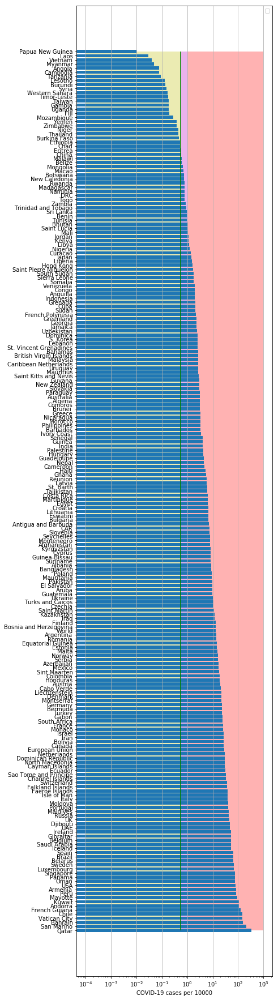

In [30]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


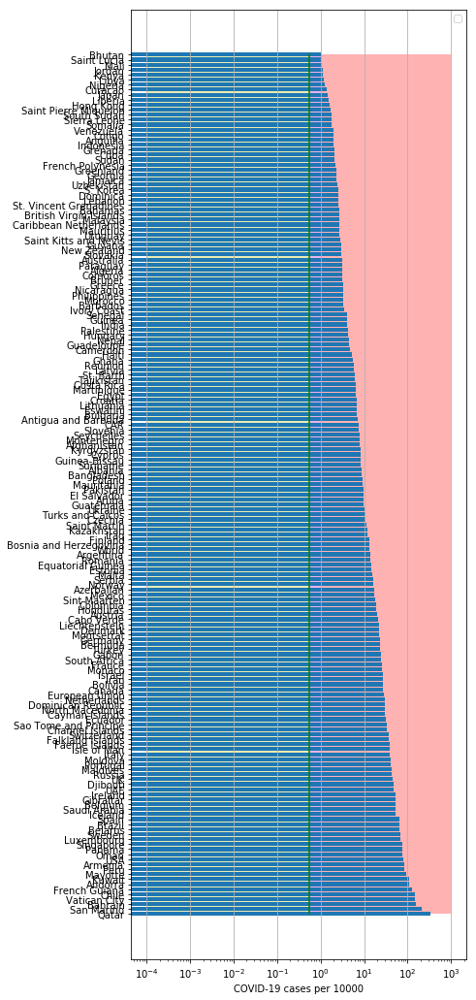

In [31]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

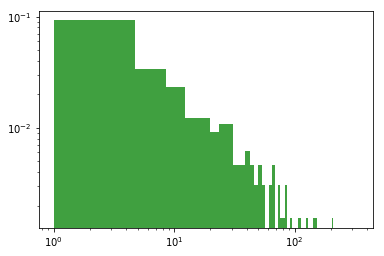

In [32]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [33]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
121 2020-06-25  294566       0  28330.0
122 2020-06-26  294985       0  28338.0
123 2020-06-27  295549       0  28341.0
124 2020-06-28  295850       0  28343.0
125 2020-06-29  296050       0  28346.0
GB
           date   cases  active    death
120 2020-06-25  307980       0  43230.0
121 2020-06-26  309360       0  43414.0
122 2020-06-27  310250       0  43514.0
123 2020-06-28  311151       0  43550.0
124 2020-06-29  311965       0  43575.0
IT
           date   cases  active    death
123 2020-06-25  239706   18303  34678.0
124 2020-06-26  239961   17638  34708.0
125 2020-06-27  240136   16836  34716.0
126 2020-06-28  240310   16681  34738.0
127 2020-06-29  240436   16496  34744.0
LT
           date   cases  active  death     tests
108 2020-06-25  1808.0     234   78.0  410867.0
109 2020-06-26  1813.0     222   78.0  414792.0
110 2020-06-27  1815.0     224   78.0  416739.0
111 2020-06-28  1816.0     216   78.0  418368.0
112 2020-06-29  1816.0  

PU
           date   cases    active   death
110 2020-06-25  268602  103767.0  8761.0
111 2020-06-26  272364  103619.0  8939.0
112 2020-06-27  275989  102830.0  9135.0
113 2020-06-28  279419  102104.0  9317.0
114 2020-06-29  282365  101702.0  9504.0
SB
           date  cases  active  death
107 2020-06-25  13372   954.0  264.0
108 2020-06-26  13565  1068.0  265.0
109 2020-06-27  13792  1187.0  267.0
110 2020-06-28  14046  1312.0  270.0
111 2020-06-29  14288  1433.0  274.0
AG
           date    cases   active   death
113 2020-06-25  52457.0  36519.0  1150.0
114 2020-06-26  55343.0  35743.0  1184.0
115 2020-06-27  57744.0  37394.0  1207.0
116 2020-06-28  59933.0  38567.0  1232.0
117 2020-06-29  62268.0  39850.0  1280.0
CT
           date   cases  active  death
117 2020-06-25  2483.0   227.0  107.0
118 2020-06-26  2539.0   282.0  107.0
119 2020-06-27  2624.0   365.0  107.0
120 2020-06-28  2691.0   432.0  107.0
121 2020-06-29  2725.0   463.0  107.0
EG
           date  cases  active   death


In [34]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [35]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5791464150993915
intercept: -0.6791562271155152
slope: [0.05322745]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


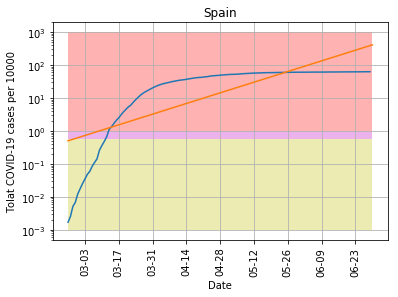

In [36]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-06-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [37]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.7178896579692419
intercept: -2.2663000128413957
slope: [0.06513027]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


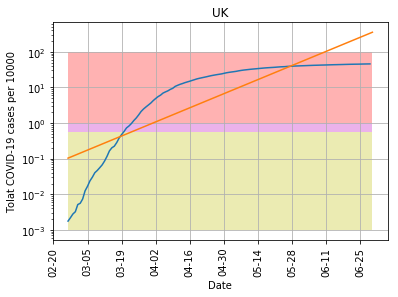

In [38]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-06-30', "pictures/coronaGB.png", model1, 'UK',100)

In [39]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9569506591117345
intercept: 1.4914574851325146
slope: [-0.03955637]


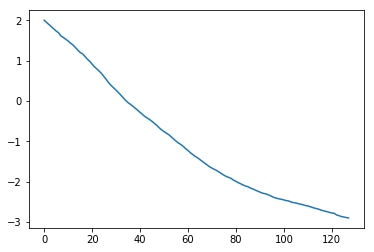

In [40]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


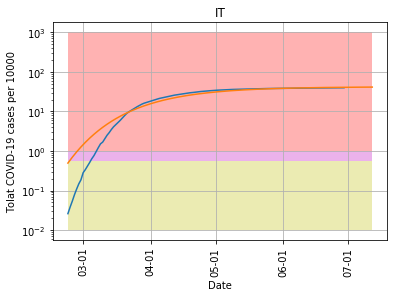

In [41]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [42]:
cs=y_pred11[-1]/10000.*populationIT

In [43]:
cs

249589.50431039592

In [44]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5081053730055319
intercept: -0.9418046352511841
slope: [0.03493838]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


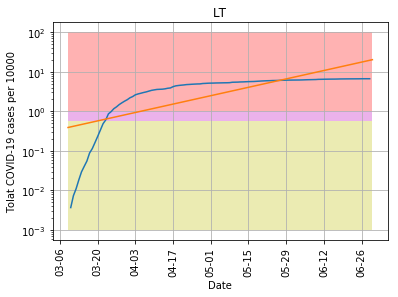

In [45]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-06-30', "pictures/coronaLT.png", model1, 'LT',100)

In [46]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7542087563156904
intercept: -4.099830045272489
slope: [0.07172181]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


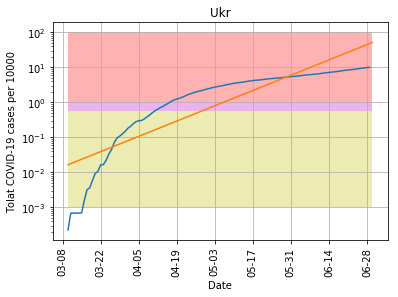

In [47]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-06-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


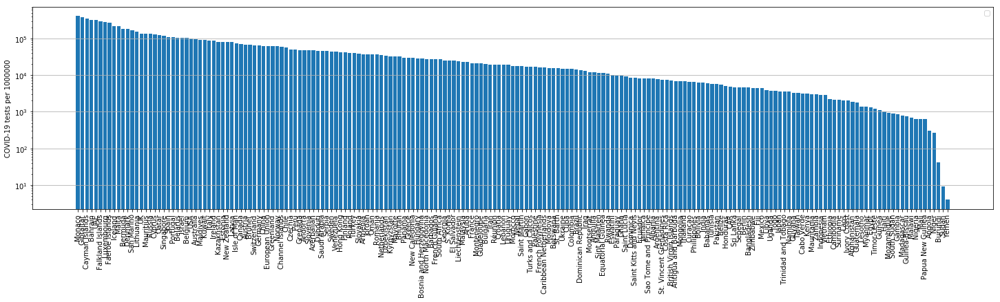

In [48]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [49]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6915201163359738
intercept: -1.7330141918920967
slope: [0.06588161]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


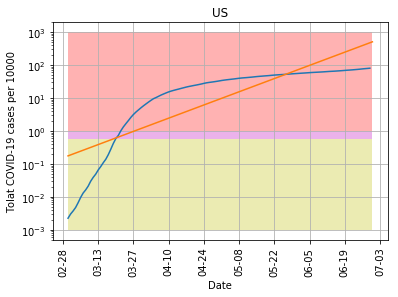

In [50]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-06-30', "pictures/coronaUS.png", model11, 'US',1000)

In [51]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.103744


(0, 0.15)

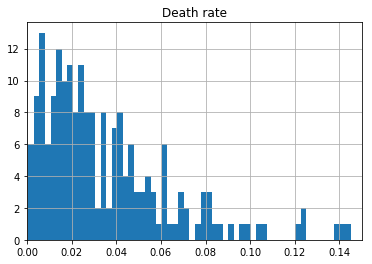

In [52]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

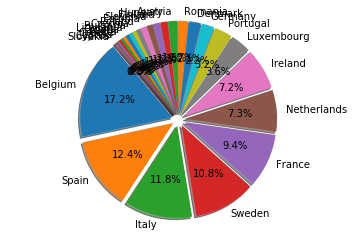

In [53]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [54]:
dfTTh.head()

,Country,Deathsper1Mpop
32,Belgium,840.0
12,Spain,606.0
15,Italy,575.0
28,Sweden,526.0
22,France,457.0


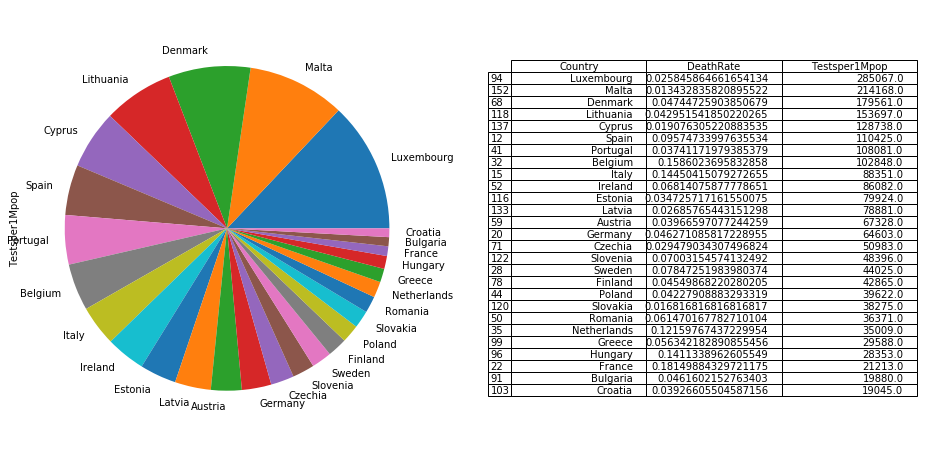

In [55]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

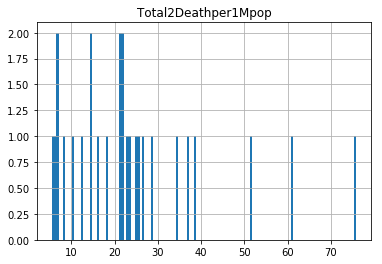

In [56]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [57]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
12,Spain,6332.0,606.0
15,Italy,3977.0,575.0
20,Germany,2332.0,108.0
22,France,2516.0,457.0
28,Sweden,6700.0,526.0


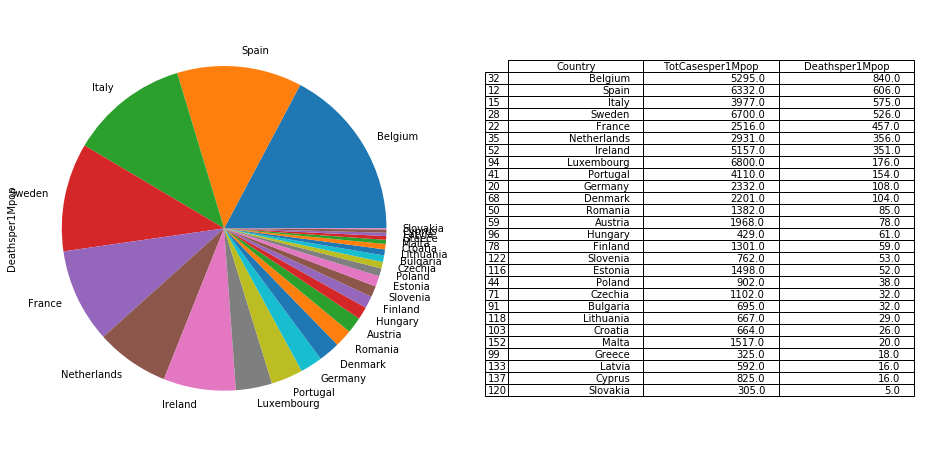

In [58]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [59]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,\n,0,0,1597033,North America,North America,0.0,5108.0,499.0,"+4,578",0,18919.0,0.0,3129426,167602.0,1364791.0,0.0,0.0
1,0.0,\n,0,0,835986,South America,South America,0.0,601.0,57.0,411,0,12789.0,0.0,2187129,83671.0,1267472.0,0.0,0.0
2,0.0,\n,0,0,880263,Europe,Europe,0.0,0.0,0.0,"+1,000",0,5753.0,0.0,2429234,191026.0,1357945.0,0.0,0.0
3,0.0,\n,0,0,724759,Asia,Asia,0.0,3737.0,144.0,"+3,292",0,19392.0,0.0,2260121,55874.0,1479488.0,0.0,0.0
4,0.0,\n,0,0,196678,Africa,Africa,0.0,0.0,0.0,0,0,924.0,0.0,396314,9914.0,189722.0,0.0,0.0


In [60]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
12,Spain,0.057342
15,Italy,0.045014
20,Germany,0.036097
22,France,0.118607
28,Sweden,0.152186


In [61]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.152186
      France             0.118607
 Netherlands             0.083721
     Ireland             0.059908
       Spain             0.057342
     Belgium             0.051484
       Italy             0.045014
    Portugal             0.038027
     Romania             0.037997
     Germany             0.036097
    Bulgaria             0.034960
     Croatia             0.034865
     Finland             0.030351
     Austria             0.029230
  Luxembourg             0.023854
      Poland             0.022765
     Czechia             0.021615
     Estonia             0.018743
    Slovenia             0.015745
     Hungary             0.015131
     Denmark             0.012258
      Greece             0.010984
    Slovakia             0.007969
      Latvia             0.007505
       Malta             0.007083
      Cyprus             0.006408
   Lithuania             0.004340


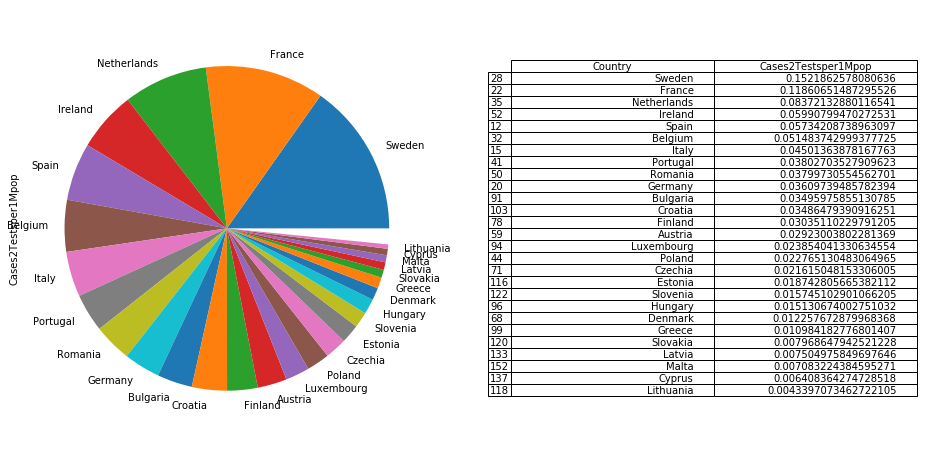

In [62]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [63]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
39,Singapore,0.000595,116981.000000
26,Qatar,0.001188,125600.000000
136,Rwanda,0.001998,10832.000000
66,Nepal,0.002189,17901.000000
109,Palestine,0.002288,16592.000000
76,Uzbekistan,0.002772,33504.000000
51,Bahrain,0.003201,320569.000000
107,Maldives,0.003423,91289.000000
156,Réunion,0.003831,19212.000000
97,French Guiana,0.003975,26998.000000


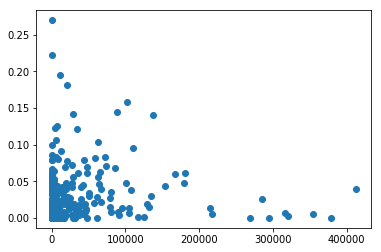

In [64]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


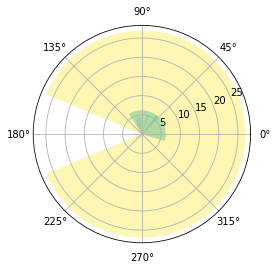

In [65]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

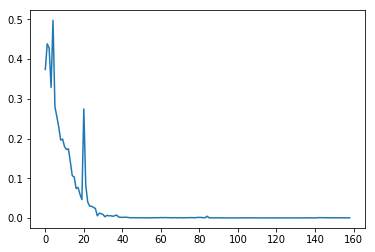

In [66]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [67]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


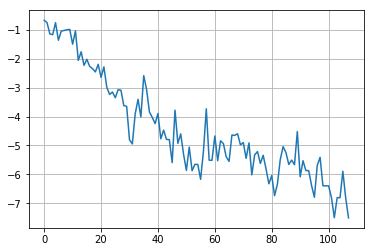

In [68]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

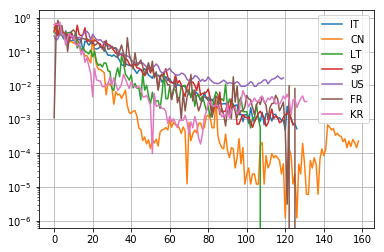

In [69]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

120 120
coefficient of determination: 0.7874444491379213
intercept: -10.252120081492402
slope: [-0.09580295]


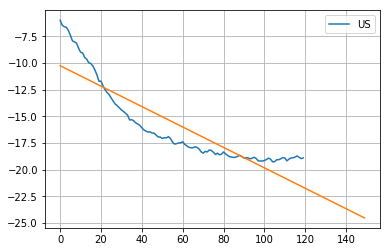

In [70]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [71]:
#np.diff(dfIT["cases"])

127 127
coefficient of determination: 0.8821489220402128
intercept: -10.412157392906622
slope: [-0.08617187]


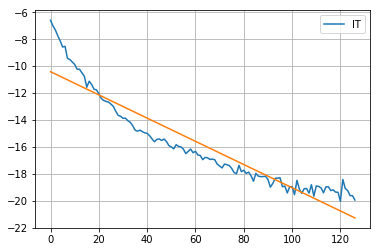

In [72]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [73]:
#model11.coef_

In [74]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

109 109
coefficient of determination: 0.882963569915603
intercept: -15.479938764548626
slope: [-0.05235043]


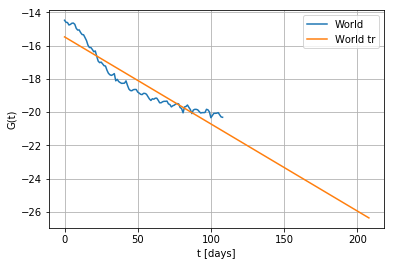

In [75]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

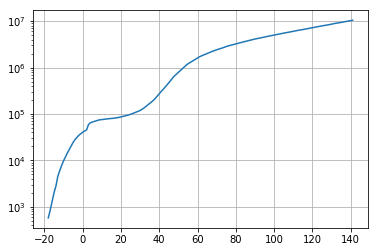

In [76]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [77]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 2.04576829e+07  1.18334552e+00 -1.42036754e+02  1.37293406e-02]


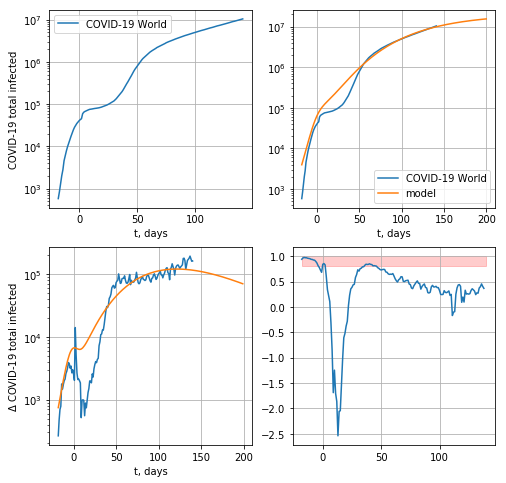

178622.94932725036


In [78]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

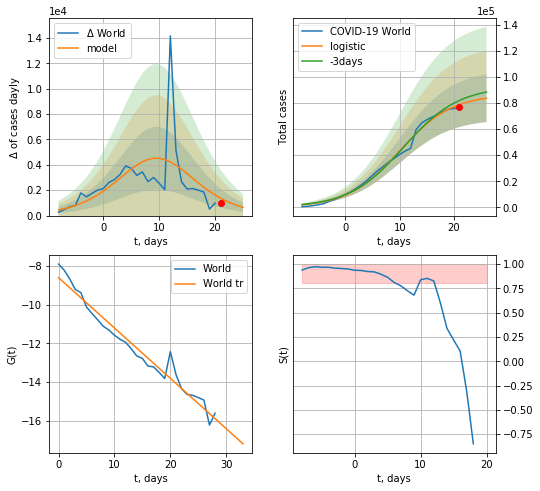

World data at: 2020-06-29
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +5 days
	 deltaDaycases:  651
	 total cases:  83561 ± 18200
	 total death:  4078 ± 2664
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


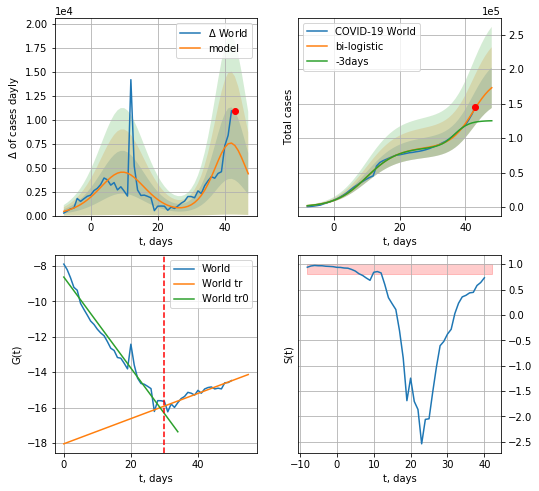

World data at: 2020-06-29
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +5 days
	 deltaDaycases:  4357
	 total cases:  172932 ± 29386
	 total death:  8440 ± 4302
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


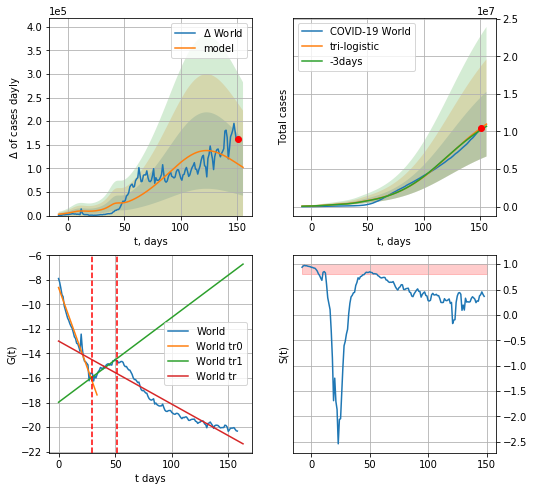

World data at: 2020-06-29
+3 day model MAPE: 0.023650994183355065
model: tri-logistic
coeffs:  [1.22093656e+07 4.20837341e-02 1.20275033e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.3927379510084744
forecast at the end of period: +5 days
	 deltaDaycases:  102177
	 total cases:  10981603 ± 4312892
	 total death:  536009 ± 631533
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.878478
 intercept: -12.988764
 slope: -0.051319


In [79]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*14-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*14-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*14-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

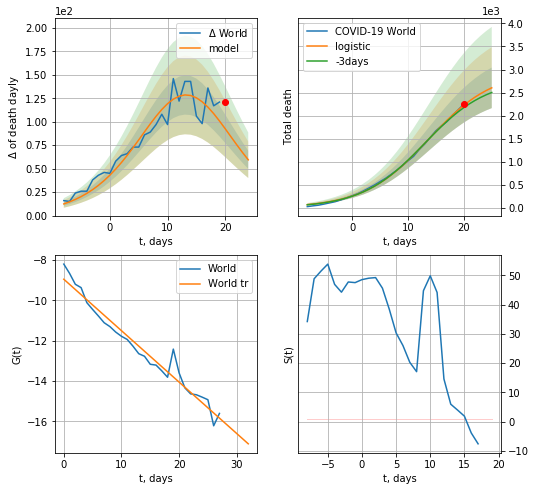

World data at: 2020-06-29
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +5 days
	 total death:  2602 ± 440
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


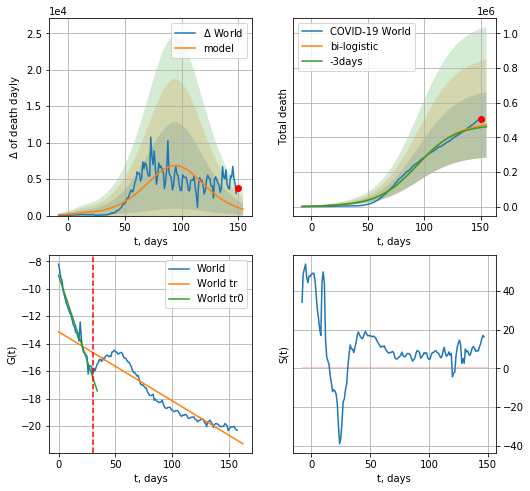

World data at: 2020-06-29
+3 day model MAPE: 0.02217212143152751
model: bi-logistic
coeffs:  [4.84233358e+05 5.67164366e-02 9.48468186e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.40001078570699883
forecast at the end of period: +5 days
	 deltaDaydeath:  871
	 total death:  471740 ± 188701
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.899741
 intercept: -13.137055
 slope: -0.050387


In [80]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*14-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*14-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [81]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


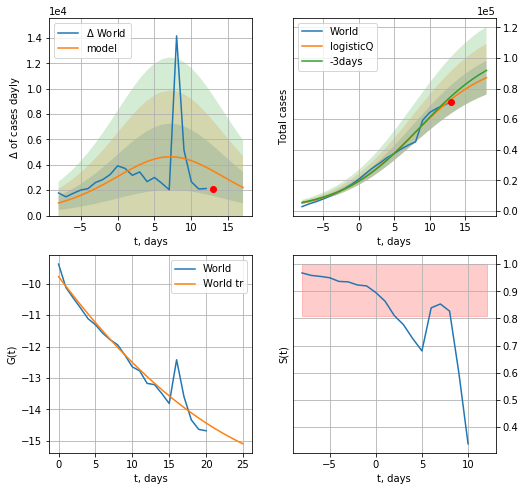

World data at: 2020-06-29
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +5 days
	 deltaDaycases: 2209
	 total cases: 87179 ± 11068
	 total death: 4255 ± 1620
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


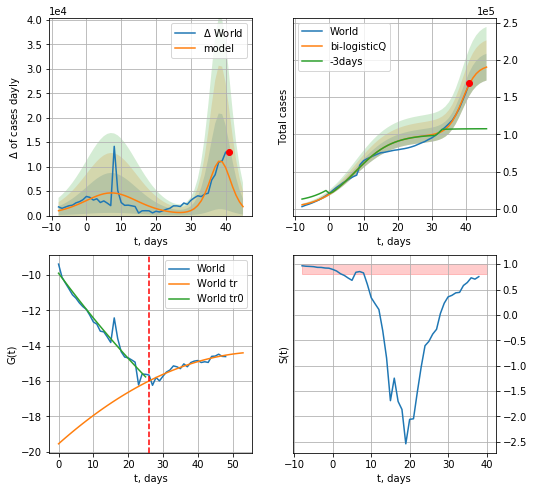

World data at: 2020-06-29
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +5 days
	 deltaDaycases: 1826
	 total cases: 190433 ± 18033
	 total death: 9295 ± 2640
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


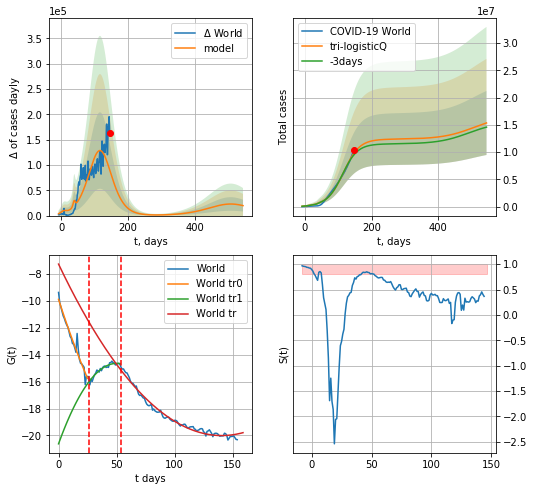

World data at: 2020-06-29
+3 day model MAPE: 0.031157
model: tri-logisticQ
coeffs: [ 1.21872438e+07  2.32378194e-07  1.16224162e+02 -1.81360510e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.382678
forecast at the end of period: +397 days
	 deltaDaycases: 19705
	 total cases: 15353218 ± 5875331
	 total death: 749387 ± 860320
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.982527
 intercept_: -7.270045920291572
 coeffs_: [ 0.         -0.18110535  0.00064364]


In [82]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*14-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*14-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


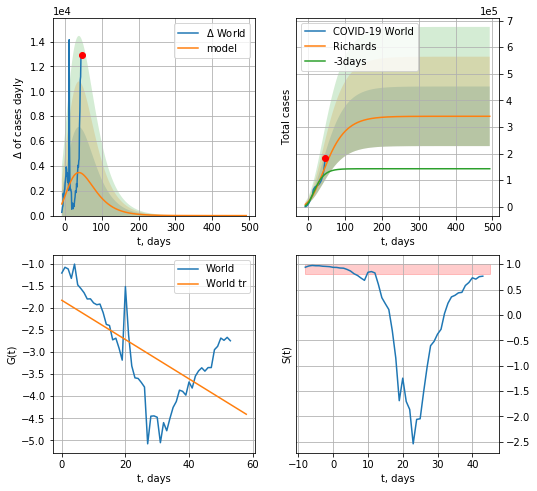

World data at: 2020-06-29
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +447 days
	 deltaDaycases: 0
	 total cases: 340076 ± 111979
	 total death: 16599 ± 16397
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


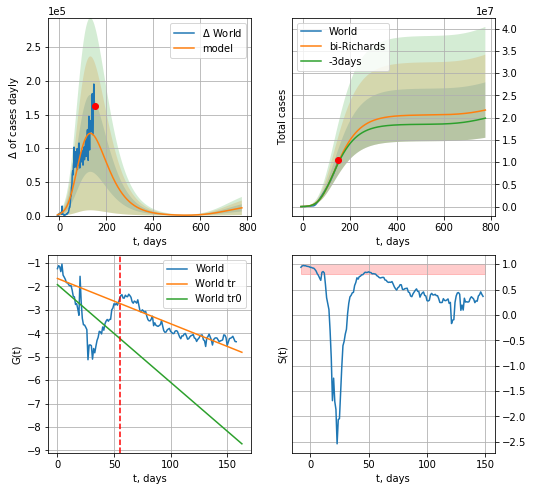

World data at: 2020-06-29
+3 day model MAPE: 0.019881
model: bi-Richards
coeffs: [ 2.02813957e+07  1.29780084e+00 -1.33590835e+02  1.26231245e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.287019
forecast at the end of period: +627 days
	 deltaDaycases: 11527
	 total cases: 21697503 ± 6227592
	 total death: 1059050 ± 911901
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.358285
 intercept: -1.926309
 slope: -0.041660
trend coefficient of determination: 0.805015
 intercept: -1.663104
 slope: -0.019318


In [83]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

160


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


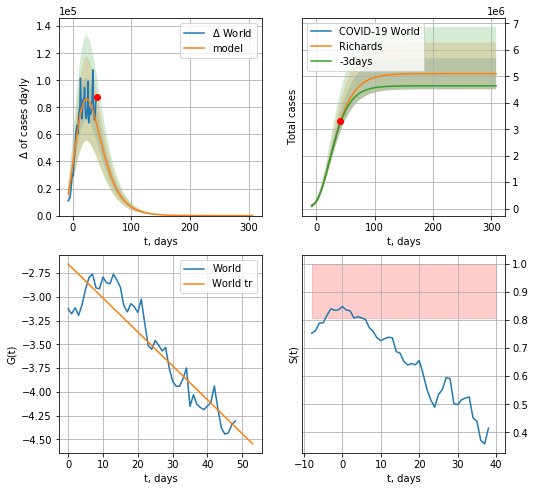

World data at: 2020-06-29
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +267 days
	 deltaDaycases: 0
	 total cases: 5102535 ± 589489
	 total death: 249053 ± 86318
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


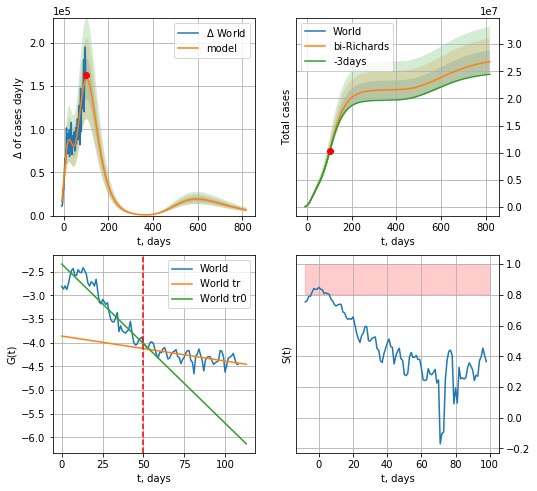

World data at: 2020-06-29
+3 day model MAPE: 0.008840
model: bi-Richards
coeffs: [ 1.65026145e+07  1.37002444e+00 -5.04558599e+01  1.85963624e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.079755
forecast at the end of period: +717 days
	 deltaDaycases: 6571
	 total cases: 26775801 ± 2135514
	 total death: 1306921 ± 312702
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.843214
 intercept: -2.336911
 slope: -0.033639
trend coefficient of determination: 0.374012
 intercept: -3.859020
 slope: -0.005276


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


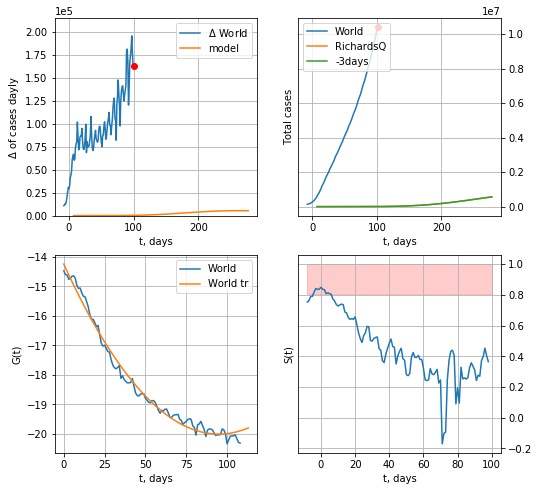

World data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.29689889e+06  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +177 days
	 deltaDaycases: 5292


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [84]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,90*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-50)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


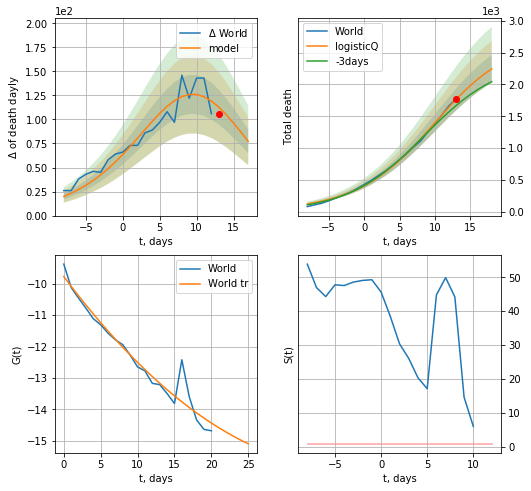

World data at: 2020-06-29
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +5 days
	 total death: 2245 ± 220
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


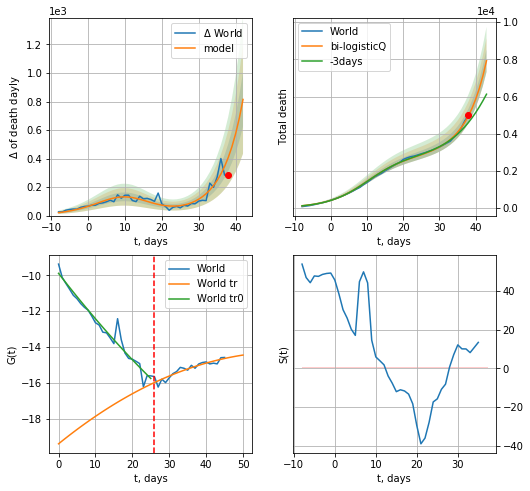

World data at: 2020-06-29
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +5 days
	 total death: 7922 ± 606
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


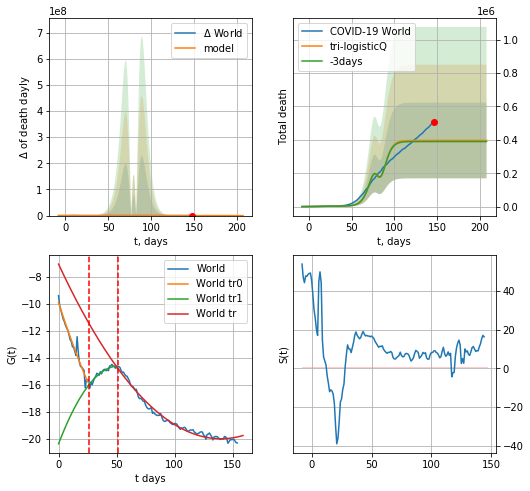

World data at: 2020-06-29
+3 day model MAPE: 0.017367
model: tri-logisticQ
coeffs: [-6.02832250e+06  1.11468946e-03 -1.33807783e+02  7.95398012e+01]
rational stdev: 0.571931
forecast at the end of period: +61 days
	 total death: 396389 ± 226707
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.984795
 intercept_: -7.030124487246116
 coeffs_: [ 0.         -0.18554326  0.00066316]


In [85]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*14-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*14-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


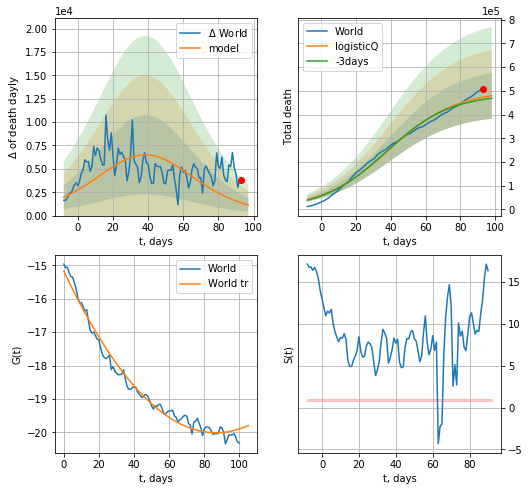

World data at: 2020-06-29
+3 day model MAPE: 0.021258
model: logisticQ
coeffs: [ 5.01899157e+05  3.14171988e-07  3.89151955e+01 -1.64967754e+05]
rational stdev: 0.201959
forecast at the end of period: +5 days
	 total death: 479507 ± 96840
trend coefficient of determination: 0.982527
 intercept_: -15.172097504972255
 coeffs_: [ 0.         -0.11163871  0.00064409]


In [86]:
x = forecastRRR("World",dfW[58:],d1,7*14-dT,1.0,False,cases='death')

In [87]:
#trend(dfSP,'SP',10)

In [88]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
121 2020-06-25  294566       0  28330.0
122 2020-06-26  294985       0  28338.0
123 2020-06-27  295549       0  28341.0
124 2020-06-28  295850       0  28343.0
125 2020-06-29  296050       0  28346.0


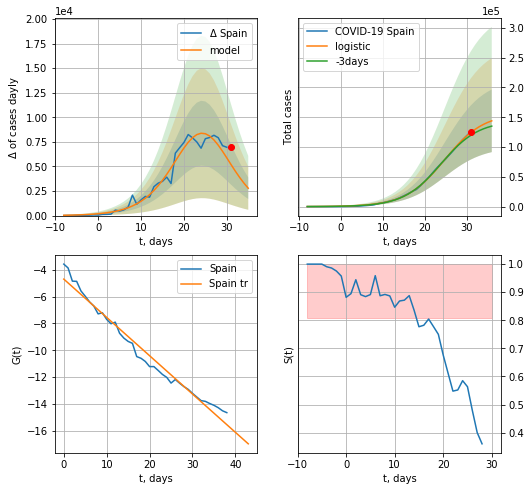

Spain data at: 2020-06-29
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +5 days
	 deltaDaycases:  2780
	 total cases:  143992 ± 52541
	 total death:  13786 ± 15091
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


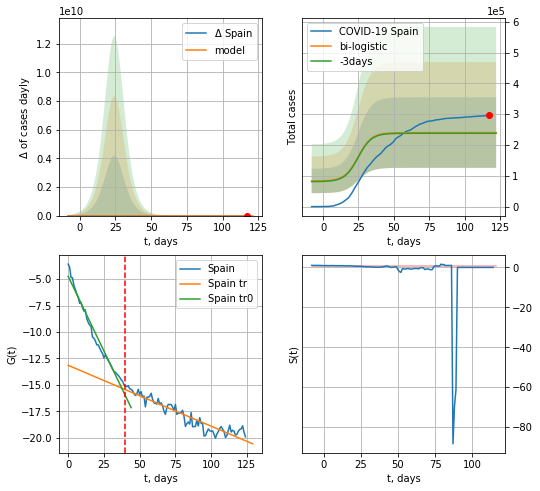

Spain data at: 2020-06-29
+3 day model MAPE: 0.009261760524635558
model: bi-logistic
coeffs:  [ 6.65686223e+04 -5.91893038e+00  1.54203472e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.4760965404755635
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  240168 ± 114343
	 total death:  22995 ± 32843
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.887791
 intercept: -13.145919
 slope: -0.057481


In [89]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*14-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

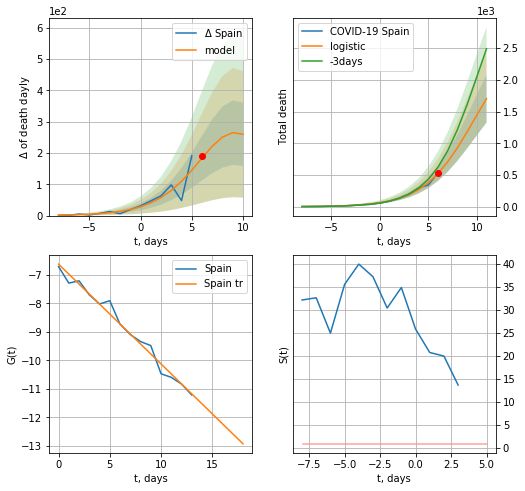

Spain data at: 2020-06-29
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +5 days
	 total death:  1703 ± 377
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide


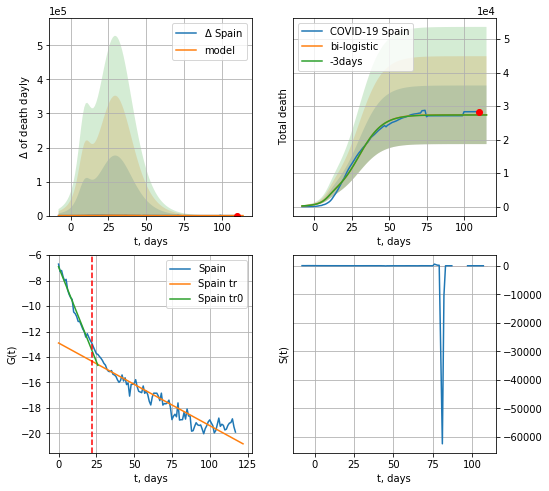

Spain data at: 2020-06-29
+3 day model MAPE: 0.002194065746246
model: bi-logistic
coeffs:  [2.46660268e+04 1.26244785e-01 2.99620297e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.31900855608344764
forecast at the end of period: +5 days
	 deltaDaydeath:  0
	 total death:  27410 ± 8744
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.906960
 intercept: -12.901241
 slope: -0.064909


In [90]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*14-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*14-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


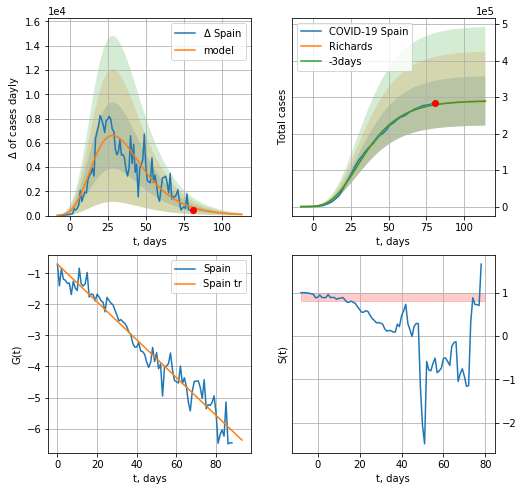

Spain data at: 2020-06-29
+3 day model MAPE: 0.002952
model: Richards
coeffs: [ 2.90928500e+05  9.45653118e+00 -5.24826533e+01  6.54766831e-03]
rational stdev: 0.233449
forecast at the end of period: +33 days
	 deltaDaycases: 94
	 total cases: 289450 ± 67571
	 total death: 27714 ± 19409
trend coefficient of determination: 0.952160
 intercept: -0.706877
 slope: -0.060858


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


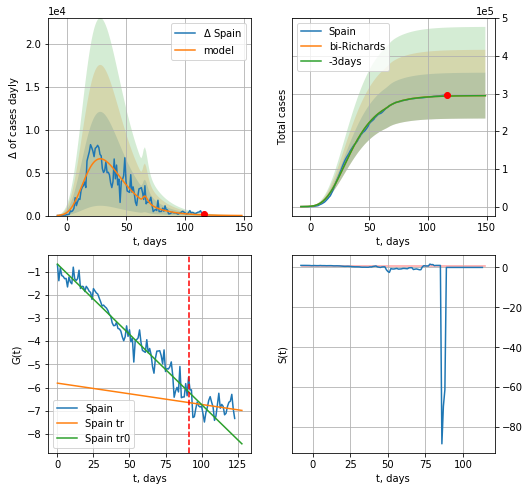

Spain data at: 2020-06-29
+3 day model MAPE: 0.000669
model: bi-Richards
coeffs: [3.66885933e+03 2.06547368e+02 5.55636224e+01 2.58661827e-03]
rational stdev: 0.206328
forecast at the end of period: +33 days
	 deltaDaycases: 10
	 total cases: 294427 ± 60748
	 total death: 28190 ± 17449
bi-Richards approximation splitting point: 91
trend coefficient of determination: 0.953910
 intercept: -0.678826
 slope: -0.060529
trend coefficient of determination: 0.044381
 intercept: -5.810867
 slope: -0.009186


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [91]:
vL = 91+1
x = forecastRR('Spain',dfSP[1:vL-1],d1,7*18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[1:],d1,7*18-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-1)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


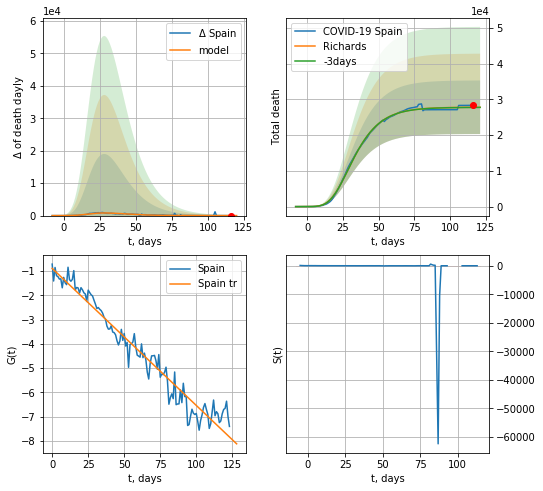

Spain data at: 2020-06-29
+3 day model MAPE: 0.001503
model: Richards
coeffs: [ 2.78269258e+04  1.03913674e+01 -3.25767027e+01  7.66533914e-03]
rational stdev: 0.269606
forecast at the end of period: +5 days
	 total death: 27809 ± 7497
trend coefficient of determination: 0.953502
 intercept: -0.894101
 slope: -0.056392


In [92]:
x = forecastRR('Spain',dfSP[1:],d1,7*14-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


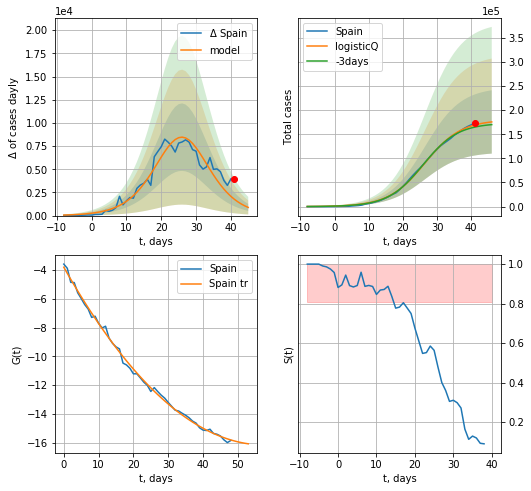

Spain data at: 2020-06-29
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +5 days
	 deltaDaycases: 880
	 total cases: 175572 ± 65650
	 total death: 16810 ± 18856
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


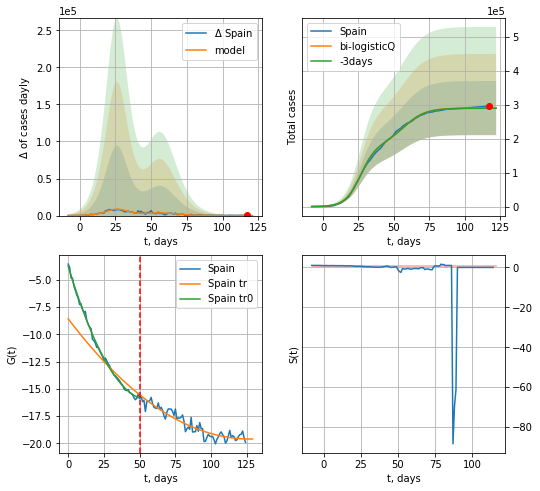

Spain data at: 2020-06-29
+3 day model MAPE: 0.002103
model: bi-logisticQ
coeffs: [ 1.10184264e+05  4.53856451e-07  5.70641793e+01 -2.86639845e+05]
rational stdev: 0.274455
forecast at the end of period: +5 days
	 deltaDaycases: 3
	 total cases: 290105 ± 79620
	 total death: 27776 ± 22869
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.889003
 intercept_: -8.582128023175263
 coeffs_: [ 0.         -0.17334854  0.00068249]


In [93]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


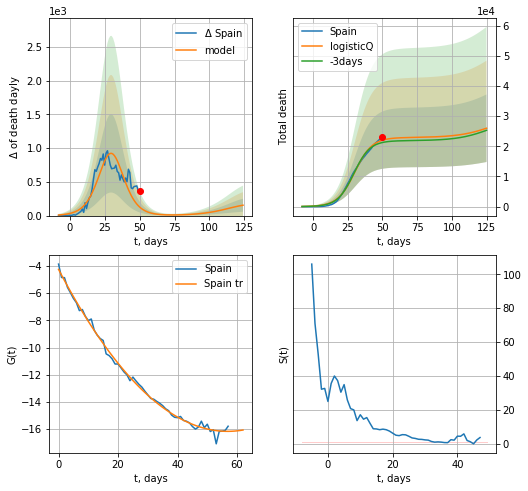

Spain data at: 2020-06-29
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +75 days
	 total death: 25969 ± 11188
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


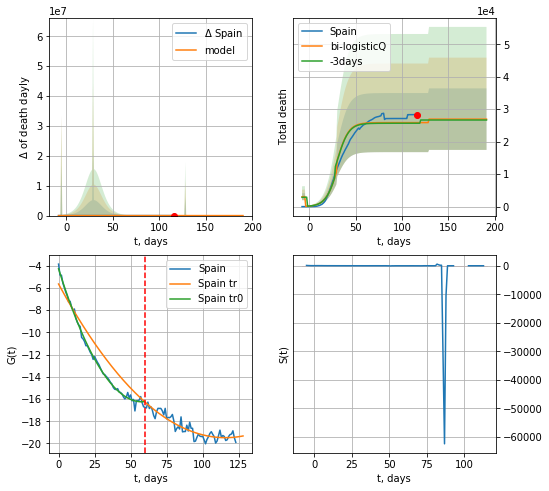

Spain data at: 2020-06-29
+3 day model MAPE: 0.007656
model: bi-logisticQ
coeffs: [2996.65867128   10.31515879   29.44219339   -4.1068517 ]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.351581
forecast at the end of period: +75 days
	 total death: 26937 ± 9470
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.848468
 intercept_: -5.6613559710512344
 coeffs_: [ 0.         -0.23877342  0.00103158]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [94]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


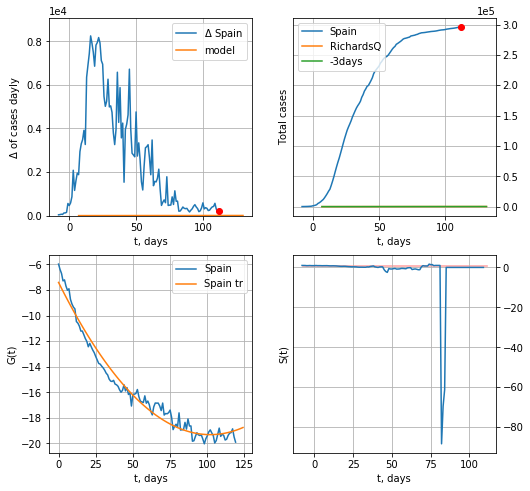

Spain data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 7.79976480e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +19 days
	 deltaDaycases: 5


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [95]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

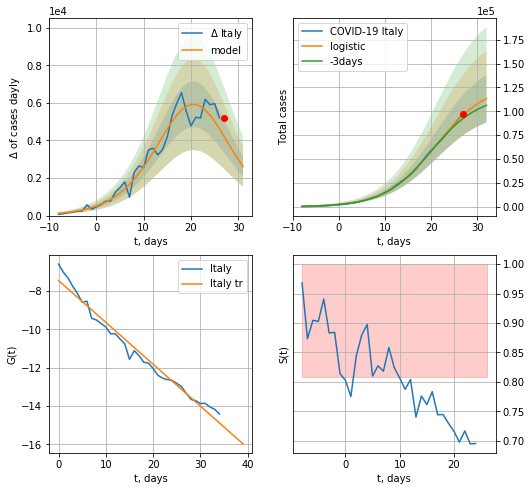

Italy data at: 2020-06-29
+3 day model MAPE: 0.045578378390248614
model: logistic
coeffs:  [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.22065596678975638
forecast at the end of period: +5 days
	 deltaDaycases:  2603
	 total cases:  113320 ± 25004
	 total death:  16375 ± 10839
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


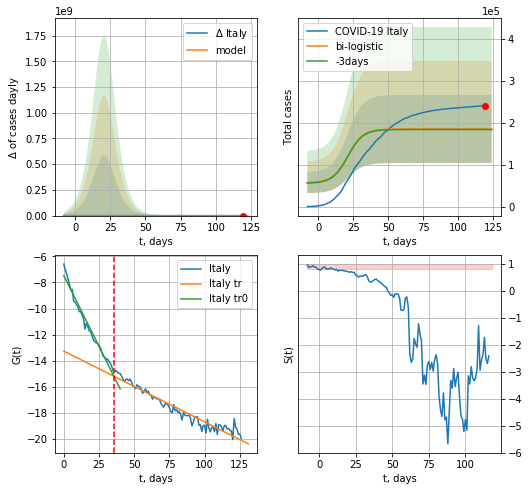

Italy data at: 2020-06-29
+3 day model MAPE: 0.007217293934745477
model: bi-logistic
coeffs:  [ 5.69069559e+04 -2.22106233e+01  1.32990809e+02] [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.43775224601591484
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  185045 ± 81004
	 total death:  26739 ± 35115
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.935622
 intercept: -13.256942
 slope: -0.054247


In [96]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,14*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,14*7-dT,x,1.0,vL=vL)

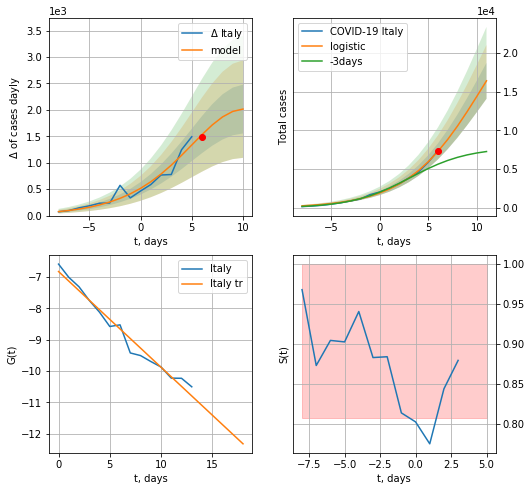

Italy data at: 2020-06-29
+3 day model MAPE: 0.44264442257961345
model: logistic
coeffs:  [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.14147817336323687
forecast at the end of period: +5 days
	 deltaDaycases:  2015
	 total cases:  16380 ± 2317
	 total death:  2367 ± 1004
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


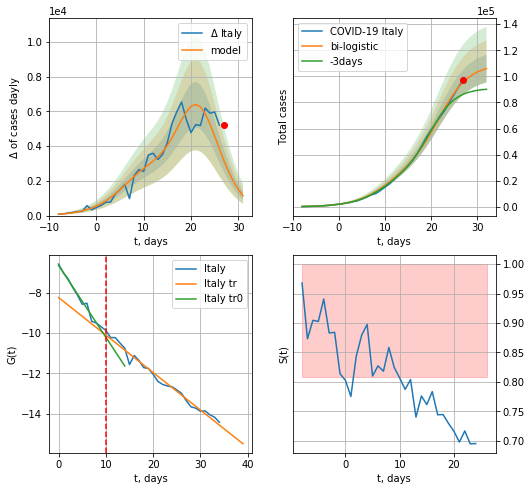

Italy data at: 2020-06-29
+3 day model MAPE: 0.1273932560599292
model: bi-logistic
coeffs:  [7.78644605e+04 3.07215535e-01 2.18188307e+01] [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.10049358500066935
forecast at the end of period: +5 days
	 deltaDaycases:  1147
	 total cases:  105961 ± 10648
	 total death:  15311 ± 4615
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


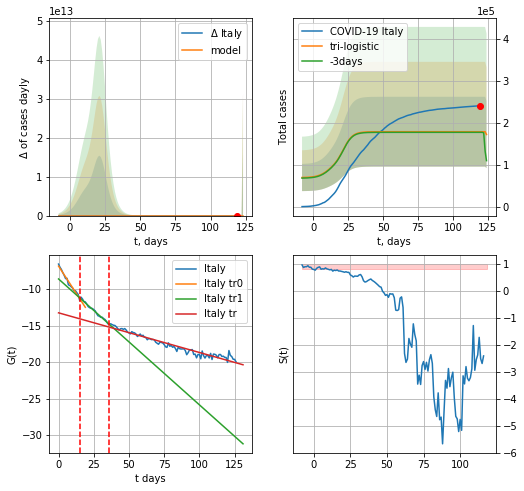

Italy data at: 2020-06-29
+3 day model MAPE: 0.008350594324028099
model: tri-logistic
coeffs:  [ 6.92907792e+04 -4.69506665e+00  1.24479031e+02] [3.14978181e+04 2.56455869e-01 1.06869163e+01 7.78644605e+04
 3.07215535e-01 2.18188307e+01]
forecast rational stdev:  0.46606386181193643
forecast at the end of period: +5 days
	 deltaDaycases:  -6545
	 total cases:  172040 ± 80181
	 total death:  24860 ± 34759
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.935622
 intercept: -13.256942
 slope: -0.054247


In [97]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*14-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*14-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*14-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

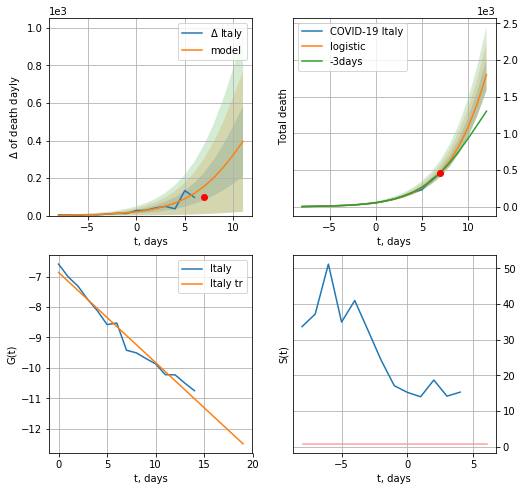

Italy data at: 2020-06-29
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +5 days
	 total death:  1803 ± 216
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


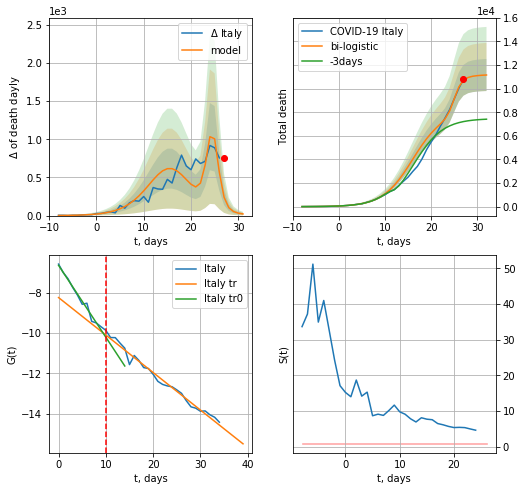

Italy data at: 2020-06-29
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +5 days
	 deltaDaydeath:  21
	 total death:  11154 ± 1358
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


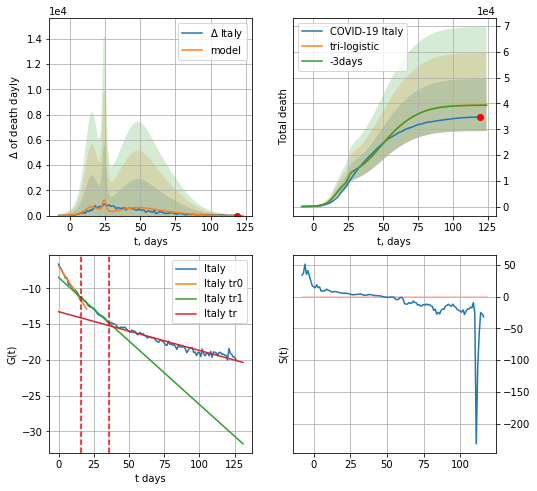

Italy data at: 2020-06-29
+3 day model MAPE: 0.002777293120985317
model: tri-logistic
coeffs:  [2.25844834e+04 1.04697561e-01 4.75965496e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.25616926558383996
forecast at the end of period: +5 days
	 deltaDaydeath:  3
	 total death:  39411 ± 10096
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.935622
 intercept: -13.256942
 slope: -0.054247


In [98]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*14-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*14-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*14-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


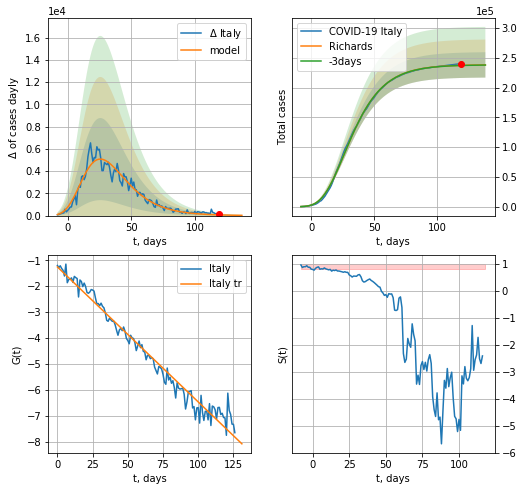

Italy data at: 2020-06-29
+3 day model MAPE: 0.001069
model: Richards
coeffs: [ 2.38667580e+05  7.12025585e+00 -5.65003551e+01  8.16267705e-03]
rational stdev: 0.089299
forecast at the end of period: +19 days
	 deltaDaycases: 21
	 total cases: 238307 ± 21280
	 total death: 34436 ± 9225
trend coefficient of determination: 0.972529
 intercept: -1.257942
 slope: -0.052118


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


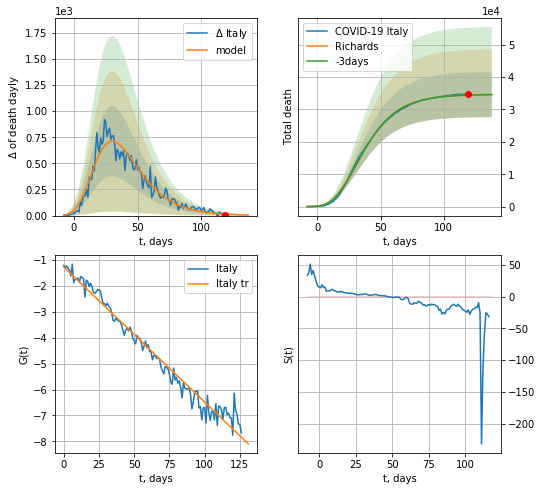

Italy data at: 2020-06-29
+3 day model MAPE: 0.000870
model: Richards
coeffs: [ 3.46834800e+04  6.15453663e+00 -5.33094285e+01  9.10216529e-03]
rational stdev: 0.201120
forecast at the end of period: +19 days
	 total death: 34599 ± 6958
trend coefficient of determination: 0.972521
 intercept: -1.266613
 slope: -0.052150


In [99]:
vL=95
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Italy',dfIT[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


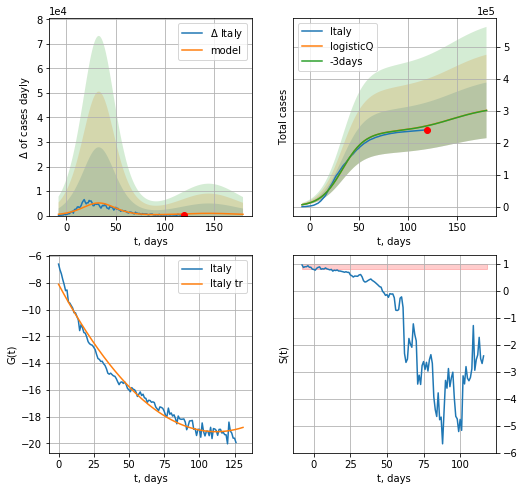

Italy data at: 2020-06-29
+3 day model MAPE: 0.001678
model: logisticQ
coeffs: [ 2.33134321e+05  2.71723652e-07  3.31939236e+01 -3.24006608e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.288863
forecast at the end of period: +61 days
	 deltaDaycases: 530
	 total cases: 301419 ± 87068
	 total death: 43556 ± 37745
trend coefficient of determination: 0.981246
 intercept_: -8.100253845768268
 coeffs_: [ 0.         -0.19714558  0.00088075]


In [100]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


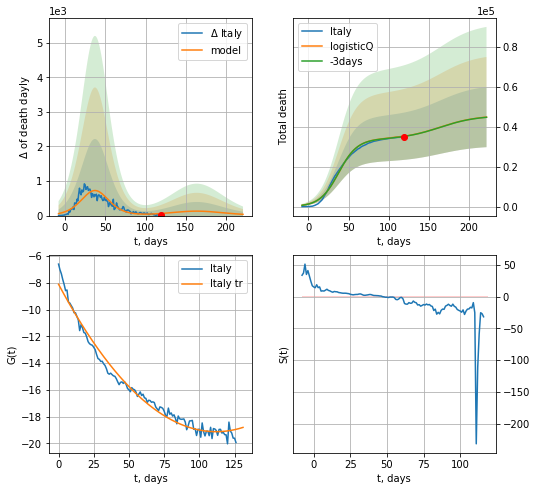

Italy data at: 2020-06-29
+3 day model MAPE: 0.002325
model: logisticQ
coeffs: [ 3.37320764e+04  2.41242094e-07  3.76253488e+01 -3.55762969e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.335933
forecast at the end of period: +103 days
	 total death: 44776 ± 15041
trend coefficient of determination: 0.981246
 intercept_: -8.100253845768268
 coeffs_: [ 0.         -0.19714558  0.00088075]


In [101]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [102]:
dT

93

FR
           date     cases  active    death
131 2020-06-25  161348.5   56245  29752.0
132 2020-06-26  162936.0   57807  29778.0
133 2020-06-27  163376.0   57509  29778.0
134 2020-06-28  163817.0   57509  29778.0
135 2020-06-29  164260.0   58798  29813.0


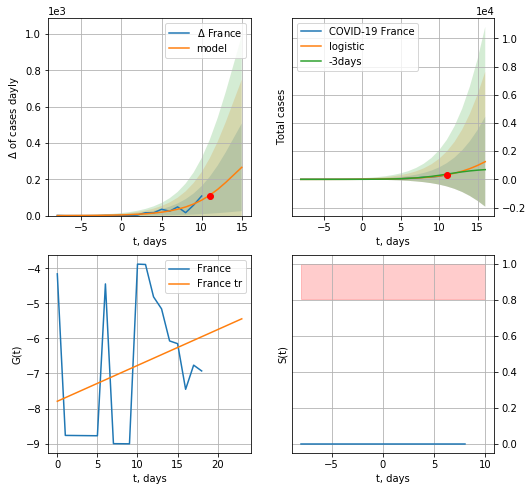

France data at: 2020-06-29
+3 day model MAPE: 0.04053337370546569
model: logistic
coeffs:  [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  2.5390562100826064
forecast at the end of period: +5 days
	 deltaDaycases:  266
	 total cases:  1254 ± 3184
	 total death:  227 ± 1729
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


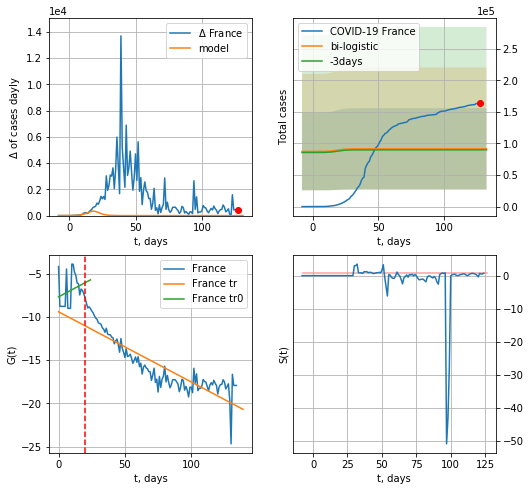

France data at: 2020-06-29
+3 day model MAPE: 0.018179402102077937
model: bi-logistic
coeffs:  [ 8.72645593e+04 -5.31469396e+00  1.39609731e+02] [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  0.7037107902167721
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  91438 ± 64346
	 total death:  16595 ± 35034
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.775947
 intercept: -9.398473
 slope: -0.081184


In [104]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,14*7-dT,1.0)
xx = forecast2('France',dfFR,d1,14*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [105]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

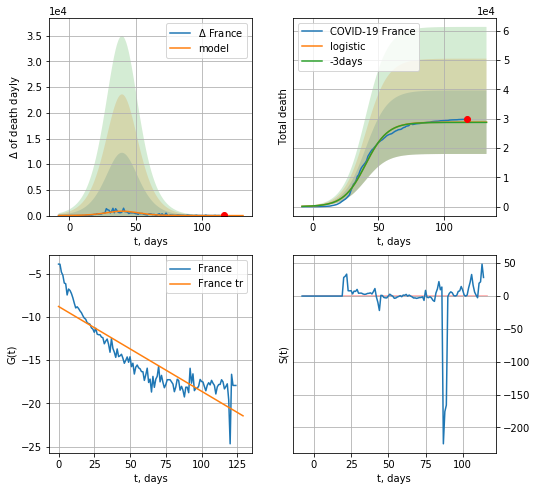

France data at: 2020-06-29
+3 day model MAPE: 0.002486685451953887
model: logistic
coeffs:  [2.88188898e+04 1.19654328e-01 4.02623072e+01]
rational stdev:  0.37626783282640086
forecast at the end of period: +15 days
	 total death:  28818 ± 10843
trend coefficient of determination: 0.791668
 intercept: -8.783332
 slope: -0.098088


In [106]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


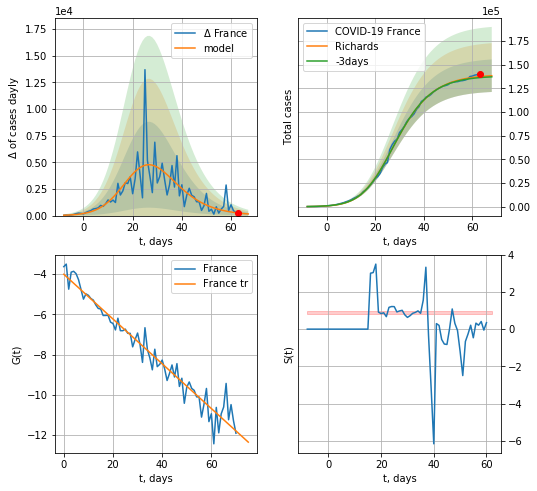

France data at: 2020-06-29
+3 day model MAPE: 0.007986
model: Richards
coeffs: [1.39530079e+05 2.42709630e-01 2.04374273e+01 4.70589839e-01]
rational stdev: 0.124192
forecast at the end of period: +5 days
	 deltaDaycases: 154
	 total cases: 138242 ± 17168
	 total death: 25090 ± 9347
trend coefficient of determination: 0.951177
 intercept: -4.003023
 slope: -0.111381


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


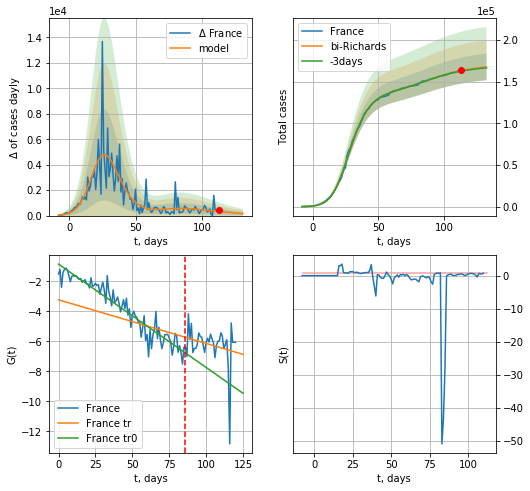

France data at: 2020-06-29
+3 day model MAPE: 0.003447
model: bi-Richards
coeffs: [ 3.19467076e+04  4.05220009e+00 -1.08111612e+01  1.13787581e-02]
rational stdev: 0.095474
forecast at the end of period: +19 days
	 deltaDaycases: 161
	 total cases: 167826 ± 16023
	 total death: 30460 ± 8724
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.904287
 intercept: -0.843366
 slope: -0.068869
trend coefficient of determination: 0.050443
 intercept: -3.222093
 slope: -0.029076


In [107]:
vL = 86+14
x = forecastRR('France',dfFR[14:vL-14],d1,14*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


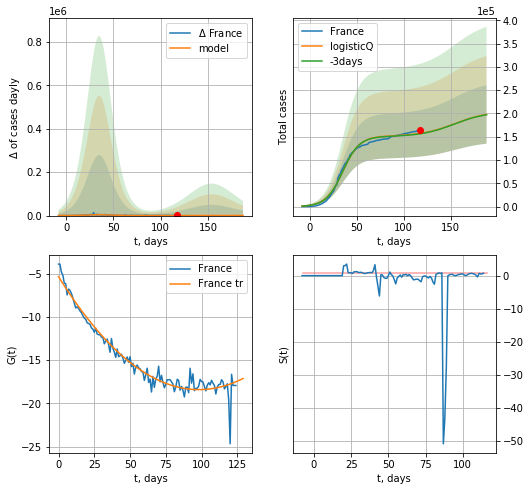

France data at: 2020-06-29
+3 day model MAPE: 0.005563
model: logisticQ
coeffs: [ 1.51274169e+05  2.78468447e-07  3.53611101e+01 -4.02291789e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.316691
forecast at the end of period: +71 days
	 deltaDaycases: 346
	 total cases: 197936 ± 62684
	 total death: 35925 ± 34131
trend coefficient of determination: 0.948975
 intercept_: -5.339765065000488
 coeffs_: [ 0.         -0.26606984  0.00135471]


In [108]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


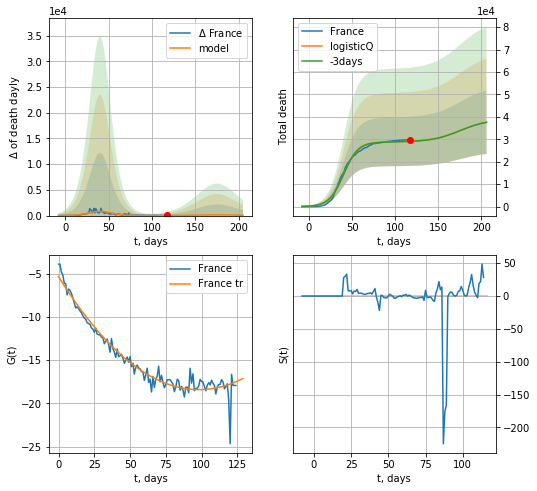

France data at: 2020-06-29
+3 day model MAPE: 0.002534
model: logisticQ
coeffs: [ 2.88187584e+04  3.82112903e-07  4.02625742e+01 -3.12989442e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.376335
forecast at the end of period: +89 days
	 total death: 37621 ± 14158
trend coefficient of determination: 0.948975
 intercept_: -5.339765065000488
 coeffs_: [ 0.         -0.26606984  0.00135471]


In [109]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [110]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [111]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
122 2020-06-25  193785    7973  9012.0
123 2020-06-26  194399    8273  9026.0
124 2020-06-27  194689    8163  9026.0
125 2020-06-28  194864    8135  9029.0
126 2020-06-29  195392    7251  9041.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


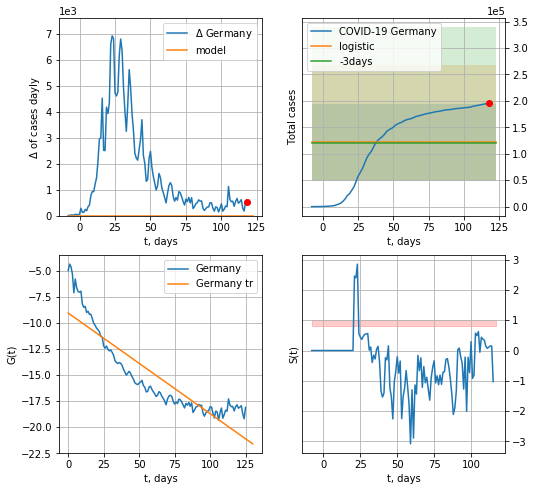

Germany data at: 2020-06-29
+3 day model MAPE: 0.014820492521644682
model: logistic
coeffs:  [ 1.21587370e+05 -4.76058554e+00  1.42493250e+02]
rational stdev:  0.5989063787753236
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  121587 ± 72819
	 total death:  5625 ± 10106
trend coefficient of determination: 0.806214
 intercept: -9.049370
 slope: -0.096478


In [112]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*14-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


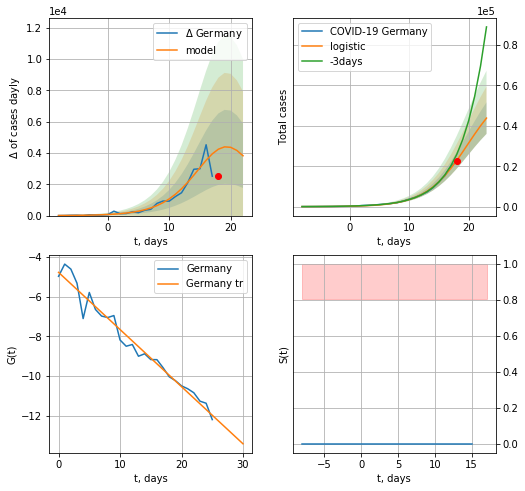

Germany data at: 2020-06-29
+3 day model MAPE: 0.18326880785963318
model: logistic
coeffs:  [6.15503822e+04 2.86340376e-01 1.98405527e+01]
rational stdev:  0.17812668621755098
forecast at the end of period: +5 days
	 deltaDaycases:  3820
	 total cases:  43818 ± 7805
	 total death:  2027 ± 1083
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp


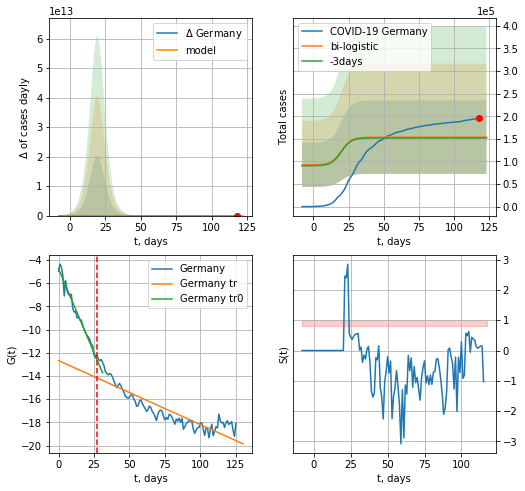

Germany data at: 2020-06-29
+3 day model MAPE: 0.011872639517733149
model: bi-logistic
coeffs:  [ 7.37727036e+04 -4.23030927e+00  1.27837753e+02] [6.15503822e+04 2.86340376e-01 1.98405527e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.5287071840112861
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  153766 ± 81297
	 total death:  7114 ± 11283
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.800662
 intercept: -12.673547
 slope: -0.055170


In [113]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,14*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*14-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
122 2020-06-25  193785    7973  9012.0
123 2020-06-26  194399    8273  9026.0
124 2020-06-27  194689    8163  9026.0
125 2020-06-28  194864    8135  9029.0
126 2020-06-29  195392    7251  9041.0


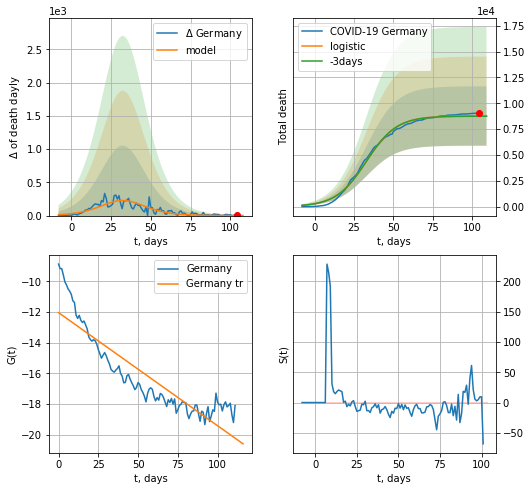

Germany data at: 2020-06-29
+3 day model MAPE: 0.0028270956087076363
model: logistic
coeffs:  [8.77085223e+03 1.03608995e-01 3.28494445e+01]
rational stdev:  0.3275373304453264
forecast at the end of period: +5 days
	 total death:  8767 ± 2871
trend coefficient of determination: 0.802687
 intercept: -12.040034
 slope: -0.073619


In [114]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,14*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


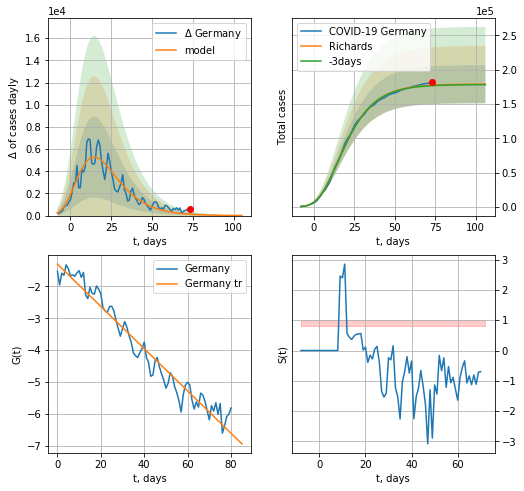

Germany data at: 2020-06-29
+3 day model MAPE: 0.003916
model: Richards
coeffs: [ 1.79110364e+05  9.11571266e+00 -4.38812227e+01  8.82260552e-03]
rational stdev: 0.155516
forecast at the end of period: +33 days
	 deltaDaycases: 9
	 total cases: 178992 ± 27836
	 total death: 8282 ± 3863
trend coefficient of determination: 0.956452
 intercept: -1.304650
 slope: -0.066180


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


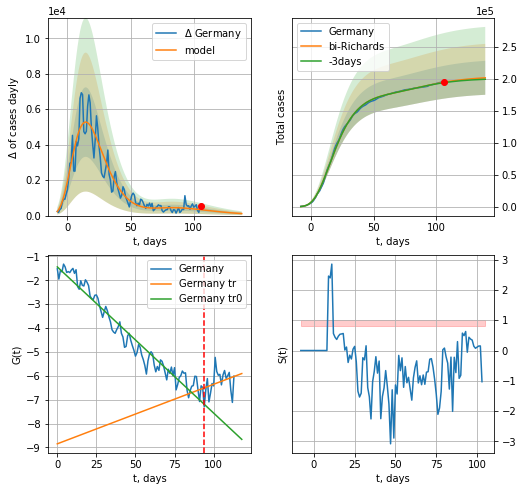

Germany data at: 2020-06-29
+3 day model MAPE: 0.003627
model: bi-Richards
coeffs: [ 2.52322240e+04  5.27954294e+00 -2.08902766e+01  8.26782120e-03]
rational stdev: 0.131539
forecast at the end of period: +33 days
	 deltaDaycases: 113
	 total cases: 201648 ± 26524
	 total death: 9330 ± 3681
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950724
 intercept: -1.441576
 slope: -0.061196
trend coefficient of determination: 0.081425
 intercept: -8.848675
 slope: 0.024927


In [115]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


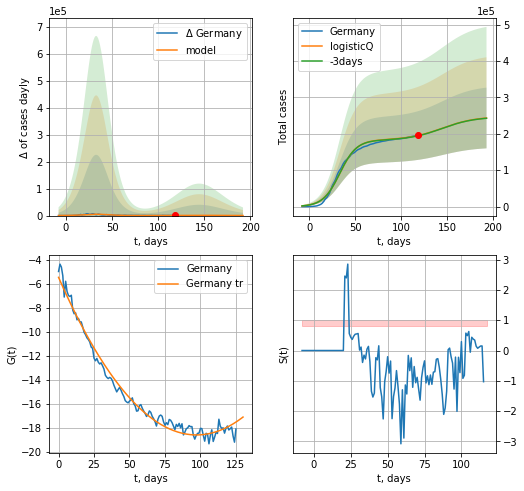

Germany data at: 2020-06-29
+3 day model MAPE: 0.003609
model: logisticQ
coeffs: [ 1.82884427e+05  2.53382633e-07  3.32294956e+01 -4.30134184e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342539
forecast at the end of period: +75 days
	 deltaDaycases: 225
	 total cases: 243347 ± 83355
	 total death: 11259 ± 11569
trend coefficient of determination: 0.983003
 intercept_: -5.462072366929537
 coeffs_: [ 0.         -0.27005981  0.00138867]


In [116]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


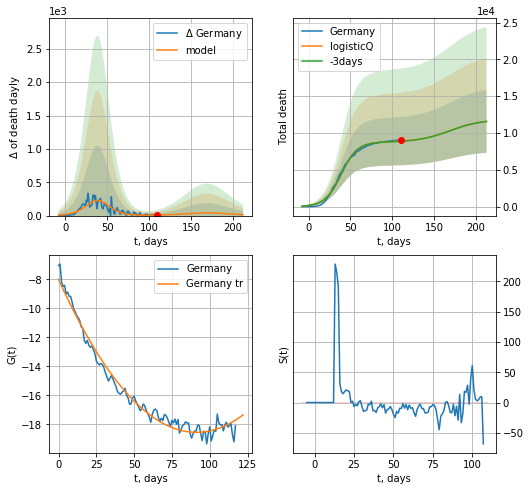

Germany data at: 2020-06-29
+3 day model MAPE: 0.002838
model: logisticQ
coeffs: [ 8.76932486e+03  4.71350167e-07  3.88472830e+01 -2.20081135e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.368933
forecast at the end of period: +103 days
	 total death: 11586 ± 4274
trend coefficient of determination: 0.980069
 intercept_: -7.9972203678356175
 coeffs_: [ 0.         -0.23117353  0.00126727]


In [117]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
116 2020-06-25  2504588  1325515  126780.0
117 2020-06-26  2552956  1356613  127640.0
118 2020-06-27  2596770  1387124  128152.0
119 2020-06-28  2637077  1415184  128437.0
120 2020-06-29  2681811  1435851  128783.0


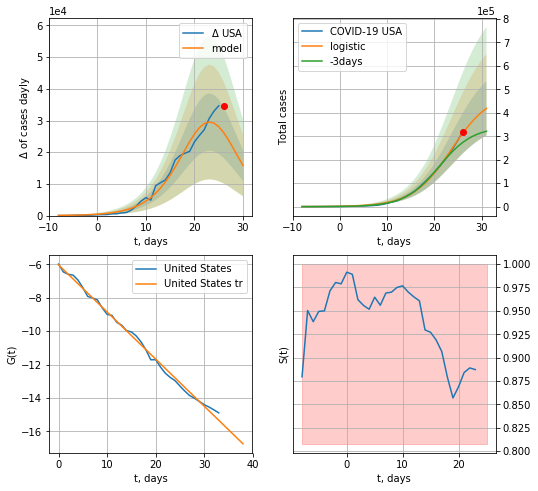

USA data at: 2020-06-29
+3 day model MAPE: 0.17962965715206392
model: logistic
coeffs:  [4.89025783e+05 2.41973857e-01 2.36121759e+01]
rational stdev:  0.2760702577358041
forecast at the end of period: +5 days
	 deltaDaycases:  15820
	 total cases:  418919 ± 115651
	 total death:  20116 ± 16660
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


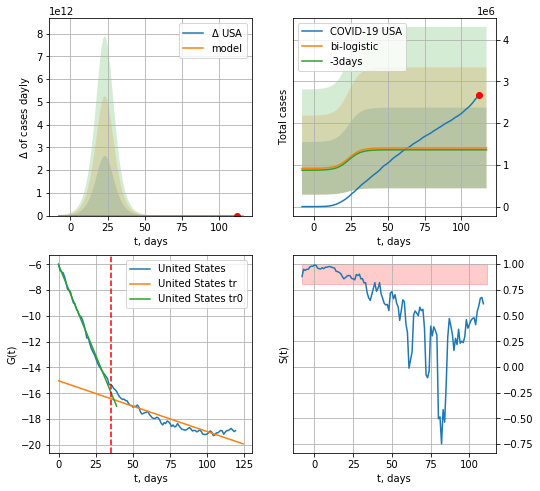

USA data at: 2020-06-29
+3 day model MAPE: 0.033064119187414726
model: bi-logistic
coeffs:  [ 7.33552553e+05 -9.49328542e+00  2.37604465e+02] [4.89025783e+05 2.41973857e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6877805805380713
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1405966 ± 966996
	 total death:  67515 ± 139306
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.838827
 intercept: -15.032310
 slope: -0.039394


In [118]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,14*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,14*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

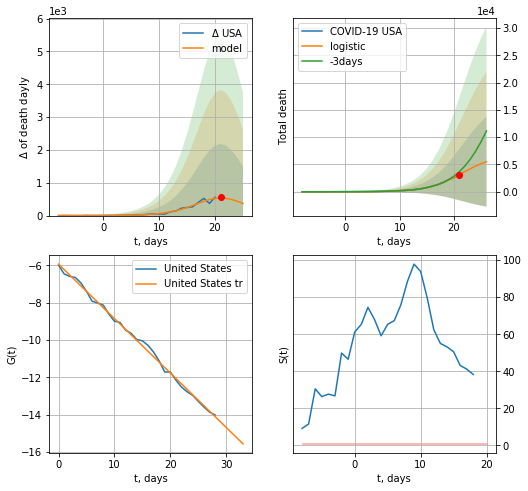

USA data at: 2020-06-29
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +5 days
	 total death:  5510 ± 8226
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


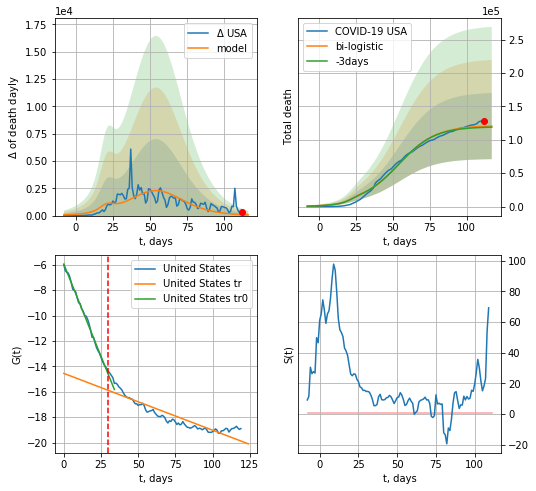

USA data at: 2020-06-29
+3 day model MAPE: 0.012978035787640181
model: bi-logistic
coeffs:  [1.14504494e+05 7.98237253e-02 5.44011101e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.41065210865385193
forecast at the end of period: +5 days
	 deltaDaydeath:  63
	 total death:  120569 ± 49512
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.830942
 intercept: -14.551824
 slope: -0.044715


In [119]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*14-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*14-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


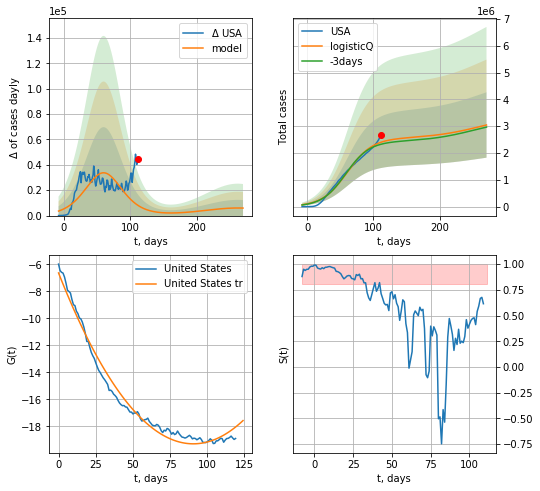

USA data at: 2020-06-29
+3 day model MAPE: 0.033163
model: logisticQ
coeffs: [ 2.54421601e+06  1.83251023e-07  6.02518179e+01 -2.88360884e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.400569
forecast at the end of period: +159 days
	 deltaDaycases: 5926
	 total cases: 3044746 ± 1219629
	 total death: 146211 ± 175702
trend coefficient of determination: 0.982968
 intercept_: -6.646420073989876
 coeffs_: [ 0.         -0.27914756  0.00154073]


In [120]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


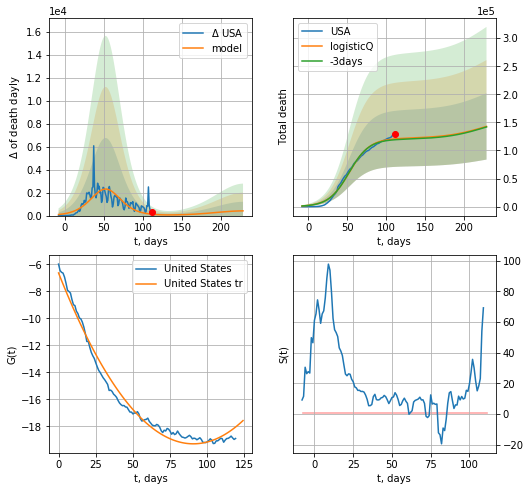

USA data at: 2020-06-29
+3 day model MAPE: 0.012692
model: logisticQ
coeffs: [ 1.21527624e+05  2.76161027e-07  5.26481920e+01 -2.75937686e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.413516
forecast at the end of period: +117 days
	 total death: 142853 ± 59072
trend coefficient of determination: 0.982968
 intercept_: -6.646420073989876
 coeffs_: [ 0.         -0.27914756  0.00154073]


In [121]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


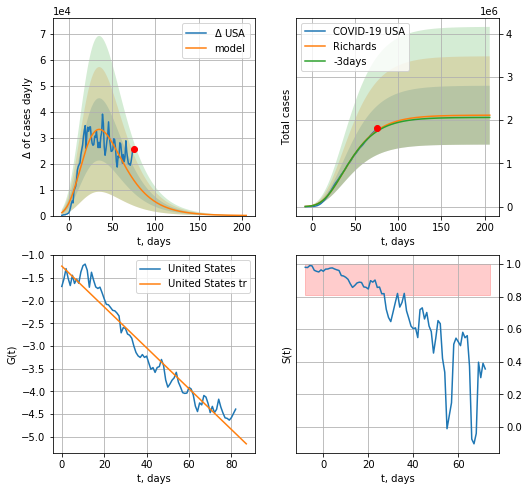

USA data at: 2020-06-29
+3 day model MAPE: 0.011173
model: Richards
coeffs: [ 2.11547108e+06  4.55700208e+00 -7.32276786e+01  9.40292240e-03]
rational stdev: 0.321873
forecast at the end of period: +131 days
	 deltaDaycases: 62
	 total cases: 2114039 ± 680451
	 total death: 101518 ± 98027
trend coefficient of determination: 0.952323
 intercept: -1.242025
 slope: -0.044961


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


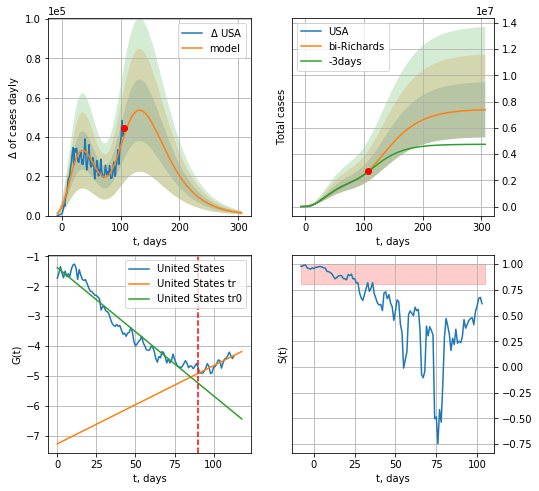

USA data at: 2020-06-29
+3 day model MAPE: 0.016880
model: bi-Richards
coeffs: [ 5.31676036e+06  1.69076247e+00 -1.94465450e+01  1.59367467e-02]
rational stdev: 0.284865
forecast at the end of period: +201 days
	 deltaDaycases: 1366
	 total cases: 7381975 ± 2102866
	 total death: 354489 ± 302944
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.944841
 intercept: -1.377587
 slope: -0.042831
trend coefficient of determination: 0.719029
 intercept: -7.262169
 slope: 0.026127


In [122]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*42-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


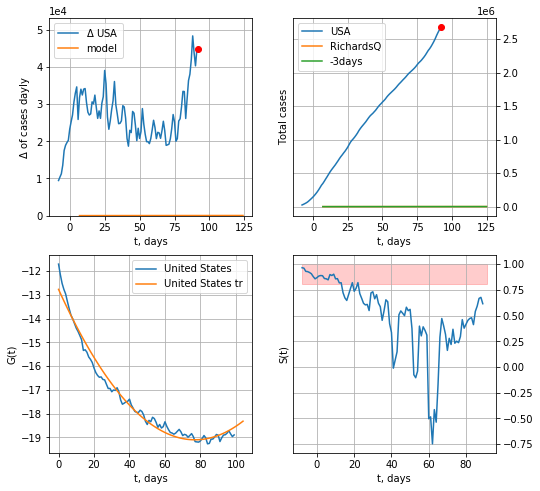

USA data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.52188019e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +33 days
	 deltaDaycases: 30


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [123]:
x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
120 2020-06-25  307980       0  43230.0
121 2020-06-26  309360       0  43414.0
122 2020-06-27  310250       0  43514.0
123 2020-06-28  311151       0  43550.0
124 2020-06-29  311965       0  43575.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


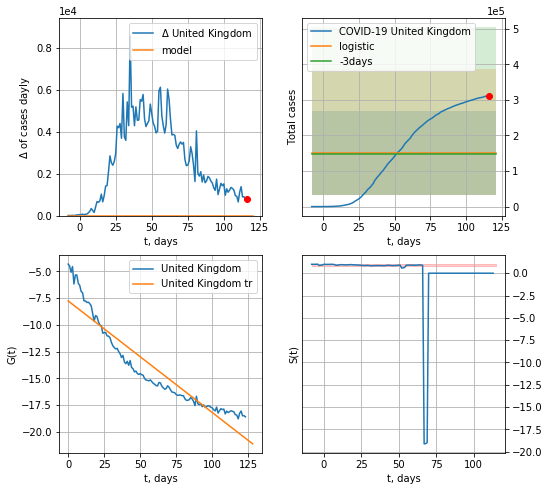

United Kingdom data at: 2020-06-29
+3 day model MAPE: 0.02658731646069811
model: logistic
coeffs:  [ 1.51529160e+05 -8.87674266e+00  2.30397156e+02]
rational stdev:  0.7773498902022458
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  151529 ± 117791
	 total death:  21165 ± 49357
trend coefficient of determination: 0.883085
 intercept: -7.761805
 slope: -0.104371


In [124]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*14-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


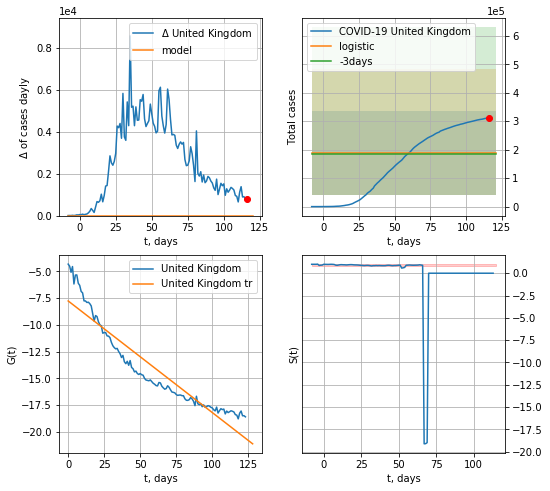

United Kingdom data at: 2020-06-29
+3 day model MAPE: 0.02658731646069811
model: logistic
coeffs:  [ 1.51529160e+05 -8.87674266e+00  2.30397156e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7773498902022458
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  189411 ± 147238
	 total death:  26456 ± 61696
trend coefficient of determination: 0.883085
 intercept: -7.761805
 slope: -0.104371


In [125]:
x = forecast('United Kingdom',dfGB[:],d1,14*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


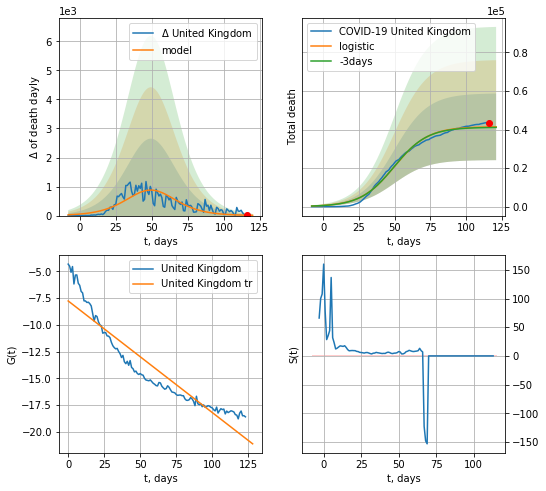

United Kingdom data at: 2020-06-29
+3 day model MAPE: 0.007160214046951757
model: logistic
coeffs:  [4.14817251e+04 8.48318487e-02 4.98095056e+01]
rational stdev:  0.4176367493663481
forecast at the end of period: +5 days
	 total death:  41383 ± 17283
trend coefficient of determination: 0.883085
 intercept: -7.761805
 slope: -0.104371


In [126]:
x = forecast('United Kingdom',dfGB[:],d1,14*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


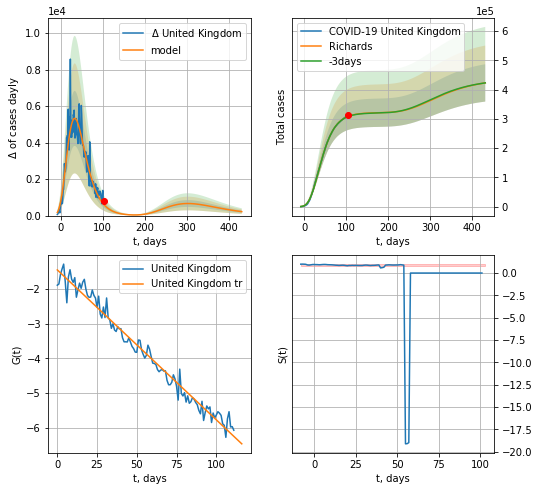

United Kingdom data at: 2020-06-29
+3 day model MAPE: 0.002031
model: Richards
coeffs: [ 3.21668852e+05  4.48134261e+00 -6.77655635e+01  1.00998630e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.150762
forecast at the end of period: +327 days
	 deltaDaycases: 216
	 total cases: 423299 ± 63817
	 total death: 59126 ± 26741
trend coefficient of determination: 0.975351
 intercept: -1.441834
 slope: -0.043334


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


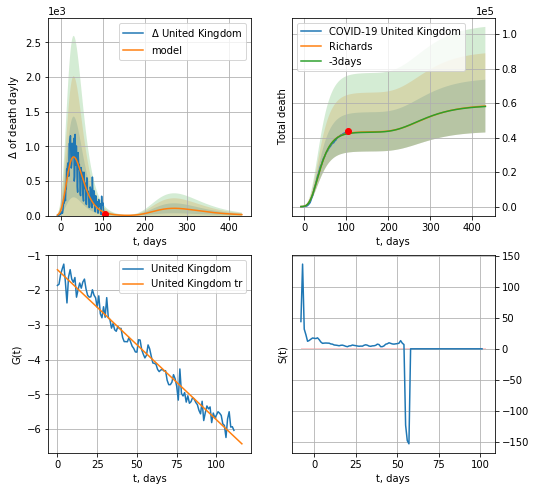

United Kingdom data at: 2020-06-29
+3 day model MAPE: 0.004242
model: Richards
coeffs: [ 4.33802597e+04  7.91339617e+00 -6.28764222e+01  6.72906475e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.262515
forecast at the end of period: +327 days
	 total death: 58287 ± 15301
trend coefficient of determination: 0.975229
 intercept: -1.412001
 slope: -0.043182


In [127]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


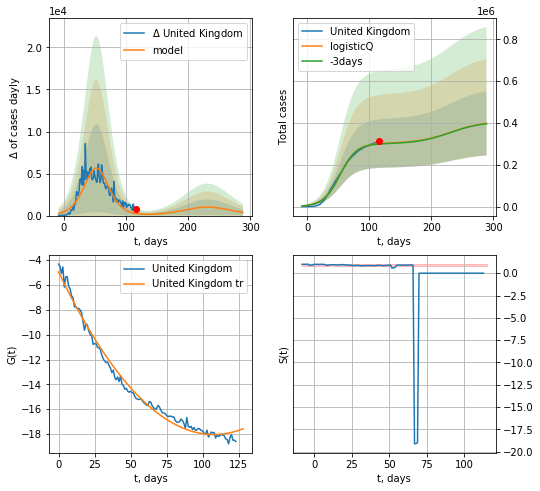

United Kingdom data at: 2020-06-29
+3 day model MAPE: 0.006152
model: logisticQ
coeffs: [ 3.02327249e+05  3.05510727e-07  5.30588269e+01 -2.44636444e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.385941
forecast at the end of period: +173 days
	 deltaDaycases: 375
	 total cases: 398442 ± 153775
	 total death: 55654 ± 64437
trend coefficient of determination: 0.988811
 intercept_: -4.940958909030906
 coeffs_: [ 0.         -0.24310447  0.00112792]


In [128]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


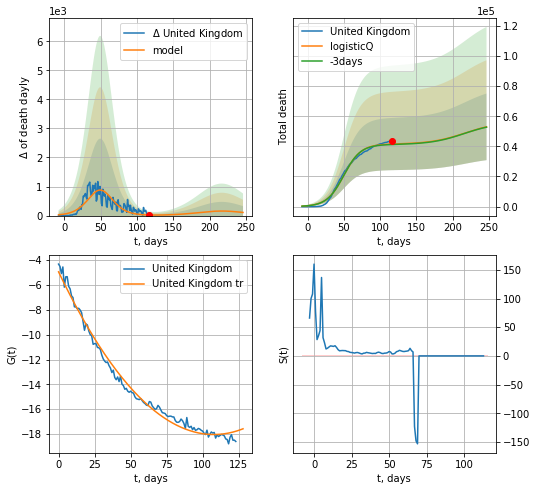

United Kingdom data at: 2020-06-29
+3 day model MAPE: 0.007241
model: logisticQ
coeffs: [ 4.14812685e+04  2.44868545e-07  4.98103248e+01 -3.46286459e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.417664
forecast at the end of period: +131 days
	 total death: 52965 ± 22121
trend coefficient of determination: 0.988811
 intercept_: -4.940958909030906
 coeffs_: [ 0.         -0.24310447  0.00112792]


In [129]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [125]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [126]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [127]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [128]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [129]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [130]:
dT

93

DK
           date    cases  active  death
119 2020-06-25  12636.0     573  603.0
120 2020-06-26  12675.0     563  604.0
121 2020-06-27  12675.3     563  604.0
122 2020-06-28  12675.6     563  604.0
123 2020-06-29  12751.0     534  605.0


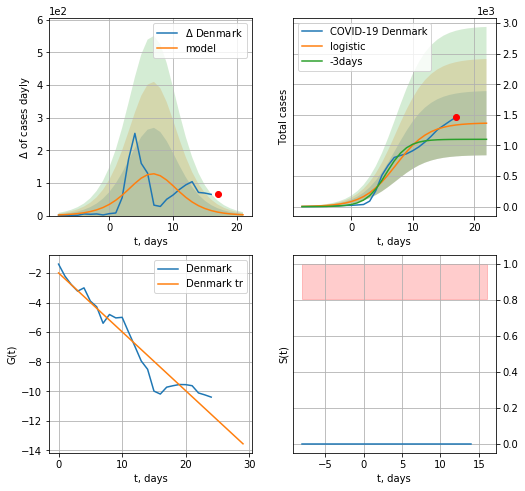

Denmark data at: 2020-06-29
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  1364 ± 524
	 total death:  64 ± 73
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


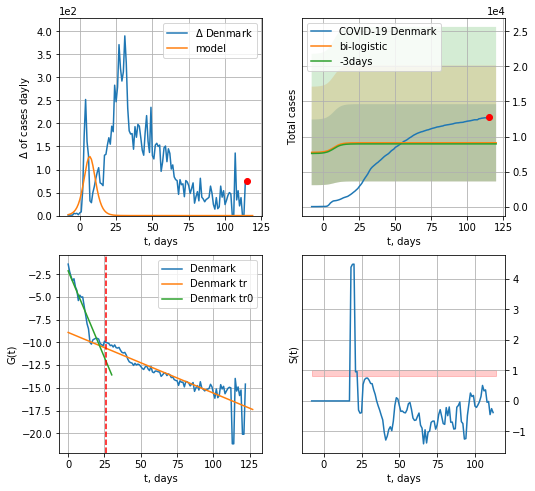

Denmark data at: 2020-06-29
+3 day model MAPE: 0.01779570275273878
model: bi-logistic
coeffs:  [6191.76036803  -10.87487149  125.70394996] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6050599074628905
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  9109 ± 5511
	 total death:  432 ± 784
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.758622
 intercept: -8.903542
 slope: -0.066690


In [133]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*14-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,14*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


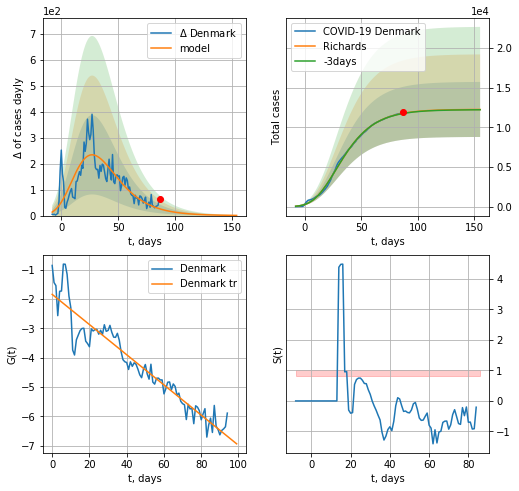

Denmark data at: 2020-06-29
+3 day model MAPE: 0.002072
model: Richards
coeffs: [ 1.22659587e+04  7.57412632e-01 -2.17374814e+01  7.08529608e-02]
rational stdev: 0.283101
forecast at the end of period: +68 days
	 deltaDaycases: 0
	 total cases: 12252 ± 3468
	 total death: 581 ± 493
trend coefficient of determination: 0.907675
 intercept: -1.842227
 slope: -0.051439


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


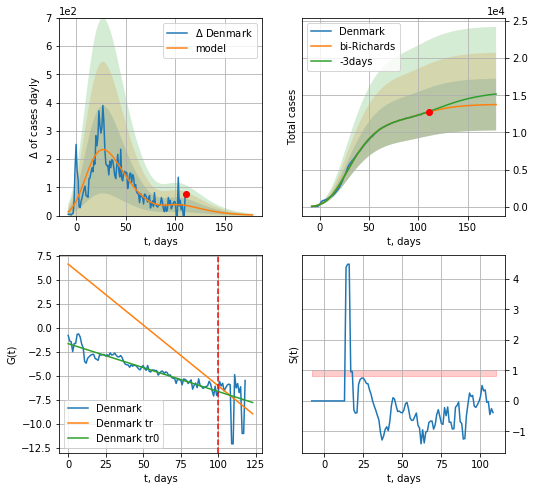

Denmark data at: 2020-06-29
+3 day model MAPE: 0.005664
model: bi-Richards
coeffs: [1.52797960e+03 1.51594501e+00 4.44114868e+01 3.44270184e-02]
rational stdev: 0.253500
forecast at the end of period: +68 days
	 deltaDaycases: 2
	 total cases: 13751 ± 3485
	 total death: 652 ± 495
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.913733
 intercept: -1.623921
 slope: -0.049803
trend coefficient of determination: 0.090316
 intercept: 6.657358
 slope: -0.126659


In [134]:
vL = 100+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,23*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,23*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


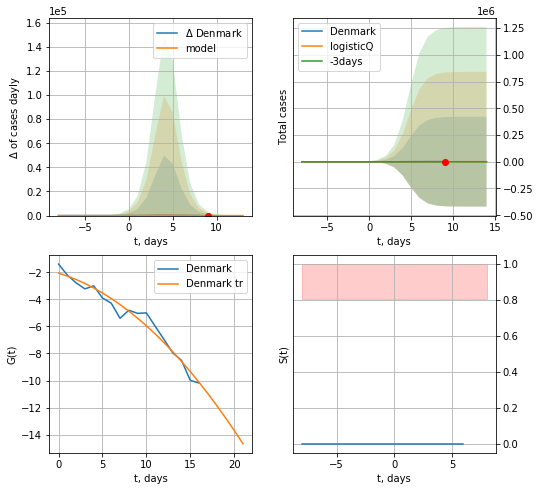

Denmark data at: 2020-06-29
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 862 ± 420247
	 total death: 40 ± 58472
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


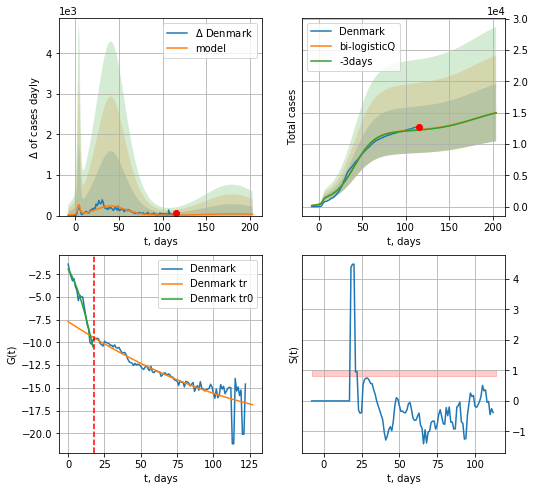

Denmark data at: 2020-06-29
+3 day model MAPE: 0.005672
model: bi-logisticQ
coeffs: [ 1.12027914e+04  1.90257331e-07  4.12148235e+01 -4.46695621e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.303996
forecast at the end of period: +89 days
	 deltaDaycases: 33
	 total cases: 14998 ± 4559
	 total death: 711 ± 648
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.814082
 intercept_: -7.718111996196523
 coeffs_: [ 0.         -0.10437617  0.00025573]


In [135]:
x = forecastRRR('Denmark',dfDK[:18],d1,14*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date   cases  active  death
120 2020-06-25  8788.5     401  249.0
121 2020-06-26  8832.0     445  249.0
122 2020-06-27  8846.0     459  249.0
123 2020-06-28  8855.0     468  249.0
124 2020-06-29  8862.0     475  249.0


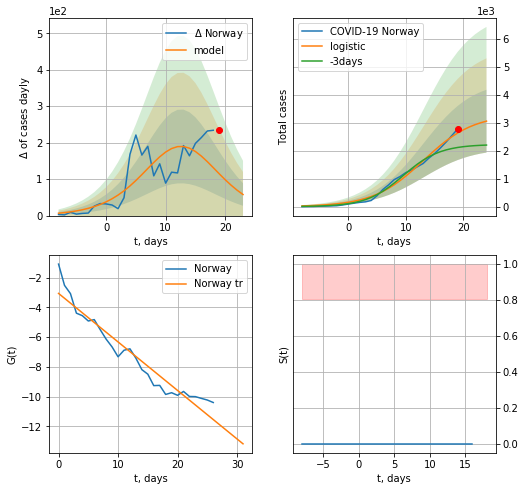

Norway data at: 2020-06-29
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +5 days
	 deltaDaycases:  57
	 total cases:  3052 ± 1121
	 total death:  85 ± 93
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


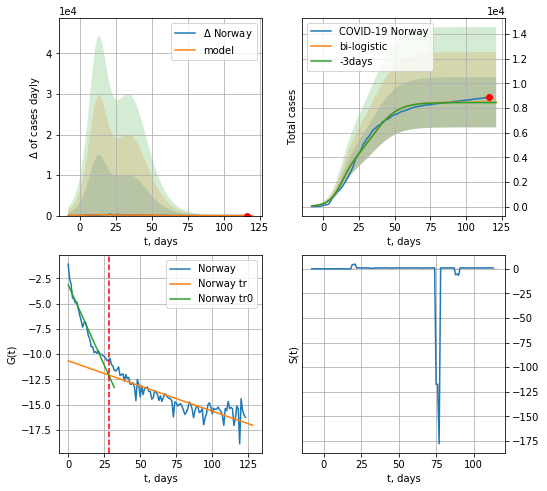

Norway data at: 2020-06-29
+3 day model MAPE: 0.003305379615217288
model: bi-logistic
coeffs:  [5.16603349e+03 1.16520671e-01 3.53452641e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2404866301825143
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  8463 ± 2035
	 total death:  237 ± 170
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.753229
 intercept: -10.655521
 slope: -0.049744


In [136]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*14-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,14*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

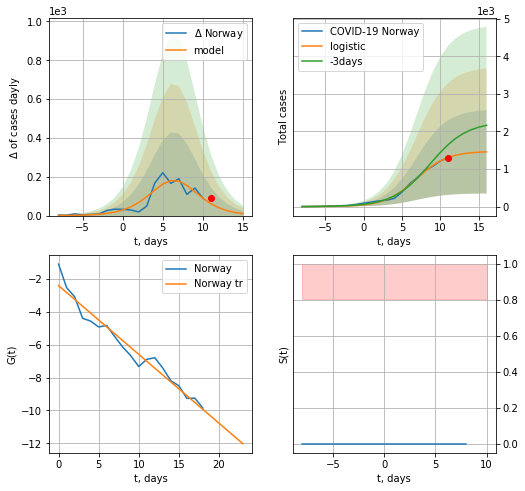

Norway data at: 2020-06-29
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +5 days
	 deltaDaycases:  9
	 total cases:  1458 ± 1108
	 total death:  40 ± 91
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


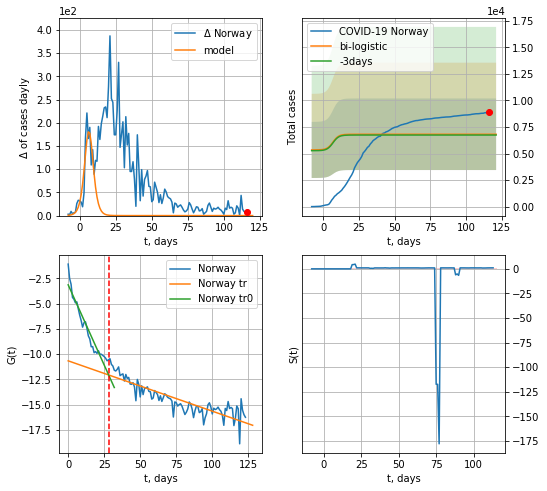

Norway data at: 2020-06-29
+3 day model MAPE: 0.010819161504819647
model: bi-logistic
coeffs:  [ 4.74401255e+03 -2.44292037e+00  1.50098902e+02] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.49462960436669057
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  6811 ± 3369
	 total death:  191 ± 283
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.753229
 intercept: -10.655521
 slope: -0.049744


In [137]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*14-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,14*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


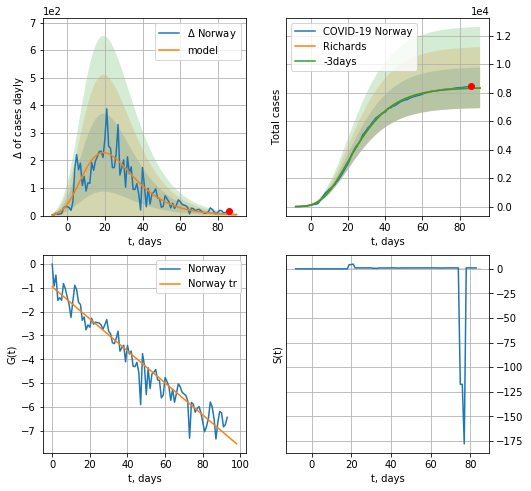

Norway data at: 2020-06-29
+3 day model MAPE: 0.001935
model: Richards
coeffs: [ 8.38068863e+03  6.64890159e+00 -4.05409633e+01  1.11949148e-02]
rational stdev: 0.171145
forecast at the end of period: +5 days
	 deltaDaycases: 3
	 total cases: 8338 ± 1427
	 total death: 234 ± 120
trend coefficient of determination: 0.939501
 intercept: -0.963878
 slope: -0.067146


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


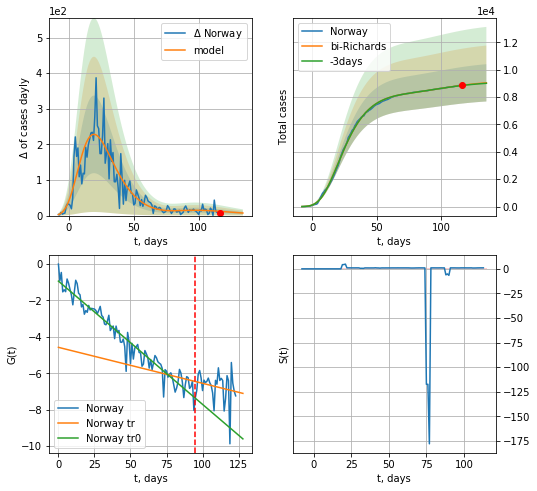

Norway data at: 2020-06-29
+3 day model MAPE: 0.001489
model: bi-Richards
coeffs: [ 8.36658382e+02  4.18980096e+00 -7.42148790e-01  1.05166578e-02]
rational stdev: 0.150586
forecast at the end of period: +19 days
	 deltaDaycases: 7
	 total cases: 9037 ± 1360
	 total death: 253 ± 114
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.940559
 intercept: -0.944476
 slope: -0.067617
trend coefficient of determination: 0.038306
 intercept: -4.577208
 slope: -0.019729


In [139]:
vL = 95
x = forecastRR('Norway',dfNG[:vL],d1,14*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


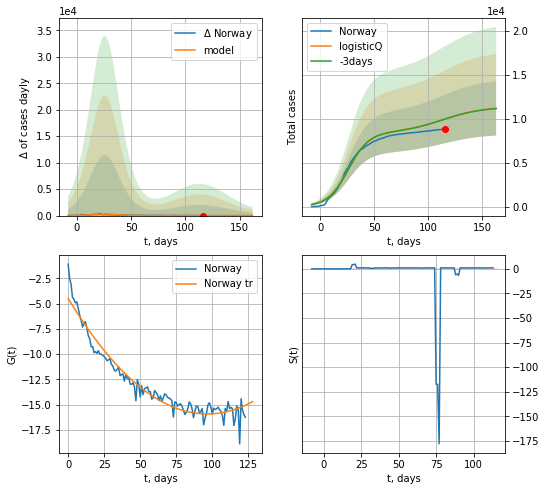

Norway data at: 2020-06-29
+3 day model MAPE: 0.001328
model: logisticQ
coeffs: [ 8.41794345e+03  2.70720467e-07  2.60343935e+01 -3.90015545e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.276435
forecast at the end of period: +47 days
	 deltaDaycases: 10
	 total cases: 11199 ± 3095
	 total death: 314 ± 260
trend coefficient of determination: 0.944337
 intercept_: -4.4897161814467506
 coeffs_: [ 0.         -0.23663234  0.00122616]


In [140]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


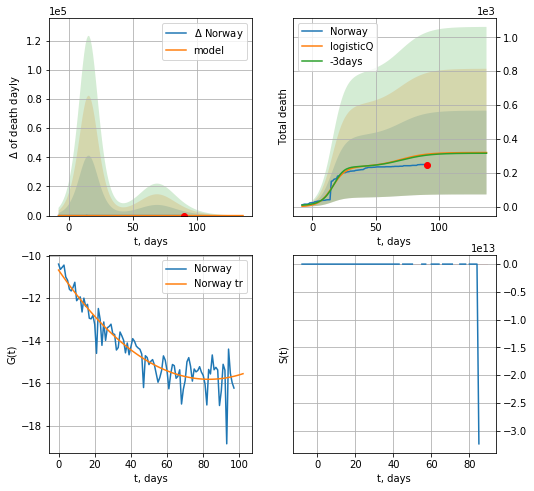

Norway data at: 2020-06-29
+3 day model MAPE: 0.017928
model: logisticQ
coeffs: [ 2.36197608e+02  1.89728028e-06  1.59157952e+01 -1.01655974e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.773296
forecast at the end of period: +47 days
	 total death: 319 ± 247
trend coefficient of determination: 0.867742
 intercept_: -10.680821848601315
 coeffs_: [ 0.         -0.12354911  0.00074261]


In [141]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date  cases  active   death
121 2020-06-25  63890       0  5230.0
122 2020-06-26  65137       0  5280.0
123 2020-06-27  65969       0  5280.0
124 2020-06-28  66812       0  5280.0
125 2020-06-29  67667       0  5310.0


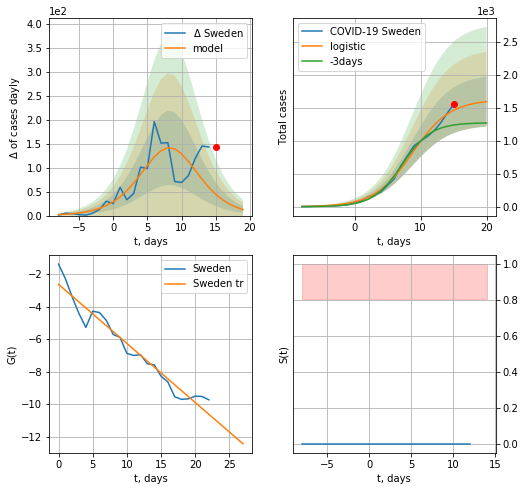

Sweden data at: 2020-06-29
+3 day model MAPE: 0.2037446768613992
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.23715803800431418
forecast at the end of period: +5 days
	 deltaDaycases:  12
	 total cases:  1592 ± 377
	 total death:  124 ± 88
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


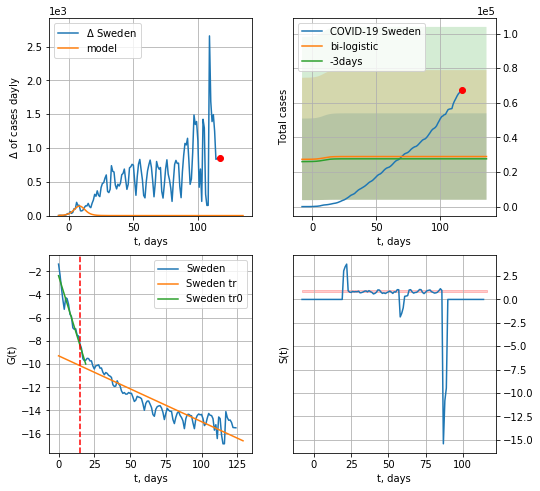

Sweden data at: 2020-06-29
+3 day model MAPE: 0.047836714489068
model: bi-logistic
coeffs:  [ 2.18548152e+04 -8.83330877e+00  2.26273269e+02] [1.62331286e+03 3.49719159e-01 8.72648648e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8628406385032251
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  28941 ± 24972
	 total death:  2271 ± 5878
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.908377
 intercept: -2.385275
 slope: -0.400494
trend coefficient of determination: 0.859397
 intercept: -9.289473
 slope: -0.056772


In [143]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[:-9-dT],d1,7*14-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
           date  cases  active   death
121 2020-06-25  63890       0  5230.0
122 2020-06-26  65137       0  5280.0
123 2020-06-27  65969       0  5280.0
124 2020-06-28  66812       0  5280.0
125 2020-06-29  67667       0  5310.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


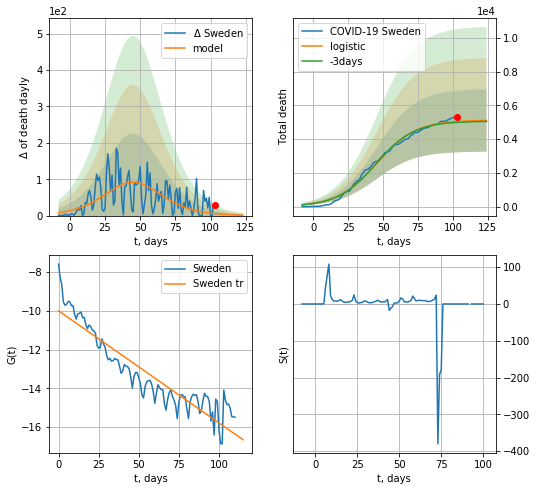

Sweden data at: 2020-06-29
+3 day model MAPE: 0.010204263758855173
model: logistic
coeffs:  [5.12072860e+03 7.17422833e-02 4.53459587e+01]
rational stdev:  0.36205356778037207
forecast at the end of period: +21 days
	 total death:  5102 ± 1847
trend coefficient of determination: 0.855849
 intercept: -9.995289
 slope: -0.057980


In [144]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


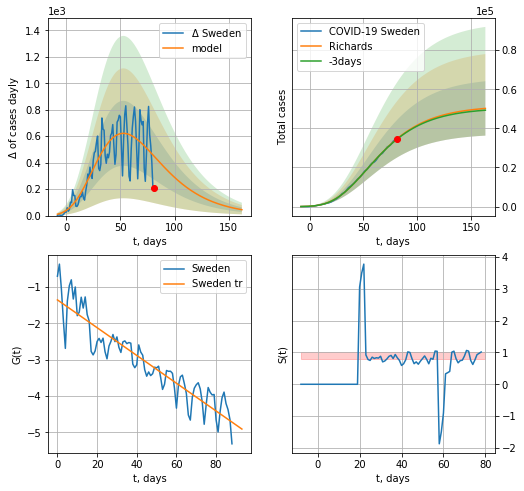

Sweden data at: 2020-06-29
+3 day model MAPE: 0.006125
model: Richards
coeffs: [ 5.15411678e+04  1.71360194e+00 -6.59040825e+01  1.93271263e-02]
rational stdev: 0.276754
forecast at the end of period: +82 days
	 deltaDaycases: 44
	 total cases: 50199 ± 13892
	 total death: 3939 ± 3270
trend coefficient of determination: 0.852284
 intercept: -1.357303
 slope: -0.038160


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


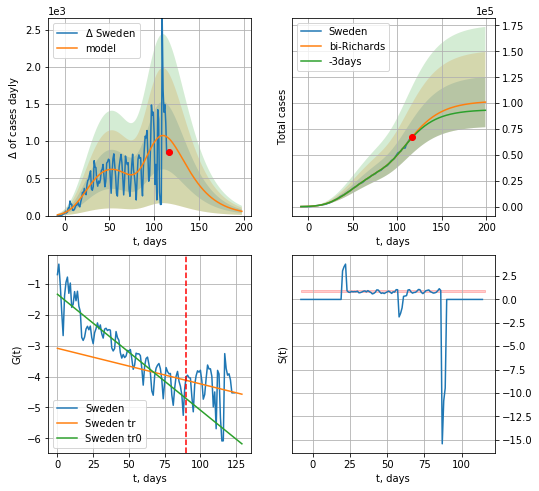

Sweden data at: 2020-06-29
+3 day model MAPE: 0.011649
model: bi-Richards
coeffs: [5.07497268e+04 3.35047449e+00 2.17730682e+01 1.39208886e-02]
rational stdev: 0.240006
forecast at the end of period: +82 days
	 deltaDaycases: 57
	 total cases: 100951 ± 24228
	 total death: 7921 ± 5703
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.852513
 intercept: -1.337837
 slope: -0.037510
trend coefficient of determination: 0.030403
 intercept: -3.087387
 slope: -0.011503


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


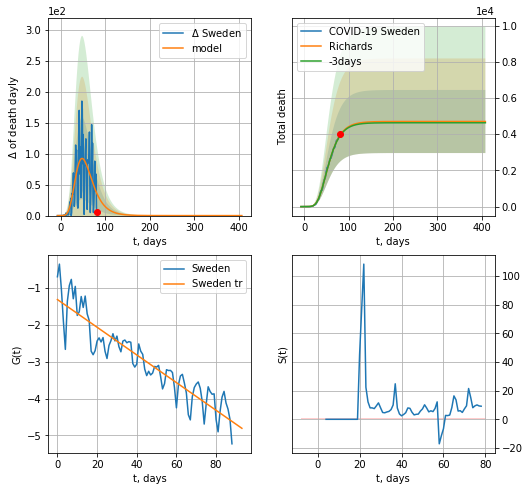

Sweden data at: 2020-06-29
+3 day model MAPE: 0.006769
model: Richards
coeffs: [ 4.70128038e+03  4.77681479e+00 -3.56595016e+01  1.12330349e-02]
rational stdev: 0.370514
forecast at the end of period: +327 days
	 total death: 4701 ± 1741
trend coefficient of determination: 0.849510
 intercept: -1.318621
 slope: -0.037513


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


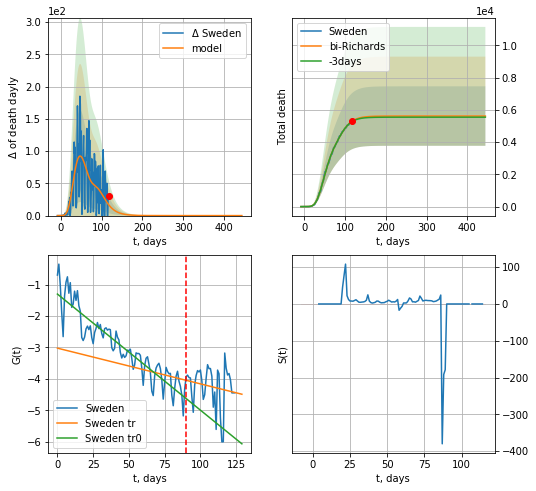

Sweden data at: 2020-06-29
+3 day model MAPE: 0.004289
model: bi-Richards
coeffs: [9.12171531e+02 9.52900388e+00 1.40889699e+01 6.49695620e-03]
rational stdev: 0.328125
forecast at the end of period: +327 days
	 total death: 5613 ± 1841
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.849950
 intercept: -1.302130
 slope: -0.036924
trend coefficient of determination: 0.029690
 intercept: -3.021986
 slope: -0.011364


In [145]:
vL = 90
x = forecastRR('Sweden',dfSW[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Sweden',dfSW[:vL],d1,60*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


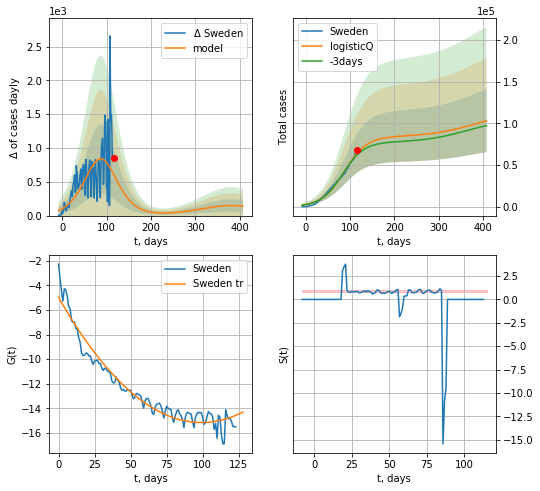

Sweden data at: 2020-06-29
+3 day model MAPE: 0.032347
model: logisticQ
coeffs: [ 8.41031897e+04  2.38712167e-07  8.73395623e+01 -1.66865363e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365098
forecast at the end of period: +292 days
	 deltaDaycases: 138
	 total cases: 102975 ± 37596
	 total death: 8080 ± 8849
trend coefficient of determination: 0.946320
 intercept_: -4.988523151970458
 coeffs_: [ 0.         -0.20481082  0.00103231]


In [146]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


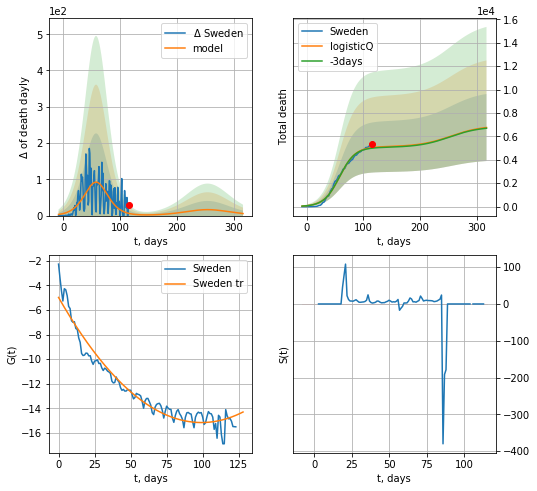

Sweden data at: 2020-06-29
+3 day model MAPE: 0.010305
model: logisticQ
coeffs: [ 5.11401536e+03  2.61343282e-07  5.83010341e+01 -2.75944307e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.423909
forecast at the end of period: +201 days
	 total death: 6757 ± 2864
trend coefficient of determination: 0.946320
 intercept_: -4.988523151970458
 coeffs_: [ 0.         -0.20481082  0.00103231]


In [147]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
155 2020-06-25  83462.0     389  4634.0
156 2020-06-26  83483.0     405  4634.0
157 2020-06-27  83500.0     415  4634.0
158 2020-06-28  83512.0     418  4634.0
159 2020-06-29  83531.0     428  4634.0


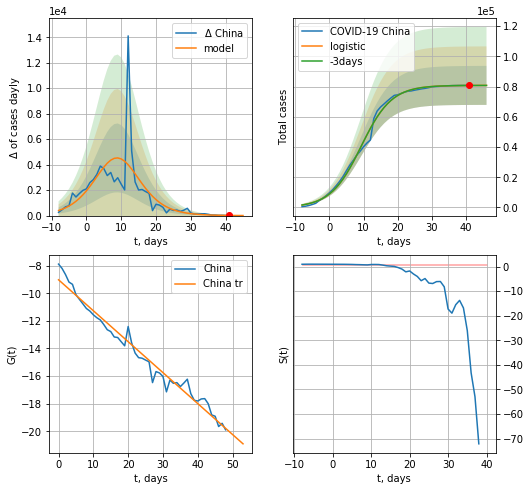

China data at: 2020-06-29
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  80788 ± 12903
	 total death:  4481 ± 2147
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


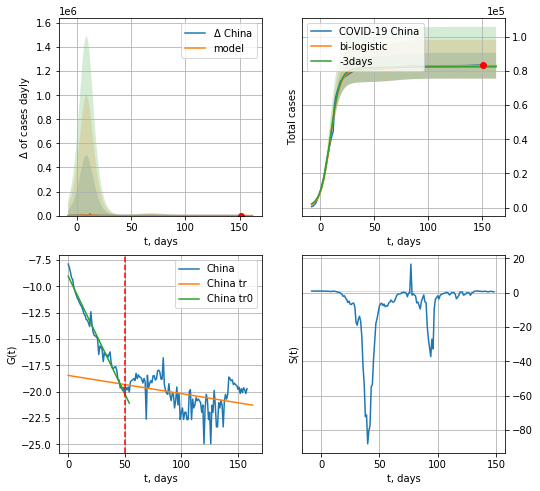

China data at: 2020-06-29
+3 day model MAPE: 0.007986895565762544
model: bi-logistic
coeffs:  [2.31057045e+03 1.11369044e-01 6.92031416e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.09109634775678539
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  83120 ± 7571
	 total death:  4611 ± 1260
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.131330
 intercept: -18.457195
 slope: -0.017338


In [148]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*14-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,15*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [149]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

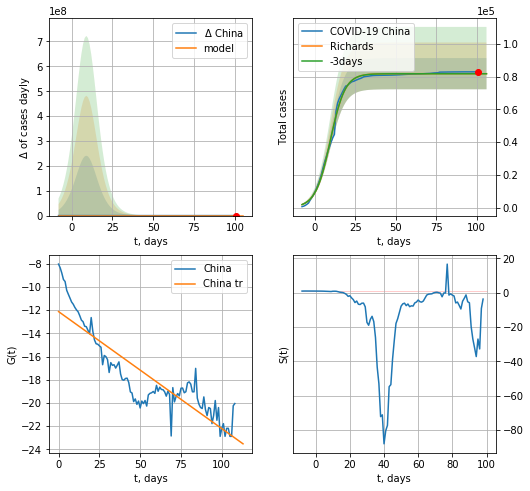

China data at: 2020-06-29
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736185e+04 2.15574478e-01 9.59539597e+00 1.02116157e+00]
rational stdev: 0.116457
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4536 ± 1584
trend coefficient of determination: 0.785239
 intercept: -12.125053
 slope: -0.100960


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


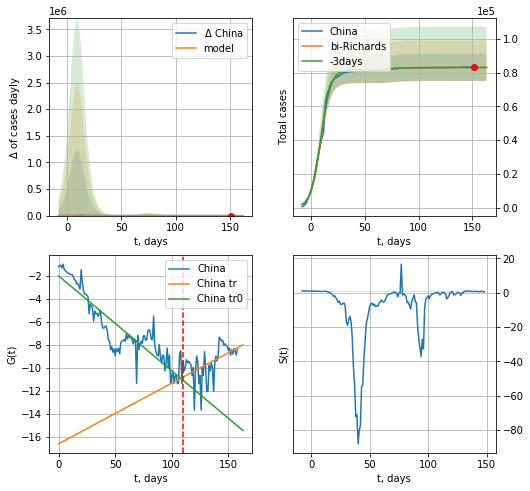

China data at: 2020-06-29
+3 day model MAPE: 0.000416
model: bi-Richards
coeffs: [1.33753667e+03 6.62584942e+01 2.53643653e+01 1.91901369e-03]
rational stdev: 0.096582
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 83111 ± 8027
	 total death: 4610 ± 1335
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.821005
 intercept: -1.972669
 slope: -0.082666
trend coefficient of determination: 0.274475
 intercept: -16.598340
 slope: 0.052834


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [150]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,14*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,15*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

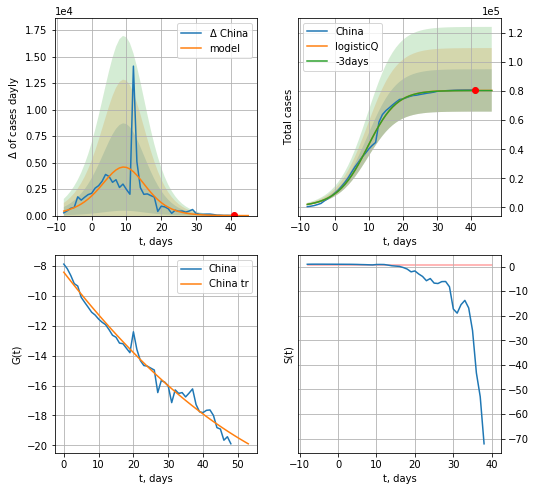

China data at: 2020-06-29
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 80413 ± 14556
	 total death: 4461 ± 2422
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


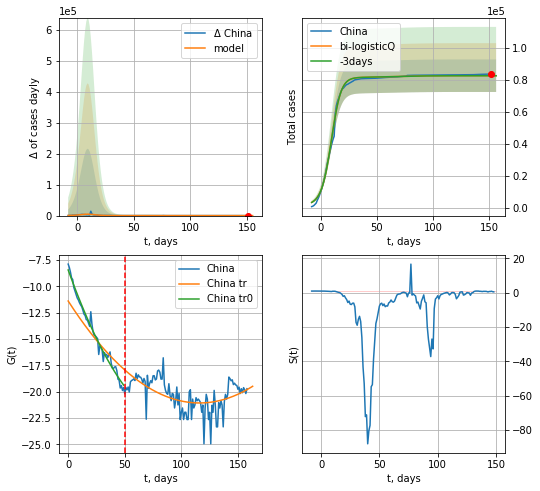

China data at: 2020-06-29
+3 day model MAPE: 0.000443
model: bi-logisticQ
coeffs: [ 2.12664686e+03  4.30512761e-04  2.47831527e+01 -3.92998377e-02]
rational stdev: 0.123351
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 82543 ± 10181
	 total death: 4579 ± 1694
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.310485
 intercept_: -11.390139200058425
 coeffs_: [ 0.         -0.1669374   0.00071924]


In [151]:
x = forecastRRR('China',dfCN[:50],d1,7*14-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,14*7-dT,x,1.0,vL=50)

In [152]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
131 2020-06-25  12602  1148.0  282.0
132 2020-06-26  12653  1054.0  282.0
133 2020-06-27  12715  1069.0  282.0
134 2020-06-28  12757  1046.0  282.0
135 2020-06-29  12800   981.0  282.0


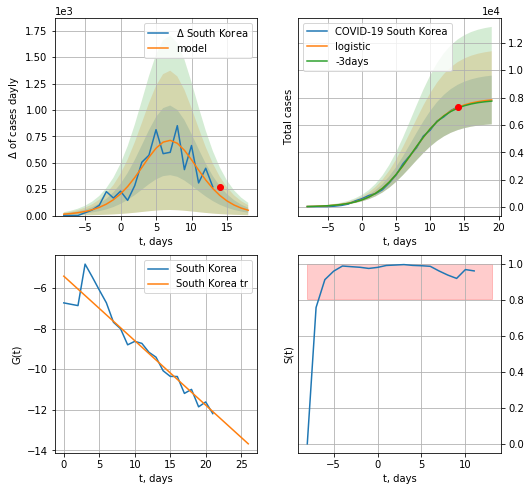

South Korea data at: 2020-06-29
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +5 days
	 deltaDaycases:  50
	 total cases:  7821 ± 1780
	 total death:  172 ± 117
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


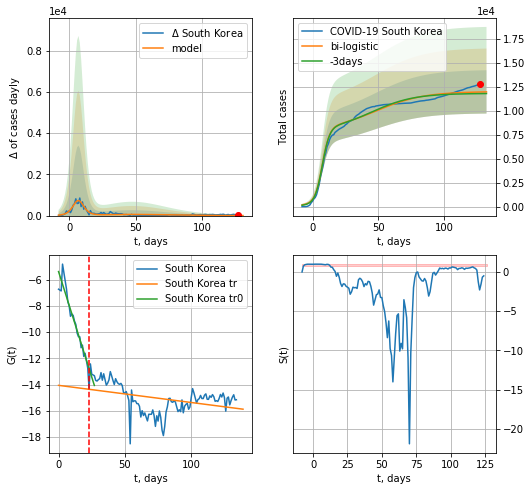

South Korea data at: 2020-06-29
+3 day model MAPE: 0.014205756092561249
model: bi-logistic
coeffs:  [4.08241584e+03 5.52125241e-02 4.78514809e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.1884171798976066
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  11984 ± 2258
	 total death:  264 ± 149
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.150529
 intercept: -14.057034
 slope: -0.013057


In [153]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*14-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,14*7-dT,x,1.0,vL=23)

In [154]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

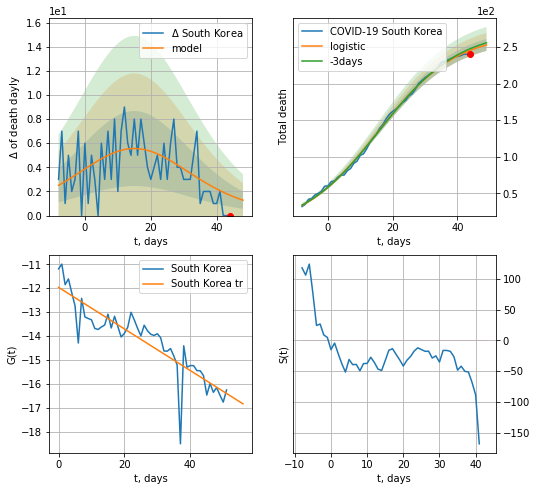

South Korea data at: 2020-06-29
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +5 days
	 total death:  252 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


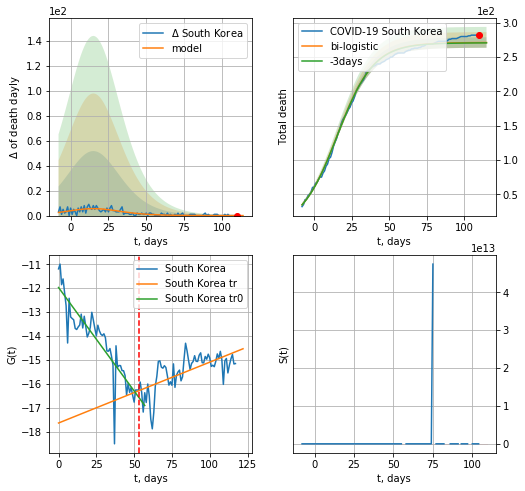

South Korea data at: 2020-06-29
+3 day model MAPE: 0.001838842966503378
model: bi-logistic
coeffs:  [ 3.04056715  0.02350399 11.51928595] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.028002136660482617
forecast at the end of period: +5 days
	 deltaDaydeath:  0
	 total death:  271 ± 7
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.436393
 intercept: -17.638710
 slope: 0.025444


In [155]:
x = forecast('South Korea',dfKR[17:70],d1,14*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,14*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


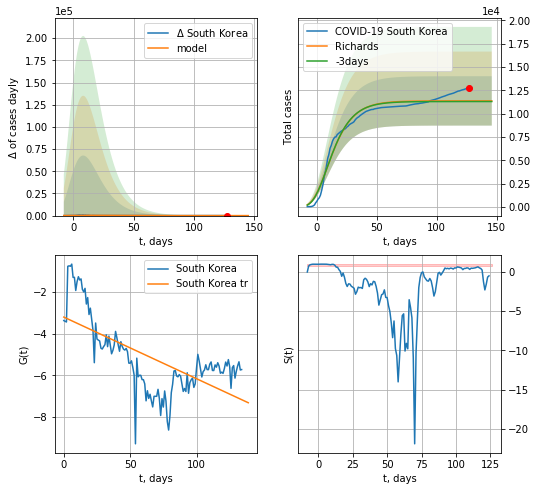

South Korea data at: 2020-06-29
+3 day model MAPE: 0.005948
model: Richards
coeffs: [ 1.13679982e+04  2.85280829e+01 -6.10366887e+01  2.93758983e-03]
rational stdev: 0.232760
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 11367 ± 2645
	 total death: 250 ± 174
trend coefficient of determination: 0.430441
 intercept: -3.208957
 slope: -0.029527


In [156]:
x = forecastRR('South Korea',dfKR[:],d1,16*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


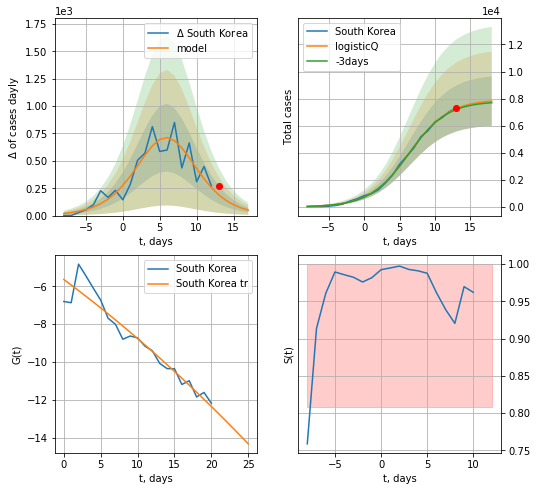

South Korea data at: 2020-06-29
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +5 days
	 deltaDaycases: 50
	 total cases: 7818 ± 1825
	 total death: 172 ± 120
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


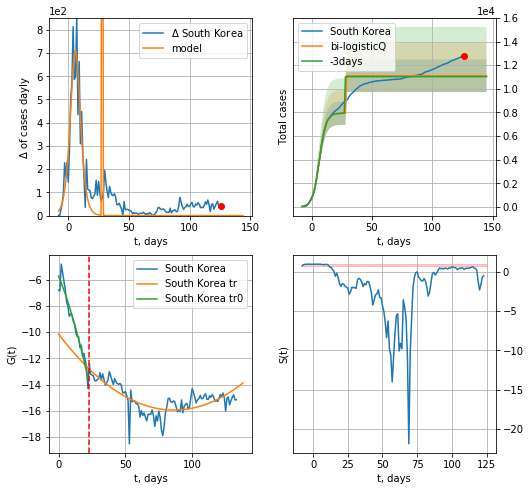

South Korea data at: 2020-06-29
+3 day model MAPE: 0.006709
model: bi-logisticQ
coeffs: [3165.99408377   11.76217127   28.21095481  -24.28690969]
rational stdev: 0.124185
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 11102 ± 1378
	 total death: 244 ± 90
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.573727
 intercept_: -10.149092933199276
 coeffs_: [ 0.         -0.13406842  0.00077593]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [157]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,14*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

In [158]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


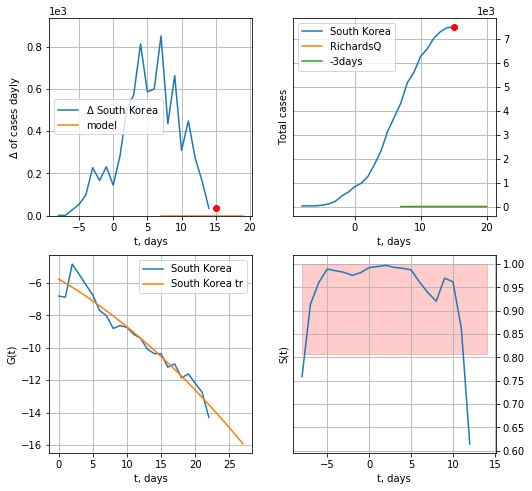

South Korea data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 8.55287099e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +5 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [159]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,14*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


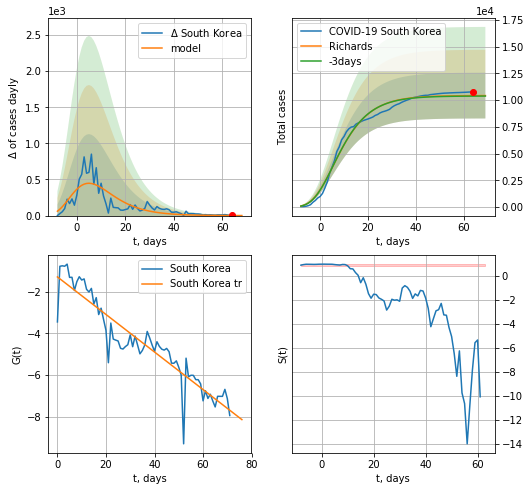

South Korea data at: 2020-06-29
+3 day model MAPE: 0.004451
model: Richards
coeffs: [ 1.04318163e+04  3.06447185e+01 -4.21690973e+01  3.81700530e-03]
rational stdev: 0.205493
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 10425 ± 2142
	 total death: 229 ± 141
trend coefficient of determination: 0.863609
 intercept: -1.289365
 slope: -0.090003


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


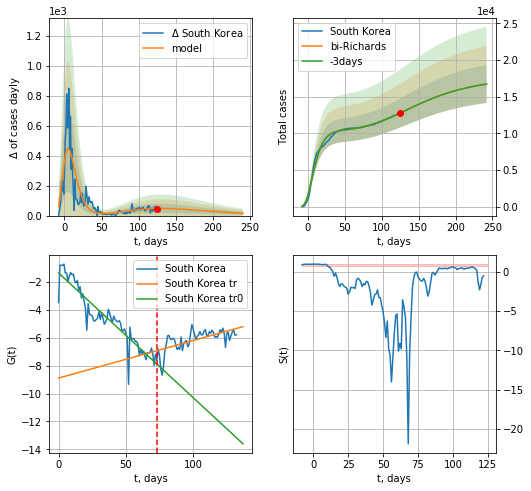

South Korea data at: 2020-06-29
+3 day model MAPE: 0.000156
model: bi-Richards
coeffs: [ 7.23069128e+03  2.01507056e+00 -1.29637148e+02  8.96470315e-03]
rational stdev: 0.154770
forecast at the end of period: +117 days
	 deltaDaycases: 15
	 total cases: 16746 ± 2591
	 total death: 368 ± 170
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.865778
 intercept: -1.343111
 slope: -0.089497
trend coefficient of determination: 0.423960
 intercept: -8.885818
 slope: 0.026946


In [160]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,14*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,30*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [161]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


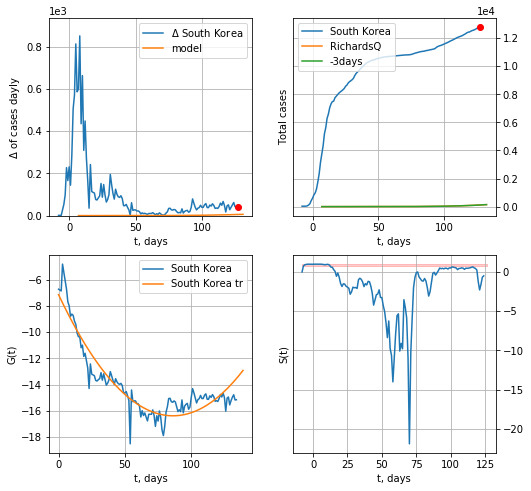

South Korea data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 8.55287099e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +5 days
	 deltaDaycases: 5


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [162]:
x = forecastQR('South Korea',dfKR[:],d1,14*7-dT,1.0)

SG
           date    cases  active  death
154 2020-06-25  42955.0    6325   26.0
155 2020-06-26  43246.0    6395   26.0
156 2020-06-27  43459.0    6270   26.0
157 2020-06-28  43661.0    6127   26.0
158 2020-06-29  43661.0    5650   26.0


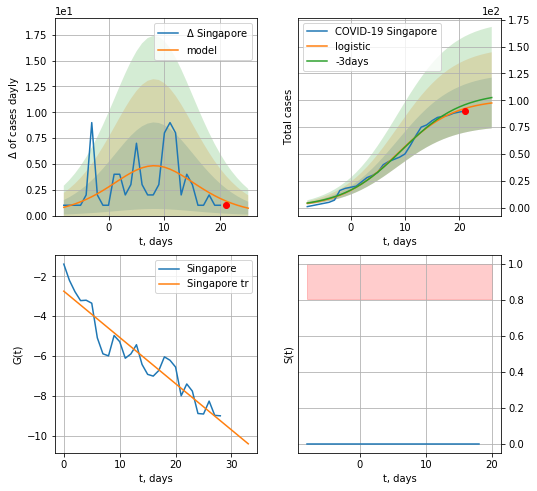

Singapore data at: 2020-06-29
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  97 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


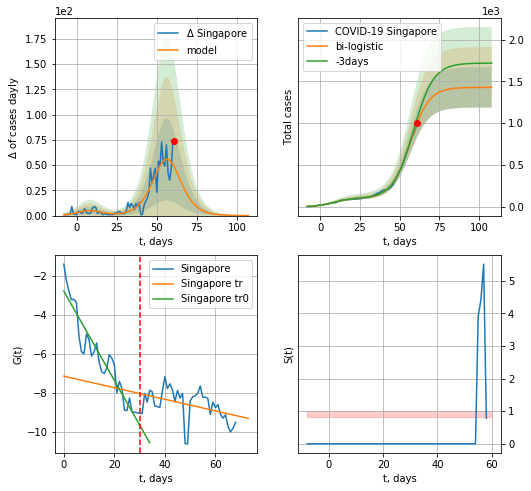

Singapore data at: 2020-06-29
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +47 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


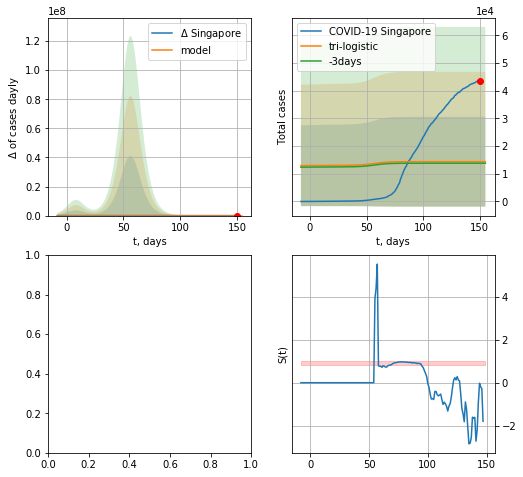

In [163]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*14-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,14*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


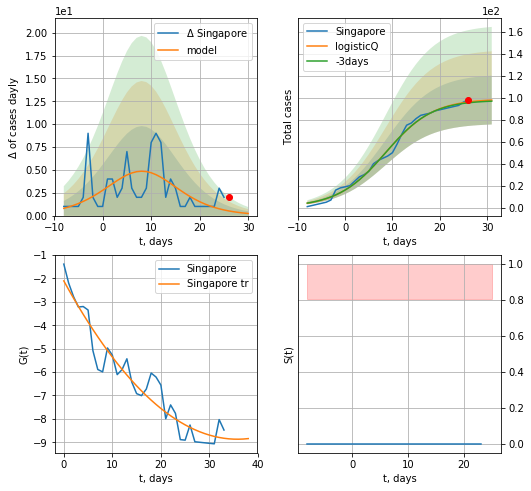

Singapore data at: 2020-06-29
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 97 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

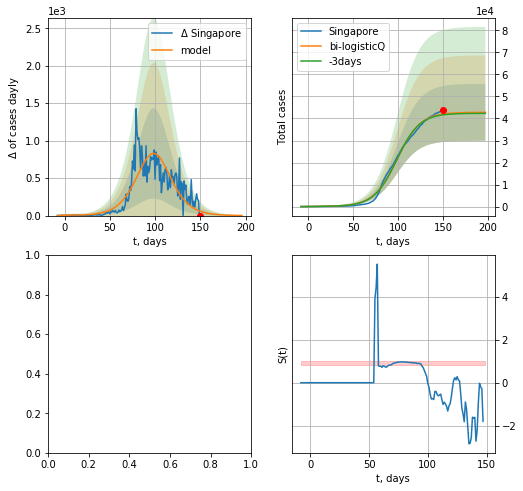

In [164]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*14-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [371]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

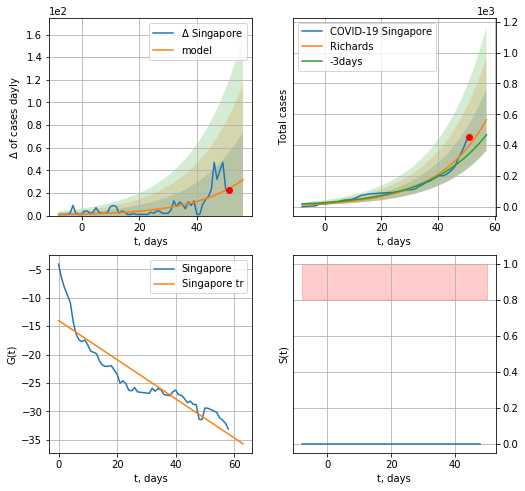

Singapore data at: 2020-06-28
+3 day model MAPE: 0.162175
model: Richards
coeffs: [9.30440928e+03 5.77261259e-02 1.05546035e+02 4.91744477e+00]
rational stdev: 0.355378
forecast at the end of period: +6 days
	 deltaDaycases: 31
	 total cases: 564 ± 200
	 total death: 0 ± 0
trend coefficient of determination: 0.813965
 intercept: -14.017324
 slope: -0.343928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


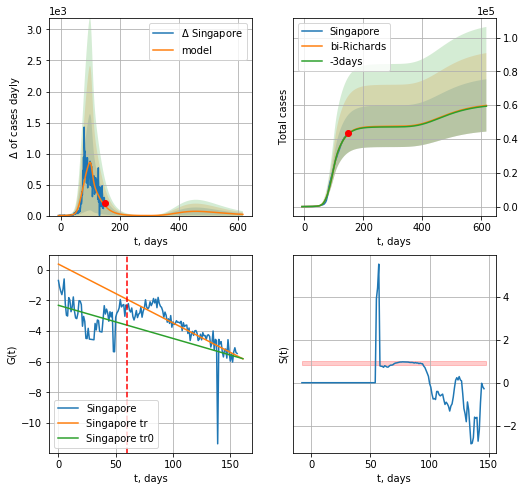

Singapore data at: 2020-06-28
+3 day model MAPE: 0.004025
model: bi-Richards
coeffs: [ 3.81950379e+04  4.81485044e+00 -2.51138816e+01  8.23148544e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.258681
forecast at the end of period: +468 days
	 deltaDaycases: 19
	 total cases: 59837 ± 15478
	 total death: 35 ± 27
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.125491
 intercept: -2.319847
 slope: -0.021638
trend coefficient of determination: 0.650348
 intercept: 0.369912
 slope: -0.038412


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


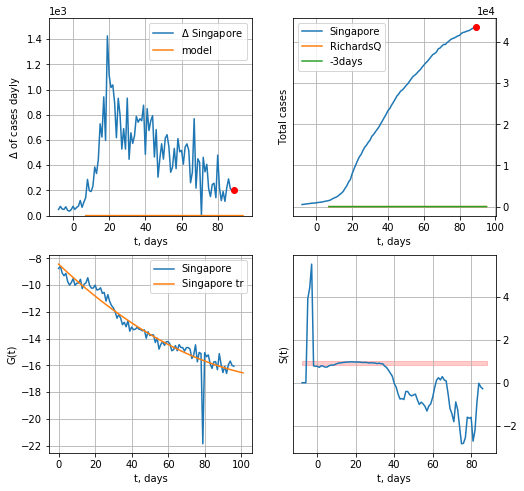

Singapore data at: 2020-06-28
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 9.75970661e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +6 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [372]:
vL = 60
x = forecastRR('Singapore',dfSG[:vL],d1,14*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[60:],d1,14*7-dT,1.0)

ES
           date   cases  active  death
105 2020-06-25  1984.5     125   69.0
106 2020-06-26  1986.0     120   69.0
107 2020-06-27  1987.0     100   69.0
108 2020-06-28  1987.0     100   69.0
109 2020-06-29  1987.0     100   69.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


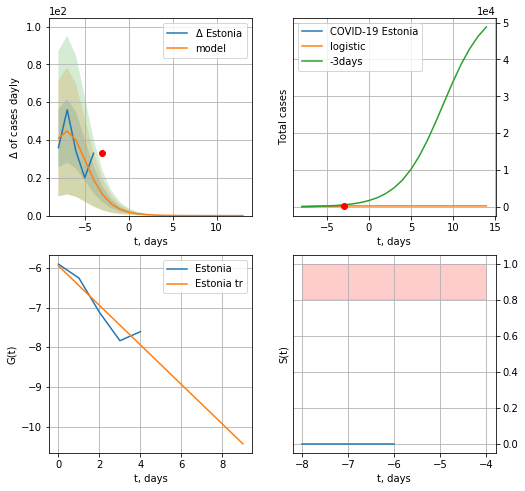

Estonia data at: 2020-06-29
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


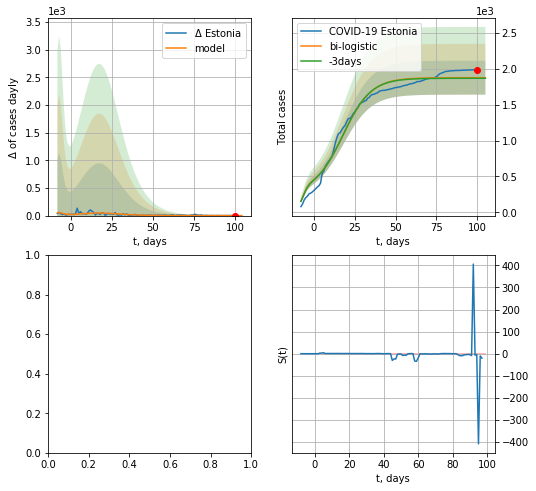

In [165]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,14*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

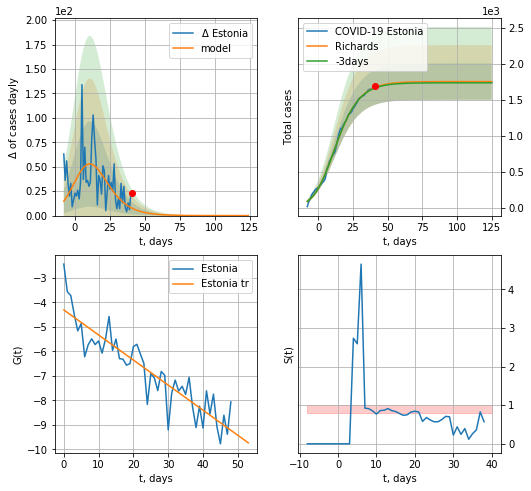

Estonia data at: 2020-06-27
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 60 ± 26
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


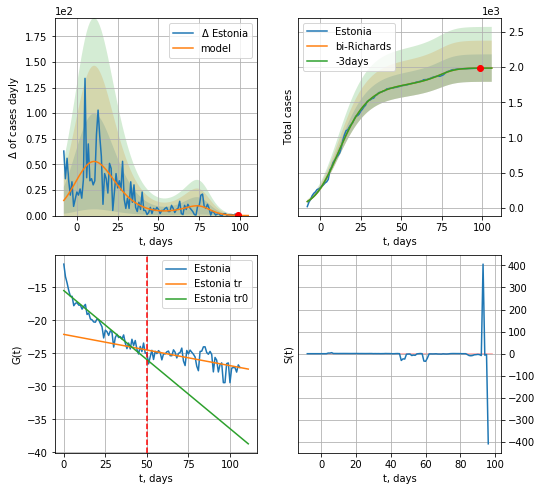

Estonia data at: 2020-06-27
+3 day model MAPE: 0.000011
model: bi-Richards
coeffs: [2.37151655e+02 8.91537020e-02 7.83756278e+01 2.57737402e+00]
rational stdev: 0.098290
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1986 ± 195
	 total death: 69 ± 20
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.890534
 intercept: -15.502733
 slope: -0.209205
trend coefficient of determination: 0.334899
 intercept: -22.139105
 slope: -0.047364


In [362]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*14-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


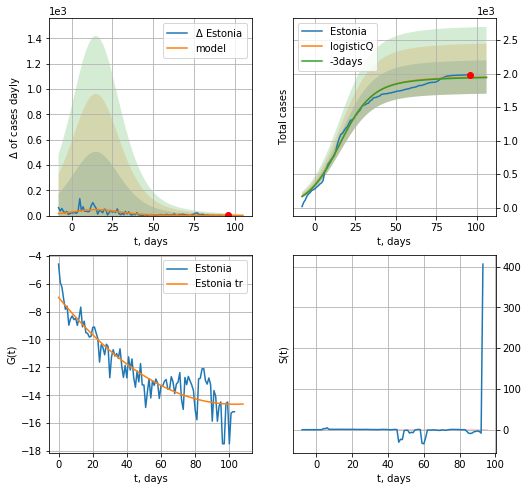

Estonia data at: 2020-06-24
+3 day model MAPE: 0.004369
model: logisticQ
coeffs: [ 1.87550592e+03  2.60944169e-07  1.52606261e+01 -3.81847777e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.127823
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1949 ± 249
	 total death: 67 ± 25
trend coefficient of determination: 0.838948
 intercept_: -6.9841288486771065
 coeffs_: [ 0.         -0.14826437  0.00071731]


In [380]:
x = forecastRRR('Estonia',dfES[:],d1,7*14-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
110 2020-06-25  1111.5     178   30.0
111 2020-06-26  1112.0     150   30.0
112 2020-06-27  1115.0     153   30.0
113 2020-06-28  1116.0     154   30.0
114 2020-06-29  1117.0     155   30.0


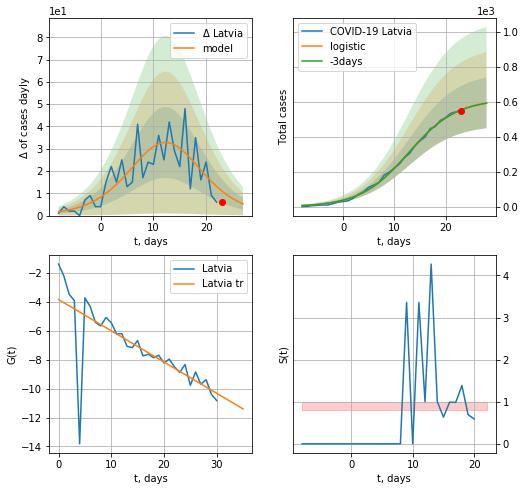

Latvia data at: 2020-06-29
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  593 ± 144
	 total death:  15 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


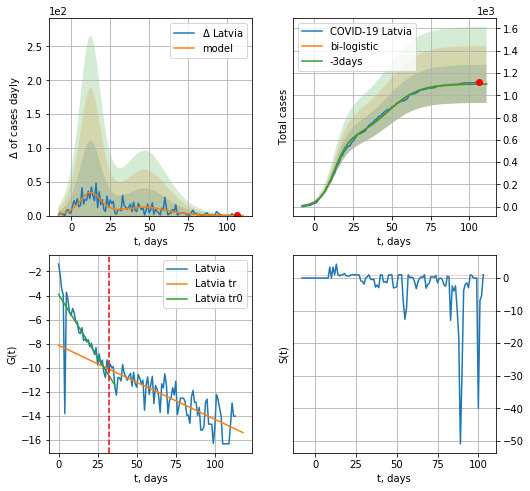

Latvia data at: 2020-06-29
+3 day model MAPE: 0.0018403507888867681
model: bi-logistic
coeffs:  [4.86755266e+02 1.00886293e-01 4.77806311e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.15467915418424902
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1102 ± 170
	 total death:  29 ± 13
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.679819
 intercept: -8.137062
 slope: -0.061522


In [167]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,14*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,14*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


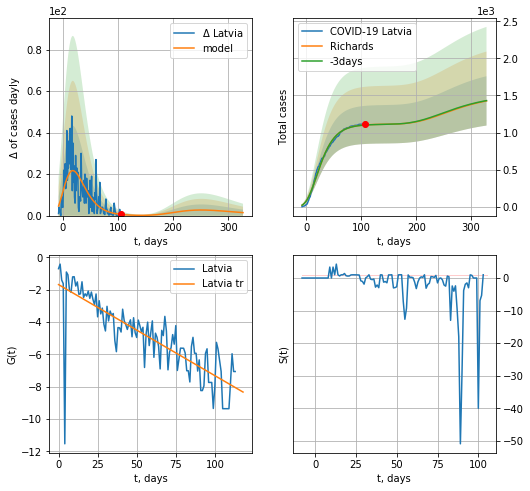

Latvia data at: 2020-06-29
+3 day model MAPE: 0.001508
model: Richards
coeffs: [ 1.11300050e+03  9.94855953e+00 -8.02695522e+01  5.33493682e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.233138
forecast at the end of period: +222 days
	 deltaDaycases: 1
	 total cases: 1427 ± 332
	 total death: 38 ± 26
trend coefficient of determination: 0.672723
 intercept: -1.681156
 slope: -0.056300


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


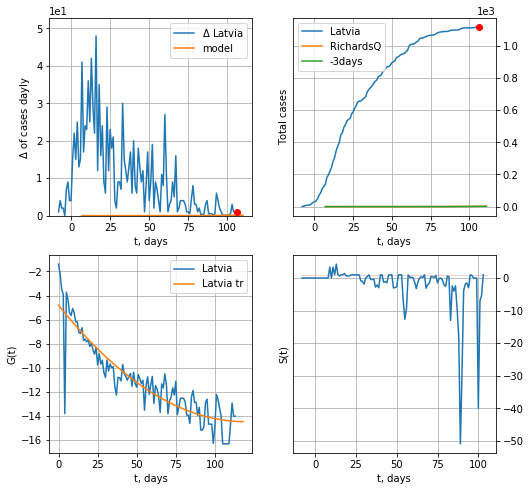

Latvia data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.14660905e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +5 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [168]:
x = forecastRR('Latvia',dfLV[:],d1,7*45-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*14-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


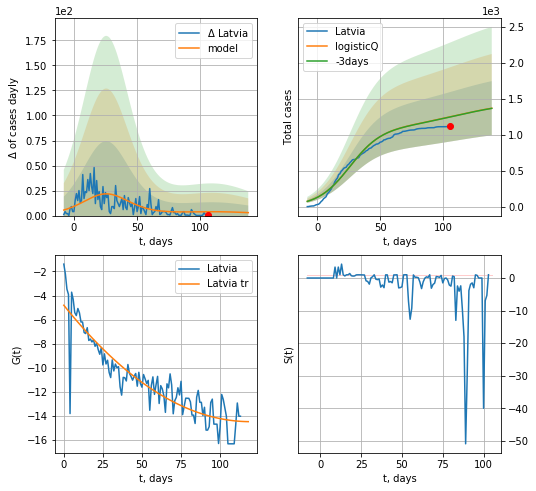

Latvia data at: 2020-06-29
+3 day model MAPE: 0.001537
model: logisticQ
coeffs: [ 1.08374678e+03  1.85148455e-07  2.57873215e+01 -4.24289637e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.275380
forecast at the end of period: +33 days
	 deltaDaycases: 2
	 total cases: 1368 ± 376
	 total death: 36 ± 29
trend coefficient of determination: 0.820013
 intercept_: -4.806786734167147
 coeffs_: [ 0.         -0.16227203  0.00068004]


In [169]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


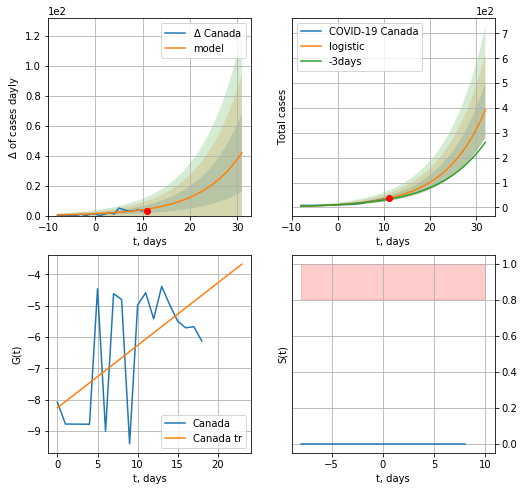

Canada data at: 2020-06-29
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  32 ± 27
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


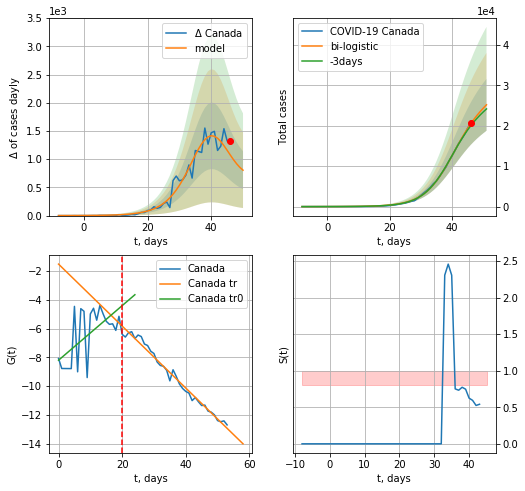

Canada data at: 2020-06-29
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +5 days
	 deltaDaycases:  805
	 total cases:  25178 ± 6418
	 total death:  2075 ± 1586
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


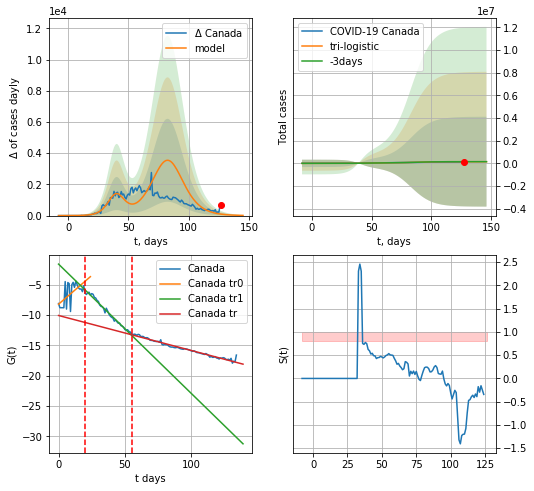

Canada data at: 2020-06-29
+3 day model MAPE: 0.005511076191213119
model: tri-logistic
coeffs:  [-1.12664489e+04  1.49575715e+00 -2.35076140e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  28.72323429617675
forecast at the end of period: +19 days
	 deltaDaycases:  11
	 total cases:  137990 ± 3963533
	 total death:  11374 ± 980094
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.973995
 intercept: -10.058164
 slope: -0.057817


In [170]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,14*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
131 2020-06-25  102622.0   28693  8504.0
132 2020-06-26  102794.0   28560  8508.0
133 2020-06-27  103032.0   28543  8516.0
134 2020-06-28  103250.0   28537  8522.0
135 2020-06-29  103918.0   28174  8566.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


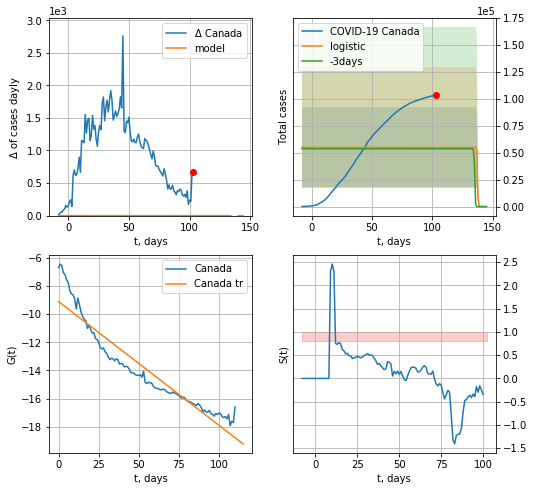

Canada data at: 2020-06-29
+3 day model MAPE: 0.024828726897202315
model: logistic
coeffs:  [ 5.49925446e+04 -4.59115636e+00  1.37607016e+02]
rational stdev:  0.6778988983942417
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.897126
 intercept: -9.110522
 slope: -0.087889


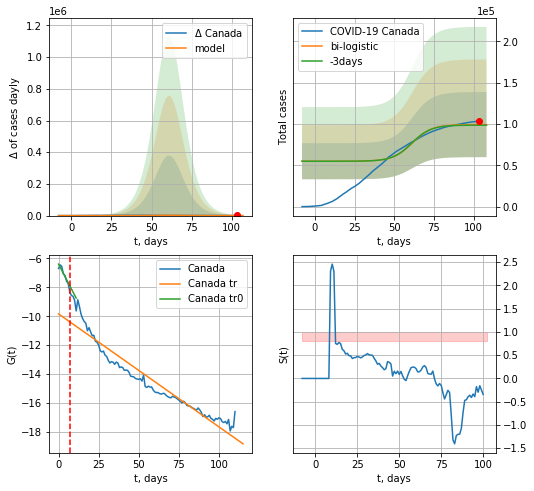

Canada data at: 2020-06-29
+3 day model MAPE: 0.007252478416199191
model: bi-logistic
coeffs:  [4.43507626e+04 1.63107775e-01 6.13618034e+01] [ 5.49925446e+04 -4.59115636e+00  1.37607016e+02]
rational stdev:  0.3965373304360502
forecast at the end of period: +5 days
	 deltaDaycases:  3
	 total cases:  99321 ± 39384
	 total death:  8187 ± 9739
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.918954
 intercept: -9.837639
 slope: -0.078152


In [171]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31-24,cases='cases')

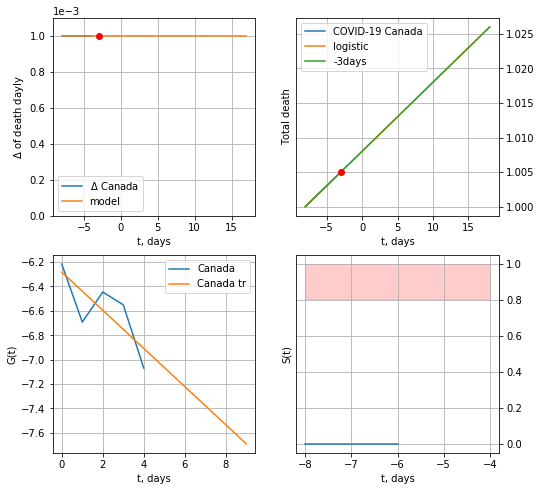

Canada data at: 2020-06-29
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


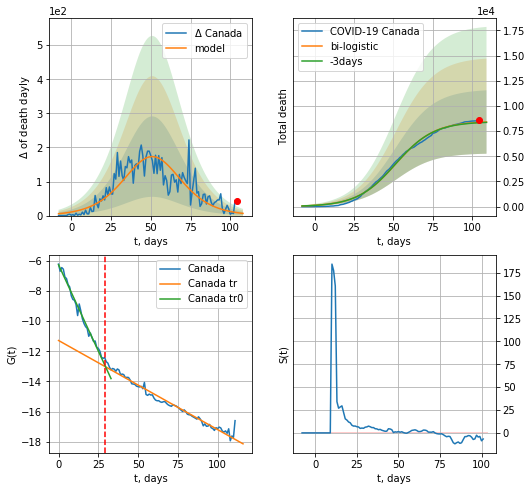

Canada data at: 2020-06-29
+3 day model MAPE: 0.004371742574471317
model: bi-logistic
coeffs:  [8.48108548e+03 8.16451122e-02 5.13864517e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.3747204017965483
forecast at the end of period: +5 days
	 deltaDaydeath:  6
	 total death:  8406 ± 3149
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.973750
 intercept: -11.282251
 slope: -0.059071


In [172]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,14*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


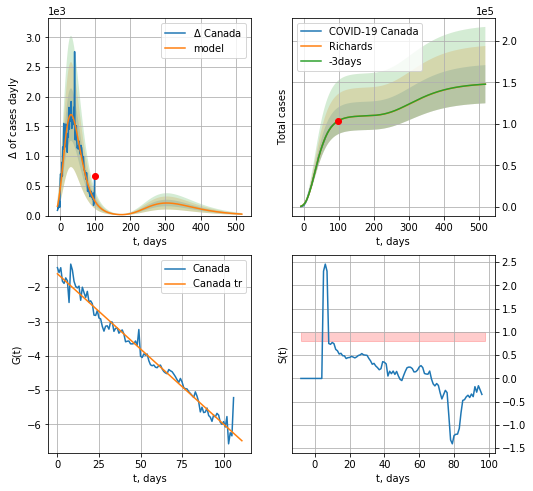

Canada data at: 2020-06-29
+3 day model MAPE: 0.000251
model: Richards
coeffs: [ 1.09803662e+05  2.86715936e+00 -6.81832982e+01  1.47920640e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.155848
forecast at the end of period: +420 days
	 deltaDaycases: 24
	 total cases: 147866 ± 23044
	 total death: 12188 ± 5698
trend coefficient of determination: 0.977168
 intercept: -1.609661
 slope: -0.043822


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


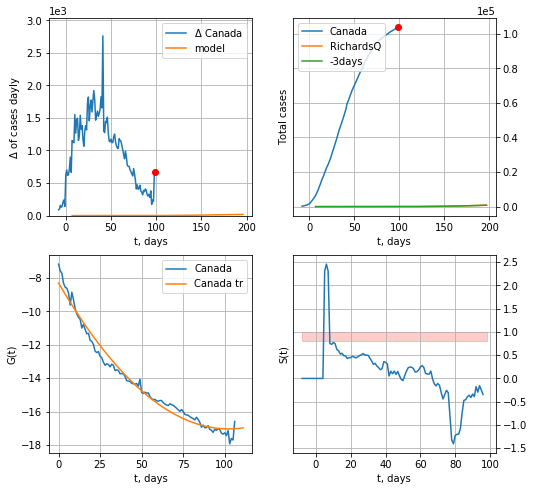

Canada data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 6.29625328e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +98 days
	 deltaDaycases: 18


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [173]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


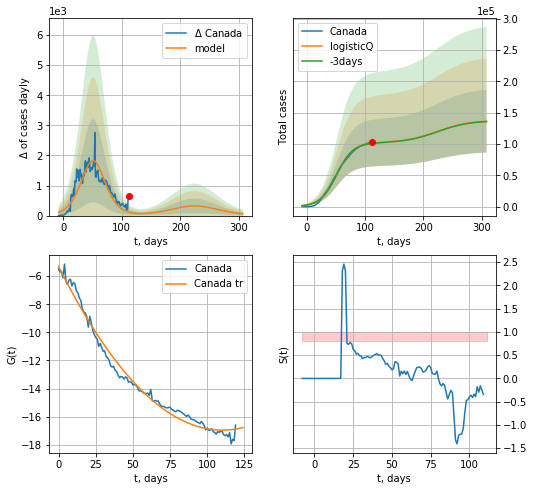

Canada data at: 2020-06-29
+3 day model MAPE: 0.004838
model: logisticQ
coeffs: [ 1.02044401e+05  3.25241010e-07  5.14388367e+01 -2.19532692e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.367740
forecast at the end of period: +196 days
	 deltaDaycases: 59
	 total cases: 136488 ± 50192
	 total death: 11250 ± 12411
trend coefficient of determination: 0.985160
 intercept_: -5.303046195037718
 coeffs_: [ 0.         -0.21184299  0.00096247]


In [174]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
115 2020-06-25  40415   12484  1549.0
116 2020-06-26  40866   12678  1555.0
117 2020-06-27  41189   12764  1561.0
118 2020-06-28  41646   13016  1564.0
119 2020-06-29  41912   13139  1568.0


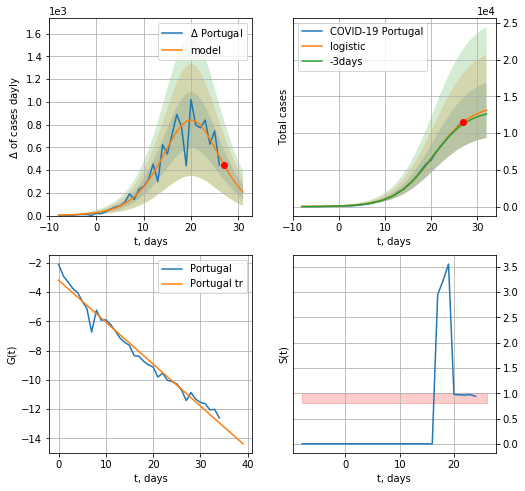

Portugal data at: 2020-06-29
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +5 days
	 deltaDaycases:  207
	 total cases:  13124 ± 3780
	 total death:  491 ± 424
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


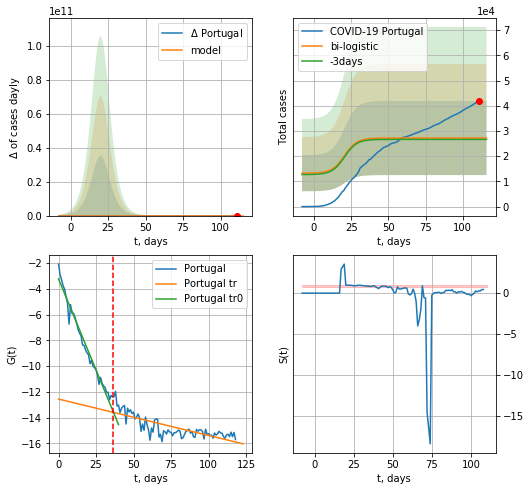

Portugal data at: 2020-06-29
+3 day model MAPE: 0.02047802104174827
model: bi-logistic
coeffs:  [ 1.06073374e+04 -6.07836854e+00  9.26775658e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5400564242911874
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  27202 ± 14691
	 total death:  1017 ± 1647
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.597484
 intercept: -12.557389
 slope: -0.028249


In [175]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,14*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


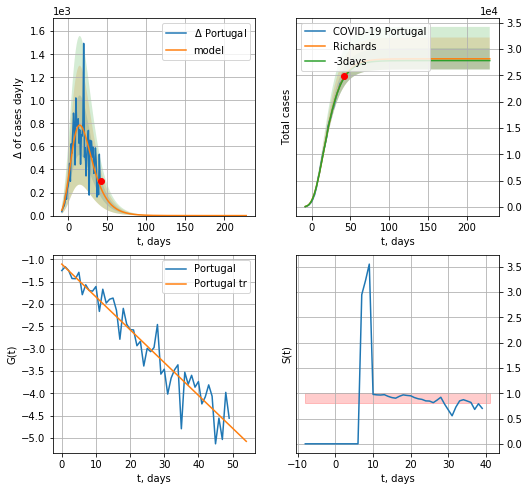

Portugal data at: 2020-06-29
+3 day model MAPE: 0.006186
model: Richards
coeffs: [ 2.81616178e+04  5.39214197e+00 -4.03941749e+01  1.41510332e-02]
rational stdev: 0.071740
forecast at the end of period: +187 days
	 deltaDaycases: 0
	 total cases: 28161 ± 2020
	 total death: 1053 ± 226
trend coefficient of determination: 0.913504
 intercept: -1.105984
 slope: -0.073555


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


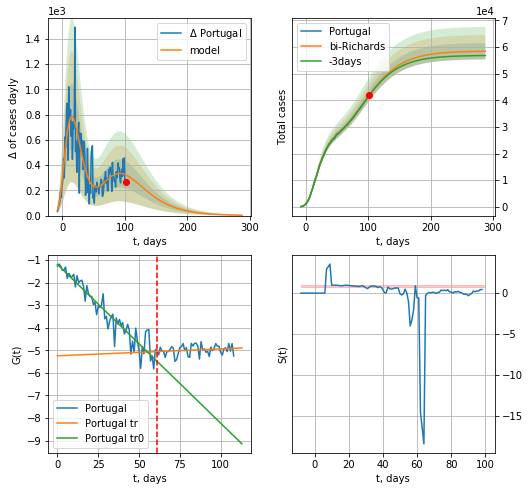

Portugal data at: 2020-06-29
+3 day model MAPE: 0.003229
model: bi-Richards
coeffs: [ 3.03851436e+04  1.64878624e+00 -4.17960363e+01  1.79892977e-02]
rational stdev: 0.052109
forecast at the end of period: +187 days
	 deltaDaycases: 2
	 total cases: 58451 ± 3045
	 total death: 2186 ± 341
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.904403
 intercept: -1.198852
 slope: -0.070291
trend coefficient of determination: 0.039135
 intercept: -5.244206
 slope: 0.003057


In [176]:
vL=61+10
x = forecastRR('Portugal',dfPT[10:vL-10],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[10:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


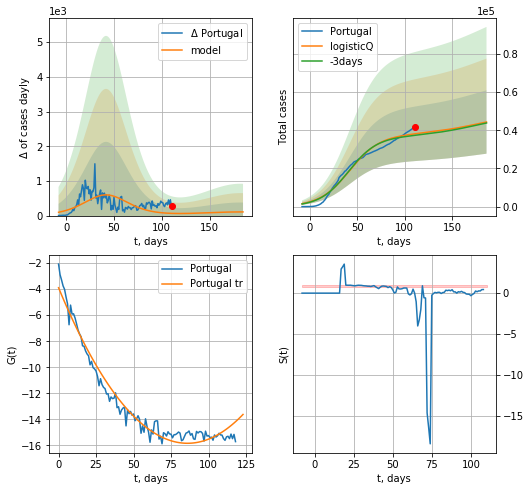

Portugal data at: 2020-06-29
+3 day model MAPE: 0.021369
model: logisticQ
coeffs: [ 3.73958415e+04  1.30247799e-07  4.20133453e+01 -4.87057593e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374591
forecast at the end of period: +75 days
	 deltaDaycases: 105
	 total cases: 44318 ± 16601
	 total death: 1658 ± 1863
trend coefficient of determination: 0.966473
 intercept_: -3.8919172781391627
 coeffs_: [ 0.         -0.27771185  0.00161495]


In [177]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

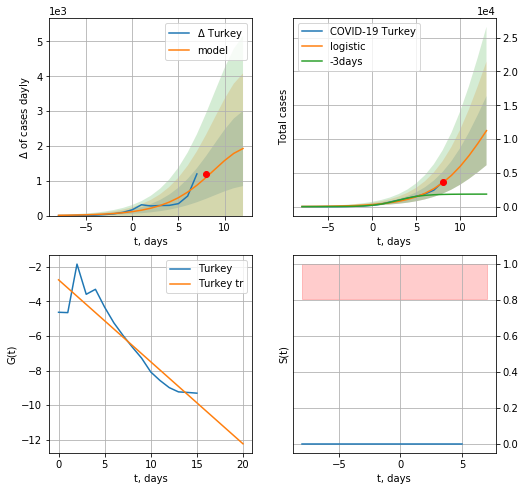

Turkey data at: 2020-06-29
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +5 days
	 deltaDaycases:  1924
	 total cases:  11240 ± 5116
	 total death:  289 ± 394
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


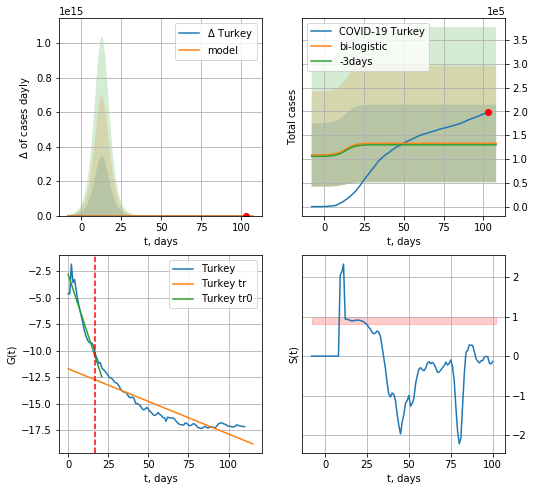

Turkey data at: 2020-06-29
+3 day model MAPE: 0.022829877573872618
model: bi-logistic
coeffs:  [ 8.68229191e+04 -3.79873069e+00  1.11390898e+02] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6142033007188438
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  132795 ± 81563
	 total death:  3419 ± 6299
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.794677
 intercept: -11.722725
 slope: -0.061576


In [178]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*14-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,14*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


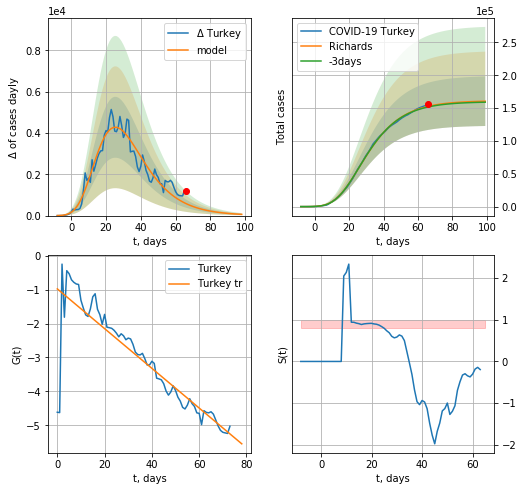

Turkey data at: 2020-06-29
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234317e+05  5.77708690e+00 -3.44331101e+01  1.25674474e-02]
rational stdev: 0.235071
forecast at the end of period: +33 days
	 deltaDaycases: 59
	 total cases: 160440 ± 37714
	 total death: 4131 ± 2913
trend coefficient of determination: 0.775257
 intercept: -0.978832
 slope: -0.058549


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


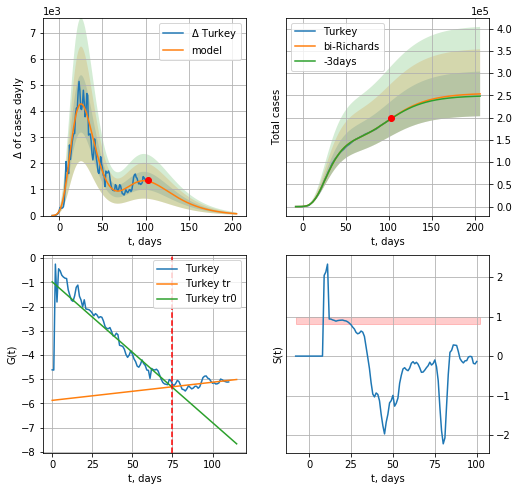

Turkey data at: 2020-06-29
+3 day model MAPE: 0.001972
model: bi-Richards
coeffs: [ 9.40169415e+04  3.18037108e+00 -1.88661013e+01  1.16970363e-02]
rational stdev: 0.198149
forecast at the end of period: +103 days
	 deltaDaycases: 69
	 total cases: 253398 ± 50210
	 total death: 6525 ± 3878
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.779513
 intercept: -0.980015
 slope: -0.058200
trend coefficient of determination: 0.236423
 intercept: -5.877552
 slope: 0.007497


In [179]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


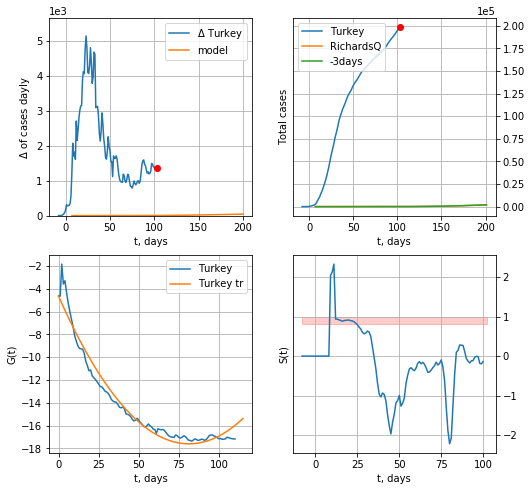

Turkey data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.40696826e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +98 days
	 deltaDaycases: 42


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [180]:
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


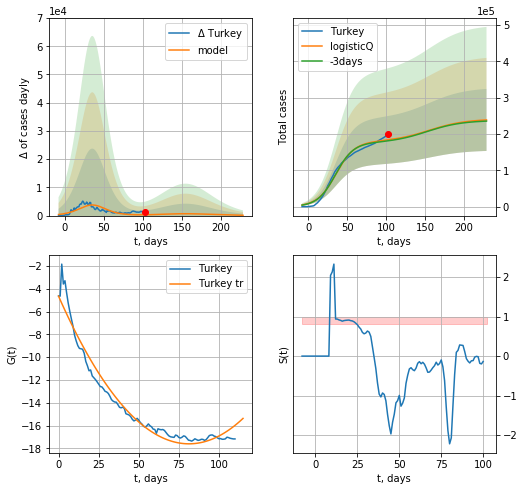

Turkey data at: 2020-06-29
+3 day model MAPE: 0.014105
model: logisticQ
coeffs: [ 1.78219185e+05  1.65825395e-07  3.55417757e+01 -5.07234602e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357804
forecast at the end of period: +126 days
	 deltaDaycases: 108
	 total cases: 238708 ± 85410
	 total death: 6147 ± 6598
trend coefficient of determination: 0.962793
 intercept_: -4.648981584822543
 coeffs_: [ 0.         -0.31869989  0.00196041]


In [181]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [182]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.02685765443151298

In [183]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

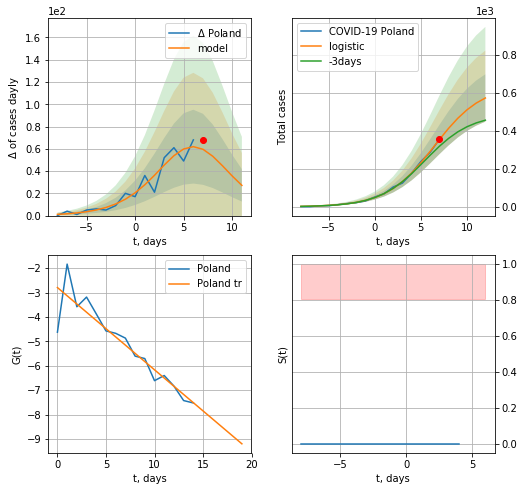

Poland data at: 2020-06-29
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +5 days
	 deltaDaycases:  27
	 total cases:  573 ± 124
	 total death:  24 ± 15
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


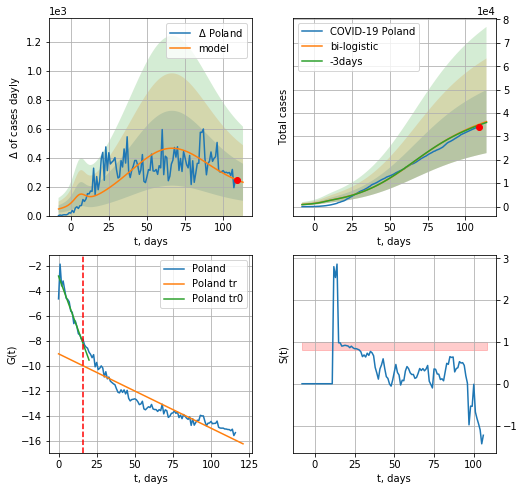

Poland data at: 2020-06-29
+3 day model MAPE: 0.009613287083961915
model: bi-logistic
coeffs:  [3.59444099e+04 5.00240218e-02 6.55457839e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37114868432180814
forecast at the end of period: +5 days
	 deltaDaycases:  230
	 total cases:  36342 ± 13488
	 total death:  1536 ± 1710
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.869820
 intercept: -9.038003
 slope: -0.059710


In [184]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*14-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,14*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


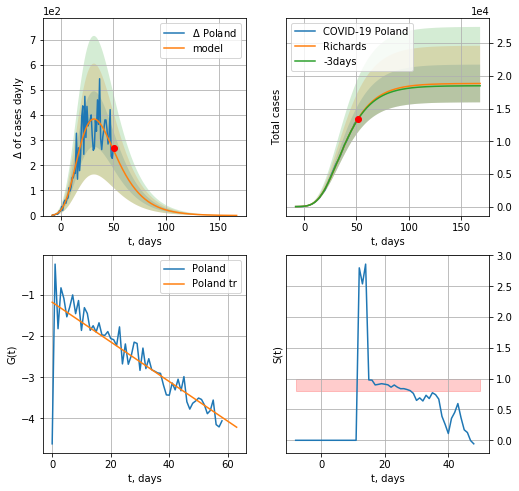

Poland data at: 2020-06-29
+3 day model MAPE: 0.005819
model: Richards
coeffs: [ 1.88418055e+04  3.45583442e+00 -4.15713344e+01  1.61921023e-02]
rational stdev: 0.153201
forecast at the end of period: +117 days
	 deltaDaycases: 0
	 total cases: 18832 ± 2885
	 total death: 796 ± 365
trend coefficient of determination: 0.708781
 intercept: -1.177313
 slope: -0.048172


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


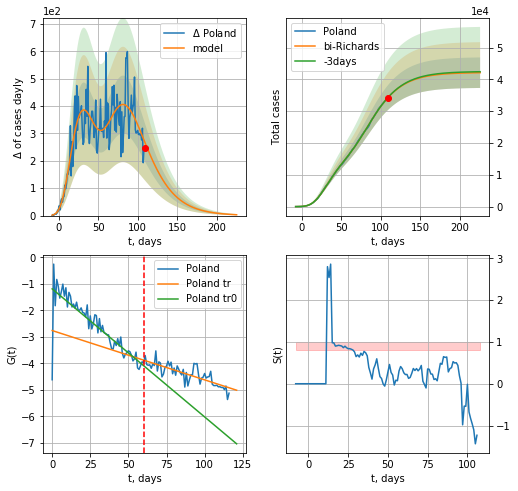

Poland data at: 2020-06-29
+3 day model MAPE: 0.001634
model: bi-Richards
coeffs: [ 2.33444561e+04  2.24584230e+00 -9.43749459e+00  1.84527828e-02]
rational stdev: 0.114001
forecast at the end of period: +117 days
	 deltaDaycases: 3
	 total cases: 42112 ± 4800
	 total death: 1780 ± 608
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.720594
 intercept: -1.188538
 slope: -0.048288
trend coefficient of determination: 0.645483
 intercept: -2.760231
 slope: -0.018593


In [185]:
vL = 60
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


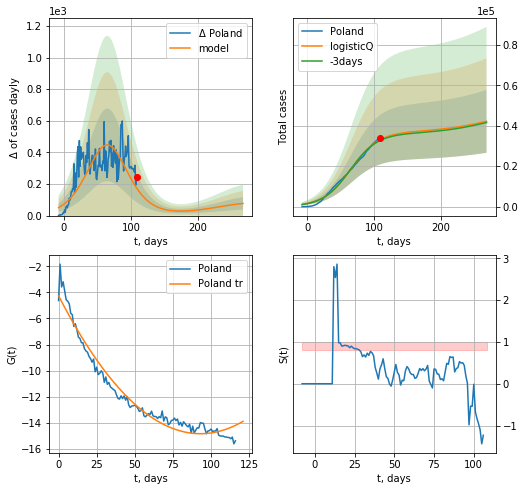

Poland data at: 2020-06-29
+3 day model MAPE: 0.013237
model: logisticQ
coeffs: [ 3.68543898e+04  2.66485215e-07  6.50053666e+01 -1.81501669e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.368972
forecast at the end of period: +159 days
	 deltaDaycases: 76
	 total cases: 42175 ± 15561
	 total death: 1783 ± 1973
trend coefficient of determination: 0.961424
 intercept_: -4.255638922500434
 coeffs_: [ 0.         -0.22704695  0.00121926]


In [186]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
124 2020-06-25  22400.0    6084  309.0
125 2020-06-26  22800.0    5614  314.0
126 2020-06-27  23421.0    6102  317.0
127 2020-06-28  23755.0    6363  318.0
128 2020-06-29  24441.0    6904  319.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


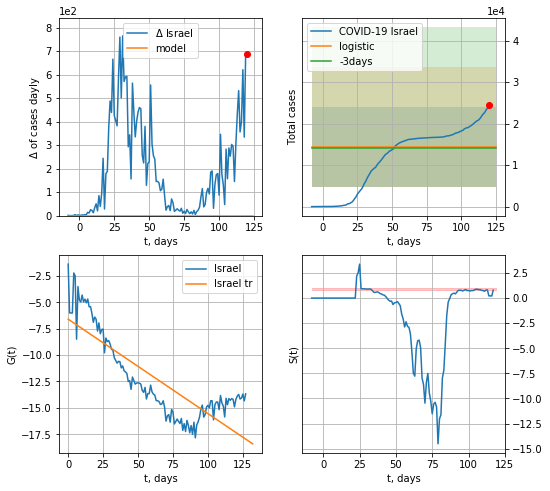

Israel data at: 2020-06-29
+3 day model MAPE: 0.026174937796888002
model: logistic
coeffs:  [ 1.15252564e+04 -4.96763138e+00  1.37686819e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6683624439879245
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  14406 ± 9628
	 total death:  188 ± 376
trend coefficient of determination: 0.688278
 intercept: -6.600865
 slope: -0.089411


In [187]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


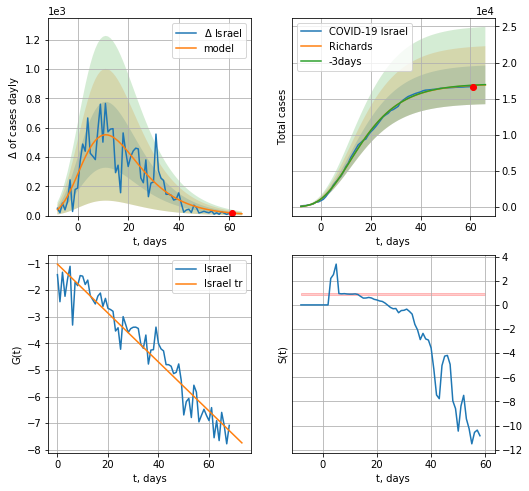

Israel data at: 2020-06-29
+3 day model MAPE: 0.001944
model: Richards
coeffs: [ 1.70515699e+04  6.43111297e+00 -3.67763089e+01  1.37701544e-02]
rational stdev: 0.158199
forecast at the end of period: +5 days
	 deltaDaycases: 12
	 total cases: 16914 ± 2675
	 total death: 220 ± 104
trend coefficient of determination: 0.925544
 intercept: -1.027514
 slope: -0.091953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


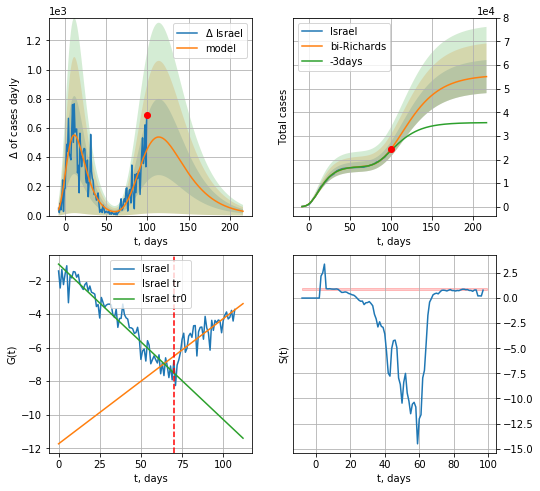

Israel data at: 2020-06-29
+3 day model MAPE: 0.028229
model: bi-Richards
coeffs: [3.88183967e+04 2.55038631e+00 3.31601186e+00 1.48781011e-02]
rational stdev: 0.127322
forecast at the end of period: +117 days
	 deltaDaycases: 29
	 total cases: 55092 ± 7014
	 total death: 719 ± 274
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.928604
 intercept: -1.020733
 slope: -0.092658
trend coefficient of determination: 0.651124
 intercept: -11.733576
 slope: 0.074610


In [188]:
x = forecastRR('Israel',dfIS[20:90],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


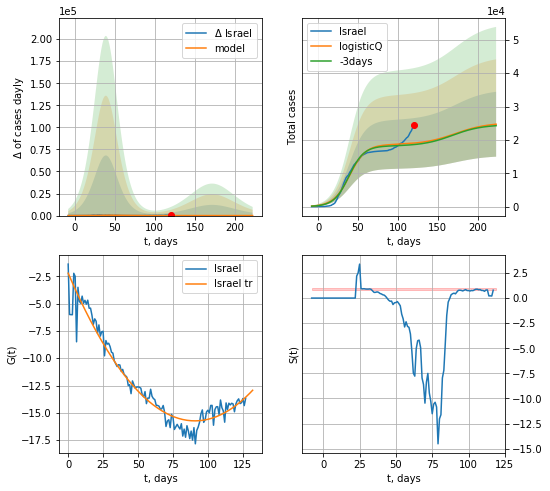

Israel data at: 2020-06-29
+3 day model MAPE: 0.023691
model: logisticQ
coeffs: [ 1.85797519e+04  1.43396099e-07  3.94349252e+01 -6.94657616e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393767
forecast at the end of period: +103 days
	 deltaDaycases: 22
	 total cases: 24688 ± 9721
	 total death: 322 ± 380
trend coefficient of determination: 0.942179
 intercept_: -2.2186663845279817
 coeffs_: [ 0.         -0.29809099  0.00164316]


In [189]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


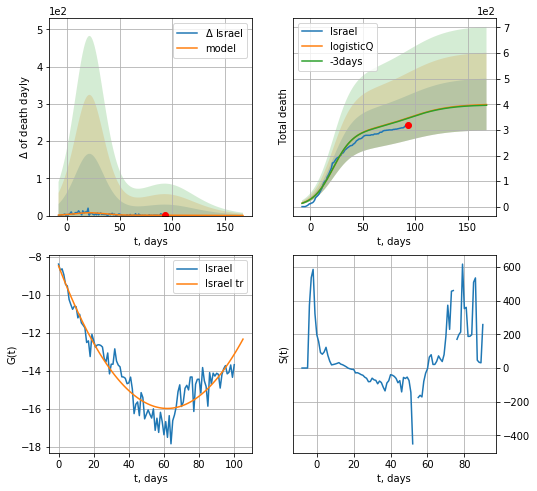

Israel data at: 2020-06-29
+3 day model MAPE: 0.003239
model: logisticQ
coeffs: [ 2.96295934e+02  3.03328107e-07  2.16427801e+01 -3.35329511e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.253023
forecast at the end of period: +75 days
	 total death: 398 ± 100
trend coefficient of determination: 0.904081
 intercept_: -8.476231616391534
 coeffs_: [ 0.         -0.24250739  0.00195993]


In [190]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


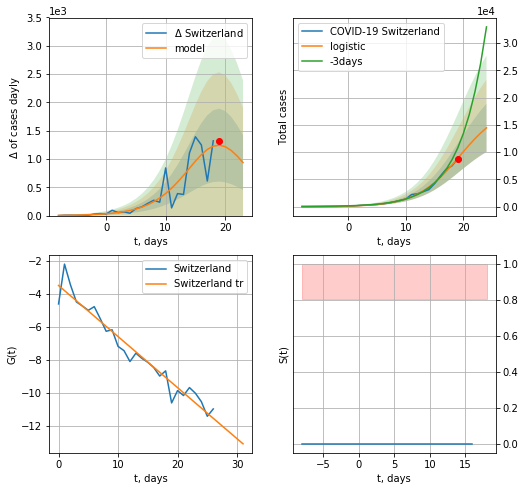

Switzerland data at: 2020-06-29
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +5 days
	 deltaDaycases:  936
	 total cases:  14462 ± 4426
	 total death:  896 ± 822
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


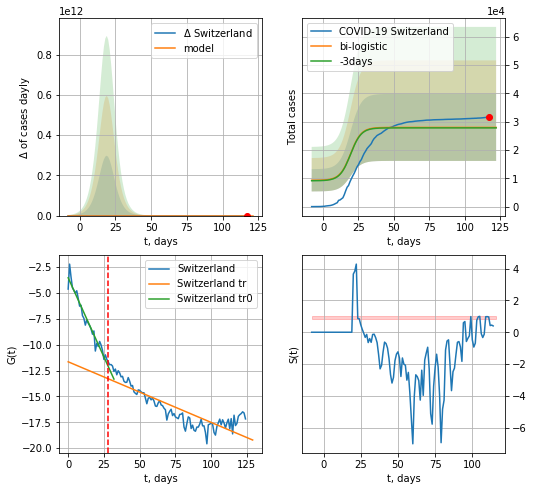

Switzerland data at: 2020-06-29
+3 day model MAPE: 0.005984965301509569
model: bi-logistic
coeffs:  [ 7.43742256e+03 -2.21959658e+00  1.34512162e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4229978749578332
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  28002 ± 11845
	 total death:  1735 ± 2201
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.746069
 intercept: -11.651426
 slope: -0.058582


In [191]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*14-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*14-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


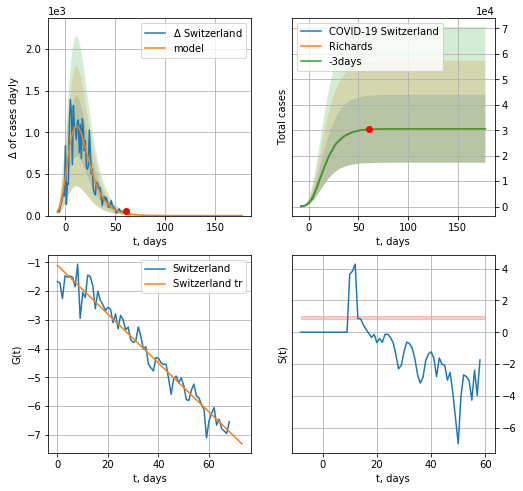

Switzerland data at: 2020-06-29
+3 day model MAPE: 0.000900
model: Richards
coeffs: [ 3.05802442e+04  7.81133256e+00 -3.41505008e+01  1.22973970e-02]
rational stdev: 0.435595
forecast at the end of period: +117 days
	 deltaDaycases: 0
	 total cases: 30580 ± 13320
	 total death: 1895 ± 2476
trend coefficient of determination: 0.956477
 intercept: -1.104106
 slope: -0.085019


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


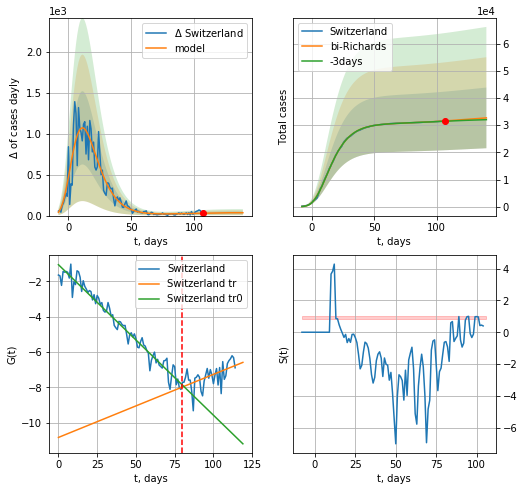

Switzerland data at: 2020-06-29
+3 day model MAPE: 0.003620
model: bi-Richards
coeffs: [ 5.28668347e+03  2.21820031e+00 -1.28880413e+02  8.16964848e-03]
rational stdev: 0.341424
forecast at the end of period: +33 days
	 deltaDaycases: 35
	 total cases: 32659 ± 11150
	 total death: 2024 ± 2073
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.962520
 intercept: -1.063959
 slope: -0.085102
trend coefficient of determination: 0.303287
 intercept: -10.830766
 slope: 0.035660


In [192]:
iL = 10
vL = 80 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*18-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


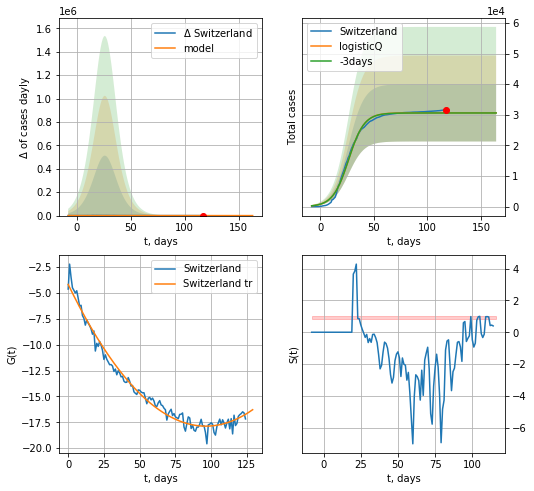

Switzerland data at: 2020-06-29
+3 day model MAPE: 0.001632
model: logisticQ
coeffs: [ 3.06263381e+04  5.04058137e-07  2.64180578e+01 -2.72184261e+05]
rational stdev: 0.305415
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 30626 ± 9353
	 total death: 1898 ± 1739
trend coefficient of determination: 0.981115
 intercept_: -4.179349923643958
 coeffs_: [ 0.         -0.28455944  0.00147856]


In [193]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [194]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date    cases  active   death
107 2020-06-25  40008.0   21183  1067.0
108 2020-06-26  41117.0   21732  1086.0
109 2020-06-27  42065.0   22254  1110.0
110 2020-06-28  42982.0   22919  1129.0
111 2020-06-29  43628.0   23454  1147.0


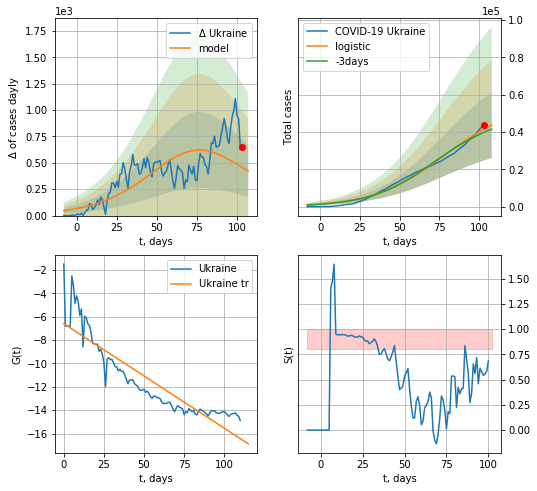

Ukraine data at: 2020-06-29
+3 day model MAPE: 0.04275991691653853
model: logistic
coeffs:  [5.14353689e+04 4.70672653e-02 7.58652861e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.403339149828544
forecast at the end of period: +5 days
	 deltaDaycases:  423
	 total cases:  43603 ± 17587
	 total death:  1146 ± 1386
trend coefficient of determination: 0.814474
 intercept: -6.600042
 slope: -0.089358


In [195]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


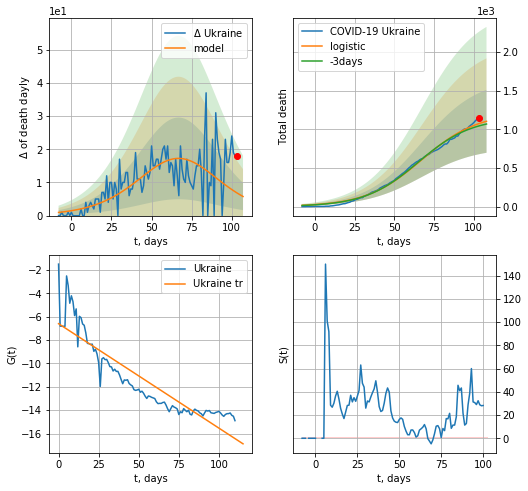

Ukraine data at: 2020-06-29
+3 day model MAPE: 0.029474325581559227
model: logistic
coeffs:  [1.21166491e+03 5.69128497e-02 6.72705263e+01]
rational stdev:  0.36891002204069845
forecast at the end of period: +5 days
	 total death:  1103 ± 406
trend coefficient of determination: 0.814474
 intercept: -6.600042
 slope: -0.089358


In [196]:
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


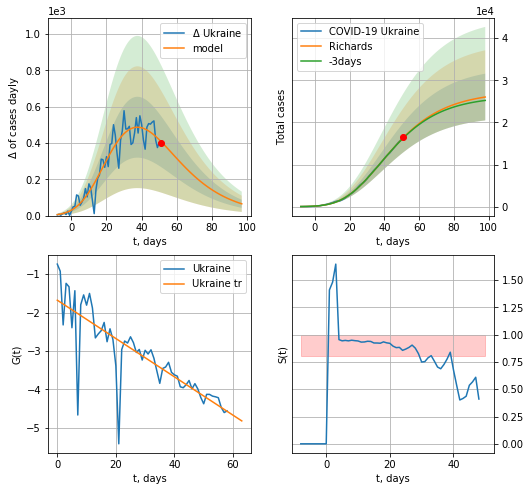

Ukraine data at: 2020-06-29
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152280e+04  5.78390520e-01 -1.00505543e+01  8.74755420e-02]
rational stdev: 0.213278
forecast at the end of period: +47 days
	 deltaDaycases: 64
	 total cases: 26030 ± 5551
	 total death: 684 ± 437
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


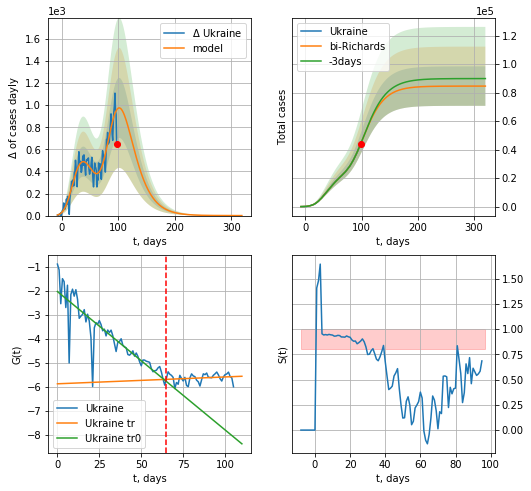

Ukraine data at: 2020-06-29
+3 day model MAPE: 0.000773
model: bi-Richards
coeffs: [5.73035431e+04 2.84127096e-01 6.57163273e+01 1.67106923e-01]
rational stdev: 0.163704
forecast at the end of period: +222 days
	 deltaDaycases: 0
	 total cases: 84616 ± 13852
	 total death: 2224 ± 1092
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.780573
 intercept: -2.035459
 slope: -0.057605
trend coefficient of determination: 0.035173
 intercept: -5.874676
 slope: 0.002848


In [197]:
vL = 65+5
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*20-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*45-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


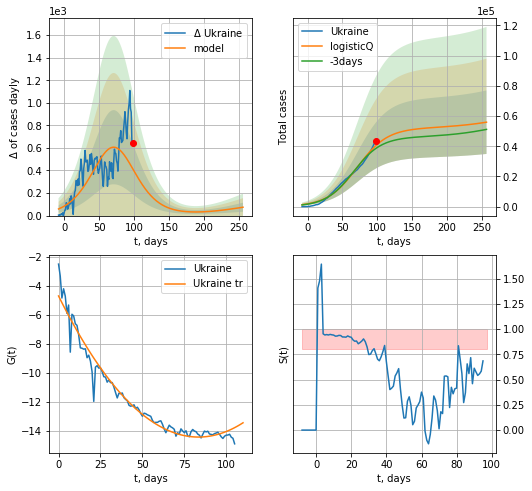

Ukraine data at: 2020-06-29
+3 day model MAPE: 0.051248
model: logisticQ
coeffs: [ 5.18669768e+04  2.88866925e-07  7.12803289e+01 -1.61378546e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.376187
forecast at the end of period: +159 days
	 deltaDaycases: 74
	 total cases: 55919 ± 21036
	 total death: 1470 ± 1658
trend coefficient of determination: 0.961567
 intercept_: -4.710921003230551
 coeffs_: [ 0.         -0.23291258  0.00139538]


In [198]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*36-dT,addpred=True,xcoef=koreaCoeffs)

In [199]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

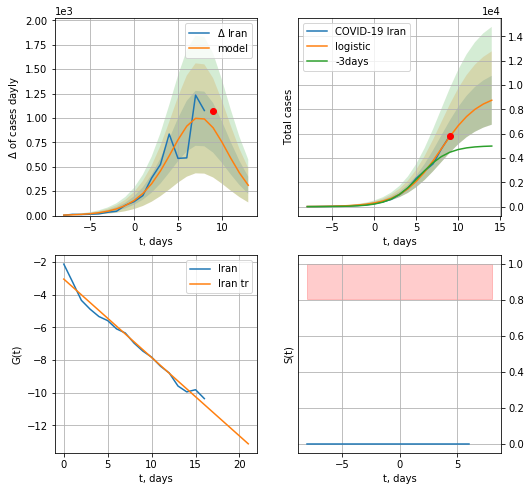

Iran data at: 2020-06-29
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +5 days
	 deltaDaycases:  310
	 total cases:  8741 ± 2008
	 total death:  414 ± 285
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


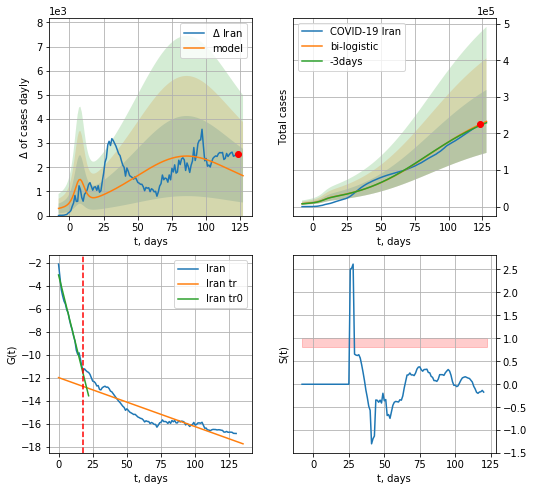

Iran data at: 2020-06-29
+3 day model MAPE: 0.014210391189921847
model: bi-logistic
coeffs:  [2.53205421e+05 3.74187195e-02 8.41376390e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.36971650246601856
forecast at the end of period: +5 days
	 deltaDaycases:  1651
	 total cases:  232979 ± 86136
	 total death:  11038 ± 12242
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.809950
 intercept: -11.962985
 slope: -0.042553


In [200]:
x = forecast('Iran',dfIN[:18],d1,7*14-dT)
xx = forecast2('Iran',dfIN[:],d1,14*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


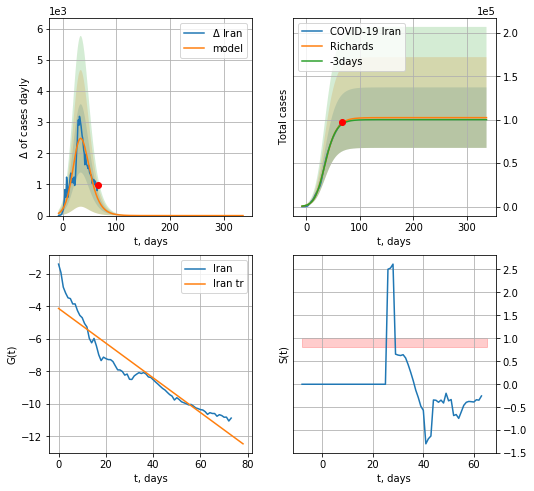

Iran data at: 2020-06-29
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +271 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 4855 ± 4951
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


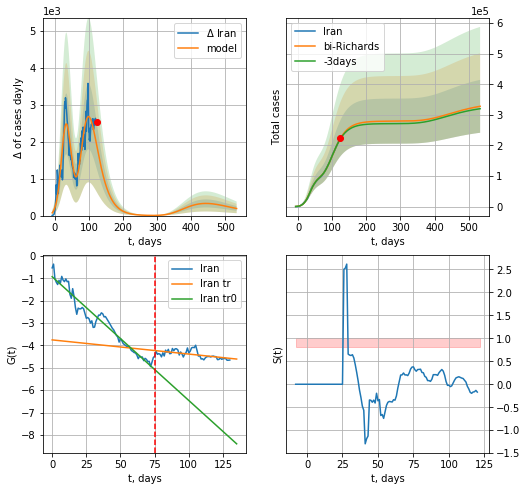

Iran data at: 2020-06-29
+3 day model MAPE: 0.007901
model: bi-Richards
coeffs: [ 1.77158671e+05  3.02042112e+00 -5.59306373e+00  1.35121226e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.263827
forecast at the end of period: +411 days
	 deltaDaycases: 191
	 total cases: 328065 ± 86552
	 total death: 15543 ± 12302
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949245
 intercept: -0.927171
 slope: -0.055332
trend coefficient of determination: 0.334296
 intercept: -3.752029
 slope: -0.006340


In [201]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,52*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,72*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


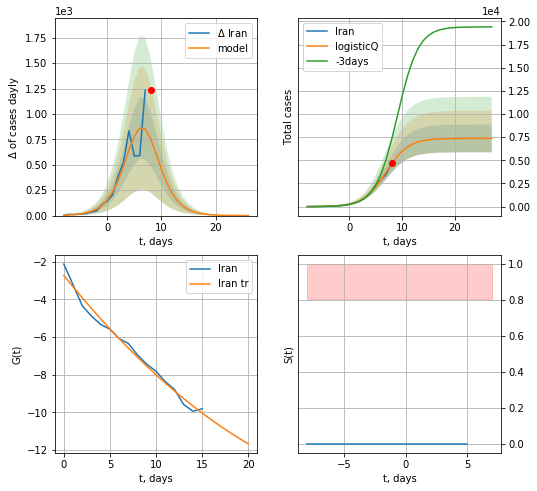

Iran data at: 2020-06-29
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 349 ± 212
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


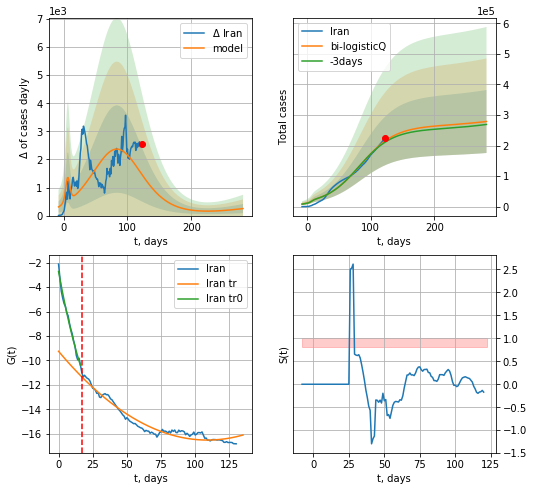

Iran data at: 2020-06-29
+3 day model MAPE: 0.019048
model: bi-logisticQ
coeffs: [ 2.55421813e+05  1.53646664e-07  8.36583791e+01 -2.40503161e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.370258
forecast at the end of period: +159 days
	 deltaDaycases: 249
	 total cases: 278641 ± 103169
	 total death: 13201 ± 14663
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.951402
 intercept_: -9.247771435326971
 coeffs_: [ 0.         -0.133268    0.00061177]


In [202]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active   death
117 2020-06-25  613994.0  230225  8605.0
118 2020-06-26  620794.0  227861  8781.0
119 2020-06-27  627646.0  225325  8969.0
120 2020-06-28  634437.0  226277  9073.0
121 2020-06-29  641156.0  228560  9166.0


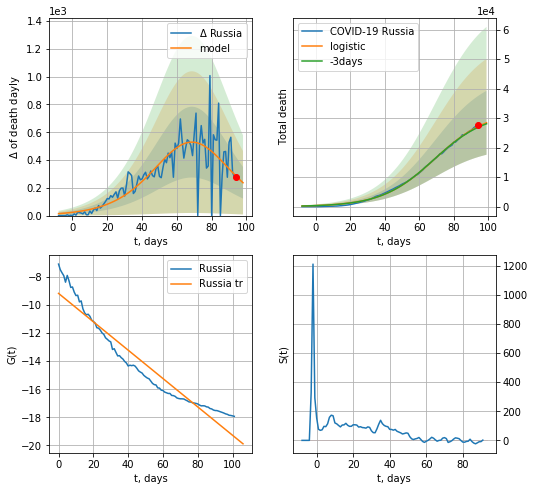

Russia data at: 2020-06-29
+3 day model MAPE: 0.01037824540776741
model: logistic
coeffs:  [3.24566727e+04 6.52029195e-02 6.90975092e+01]
rational stdev:  0.3812158265195151
forecast at the end of period: +5 days
	 total death:  28413 ± 10831
trend coefficient of determination: 0.924283
 intercept: -9.165219
 slope: -0.101159


In [203]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,14*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


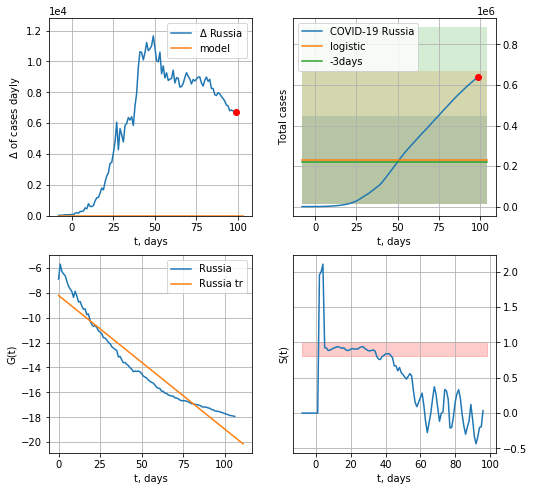

Russia data at: 2020-06-29
+3 day model MAPE: 0.05278993666083479
model: logistic
coeffs:  [ 2.30276833e+05 -6.61927652e+00  1.73186602e+02]
rational stdev:  0.9503201746712275
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  230276 ± 218836
	 total death:  3292 ± 9385
trend coefficient of determination: 0.921611
 intercept: -8.219489
 slope: -0.107293


In [204]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


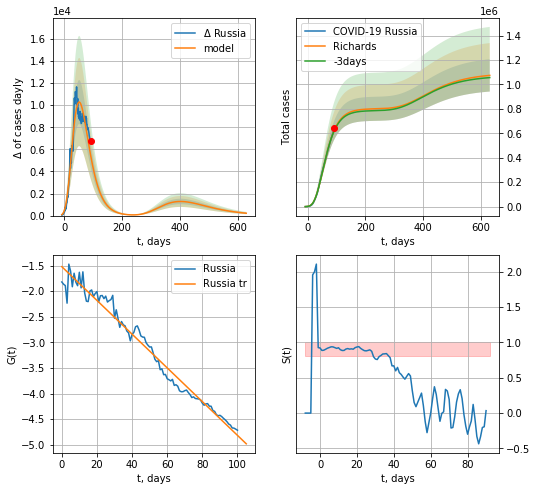

Russia data at: 2020-06-29
+3 day model MAPE: 0.007425
model: Richards
coeffs: [ 8.02007873e+05  2.97319981e+00 -7.41450219e+01  1.17918135e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.123127
forecast at the end of period: +537 days
	 deltaDaycases: 214
	 total cases: 1074260 ± 132270
	 total death: 15357 ± 5672
trend coefficient of determination: 0.974570
 intercept: -1.521664
 slope: -0.032948


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


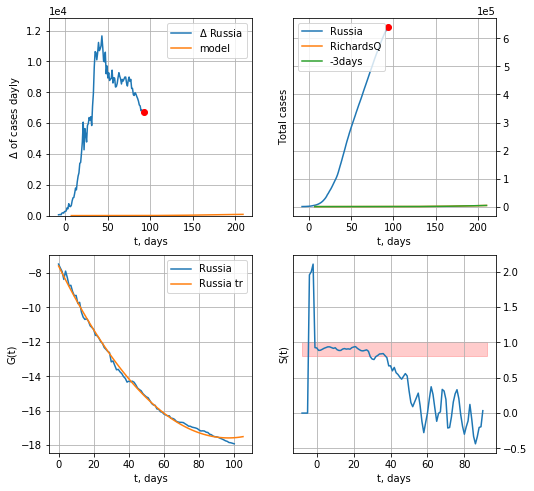

Russia data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.43452012e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +117 days
	 deltaDaycases: 80


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [205]:
x = forecastRR('Russia',dfRS[20:],d1,90*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


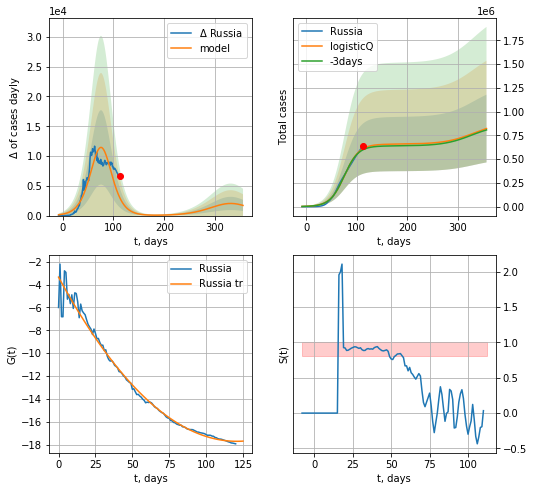

Russia data at: 2020-06-29
+3 day model MAPE: 0.019224
model: logisticQ
coeffs: [ 6.57434437e+05  4.12949238e-07  7.59755756e+01 -1.68557965e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.433963
forecast at the end of period: +243 days
	 deltaDaycases: 1708
	 total cases: 821552 ± 356523
	 total death: 11744 ± 15289
trend coefficient of determination: 0.982399
 intercept_: -3.3490166398369166
 coeffs_: [ 0.         -0.23770628  0.00098365]


In [206]:
x = forecastRRR('Russia',dfRS[:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
155 2020-06-25  18110.0     822  968.0
156 2020-06-26  18197.0     836  969.0
157 2020-06-27  18297.0     874  971.0
158 2020-06-28  18390.0     914  971.0
159 2020-06-29  18476.0     947  972.0


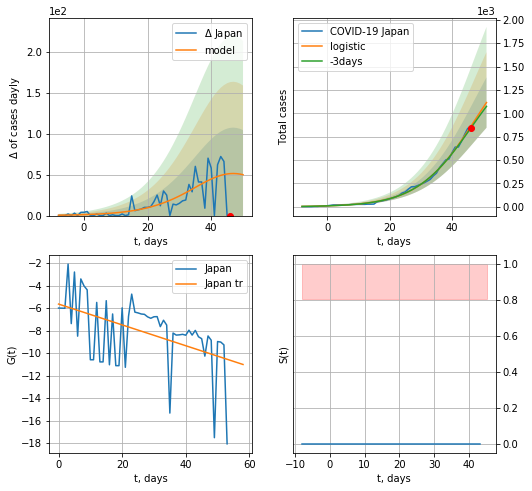

Japan data at: 2020-06-29
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +5 days
	 deltaDaycases:  49
	 total cases:  1115 ± 269
	 total death:  58 ± 42
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


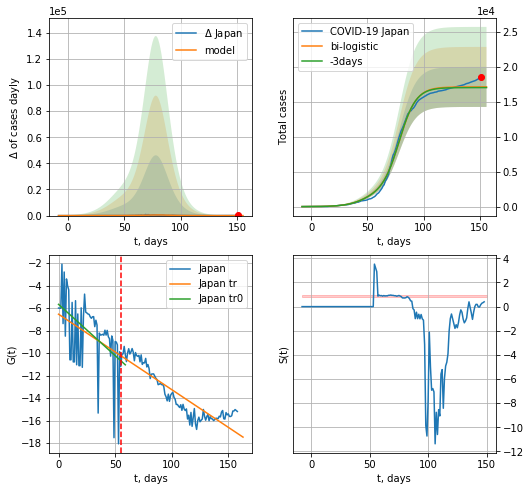

Japan data at: 2020-06-29
+3 day model MAPE: 0.005630690511586994
model: bi-logistic
coeffs:  [1.52533777e+04 1.32718171e-01 7.85651584e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.16715851167159992
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  17119 ± 2861
	 total death:  900 ± 451
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.819784
 intercept: -6.548055
 slope: -0.067033


In [207]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*14-dT)
    xx = forecast2('Japan',dfJP[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

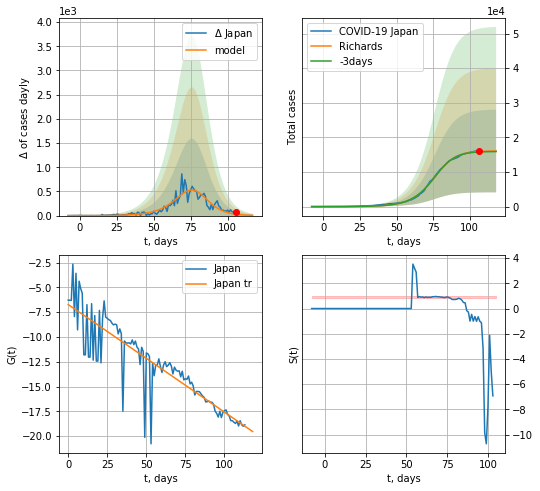

Japan data at: 2020-06-29
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043526e+04 1.05070375e-01 7.85362634e+01 1.40112813e+00]
rational stdev: 0.743333
forecast at the end of period: +12 days
	 deltaDaycases: 5
	 total cases: 16069 ± 11945
	 total death: 845 ± 1884
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


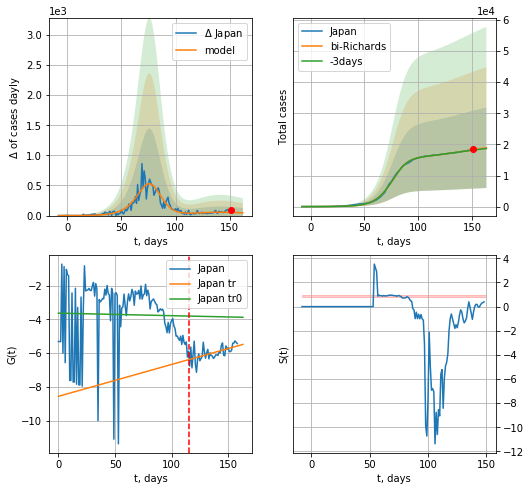

Japan data at: 2020-06-29
+3 day model MAPE: 0.007254
model: bi-Richards
coeffs: [ 4.67737855e+03  4.99134349e+00 -1.46275157e+01  6.45814025e-03]
rational stdev: 0.684208
forecast at the end of period: +12 days
	 deltaDaycases: 46
	 total cases: 18929 ± 12951
	 total death: 995 ± 2042
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.000595
 intercept: -3.627977
 slope: -0.001494
trend coefficient of determination: 0.313514
 intercept: -8.562361
 slope: 0.018898


In [208]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,15*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,15*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


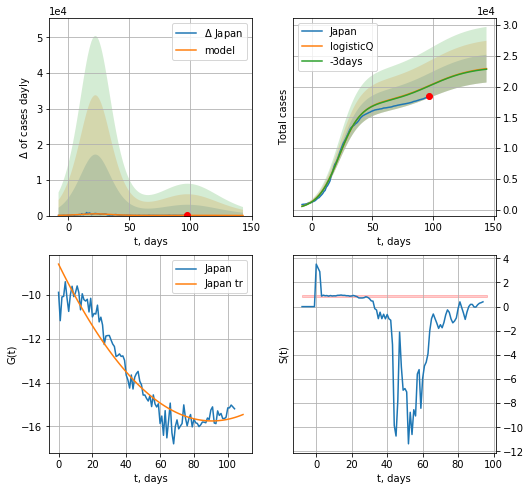

Japan data at: 2020-06-29
+3 day model MAPE: 0.002579
model: logisticQ
coeffs: [ 1.72482773e+04  6.36488921e-07  2.25682003e+01 -1.76218821e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.098598
forecast at the end of period: +47 days
	 deltaDaycases: 23
	 total cases: 22924 ± 2260
	 total death: 1206 ± 356
trend coefficient of determination: 0.925806
 intercept_: -8.607047002325725
 coeffs_: [ 0.         -0.15750157  0.00086848]


In [209]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


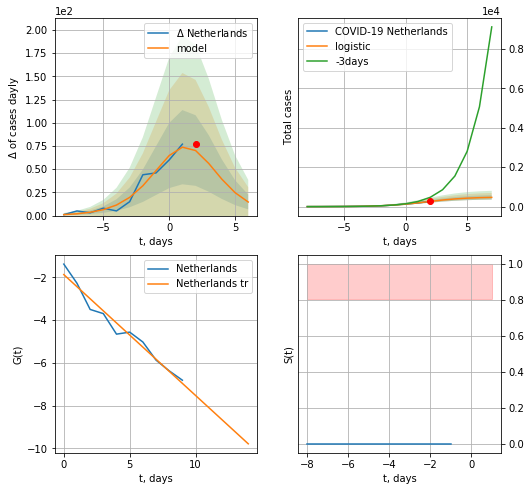

Netherlands data at: 2020-06-29
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +5 days
	 deltaDaycases:  14
	 total cases:  469 ± 111
	 total death:  57 ± 40
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


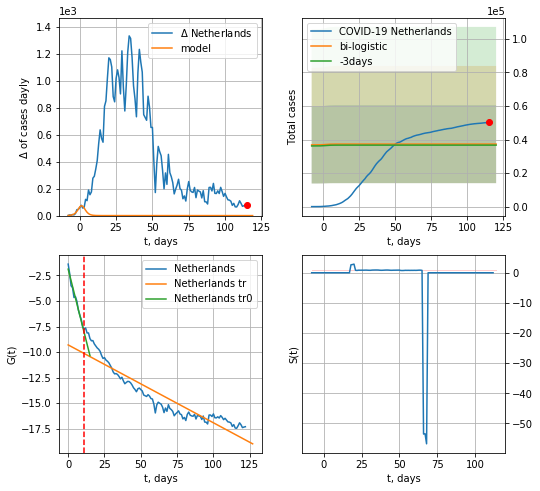

Netherlands data at: 2020-06-29
+3 day model MAPE: 0.017084329314280087
model: bi-logistic
coeffs:  [ 2.94462529e+04 -5.80994545e+00  1.69744183e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6247297292306123
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  37295 ± 23299
	 total death:  4535 ± 8499
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.865441
 intercept: -9.303371
 slope: -0.076303


In [210]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,14*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
           date  cases  active   death
119 2020-06-25  49914       0  6100.0
120 2020-06-26  50005       0  6103.0
121 2020-06-27  50074       0  6105.0
122 2020-06-28  50147       0  6105.0
123 2020-06-29  50223       0  6107.0


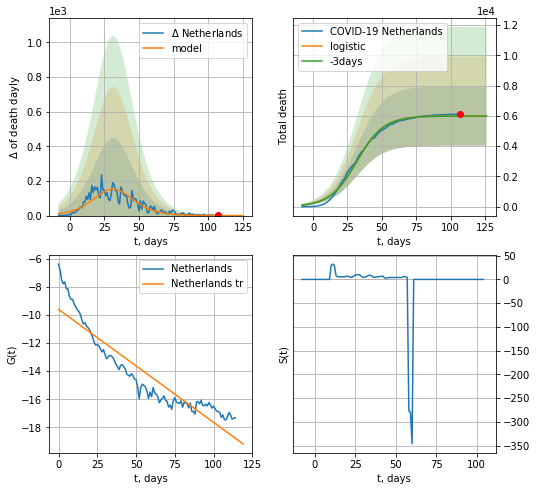

Netherlands data at: 2020-06-29
+3 day model MAPE: 0.0016662321290420714
model: logistic
coeffs:  [5.98884222e+03 1.02228196e-01 3.18398232e+01]
rational stdev:  0.327472249520175
forecast at the end of period: +19 days
	 total death:  5988 ± 1961
trend coefficient of determination: 0.861080
 intercept: -9.599646
 slope: -0.080402


In [211]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


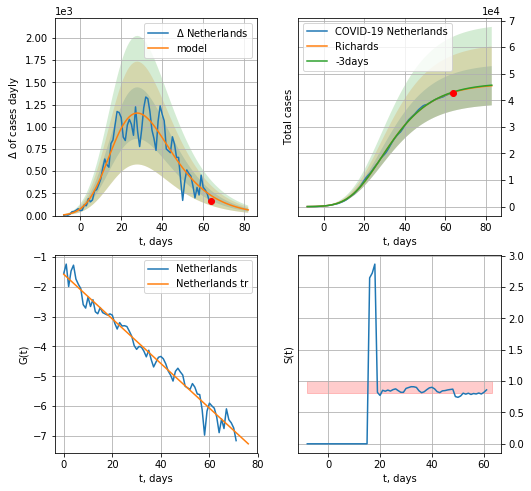

Netherlands data at: 2020-06-29
+3 day model MAPE: 0.002842
model: Richards
coeffs: [4.63365786e+04 4.92236139e-01 2.02382698e+00 1.47660483e-01]
rational stdev: 0.162270
forecast at the end of period: +19 days
	 deltaDaycases: 64
	 total cases: 45473 ± 7379
	 total death: 5529 ± 2691
trend coefficient of determination: 0.973735
 intercept: -1.579499
 slope: -0.074799


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


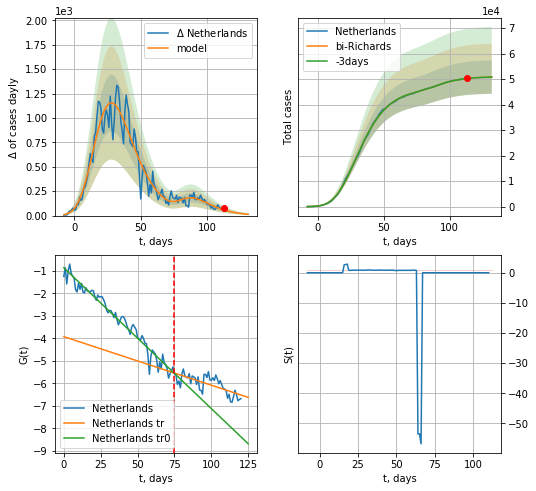

Netherlands data at: 2020-06-29
+3 day model MAPE: 0.000048
model: bi-Richards
coeffs: [4.61202229e+03 4.94530557e+00 4.30577962e+01 1.72214334e-02]
rational stdev: 0.128903
forecast at the end of period: +19 days
	 deltaDaycases: 13
	 total cases: 50788 ± 6546
	 total death: 6175 ± 2387
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.961932
 intercept: -0.859847
 slope: -0.062626
trend coefficient of determination: 0.495791
 intercept: -3.922632
 slope: -0.021604


In [212]:
vL = 75
x = forecastRR('Netherlands',dfNL[2:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[2:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


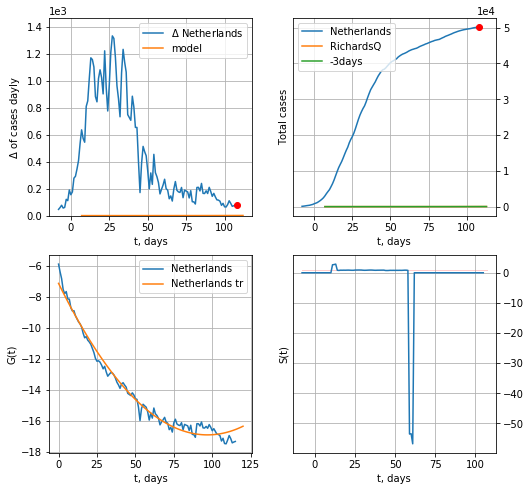

Netherlands data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.85848799e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +5 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [213]:
x = forecastQR('Netherlands',dfNL[7:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


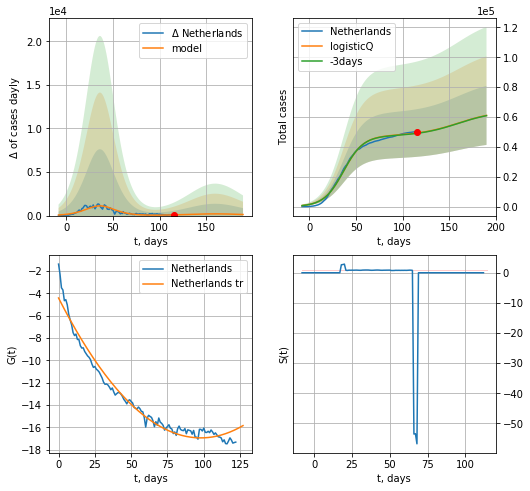

Netherlands data at: 2020-06-29
+3 day model MAPE: 0.004485
model: logisticQ
coeffs: [ 4.74929480e+04  2.83296739e-07  3.66417144e+01 -3.31817003e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.323570
forecast at the end of period: +75 days
	 deltaDaycases: 125
	 total cases: 61072 ± 19761
	 total death: 7426 ± 7208
trend coefficient of determination: 0.970061
 intercept_: -4.419494452297835
 coeffs_: [ 0.         -0.25560245  0.00130458]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


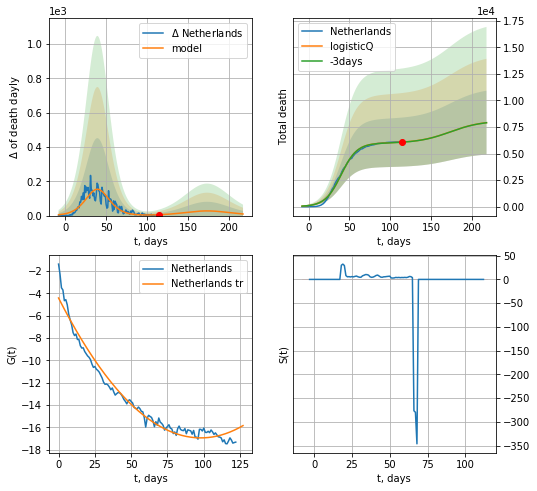

Netherlands data at: 2020-06-29
+3 day model MAPE: 0.001672
model: logisticQ
coeffs: [ 5.98748740e+03  4.05650135e-07  3.98374917e+01 -2.52528011e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.380092
forecast at the end of period: +103 days
	 total death: 7912 ± 3007
trend coefficient of determination: 0.970061
 intercept_: -4.419494452297835
 coeffs_: [ 0.         -0.25560245  0.00130458]


In [214]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [215]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


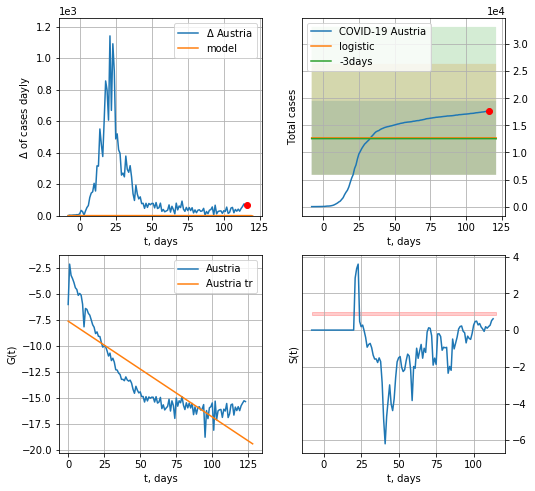

Austria data at: 2020-06-29
+3 day model MAPE: 0.011877433292927569
model: logistic
coeffs:  [ 1.19486801e+04 -3.56441632e+00  1.23392316e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.5375609568986378
forecast at the end of period: +5 days
	 deltaDaycases:  -2
	 total cases:  12693 ± 6823
	 total death:  503 ± 811
trend coefficient of determination: 0.735914
 intercept: -7.604080
 slope: -0.092084


In [216]:
x = forecast('Austria',dfAT[:],d1,7*14-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

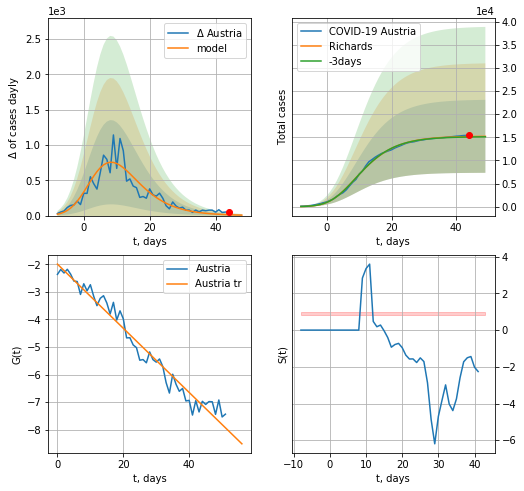

Austria data at: 2020-06-29
+3 day model MAPE: 0.006824
model: Richards
coeffs: [ 1.52413256e+04  8.30508829e-01 -3.03588001e+00  1.76502169e-01]
rational stdev: 0.518621
forecast at the end of period: +5 days
	 deltaDaycases: 6
	 total cases: 15199 ± 7882
	 total death: 602 ± 936
trend coefficient of determination: 0.965129
 intercept: -1.995756
 slope: -0.116348


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


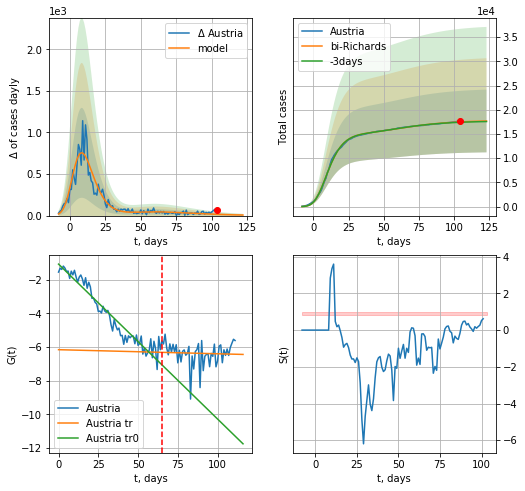

Austria data at: 2020-06-29
+3 day model MAPE: 0.004489
model: bi-Richards
coeffs: [ 2.58839816e+03  7.51503819e+00 -4.81097101e+01  6.16100388e-03]
rational stdev: 0.365873
forecast at the end of period: +19 days
	 deltaDaycases: 6
	 total cases: 17681 ± 6469
	 total death: 701 ± 769
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.933057
 intercept: -1.063390
 slope: -0.092164
trend coefficient of determination: 0.002220
 intercept: -6.154653
 slope: -0.002429


In [217]:
vL=65+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


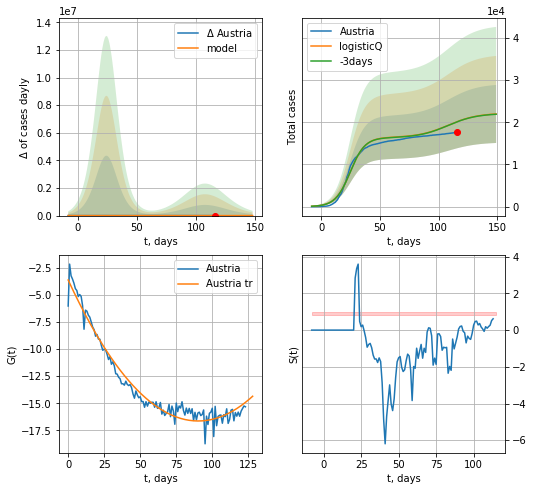

Austria data at: 2020-06-29
+3 day model MAPE: 0.001315
model: logisticQ
coeffs: [ 1.63923956e+04  3.38886561e-07  2.48137964e+01 -4.68359758e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313198
forecast at the end of period: +33 days
	 deltaDaycases: 17
	 total cases: 21983 ± 6885
	 total death: 872 ± 819
trend coefficient of determination: 0.964595
 intercept_: -3.594399943516576
 coeffs_: [ 0.         -0.28928545  0.00160328]


In [218]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
116 2020-06-25  61007.0   34391  9726.0
117 2020-06-26  61106.0   34457  9731.0
118 2020-06-27  61209.0   34536  9732.0
119 2020-06-28  61295.0   34622  9732.0
120 2020-06-29  61361.0   34688  9732.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


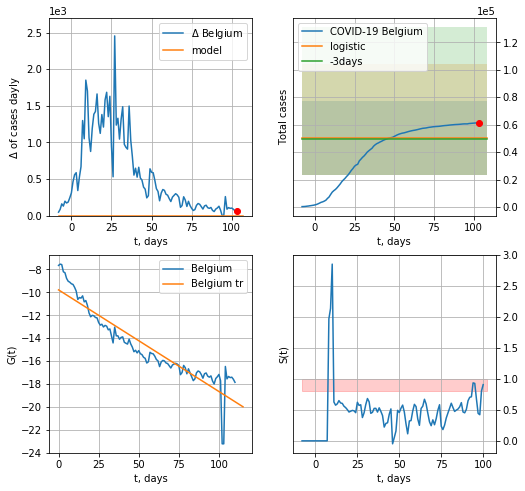

Belgium data at: 2020-06-29
+3 day model MAPE: 0.01457158387841343
model: logistic
coeffs:  [ 4.02727759e+04 -8.10939130e+00  2.62017165e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.5355170281833627
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  50340 ± 26958
	 total death:  7984 ± 12826
trend coefficient of determination: 0.862220
 intercept: -9.784475
 slope: -0.088775


In [219]:
vL=9
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[vL:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
           date    cases  active   death
116 2020-06-25  61007.0   34391  9726.0
117 2020-06-26  61106.0   34457  9731.0
118 2020-06-27  61209.0   34536  9732.0
119 2020-06-28  61295.0   34622  9732.0
120 2020-06-29  61361.0   34688  9732.0


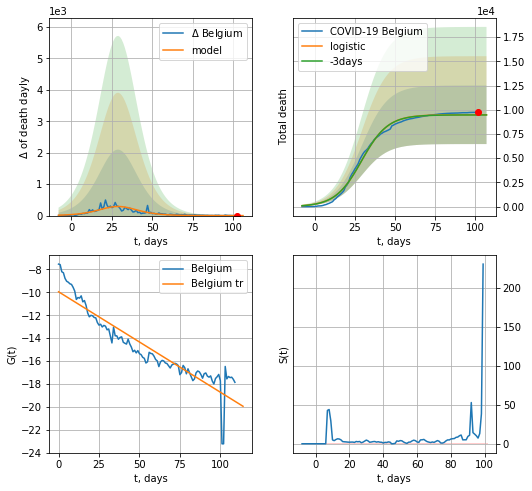

Belgium data at: 2020-06-29
+3 day model MAPE: 0.0020670381542915468
model: logistic
coeffs:  [9.48449612e+03 1.22208802e-01 2.91659265e+01]
rational stdev:  0.31883319654734377
forecast at the end of period: +5 days
	 total death:  9483 ± 3023
trend coefficient of determination: 0.860084
 intercept: -9.950916
 slope: -0.087706


In [220]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,14*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


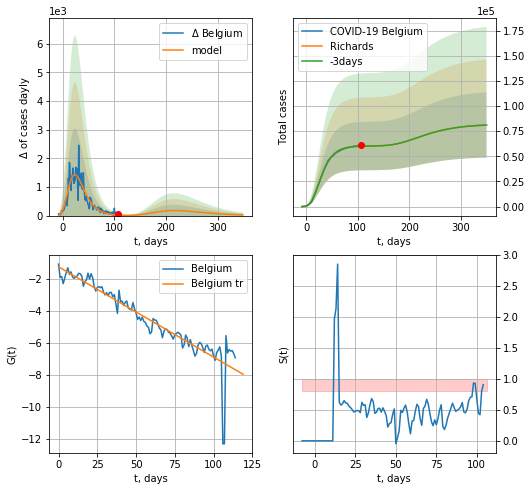

Belgium data at: 2020-06-29
+3 day model MAPE: 0.001975
model: Richards
coeffs: [ 6.04676287e+04  7.55668757e+00 -4.99556844e+01  8.52217088e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.399898
forecast at the end of period: +243 days
	 deltaDaycases: 24
	 total cases: 81260 ± 32496
	 total death: 12888 ± 15461
trend coefficient of determination: 0.847146
 intercept: -1.249109
 slope: -0.056398


In [221]:
x = forecastRR('Belgium',dfBG[5:],d1,48*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


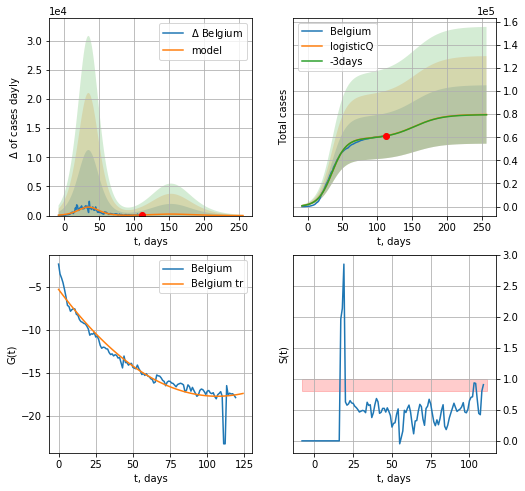

Belgium data at: 2020-06-29
+3 day model MAPE: 0.003121
model: logisticQ
coeffs: [ 5.89339484e+04  3.46698324e-07  3.52059023e+01 -2.85807713e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317000
forecast at the end of period: +145 days
	 deltaDaycases: 6
	 total cases: 79687 ± 25261
	 total death: 12638 ± 12018
trend coefficient of determination: 0.941145
 intercept_: -5.299700397218514
 coeffs_: [ 0.         -0.23242848  0.00108876]


In [222]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [223]:
dfBZ.tail()

,date,cases,active,death
121,2020-06-25,1233147.0,504364,55054.0
122,2020-06-26,1280054.0,526419,56109.0
123,2020-06-27,1315941.0,542933,57103.0
124,2020-06-28,1345254.0,553748,57658.0
125,2020-06-29,1370488.0,554641,58385.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


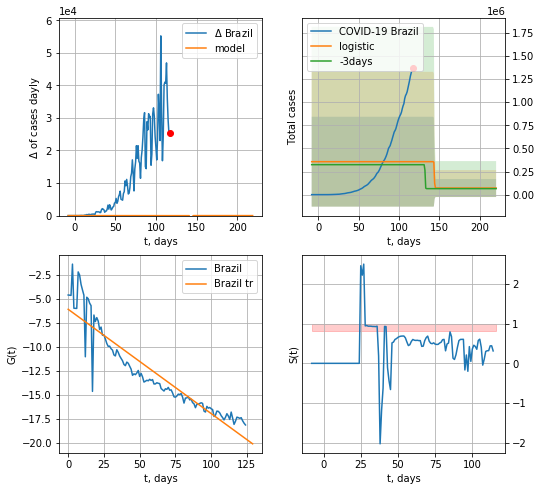

Brazil data at: 2020-06-29
+3 day model MAPE: 0.09968239950233566
model: logistic
coeffs:  [ 2.84934167e+05 -5.58568479e+00  1.43735078e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3635246943006698
forecast at the end of period: +103 days
	 deltaDaycases:  0
	 total cases:  71233 ± 97128
	 total death:  3034 ± 12410
trend coefficient of determination: 0.866845
 intercept: -6.110145
 slope: -0.108329


In [224]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:62: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


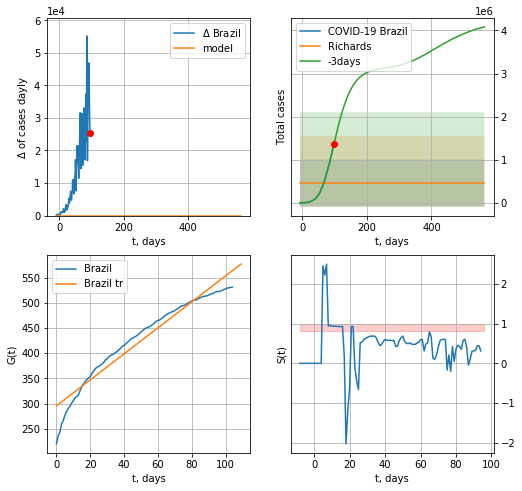

Brazil data at: 2020-06-29
+3 day model MAPE: 0.666246
model: Richards
coeffs: [ 3.38688067e+05 -2.44653977e-02 -1.37765623e+02 -3.78662182e+01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 1.185522
forecast at the end of period: +467 days
	 deltaDaycases: 0
	 total cases: 461436 ± 547042
	 total death: 19657 ± 69911
trend coefficient of determination: 0.940638
 intercept: 295.597168
 slope: 2.579479


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


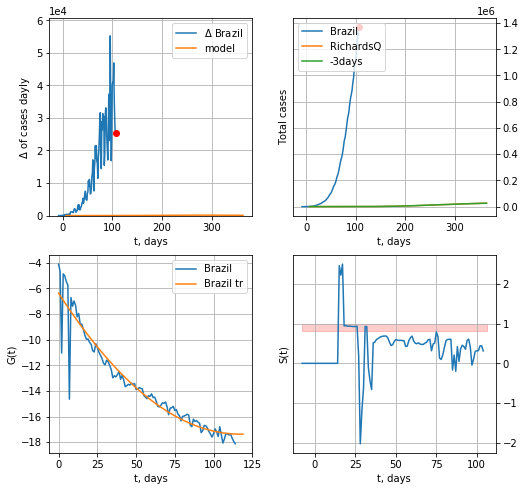

Brazil data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.54597654e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +257 days
	 deltaDaycases: 92


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [225]:
x = forecastRR('Brazil',dfBZ[20:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


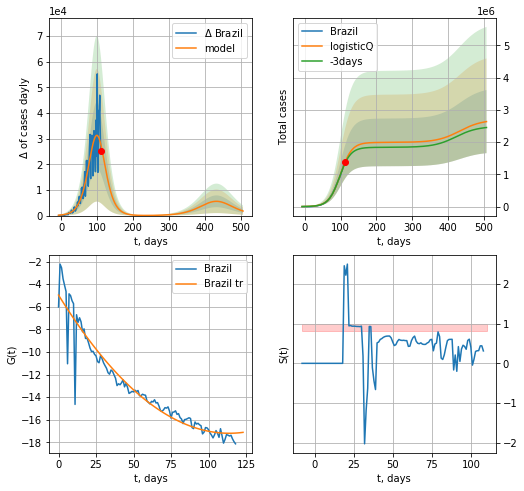

Brazil data at: 2020-06-29
+3 day model MAPE: 0.026116
model: logisticQ
coeffs: [ 1.99076413e+06  1.41315301e-06  9.93638819e+01 -4.43852308e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371299
forecast at the end of period: +397 days
	 deltaDaycases: 1770
	 total cases: 2635307 ± 978487
	 total death: 112268 ± 125054
trend coefficient of determination: 0.921753
 intercept_: -4.967956795290467
 coeffs_: [ 0.         -0.21482043  0.0009438 ]


In [226]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [227]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date   cases  active  death
131 2020-06-25  7595.0     533  104.0
132 2020-06-26  7641.0     558  104.0
133 2020-06-27  7686.0     603  104.0
134 2020-06-28  7764.0     653  104.0
135 2020-06-29  7836.0     724  104.0


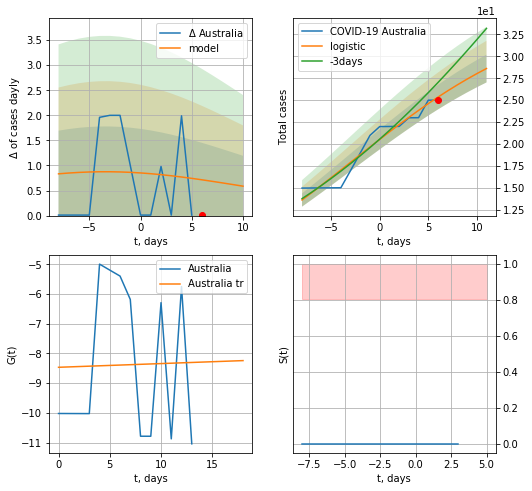

Australia data at: 2020-06-29
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  28 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


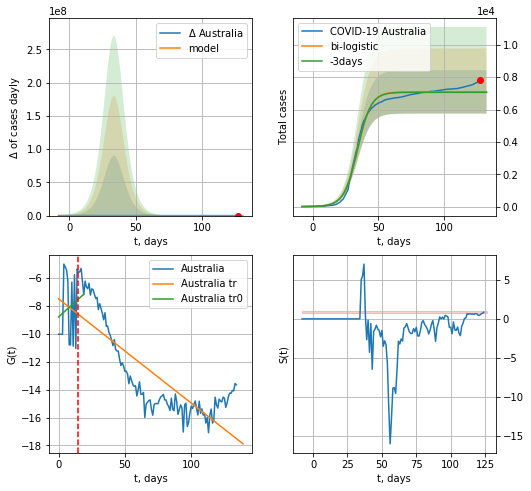

Australia data at: 2020-06-29
+3 day model MAPE: 0.004192945386013005
model: bi-logistic
coeffs:  [7.05256258e+03 1.93719163e-01 3.41717878e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.1883502495270821
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  7088 ± 1335
	 total death:  94 ± 53
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.671228
 intercept: -7.482781
 slope: -0.074832


In [228]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,14*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,14*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


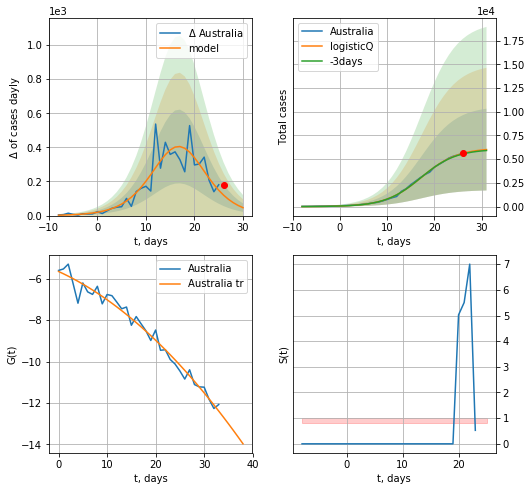

Australia data at: 2020-06-29
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +5 days
	 deltaDaycases: 46
	 total cases: 6009 ± 4307
	 total death: 79 ± 169
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


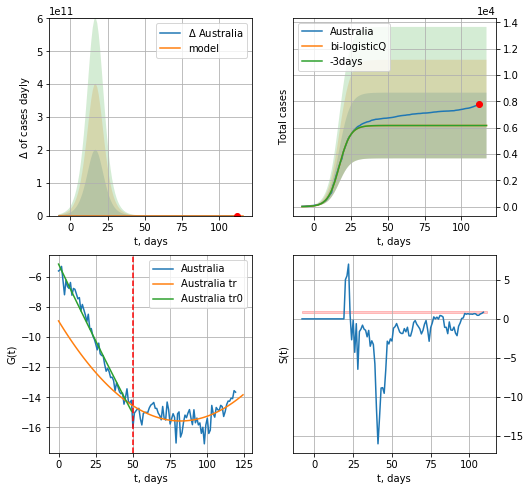

Australia data at: 2020-06-29
+3 day model MAPE: 0.000000
model: bi-logisticQ
coeffs: [-2.32807755 -0.06237083 24.67167067  0.14024658]
rational stdev: 0.404974
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 6168 ± 2497
	 total death: 81 ± 98
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.280698
 intercept_: -8.923462994203934
 coeffs_: [ 0.         -0.16205187  0.00098754]


In [229]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,14*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,14*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

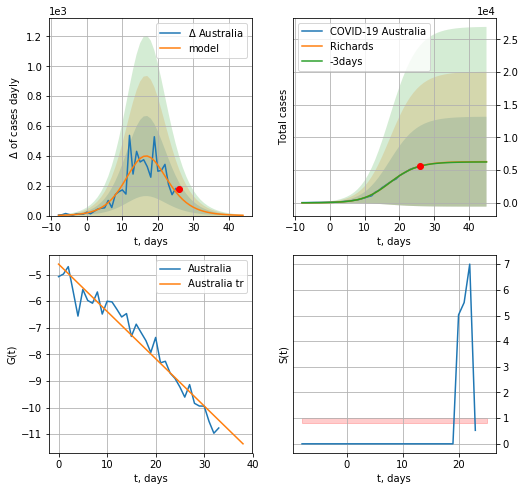

Australia data at: 2020-06-29
+3 day model MAPE: 0.004139
model: Richards
coeffs: [6.29844024e+03 2.85463605e-01 1.64695760e+01 8.48736456e-01]
rational stdev: 1.092498
forecast at the end of period: +19 days
	 deltaDaycases: 2
	 total cases: 6291 ± 6872
	 total death: 83 ± 272
trend coefficient of determination: 0.945167
 intercept: -4.606318
 slope: -0.177832


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


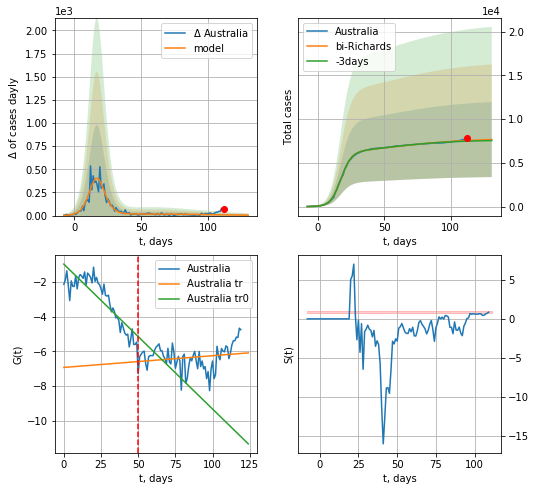

Australia data at: 2020-06-29
+3 day model MAPE: 0.010525
model: bi-Richards
coeffs: [ 1.52634119e+03  4.27303292e+00 -1.01870791e+02  7.17788466e-03]
rational stdev: 0.559377
forecast at the end of period: +19 days
	 deltaDaycases: 4
	 total cases: 7665 ± 4287
	 total death: 101 ± 169
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.755161
 intercept: -0.973477
 slope: -0.083473
trend coefficient of determination: 0.036336
 intercept: -6.924805
 slope: 0.006755


In [230]:
x = forecastRR('Australia',dfAS[15:50],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[15:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=50)

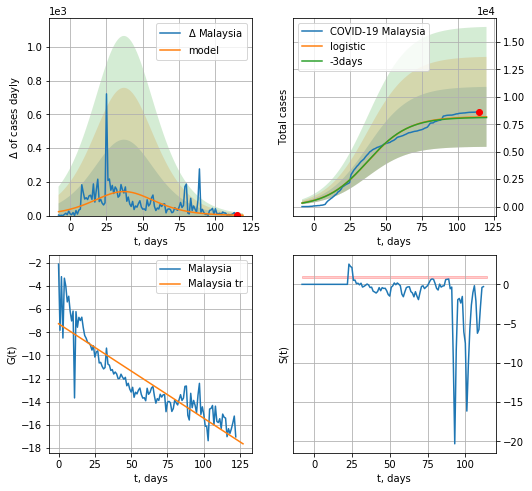

Malaysia data at: 2020-06-29
+3 day model MAPE: 0.007438359673340072
model: logistic
coeffs:  [8.20280932e+03 6.95047078e-02 3.74863408e+01]
rational stdev:  0.3340108734821994
forecast at the end of period: +5 days
	 deltaDaycases:  1
	 total cases:  8176 ± 2731
	 total death:  114 ± 114
trend coefficient of determination: 0.798437
 intercept: -7.267400
 slope: -0.081604


In [231]:
x = forecast('Malaysia',dfML[:],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

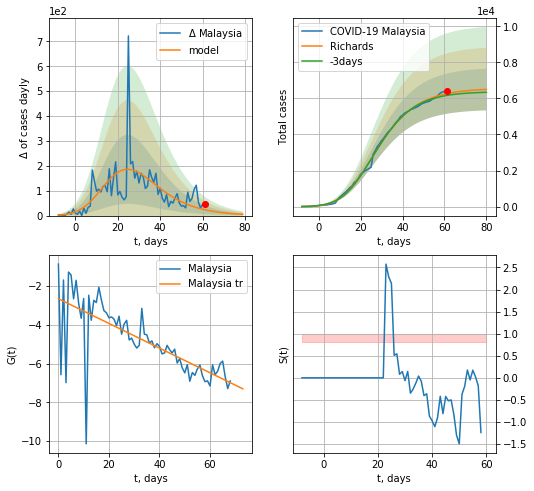

Malaysia data at: 2020-06-29
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55738118e+03 3.88579492e-01 7.38231986e+00 2.20014246e-01]
rational stdev: 0.177891
forecast at the end of period: +19 days
	 deltaDaycases: 5
	 total cases: 6497 ± 1155
	 total death: 91 ± 48
trend coefficient of determination: 0.508698
 intercept: -2.652901
 slope: -0.063638


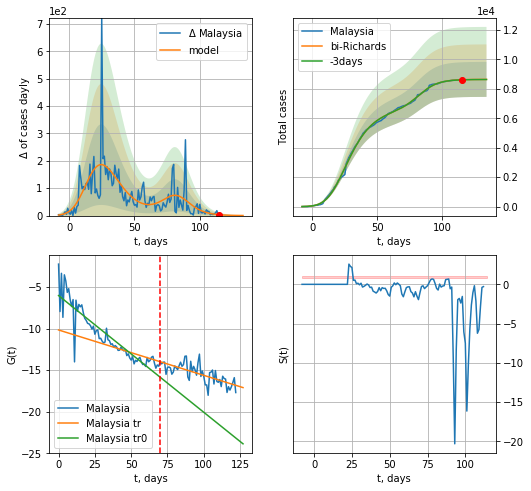

Malaysia data at: 2020-06-29
+3 day model MAPE: 0.000651
model: bi-Richards
coeffs: [2.09086841e+03 1.27337110e-01 8.24856469e+01 1.07319210e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.137535
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 8646 ± 1189
	 total death: 121 ± 49
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.813238
 intercept: -6.020490
 slope: -0.140481
trend coefficient of determination: 0.495757
 intercept: -10.161895
 slope: -0.054597


In [232]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d1,16*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


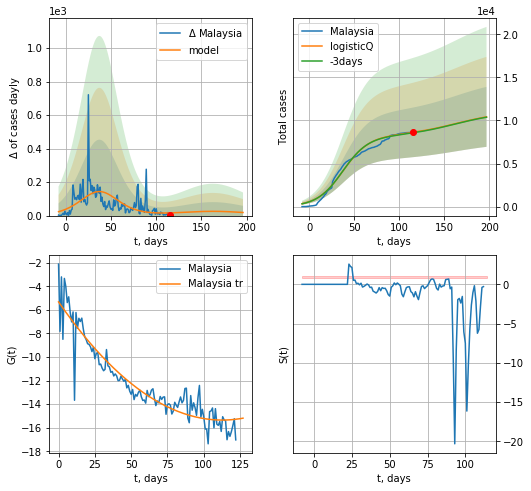

Malaysia data at: 2020-06-29
+3 day model MAPE: 0.006235
model: logisticQ
coeffs: [ 8.20277416e+03  1.28973690e-07  3.74869791e+01 -5.38662100e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334055
forecast at the end of period: +82 days
	 deltaDaycases: 18
	 total cases: 10422 ± 3481
	 total death: 146 ± 146
trend coefficient of determination: 0.873724
 intercept_: -5.326299208320944
 coeffs_: [ 0.         -0.17785897  0.00078899]


In [233]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
118 2020-06-25  1520.0      14   22.0
119 2020-06-26  1522.0      16   22.0
120 2020-06-27  1526.0      20   22.0
121 2020-06-28  1528.0      22   22.0
122 2020-06-29  1528.0      22   22.0


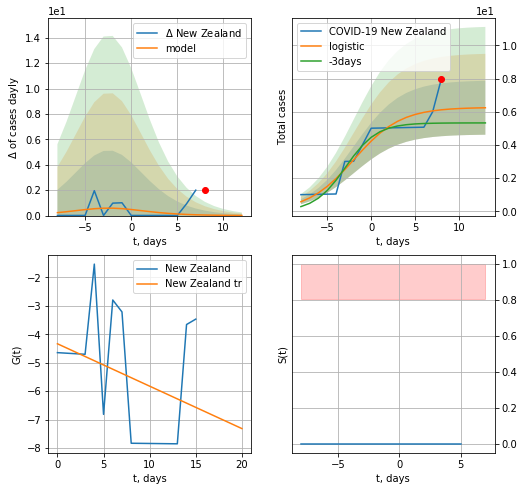

New Zealand data at: 2020-06-29
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


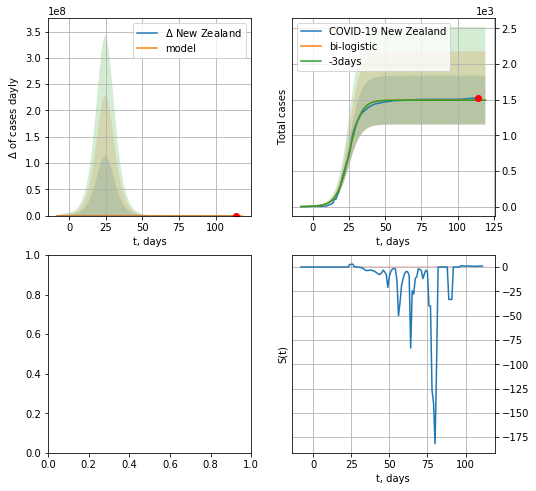

In [234]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,14*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

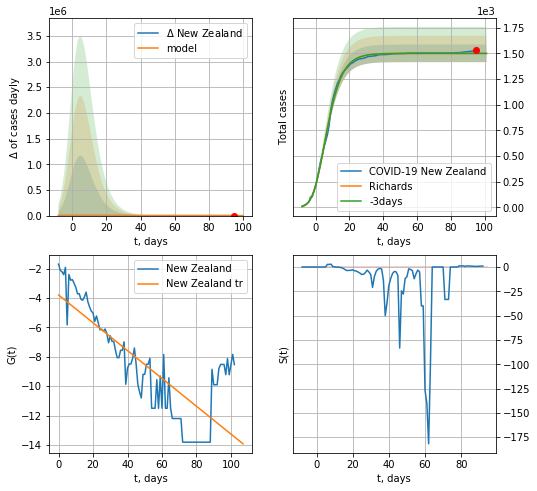

New Zealand data at: 2020-06-28
+3 day model MAPE: 0.000829
model: Richards
coeffs: [ 1.50025356e+03  6.90579480e-01 -2.37035862e+00  2.58210909e-01]
rational stdev: 0.057134
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 1500 ± 85
	 total death: 21 ± 3
trend coefficient of determination: 0.632712
 intercept: -3.788809
 slope: -0.094710


In [217]:
x = forecastRR('New Zealand',dfZL[18:],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


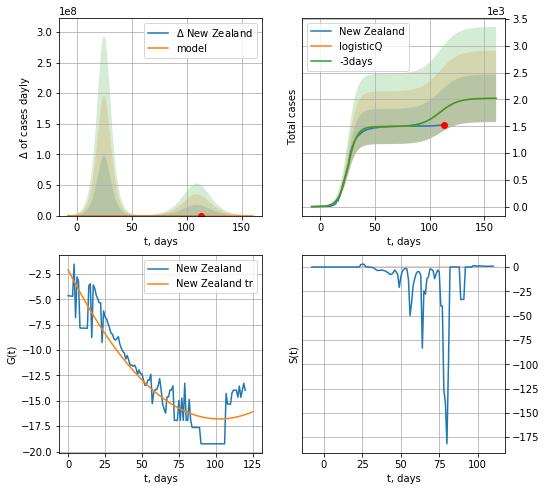

New Zealand data at: 2020-06-28
+3 day model MAPE: 0.000395
model: logisticQ
coeffs: [ 1.49428368e+03  1.96175987e-06  2.51142564e+01 -1.21091207e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.219346
forecast at the end of period: +48 days
	 deltaDaycases: 0
	 total cases: 2022 ± 443
	 total death: 29 ± 19
trend coefficient of determination: 0.854397
 intercept_: -2.093704447582237
 coeffs_: [ 0.         -0.28675927  0.00139924]


In [218]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
118 2020-06-25  60382.0   18567  367.0
119 2020-06-26  60713.0   17651  373.0
120 2020-06-27  61095.0   16592  377.0
121 2020-06-28  61475.0   16065  383.0
122 2020-06-29  61790.0   16190  387.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


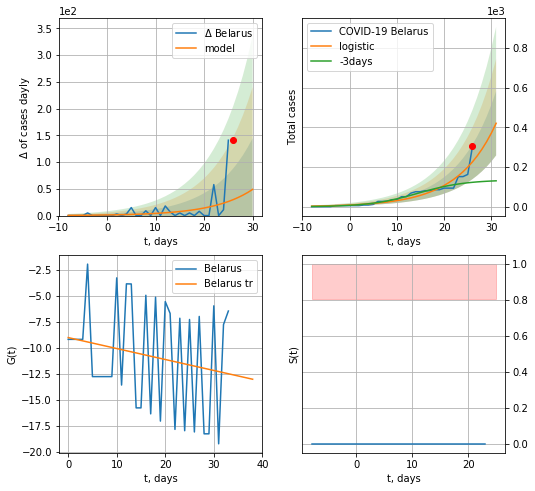

Belarus data at: 2020-06-29
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +5 days
	 deltaDaycases:  49
	 total cases:  420 ± 161
	 total death:  2 ± 2
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


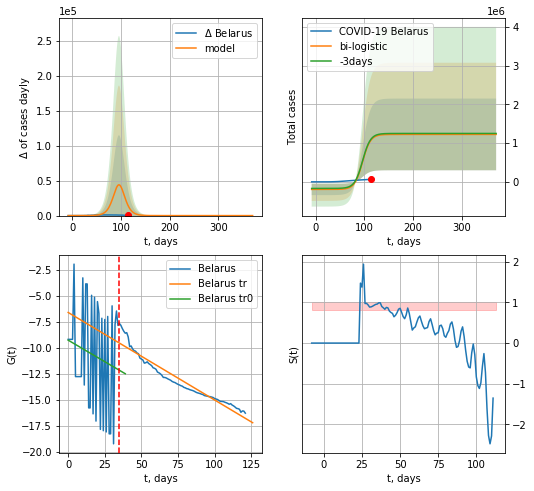

Belarus data at: 2020-06-29
+3 day model MAPE: 0.02233041241016907
model: bi-logistic
coeffs:  [-1.96065661e+05  3.58310900e+01 -8.29193391e+02] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.7558609163986749
forecast at the end of period: +257 days
	 deltaDaycases:  0
	 total cases:  1225913 ± 926620
	 total death:  7678 ± 17410
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.926182
 intercept: -6.625354
 slope: -0.084139


In [235]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*14-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
118 2020-06-25  60382.0   18567  367.0
119 2020-06-26  60713.0   17651  373.0
120 2020-06-27  61095.0   16592  377.0
121 2020-06-28  61475.0   16065  383.0
122 2020-06-29  61790.0   16190  387.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


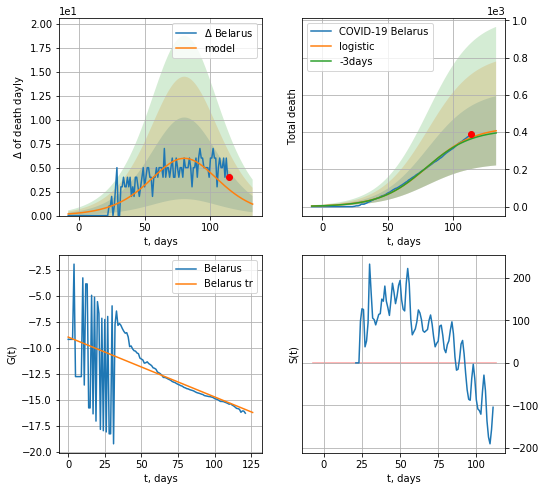

Belarus data at: 2020-06-29
+3 day model MAPE: 0.019890335927395933
model: logistic
coeffs:  [4.28970974e+02 5.56988229e-02 8.06640996e+01]
rational stdev:  0.4566814207705386
forecast at the end of period: +19 days
	 total death:  406 ± 185
trend coefficient of determination: 0.331550
 intercept: -8.992583
 slope: -0.057535


In [236]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


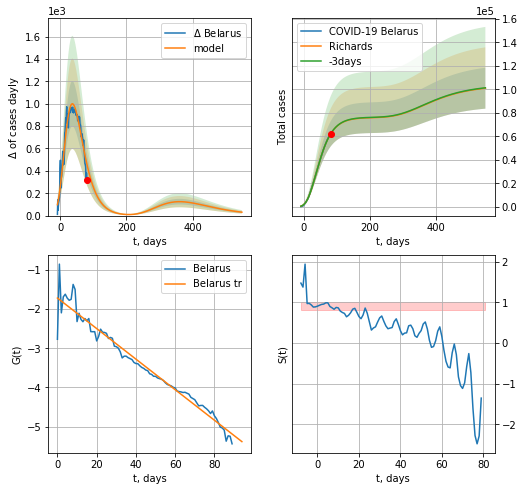

Belarus data at: 2020-06-29
+3 day model MAPE: 0.001606
model: Richards
coeffs: [ 7.60600518e+04  2.48366439e+00 -8.00978663e+01  1.44885402e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.172362
forecast at the end of period: +467 days
	 deltaDaycases: 30
	 total cases: 101033 ± 17414
	 total death: 632 ± 326
trend coefficient of determination: 0.958246
 intercept: -1.716537
 slope: -0.039003


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


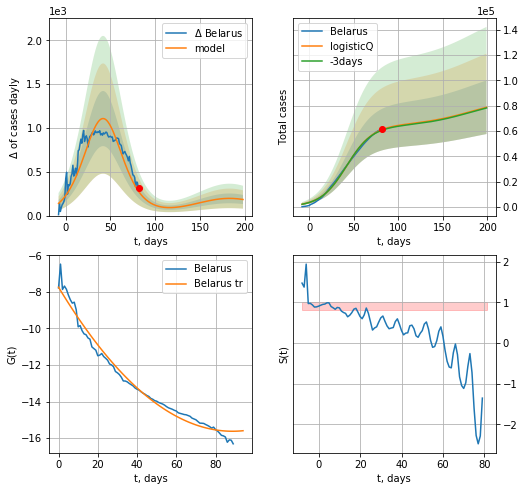

Belarus data at: 2020-06-29
+3 day model MAPE: 0.008108
model: logisticQ
coeffs: [ 6.43607945e+04  5.52007330e-07  4.20983347e+01 -1.24051034e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.269083
forecast at the end of period: +117 days
	 deltaDaycases: 183
	 total cases: 78731 ± 21185
	 total death: 493 ± 397
trend coefficient of determination: 0.980913
 intercept_: -7.74932684613635
 coeffs_: [ 0.         -0.17767342  0.00100223]


In [237]:
x = forecastRR('Belarus',dfBR[32:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


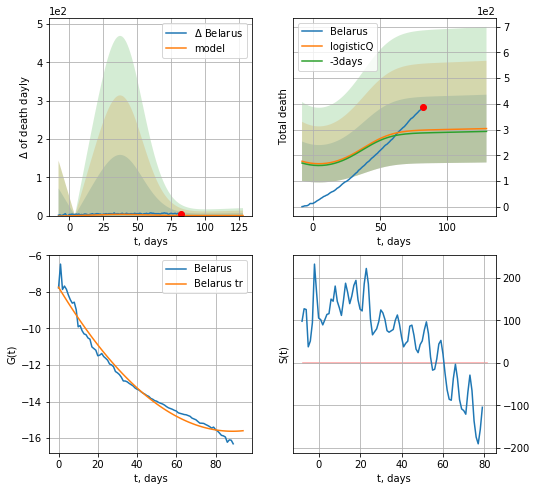

Belarus data at: 2020-06-29
+3 day model MAPE: 0.038184
model: logisticQ
coeffs: [ 2.52184825e+02  9.61210324e-04  1.07469633e+01 -1.63808456e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.432920
forecast at the end of period: +47 days
	 total death: 304 ± 131
trend coefficient of determination: 0.980913
 intercept_: -7.74932684613635
 coeffs_: [ 0.         -0.17767342  0.00100223]


In [238]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

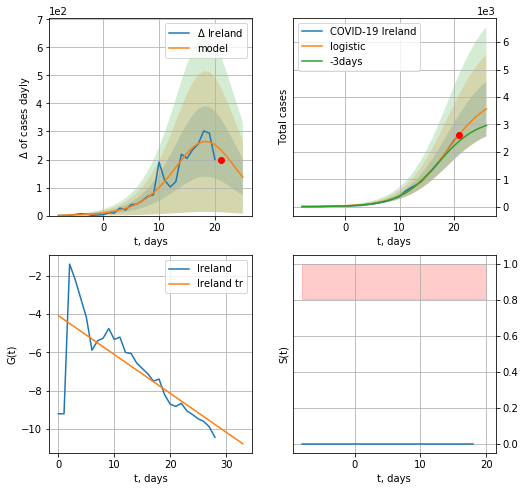

Ireland data at: 2020-06-29
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +5 days
	 deltaDaycases:  136
	 total cases:  3564 ± 997
	 total death:  242 ± 203
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


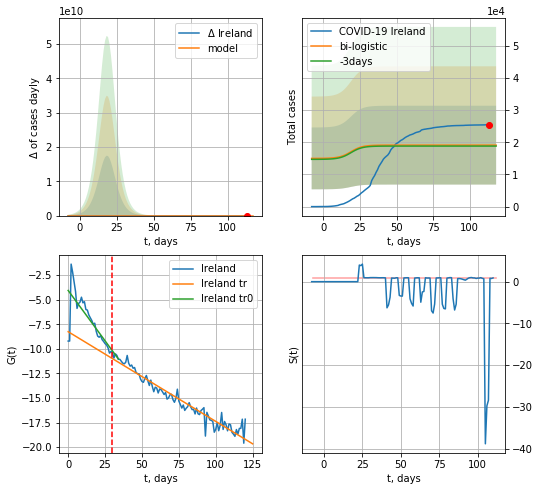

Ireland data at: 2020-06-29
+3 day model MAPE: 0.015618751170791213
model: bi-logistic
coeffs:  [ 1.19902644e+04 -1.01995539e+01  2.57369992e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6411180142162606
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  19115 ± 12255
	 total death:  1302 ± 2504
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.941710
 intercept: -8.258693
 slope: -0.091189


In [239]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,14*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


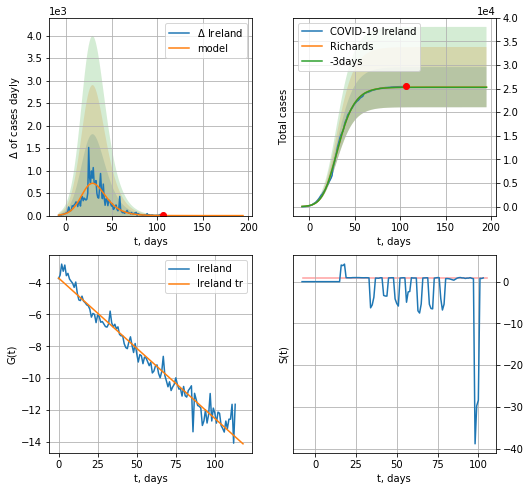

Ireland data at: 2020-06-29
+3 day model MAPE: 0.000748
model: Richards
coeffs: [2.52877873e+04 2.06287484e-01 2.14425919e+01 4.57644180e-01]
rational stdev: 0.168019
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 25287 ± 4248
	 total death: 1723 ± 868
trend coefficient of determination: 0.964909
 intercept: -3.712404
 slope: -0.088325


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


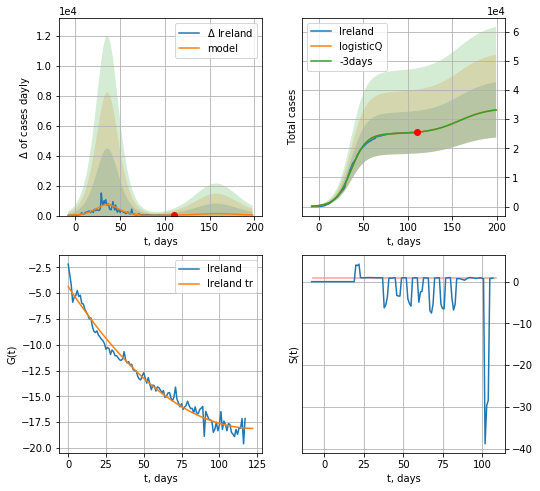

Ireland data at: 2020-06-29
+3 day model MAPE: 0.001206
model: logisticQ
coeffs: [ 2.50573605e+04  7.59023977e-07  3.61952489e+01 -1.54279554e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.285628
forecast at the end of period: +89 days
	 deltaDaycases: 39
	 total cases: 33213 ± 9486
	 total death: 2263 ± 1939
trend coefficient of determination: 0.978466
 intercept_: -4.379849673712837
 coeffs_: [ 0.         -0.22247661  0.00090141]


In [240]:
ivL = 7
vL = 90 + ivL
x = forecastRR('Ireland',dfIR[7:],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Ireland',dfIR[7:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active   death
114 2020-06-25  259064   34834  4903.0
115 2020-06-26  263360   34861  5068.0
116 2020-06-27  267766   34364  5347.0
117 2020-06-28  271982   34263  5509.0
118 2020-06-29  275999   34270  5575.0


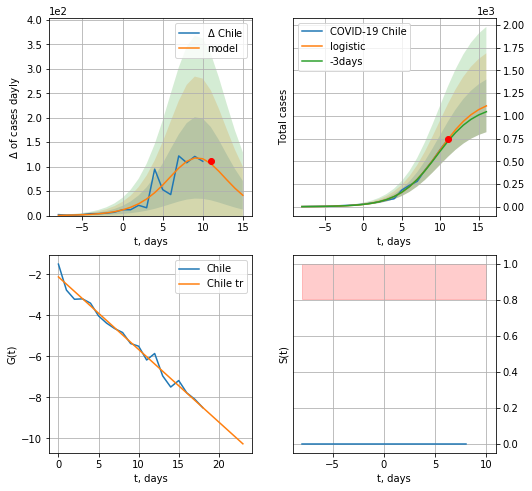

Chile data at: 2020-06-29
+3 day model MAPE: 0.03908987806693812
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +5 days
	 deltaDaycases:  41
	 total cases:  1110 ± 289
	 total death:  22 ± 17
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


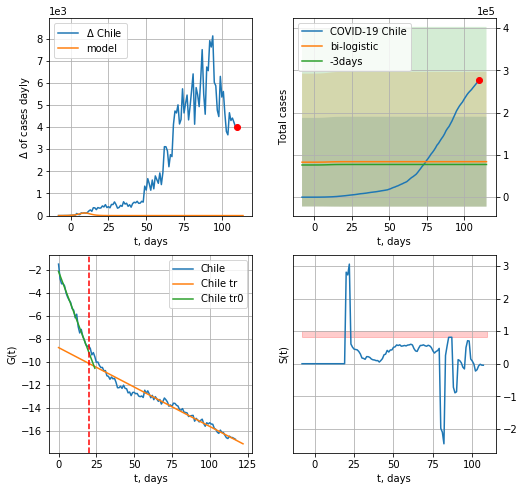

Chile data at: 2020-06-29
+3 day model MAPE: 0.08552830407602378
model: bi-logistic
coeffs:  [ 6.61714837e+04 -1.48244671e+01  3.66215449e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2657570480307032
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  83921 ± 106224
	 total death:  1695 ± 6436
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.956349
 intercept: -8.772308
 slope: -0.068684


In [241]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*14-dT)
xx = forecast2('Chile',dfCL[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


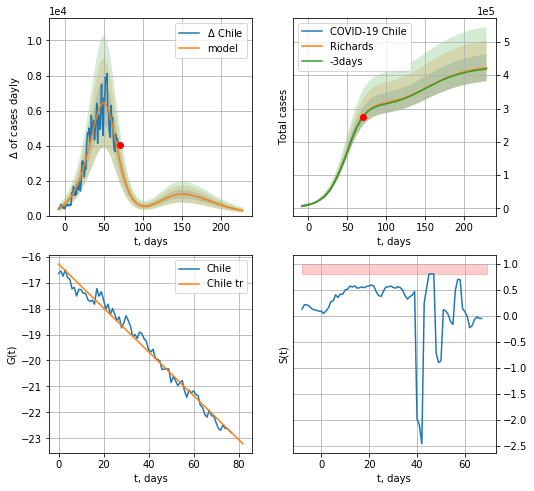

Chile data at: 2020-06-29
+3 day model MAPE: 0.003827
model: Richards
coeffs: [3.16889425e+05 6.28538861e-02 5.44473448e+01 1.48228958e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.096596
forecast at the end of period: +159 days
	 deltaDaycases: 285
	 total cases: 422411 ± 40803
	 total death: 8532 ± 2472
trend coefficient of determination: 0.984292
 intercept: -16.283744
 slope: -0.084529


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


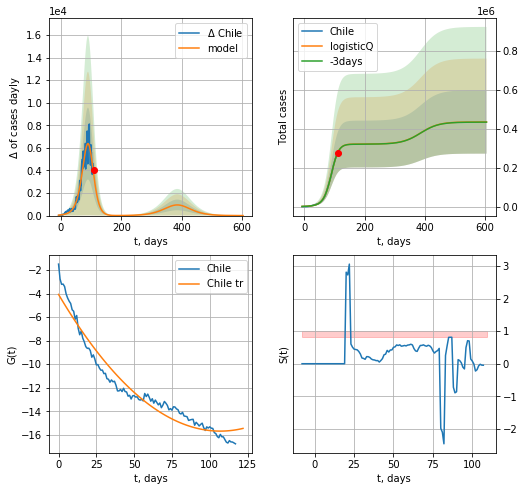

Chile data at: 2020-06-29
+3 day model MAPE: 0.000800
model: logisticQ
coeffs: [ 3.21279725e+05  1.91148943e-04  8.84838216e+01 -3.25662921e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374244
forecast at the end of period: +495 days
	 deltaDaycases: 2
	 total cases: 435006 ± 162798
	 total death: 8786 ± 9864
trend coefficient of determination: 0.948482
 intercept_: -4.078146299172129
 coeffs_: [ 0.         -0.21694576  0.0010142 ]


In [242]:
vL = 20+10
x = forecastRR('Chile',dfCL[40:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Chile',dfCL[10:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

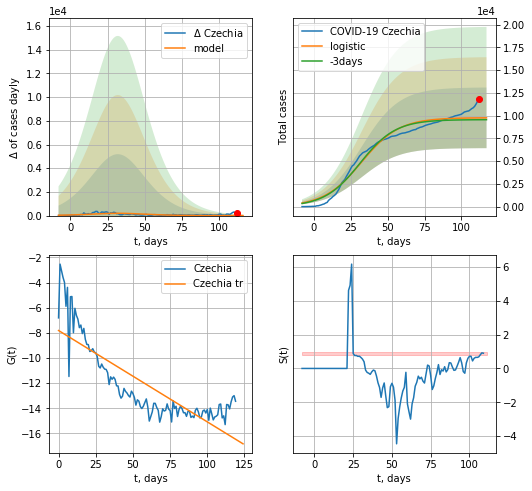

Czechia data at: 2020-06-29
+3 day model MAPE: 0.021302140916314487
model: logistic
coeffs:  [9.77620574e+03 7.82980096e-02 3.22958529e+01]
rational stdev:  0.34133469589654186
forecast at the end of period: +5 days
	 deltaDaycases:  1
	 total cases:  9763 ± 3332
	 total death:  287 ± 293
trend coefficient of determination: 0.677235
 intercept: -7.813675
 slope: -0.072724


In [243]:
x = forecast('Czechia',dfCH[:],d1,14*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


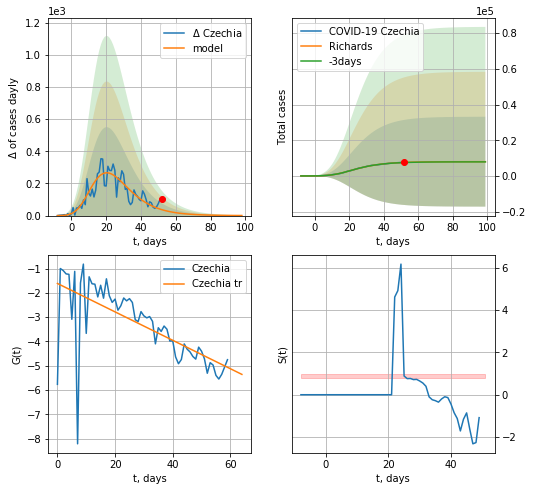

Czechia data at: 2020-06-29
+3 day model MAPE: 0.007833
model: Richards
coeffs: [ 7.98936728e+03  1.90702295e+00 -1.17113715e+01  4.87284384e-02]
rational stdev: 3.153560
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 7983 ± 25177
	 total death: 235 ± 2223
trend coefficient of determination: 0.449014
 intercept: -1.614154
 slope: -0.058414


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


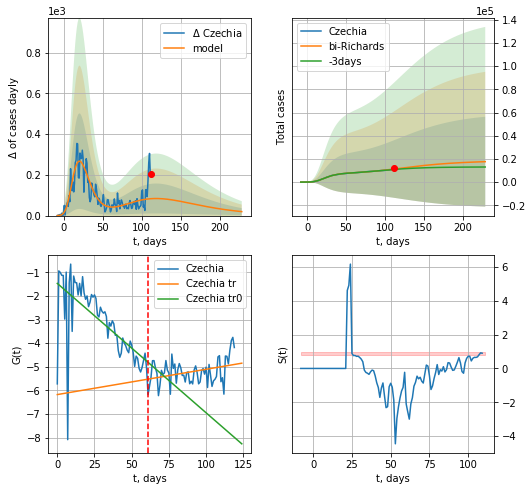

Czechia data at: 2020-06-29
+3 day model MAPE: 0.034770
model: bi-Richards
coeffs: [ 1.05722368e+04  1.76895190e+00 -8.41968850e+01  1.22431560e-02]
rational stdev: 2.198576
forecast at the end of period: +117 days
	 deltaDaycases: 19
	 total cases: 17627 ± 38756
	 total death: 519 ± 3423
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.422572
 intercept: -1.470296
 slope: -0.054730
trend coefficient of determination: 0.116237
 intercept: -6.173691
 slope: 0.010704


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


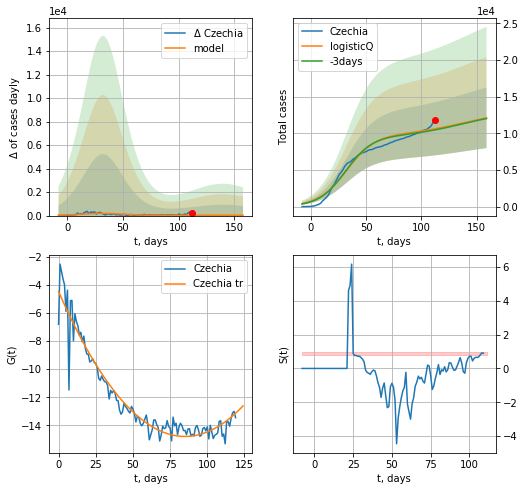

Czechia data at: 2020-06-29
+3 day model MAPE: 0.014663
model: logisticQ
coeffs: [ 9.77619732e+03  1.11520850e-07  3.22963600e+01 -7.01821986e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341367
forecast at the end of period: +47 days
	 deltaDaycases: 30
	 total cases: 12103 ± 4131
	 total death: 356 ± 364
trend coefficient of determination: 0.927308
 intercept_: -4.475832790254365
 coeffs_: [ 0.         -0.24244793  0.00142627]


In [244]:
vL= 61
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

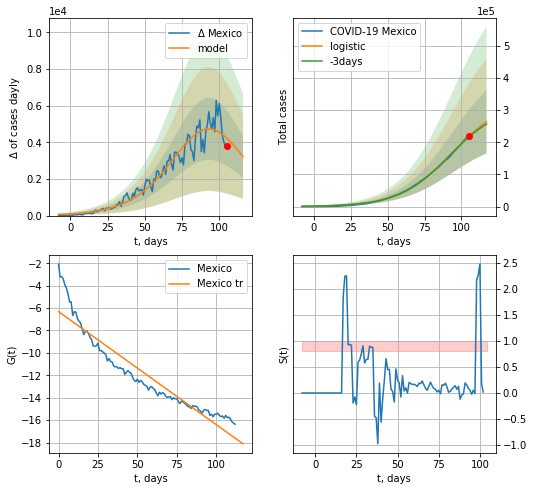

Mexico data at: 2020-06-29
+3 day model MAPE: 0.01555121302227698
model: logistic
coeffs:  [3.30378674e+05 5.69695761e-02 9.33702949e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37283712539240804
forecast at the end of period: +12 days
	 deltaDaycases:  3218
	 total cases:  263681 ± 98310
	 total death:  32409 ± 36249
trend coefficient of determination: 0.891893
 intercept: -6.316587
 slope: -0.100782


In [245]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


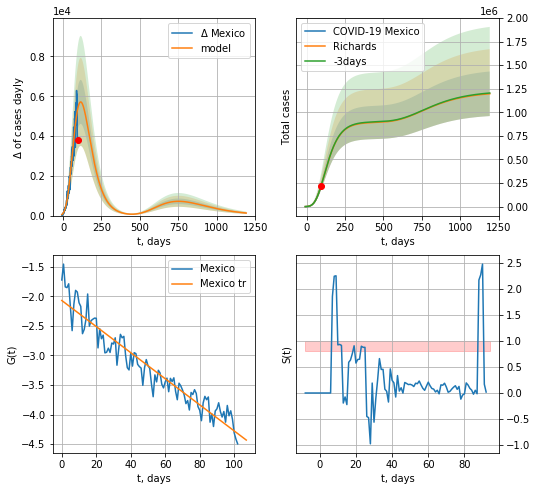

Mexico data at: 2020-06-29
+3 day model MAPE: 0.000310
model: Richards
coeffs: [ 8.94615366e+05  4.98662712e-01 -7.38419739e+01  3.54337527e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.197524
forecast at the end of period: +1097 days
	 deltaDaycases: 127
	 total cases: 1196929 ± 236422
	 total death: 147114 ± 87175
trend coefficient of determination: 0.912984
 intercept: -2.068599
 slope: -0.022092


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


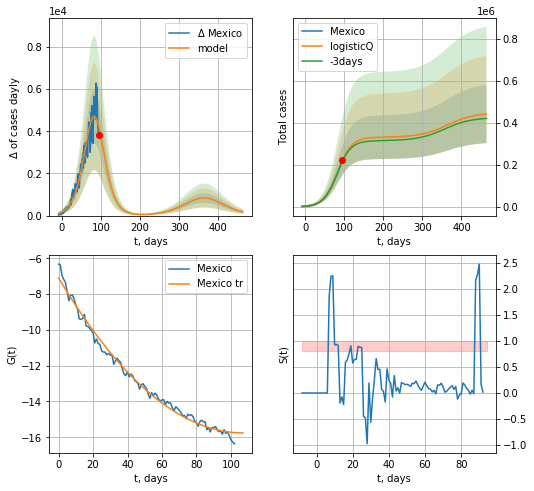

Mexico data at: 2020-06-29
+3 day model MAPE: 0.015633
model: logisticQ
coeffs: [ 3.30823760e+05  1.29723403e-06  8.34226672e+01 -4.37987691e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313892
forecast at the end of period: +369 days
	 deltaDaycases: 172
	 total cases: 441713 ± 138650
	 total death: 54291 ± 51124
trend coefficient of determination: 0.989700
 intercept_: -7.092946234719051
 coeffs_: [ 0.         -0.16171803  0.00075469]


In [246]:
x = forecastRR('Mexico',dfMX[10:],d1,170*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
108 2020-06-25  1808.0     234   78.0  410867.0
109 2020-06-26  1813.0     222   78.0  414792.0
110 2020-06-27  1815.0     224   78.0  416739.0
111 2020-06-28  1816.0     216   78.0  418368.0
112 2020-06-29  1816.0     226   78.0       NaN
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


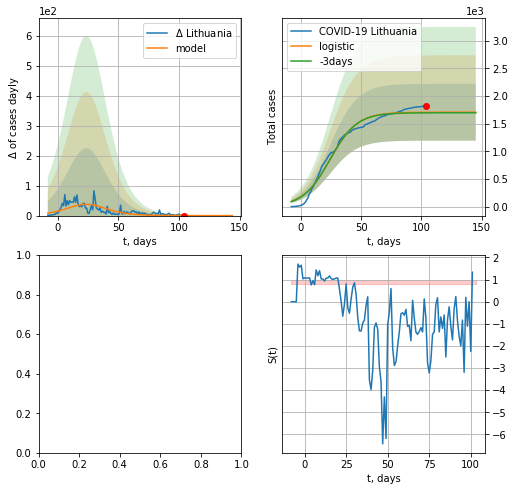

In [247]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [353]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [354]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


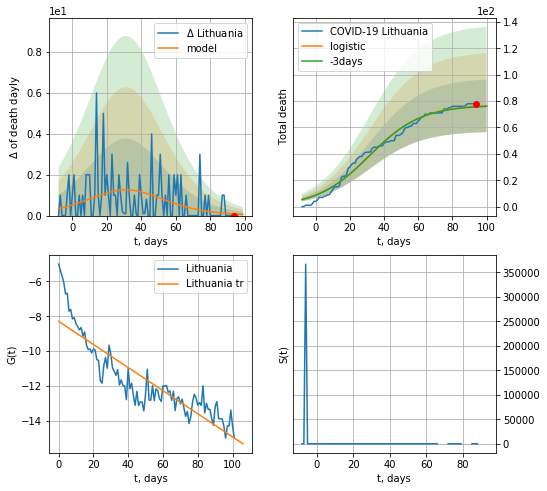

Lithuania data at: 2020-06-28
+3 day model MAPE: 0.005362008652816292
model: logistic
coeffs:  [7.72911401e+01 6.51820974e-02 3.15645941e+01]
rational stdev:  0.26092472706455583
forecast at the end of period: +6 days
	 total death:  76 ± 19
trend coefficient of determination: 0.779916
 intercept: -8.291452
 slope: -0.066405


In [374]:
x = forecast('Lithuania',dfLT[9:],d1,7*14-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


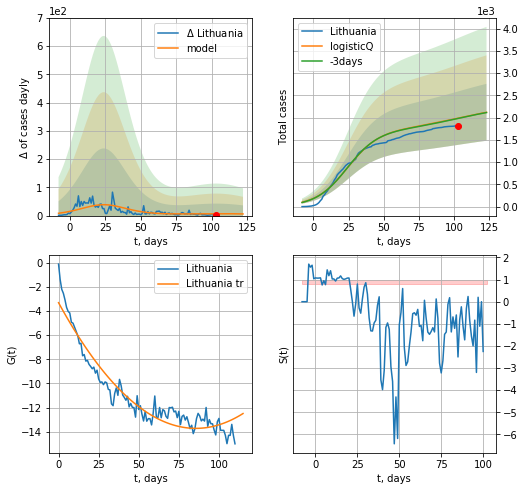

Lithuania data at: 2020-06-28
+3 day model MAPE: 0.002746
model: logisticQ
coeffs: [ 1.70347911e+03  1.74920179e-07  2.41374762e+01 -5.08801846e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301828
forecast at the end of period: +20 days
	 deltaDaycases: 5
	 total cases: 2119 ± 639
	 total death: 91 ± 82
trend coefficient of determination: 0.914656
 intercept_: -3.305904190179902
 coeffs_: [ 0.         -0.24351732  0.00142254]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


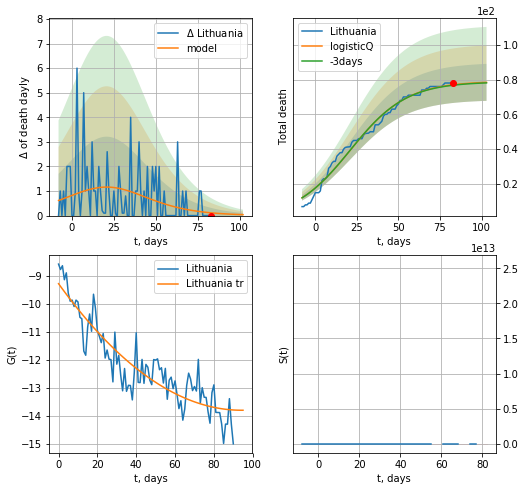

Lithuania data at: 2020-06-28
+3 day model MAPE: 0.003272
model: logisticQ
coeffs: [ 7.90159671e+01  3.85549317e-07  2.11040299e+01 -1.52328036e+05]
rational stdev: 0.135488
forecast at the end of period: +20 days
	 total death: 78 ± 10
trend coefficient of determination: 0.822092
 intercept_: -9.289558114123068
 coeffs_: [ 0.         -0.09586165  0.00050823]


In [375]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


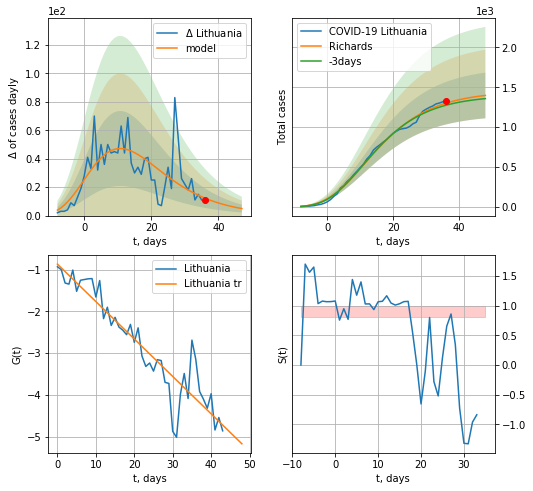

Lithuania data at: 2020-06-28
+3 day model MAPE: 0.021066
model: Richards
coeffs: [ 1.45212959e+03  9.67658542e+00 -4.16678055e+01  9.16998413e-03]
rational stdev: 0.205046
forecast at the end of period: +12 days
	 deltaDaycases: 4
	 total cases: 1397 ± 286
	 total death: 60 ± 36
trend coefficient of determination: 0.866665
 intercept: -0.867769
 slope: -0.089640


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


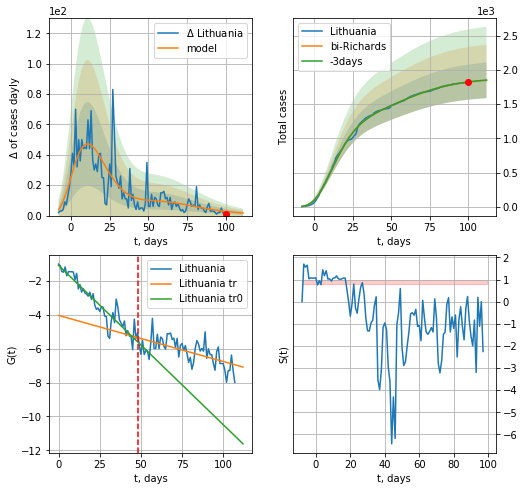

Lithuania data at: 2020-06-28
+3 day model MAPE: 0.001496
model: bi-Richards
coeffs: [4.28637954e+02 7.79043217e-01 8.73650382e+00 6.51369372e-02]
rational stdev: 0.140915
forecast at the end of period: +12 days
	 deltaDaycases: 1
	 total cases: 1847 ± 260
	 total death: 79 ± 33
bi-Richards approximation splitting point: 48
trend coefficient of determination: 0.882600
 intercept: -1.092180
 slope: -0.093938
trend coefficient of determination: 0.394123
 intercept: -4.044597
 slope: -0.027170


In [376]:
vL = 48+3
x = forecastRR('Lithuania',dfLT[3:vL-3],d1,15*7-1-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[3:],d1,15*7-1-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-3)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


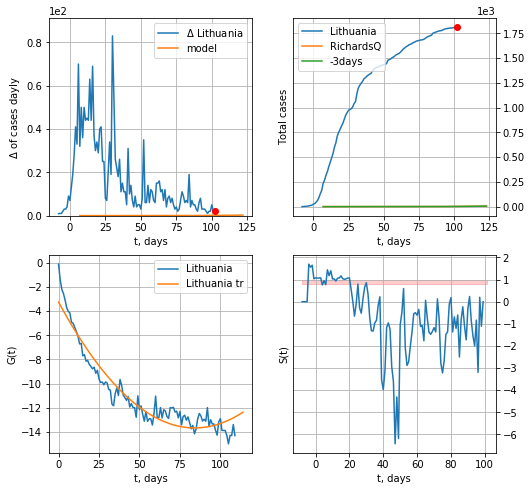

Lithuania data at: 2020-06-27
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 4.54139979e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +21 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [358]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
110 2020-06-25  4151.0      73  110.0
111 2020-06-26  4173.0      95  110.0
112 2020-06-27  4217.0     129  110.0
113 2020-06-28  4242.0     154  110.0
114 2020-06-29  4256.0     149  110.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


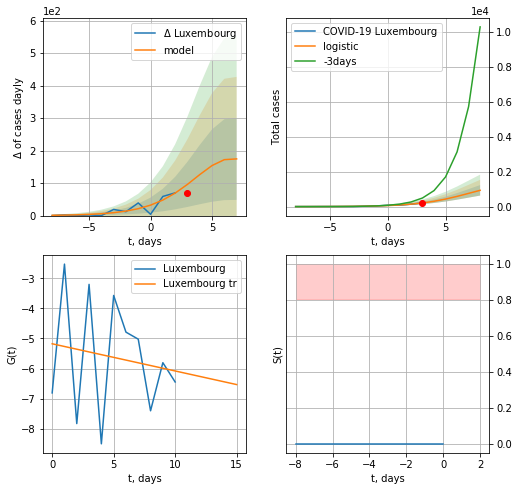

Luxembourg data at: 2020-06-29
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +5 days
	 deltaDaycases:  174
	 total cases:  932 ± 299
	 total death:  24 ± 23
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


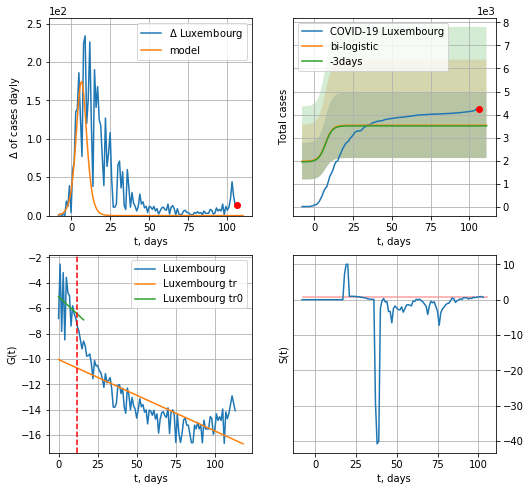

Luxembourg data at: 2020-06-29
+3 day model MAPE: 0.007925465589063607
model: bi-logistic
coeffs:  [1752.9220301    -6.70274461  246.95492143] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.4027375828332107
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  3535 ± 1423
	 total death:  91 ± 109
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.621461
 intercept: -10.044948
 slope: -0.056256


In [248]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,14*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,14*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


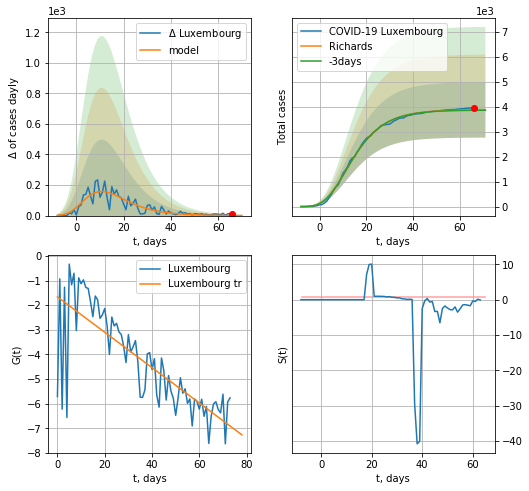

Luxembourg data at: 2020-06-29
+3 day model MAPE: 0.003345
model: Richards
coeffs: [ 3.88162927e+03  1.99569941e+01 -3.56216724e+01  5.55736951e-03]
rational stdev: 0.285969
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 3876 ± 1108
	 total death: 100 ± 85
trend coefficient of determination: 0.626779
 intercept: -1.663811
 slope: -0.071855


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


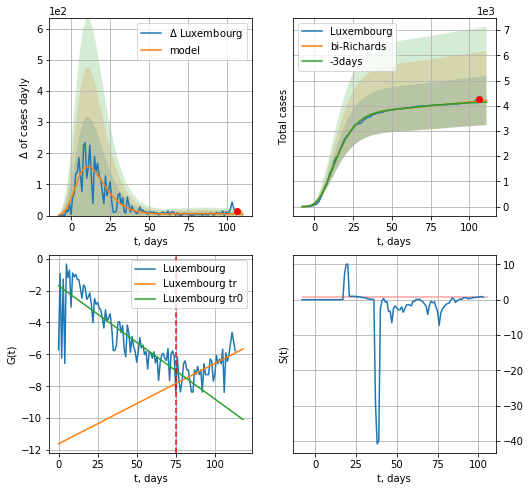

Luxembourg data at: 2020-06-29
+3 day model MAPE: 0.012721
model: bi-Richards
coeffs: [ 4.99599696e+02  4.61923248e+00 -5.71742205e+01  7.38965695e-03]
rational stdev: 0.231441
forecast at the end of period: +5 days
	 deltaDaycases: 4
	 total cases: 4205 ± 973
	 total death: 108 ± 74
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.629952
 intercept: -1.694318
 slope: -0.071085
trend coefficient of determination: 0.366641
 intercept: -11.611689
 slope: 0.050422


In [249]:
vL = 75
x = forecastRR("Luxembourg",dfLX[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


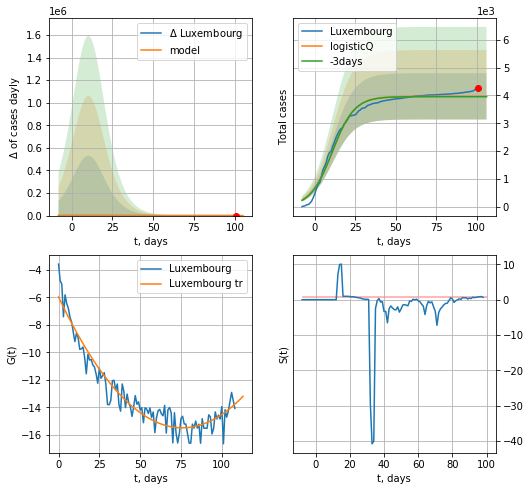

Luxembourg data at: 2020-06-29
+3 day model MAPE: 0.003514
model: logisticQ
coeffs: [ 3.96841812e+03  4.09947912e-07  1.07846642e+01 -3.56969191e+05]
rational stdev: 0.209512
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 3968 ± 831
	 total death: 102 ± 64
trend coefficient of determination: 0.921129
 intercept_: -5.96136615515005
 coeffs_: [ 0.         -0.2512378   0.00165715]


In [250]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,14*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
117 2020-06-25  53156.0  22716.0  4343.0
118 2020-06-26  53856.0  22957.0  4406.0
119 2020-06-27  54574.0  23230.0  4424.0
120 2020-06-28  55255.0  23768.0  4429.0
121 2020-06-29  55665.0  23733.0  4502.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


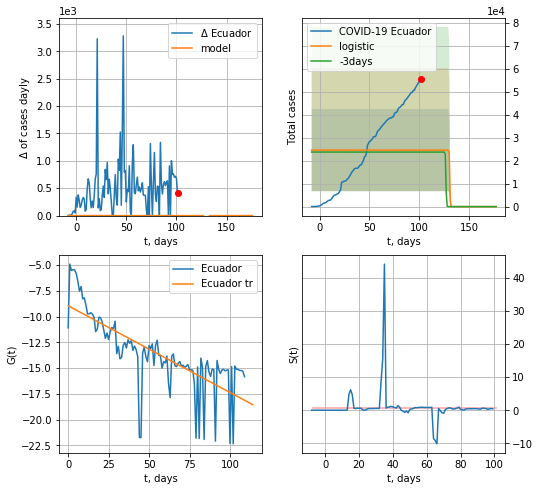

Ecuador data at: 2020-06-29
+3 day model MAPE: 0.03577100440777299
model: logistic
coeffs:  [ 2.45910456e+04 -4.49509194e+00  1.30524161e+02]
rational stdev:  0.7268920341185211
forecast at the end of period: +75 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.561537
 intercept: -8.948896
 slope: -0.084192


In [251]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


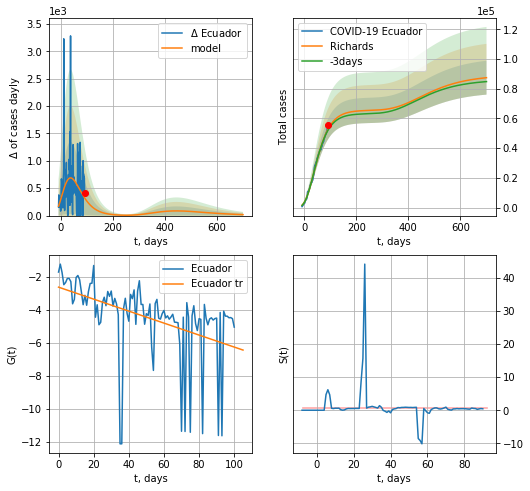

Ecuador data at: 2020-06-29
+3 day model MAPE: 0.014546
model: Richards
coeffs: [ 6.55218497e+04  2.48058795e+00 -1.16562932e+02  1.15881575e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.130395
forecast at the end of period: +607 days
	 deltaDaycases: 17
	 total cases: 87418 ± 11398
	 total death: 7070 ± 2765
trend coefficient of determination: 0.201548
 intercept: -2.606736
 slope: -0.036448


In [252]:
x = forecastRR("Ecuador",dfED[20:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


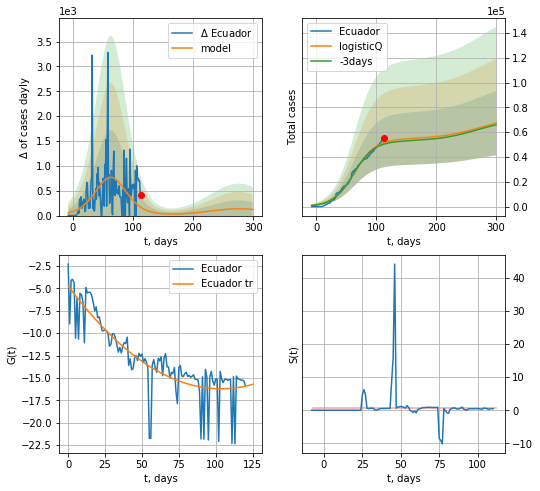

Ecuador data at: 2020-06-29
+3 day model MAPE: 0.023458
model: logisticQ
coeffs: [ 5.44913482e+04  2.35080940e-07  6.33704316e+01 -2.40369835e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.384195
forecast at the end of period: +187 days
	 deltaDaycases: 123
	 total cases: 67285 ± 25850
	 total death: 5441 ± 6271
trend coefficient of determination: 0.722870
 intercept_: -4.731608726797472
 coeffs_: [ 0.         -0.22171216  0.0010703 ]


In [253]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
121 2020-06-25  7172.0     245  327.0
122 2020-06-26  7191.0     263  328.0
123 2020-06-27  7198.0     270  328.0
124 2020-06-28  7209.0     281  328.0
125 2020-06-29  7209.0     281  328.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


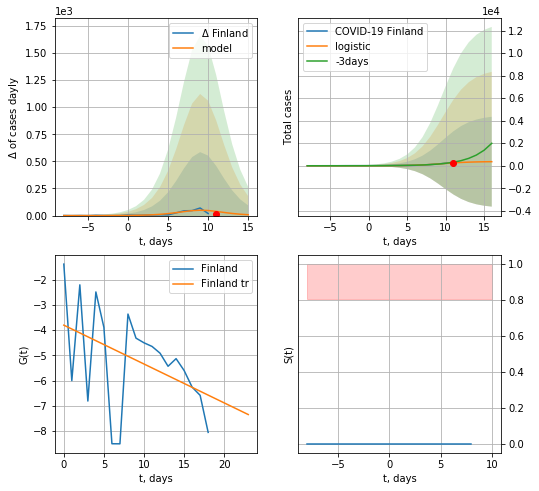

Finland data at: 2020-06-29
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +5 days
	 deltaDaycases:  7
	 total cases:  361 ± 3986
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

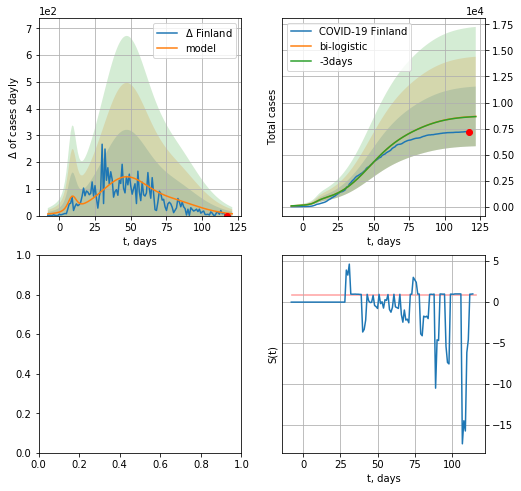

In [254]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*14-dT)
xx = forecast2("Finland",dfFI[:],d1,14*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

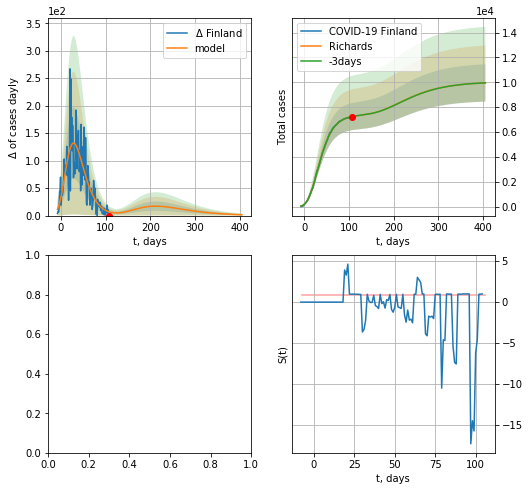

In [255]:
x = forecastRR("Finland",dfFI[10:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


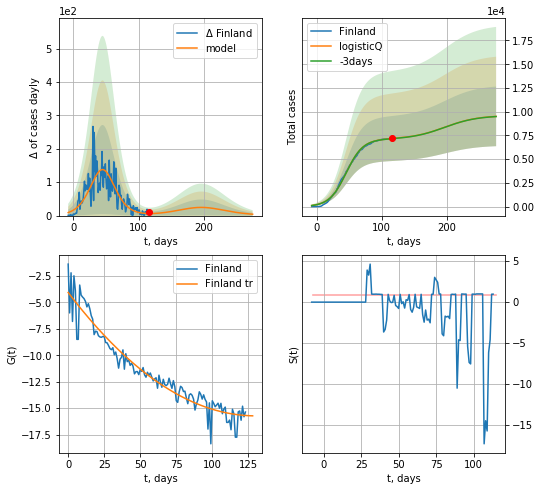

Finland data at: 2020-06-28
+3 day model MAPE: 0.002144
model: logisticQ
coeffs: [ 7.10046983e+03  3.71381808e-07  4.51111809e+01 -2.08661206e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.330479
forecast at the end of period: +160 days
	 deltaDaycases: 4
	 total cases: 9506 ± 3141
	 total death: 433 ± 429
trend coefficient of determination: 0.922522
 intercept_: -4.069502045725784
 coeffs_: [ 0.         -0.17925025  0.00068875]


In [50]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
107 2020-06-25   4408  1827.0  211.0
108 2020-06-26   4513  1841.0  215.0
109 2020-06-27   4625  1934.0  216.0
110 2020-06-28   4691  1964.0  219.0
111 2020-06-29   4831  2026.0  223.0


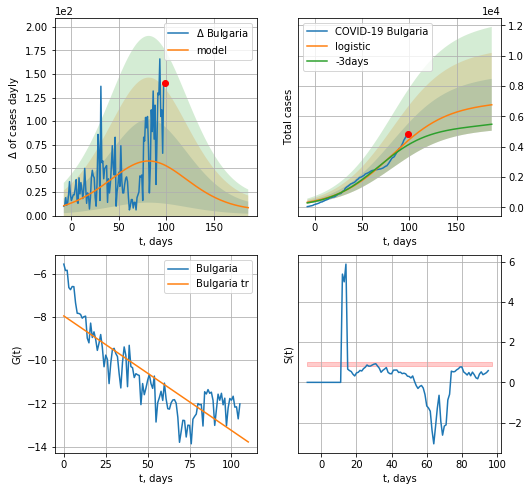

Bulgaria data at: 2020-06-29
+3 day model MAPE: 0.07164093333046895
model: logistic
coeffs:  [6.89220355e+03 3.35456414e-02 8.16865947e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.25334904722320273
forecast at the end of period: +89 days
	 deltaDaycases:  8
	 total cases:  6756 ± 1711
	 total death:  311 ± 236
trend coefficient of determination: 0.727899
 intercept: -7.958739
 slope: -0.052970


In [256]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


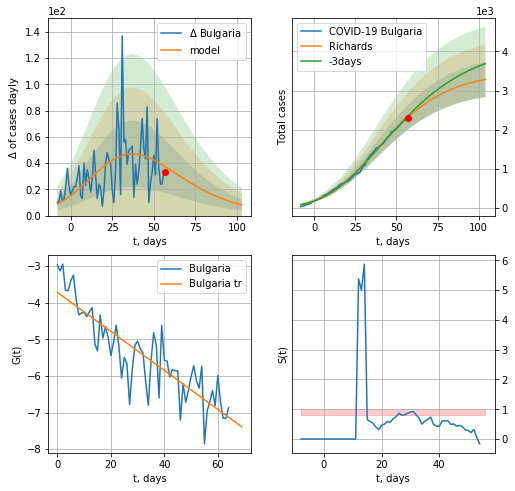

Bulgaria data at: 2020-06-29
+3 day model MAPE: 0.017234
model: Richards
coeffs: [3.47700933e+03 1.26494372e-01 1.24703961e+01 3.39631762e-01]
rational stdev: 0.135837
forecast at the end of period: +47 days
	 deltaDaycases: 8
	 total cases: 3283 ± 446
	 total death: 151 ± 61
trend coefficient of determination: 0.758376
 intercept: -3.716230
 slope: -0.053312


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


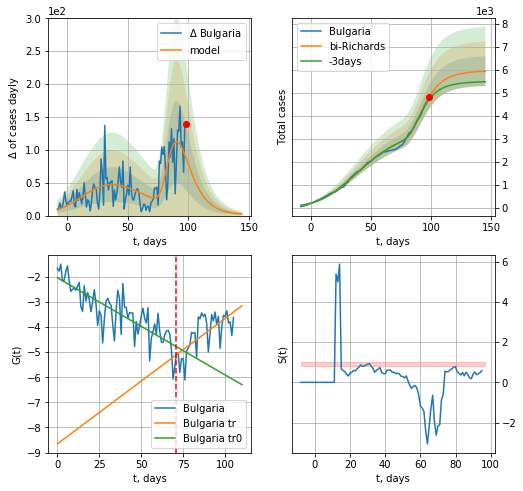

Bulgaria data at: 2020-06-29
+3 day model MAPE: 0.024909
model: bi-Richards
coeffs: [2.51155444e+03 1.21537220e+01 4.73806993e+01 8.88191409e-03]
rational stdev: 0.108361
forecast at the end of period: +47 days
	 deltaDaycases: 2
	 total cases: 5946 ± 644
	 total death: 274 ± 89
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.672638
 intercept: -2.032768
 slope: -0.038733
trend coefficient of determination: 0.459197
 intercept: -8.651876
 slope: 0.050015


In [257]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,20*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,20*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


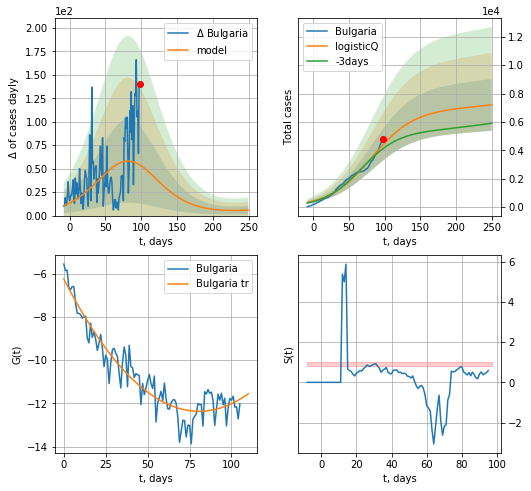

Bulgaria data at: 2020-06-29
+3 day model MAPE: 0.068924
model: logisticQ
coeffs: [ 6.88410900e+03  2.83950572e-07  8.16150925e+01 -1.18152521e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.253382
forecast at the end of period: +152 days
	 deltaDaycases: 5
	 total cases: 7210 ± 1827
	 total death: 332 ± 252
trend coefficient of determination: 0.899950
 intercept_: -6.246387474522857
 coeffs_: [ 0.         -0.15176267  0.0009409 ]


In [258]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
119 2020-06-25  3162.0    64.0   58.0
120 2020-06-26  3162.1    51.0   58.0
121 2020-06-27  3162.2    51.0   58.0
122 2020-06-28  3169.0    58.0   58.0
123 2020-06-29  3171.0    57.0   58.0


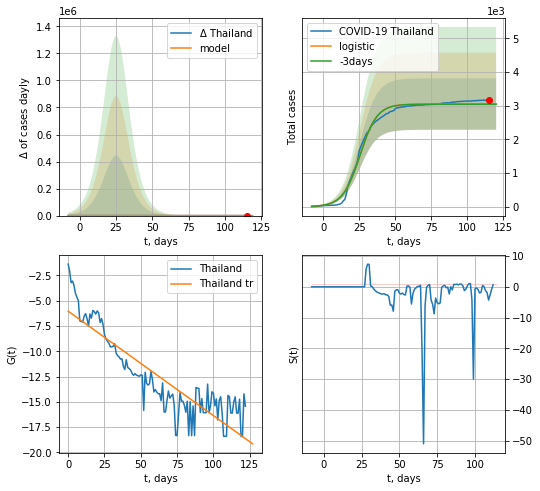

Thailand data at: 2020-06-29
+3 day model MAPE: 0.0019030077301773747
model: logistic
coeffs:  [3.04808451e+03 1.67460505e-01 2.54944546e+01]
rational stdev:  0.2504724222621546
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  3048 ± 763
	 total death:  55 ± 41
trend coefficient of determination: 0.788071
 intercept: -6.038209
 slope: -0.103221


In [259]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [260]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


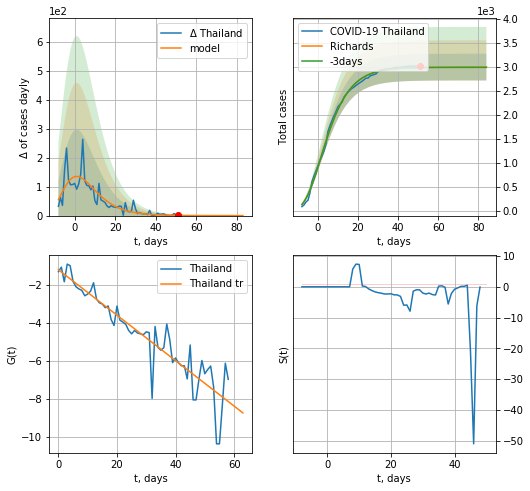

Thailand data at: 2020-06-29
+3 day model MAPE: 0.001961
model: Richards
coeffs: [ 2.99626186e+03  1.57389308e+01 -3.79335147e+01  7.82164356e-03]
rational stdev: 0.093313
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 54 ± 15
trend coefficient of determination: 0.845848
 intercept: -1.208266
 slope: -0.119672


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


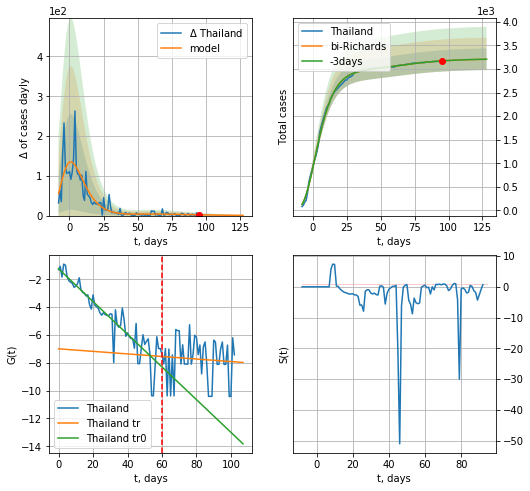

Thailand data at: 2020-06-29
+3 day model MAPE: 0.000175
model: bi-Richards
coeffs: [ 2.20448506e+02  6.60280370e+00 -4.22043812e+01  7.06403709e-03]
rational stdev: 0.071292
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 3205 ± 228
	 total death: 58 ± 12
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843264
 intercept: -1.244056
 slope: -0.117537
trend coefficient of determination: 0.005634
 intercept: -6.993625
 slope: -0.009164


In [261]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


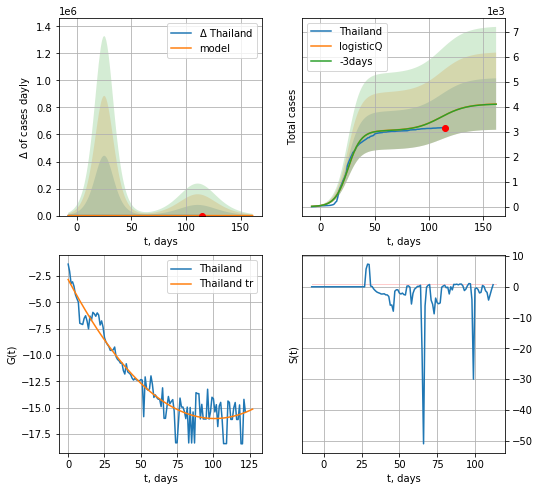

Thailand data at: 2020-06-29
+3 day model MAPE: 0.000718
model: logisticQ
coeffs: [ 3.04808660e+03  5.97714386e-07  2.54949716e+01 -2.80050176e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.250647
forecast at the end of period: +47 days
	 deltaDaycases: 1
	 total cases: 4112 ± 1030
	 total death: 75 ± 56
trend coefficient of determination: 0.913598
 intercept_: -2.846947557103965
 coeffs_: [ 0.         -0.26146856  0.00129713]


In [262]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

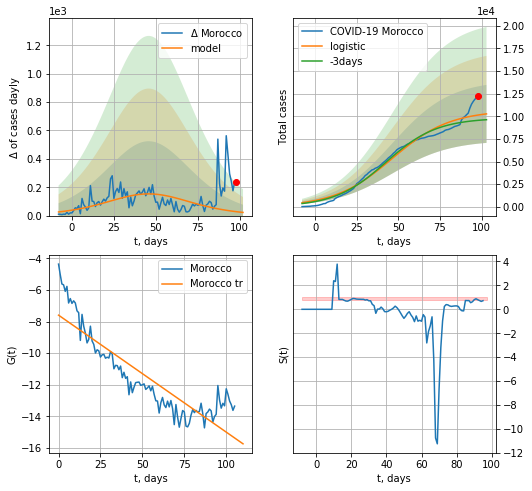

Morocco data at: 2020-06-29
+3 day model MAPE: 0.06272322572320037
model: logistic
coeffs:  [1.06565803e+04 5.74269769e-02 4.62356684e+01]
rational stdev:  0.31216230911026344
forecast at the end of period: +5 days
	 deltaDaycases:  22
	 total cases:  10262 ± 3203
	 total death:  187 ± 175
trend coefficient of determination: 0.784329
 intercept: -7.595652
 slope: -0.074114


In [263]:
x = forecast("Morocco",dfMR[5:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


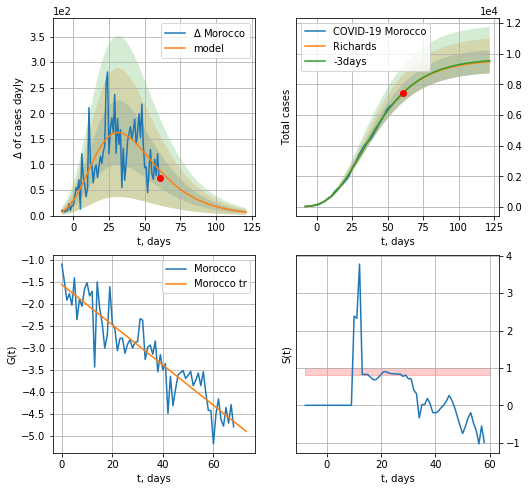

Morocco data at: 2020-06-29
+3 day model MAPE: 0.002855
model: Richards
coeffs: [ 9.62196675e+03  2.25668236e+00 -5.19496574e+01  2.05516980e-02]
rational stdev: 0.079909
forecast at the end of period: +61 days
	 deltaDaycases: 6
	 total cases: 9476 ± 757
	 total death: 173 ± 41
trend coefficient of determination: 0.846109
 intercept: -1.563197
 slope: -0.045646


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


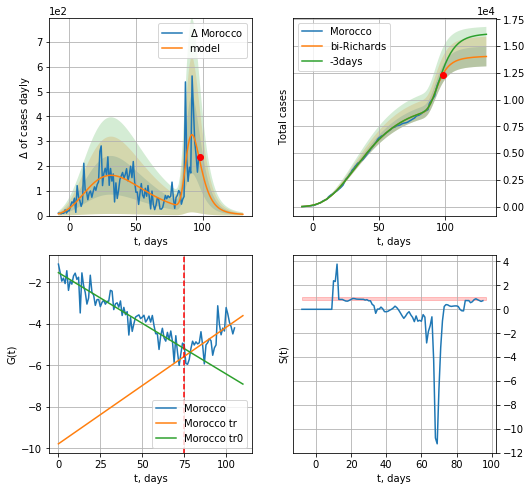

Morocco data at: 2020-06-29
+3 day model MAPE: 0.036124
model: bi-Richards
coeffs: [4.50251085e+03 6.94429955e+00 7.28324266e+01 2.65959347e-02]
rational stdev: 0.065633
forecast at the end of period: +33 days
	 deltaDaycases: 5
	 total cases: 14024 ± 920
	 total death: 256 ± 50
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.866486
 intercept: -1.529309
 slope: -0.048816
trend coefficient of determination: 0.500265
 intercept: -9.777598
 slope: 0.056144


In [264]:
vL = 75 + 5
x = forecastRR("Morocco",dfMR[5:vL-5],d1,22*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


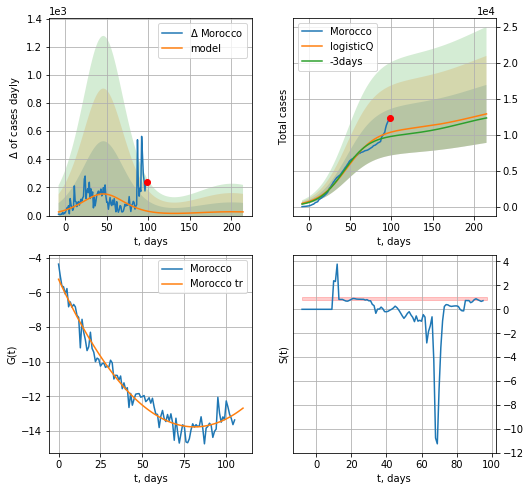

Morocco data at: 2020-06-29
+3 day model MAPE: 0.060227
model: logisticQ
coeffs: [ 1.06559232e+04  1.96639668e-07  4.62343970e+01 -2.92009949e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312187
forecast at the end of period: +117 days
	 deltaDaycases: 26
	 total cases: 12905 ± 4028
	 total death: 236 ± 221
trend coefficient of determination: 0.963996
 intercept_: -5.237052521763319
 coeffs_: [ 0.         -0.21019149  0.001296  ]


In [265]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

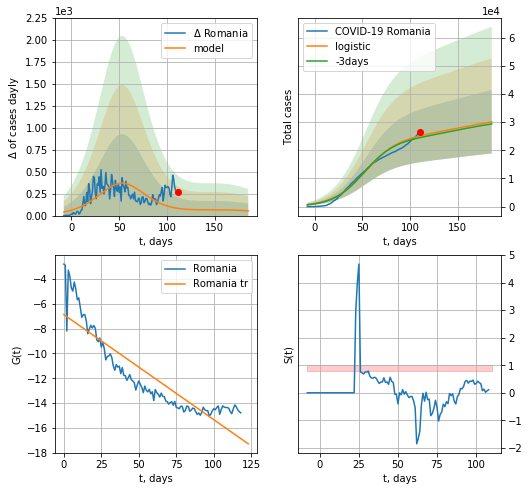

Romania data at: 2020-06-29
+3 day model MAPE: 0.0255050573126568
model: logistic
coeffs:  [2.42901258e+04 5.89035166e-02 5.30677145e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3731788530832644
forecast at the end of period: +75 days
	 deltaDaycases:  54
	 total cases:  30126 ± 11242
	 total death:  1851 ± 2072
trend coefficient of determination: 0.802001
 intercept: -6.869007
 slope: -0.084635


In [266]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


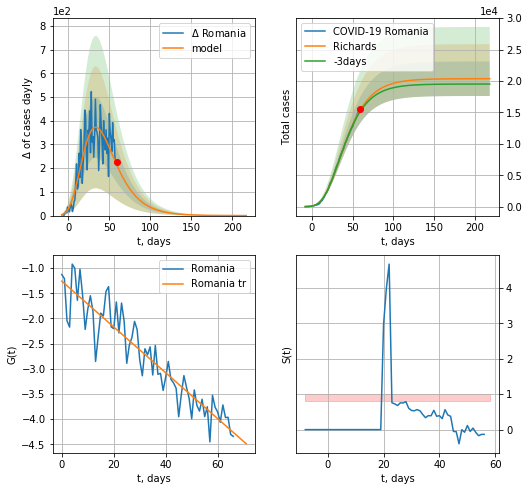

Romania data at: 2020-06-29
+3 day model MAPE: 0.015460
model: Richards
coeffs: [ 2.03688125e+04  4.42658382e+00 -5.58246363e+01  1.12883267e-02]
rational stdev: 0.134958
forecast at the end of period: +159 days
	 deltaDaycases: 0
	 total cases: 20366 ± 2748
	 total death: 1251 ± 506
trend coefficient of determination: 0.863843
 intercept: -1.259263
 slope: -0.045519


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


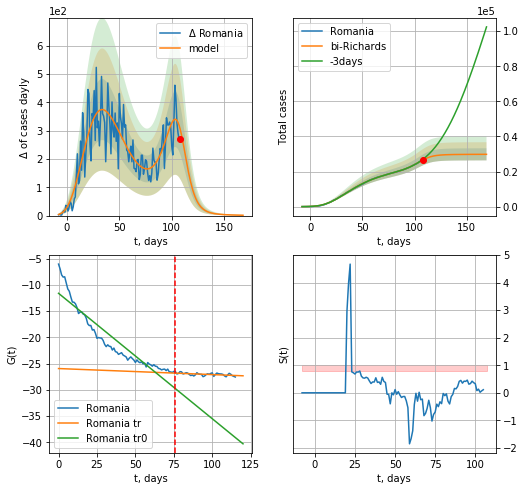

Romania data at: 2020-06-29
+3 day model MAPE: 0.019430
model: bi-Richards
coeffs: [9.46859534e+03 7.98809758e-02 1.08767995e+02 2.25376445e+00]
rational stdev: 0.115737
forecast at the end of period: +61 days
	 deltaDaycases: 1
	 total cases: 29813 ± 3450
	 total death: 1832 ± 636
bi-Richards approximation splitting point: 76
trend coefficient of determination: 0.875681
 intercept: -11.615241
 slope: -0.238877
trend coefficient of determination: 0.252008
 intercept: -25.945623
 slope: -0.011492


In [267]:
vL = 76+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


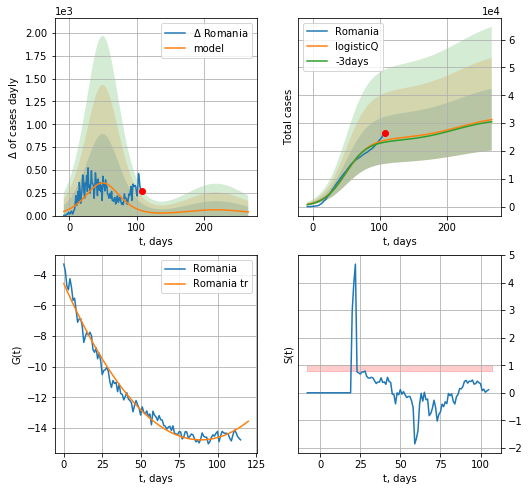

Romania data at: 2020-06-29
+3 day model MAPE: 0.029215
model: logisticQ
coeffs: [ 2.43247016e+04  1.73435685e-07  5.01317641e+01 -3.37915214e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354893
forecast at the end of period: +159 days
	 deltaDaycases: 39
	 total cases: 31276 ± 11099
	 total death: 1922 ± 2046
trend coefficient of determination: 0.981468
 intercept_: -4.564165171154948
 coeffs_: [ 0.         -0.2290212   0.00128365]


In [268]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [269]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
138 2020-06-25  1264820  158450  132592.0
139 2020-06-26  1270791  159973  132779.0
140 2020-06-27  1273620  159002  132822.0
141 2020-06-28  1275943  159198  132888.0
142 2020-06-29  1282170  159958  133018.0


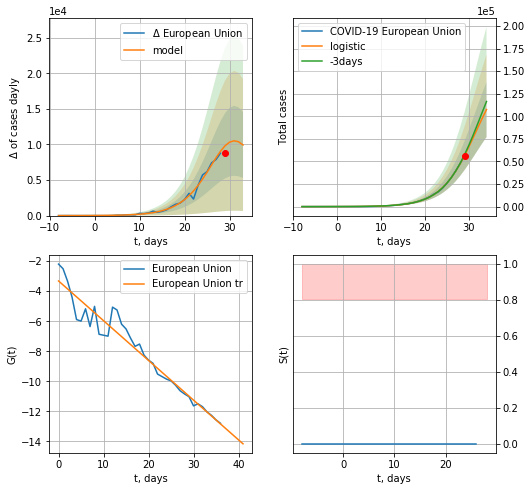

European Union data at: 2020-06-29
+3 day model MAPE: 0.026537291805373914
model: logistic
coeffs:  [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142507641165
forecast at the end of period: +5 days
	 deltaDaycases:  9926
	 total cases:  107480 ± 30503
	 total death:  11150 ± 9493
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


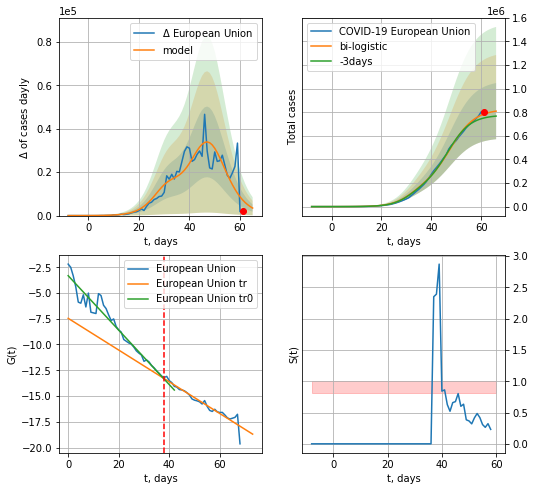

European Union data at: 2020-06-29
+3 day model MAPE: 0.046518861456193536
model: bi-logistic
coeffs:  [6.59401208e+05 2.01830792e-01 4.76685424e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888577461115
forecast at the end of period: +5 days
	 deltaDaycases:  3461
	 total cases:  809281 ± 238000
	 total death:  83958 ± 74073
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


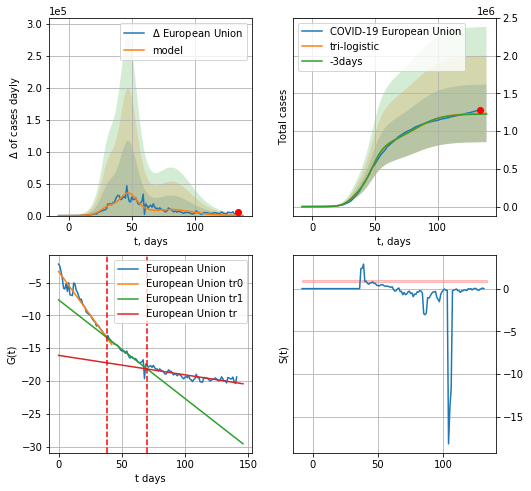

European Union data at: 2020-06-29
+3 day model MAPE: 0.007698617341959499
model: tri-logistic
coeffs:  [4.12530400e+05 9.06603043e-02 8.23265951e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01 6.59401208e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.3089773346153349
forecast at the end of period: +5 days
	 deltaDaycases:  226
	 total cases:  1235343 ± 381693
	 total death:  128159 ± 118794
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.726016
 intercept: -16.099833
 slope: -0.029636


In [270]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,14*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,14*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,14*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


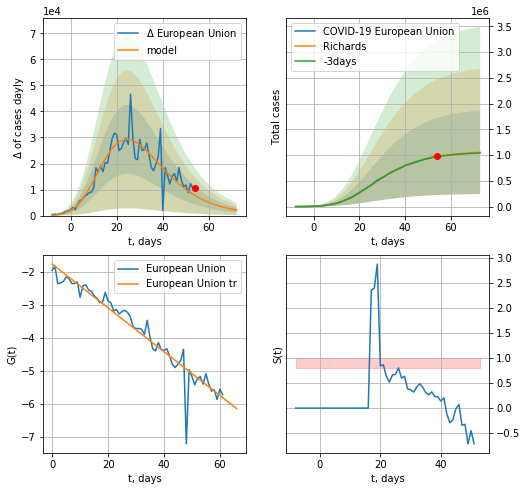

European Union data at: 2020-06-29
+3 day model MAPE: 0.007559
model: Richards
coeffs: [ 1.08235898e+06  8.91256786e-01 -6.99260106e+00  8.61059421e-02]
rational stdev: 0.768581
forecast at the end of period: +19 days
	 deltaDaycases: 2102
	 total cases: 1055605 ± 811318
	 total death: 109513 ± 252508
trend coefficient of determination: 0.920526
 intercept: -1.769267
 slope: -0.066303


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


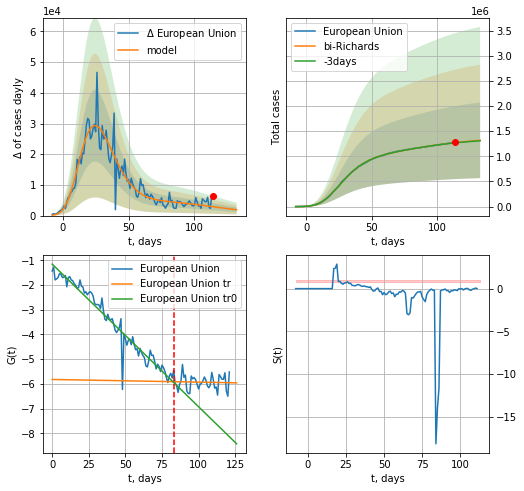

European Union data at: 2020-06-29
+3 day model MAPE: 0.003933
model: bi-Richards
coeffs: [ 3.02158973e+05  2.40022037e+00 -4.12690401e+01  1.36482473e-02]
rational stdev: 0.570050
forecast at the end of period: +19 days
	 deltaDaycases: 1925
	 total cases: 1319158 ± 751986
	 total death: 136855 ± 234042
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.944220
 intercept: -1.155763
 slope: -0.057707
trend coefficient of determination: 0.001689
 intercept: -5.822338
 slope: -0.001089


In [271]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


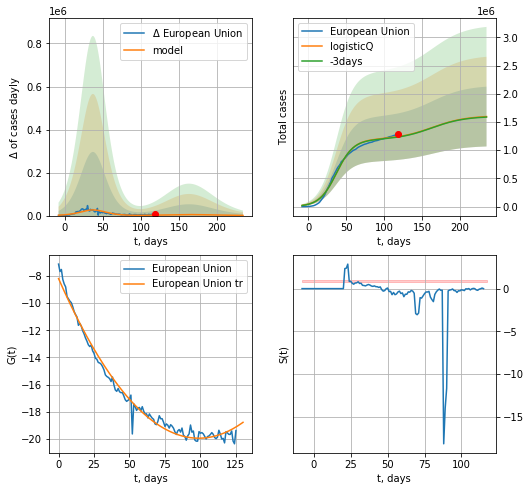

European Union data at: 2020-06-29
+3 day model MAPE: 0.005890
model: logisticQ
coeffs: [ 1.19078607e+06  2.08720941e-07  3.75117900e+01 -4.23678402e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.331882
forecast at the end of period: +117 days
	 deltaDaycases: 733
	 total cases: 1595709 ± 529588
	 total death: 165545 ± 164824
trend coefficient of determination: 0.984705
 intercept_: -8.190496987182058
 coeffs_: [ 0.         -0.23810882  0.00120477]


In [272]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


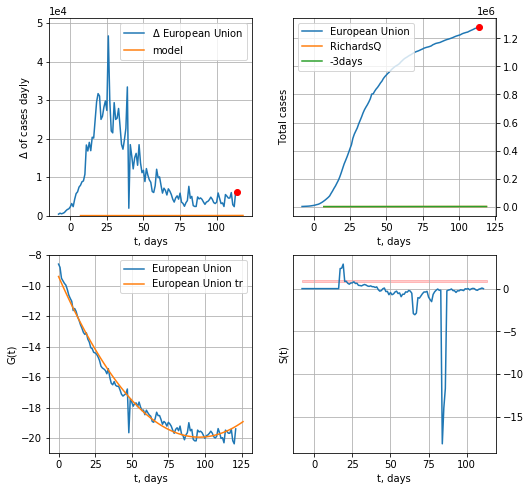

European Union data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 7.42779548e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: nan
forecast at the end of period: +5 days
	 deltaDaycases: 32


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [273]:
x = forecastQR("European Union",dfEU[20:],d1,14*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [287]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [288]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [289]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [290]:
#dfIC[:]

IC
           date   cases  active  death
116 2020-06-25  1830.0       9   10.0
117 2020-06-26  1832.0       9   10.0
118 2020-06-27  1836.0      12   10.0
119 2020-06-28  1838.0      12   10.0
120 2020-06-29  1840.0      12   10.0


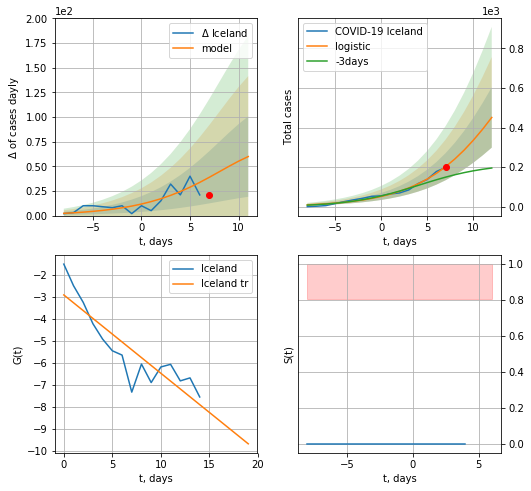

Iceland data at: 2020-06-29
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +5 days
	 deltaDaycases:  59
	 total cases:  450 ± 152
	 total death:  2 ± 2
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


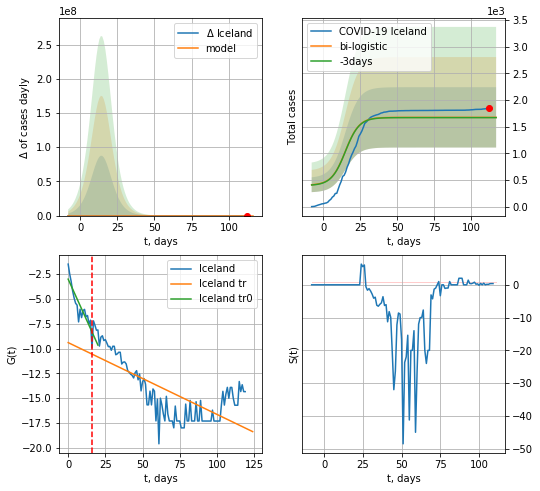

Iceland data at: 2020-06-29
+3 day model MAPE: 0.0030493449034629
model: bi-logistic
coeffs:  [377.73512446  -5.02483358 957.33730192] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.3376658526142583
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1673 ± 565
	 total death:  9 ± 9
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.523505
 intercept: -9.406147
 slope: -0.072245


In [274]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


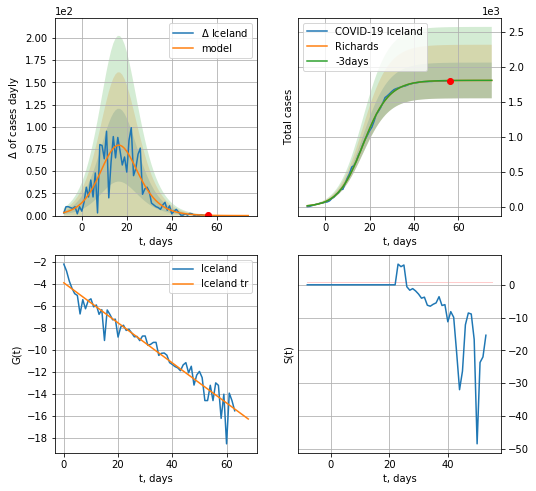

Iceland data at: 2020-06-29
+3 day model MAPE: 0.000574
model: Richards
coeffs: [1.80664071e+03 1.96329707e-01 1.60140797e+01 8.56236679e-01]
rational stdev: 0.141183
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 1806 ± 255
	 total death: 9 ± 3
trend coefficient of determination: 0.937183
 intercept: -3.923109
 slope: -0.181532


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


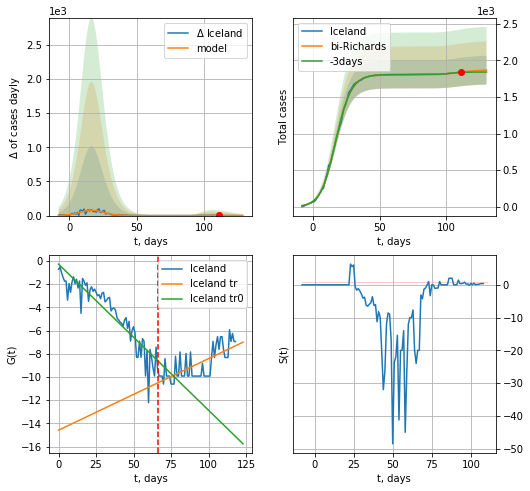

Iceland data at: 2020-06-29
+3 day model MAPE: 0.003930
model: bi-Richards
coeffs: [6.52366561e+01 5.84936586e+00 6.51708784e+01 1.66568857e-02]
rational stdev: 0.105410
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 1865 ± 196
	 total death: 10 ± 3
bi-Richards approximation splitting point: 66
trend coefficient of determination: 0.839239
 intercept: -0.275005
 slope: -0.125953
trend coefficient of determination: 0.483543
 intercept: -14.592562
 slope: 0.061682


In [275]:
vL = 66
x = forecastRR("Iceland",dfIC[1:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[1:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


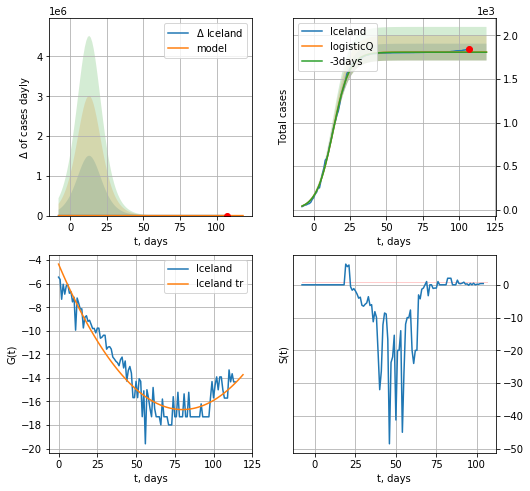

Iceland data at: 2020-06-29
+3 day model MAPE: 0.000711
model: logisticQ
coeffs: [ 1.80802821e+03  4.61265765e-06  1.33755838e+01 -3.81298668e+04]
rational stdev: 0.053261
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 1808 ± 96
	 total death: 9 ± 1
trend coefficient of determination: 0.918313
 intercept_: -4.336977376395055
 coeffs_: [ 0.         -0.30917729  0.00193512]


In [276]:
x = forecastRRR("Iceland",dfIC[5:],d1,15*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active  death
107 2020-06-25  29037  13673.0  564.0
108 2020-06-26  29905  14060.0  575.0
109 2020-06-27  30658  14696.0  592.0
110 2020-06-28  31686  15612.0  604.0
111 2020-06-29  32785  16570.0  620.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


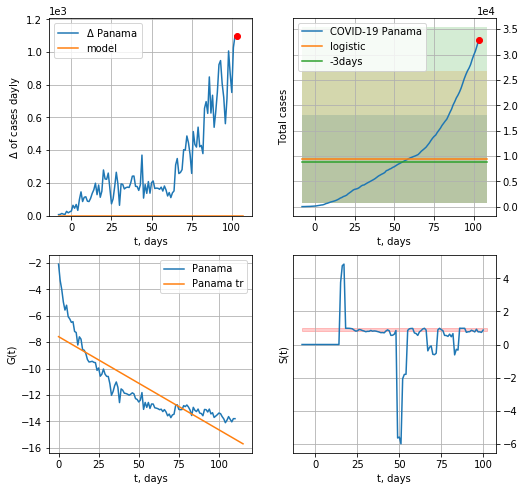

Panama data at: 2020-06-29
+3 day model MAPE: 0.06926312848766826
model: logistic
coeffs:  [ 9.45556250e+03 -7.63340488e+00  2.09847152e+02]
rational stdev:  0.9164090487492568
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  9455 ± 8665
	 total death:  178 ± 489
trend coefficient of determination: 0.739765
 intercept: -7.587225
 slope: -0.070517


In [277]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


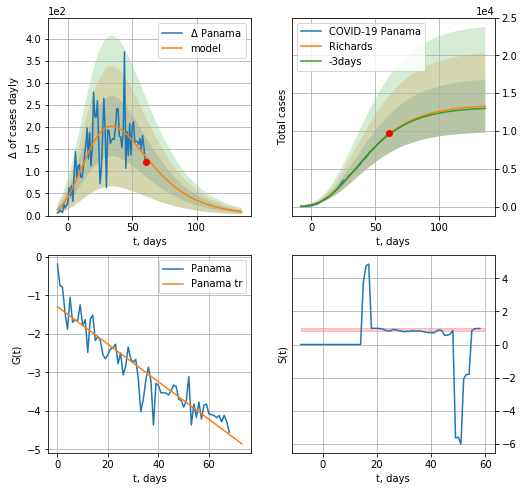

Panama data at: 2020-06-29
+3 day model MAPE: 0.008184
model: Richards
coeffs: [ 1.34885246e+04  2.34173945e+00 -6.38327516e+01  1.75366113e-02]
rational stdev: 0.263123
forecast at the end of period: +75 days
	 deltaDaycases: 8
	 total cases: 13280 ± 3494
	 total death: 251 ± 198
trend coefficient of determination: 0.871686
 intercept: -1.291480
 slope: -0.048815


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


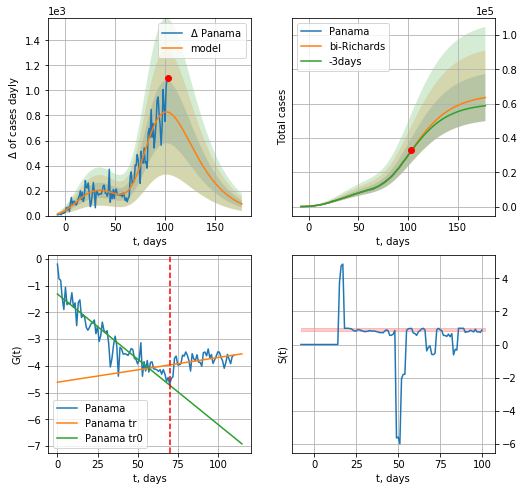

Panama data at: 2020-06-29
+3 day model MAPE: 0.010489
model: bi-Richards
coeffs: [5.22282706e+04 2.02884695e+00 9.92607736e+00 2.06394257e-02]
rational stdev: 0.216102
forecast at the end of period: +75 days
	 deltaDaycases: 92
	 total cases: 63505 ± 13723
	 total death: 1200 ± 777
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874747
 intercept: -1.313198
 slope: -0.048758
trend coefficient of determination: 0.153376
 intercept: -4.614774
 slope: 0.009241


In [278]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


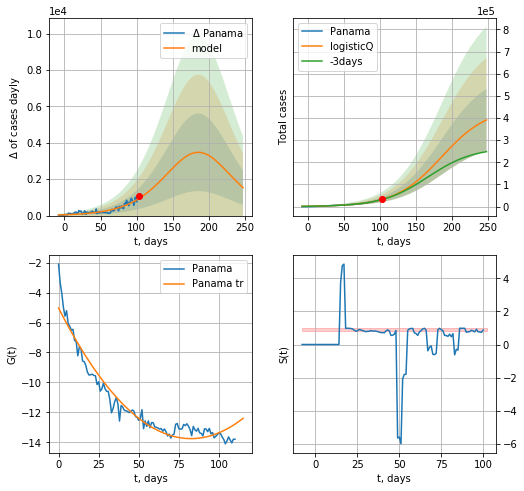

Panama data at: 2020-06-29
+3 day model MAPE: 0.013201
model: logisticQ
coeffs: [ 4.46109668e+05  2.35407147e-06  1.85312759e+02 -1.30584465e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357961
forecast at the end of period: +145 days
	 deltaDaycases: 1533
	 total cases: 391232 ± 140045
	 total death: 7398 ± 7944
trend coefficient of determination: 0.940318
 intercept_: -5.027331876967595
 coeffs_: [ 0.         -0.21143233  0.00128107]


In [279]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

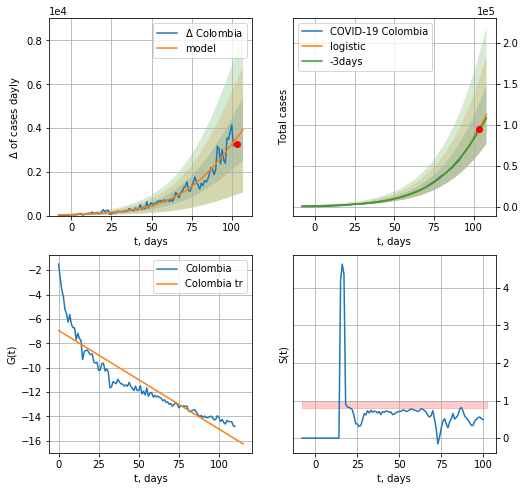

Colombia data at: 2020-06-29
+3 day model MAPE: 0.026584640657643255
model: logistic
coeffs:  [4.40443273e+05 4.72905004e-02 1.30581240e+02]
rational stdev:  0.31702055838841553
forecast at the end of period: +5 days
	 deltaDaycases:  3919
	 total cases:  112668 ± 35718
	 total death:  3820 ± 3633
trend coefficient of determination: 0.835249
 intercept: -6.949692
 slope: -0.080937


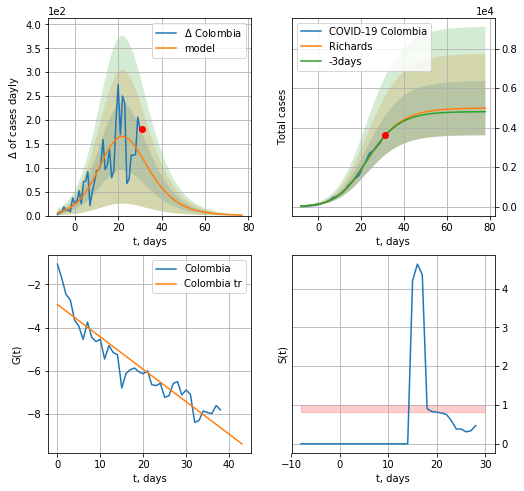

Colombia data at: 2020-06-29
+3 day model MAPE: 0.003507
model: Richards
coeffs: [4.99315067e+03 1.95979830e-01 1.78374870e+01 5.90307623e-01]
rational stdev: 0.275146
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 4985 ± 1371
	 total death: 169 ± 139
trend coefficient of determination: 0.874880
 intercept: -2.931794
 slope: -0.150492


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


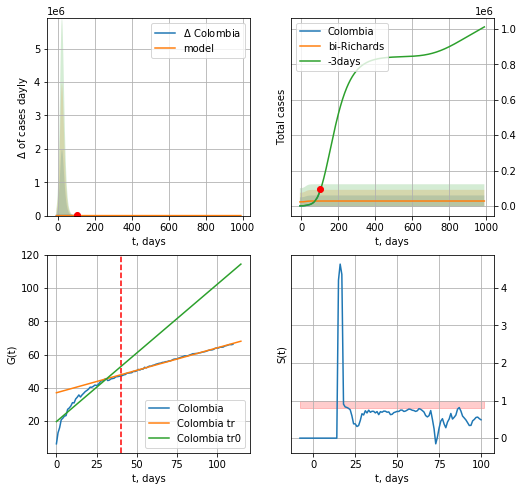

Colombia data at: 2020-06-29
+3 day model MAPE: 0.707208
model: bi-Richards
coeffs: [ 1.65568157e+04 -1.63059891e+00 -2.31360839e+01 -6.06424986e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 1.146406
forecast at the end of period: +887 days
	 deltaDaycases: 0
	 total cases: 27550 ± 31584
	 total death: 934 ± 3212
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.874315
 intercept: 19.657725
 slope: 0.824386
trend coefficient of determination: 0.996071
 intercept: 37.001827
 slope: 0.269866


In [280]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,14*7-dT)
x = forecastRR("Colombia",dfCB[:40],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,140*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


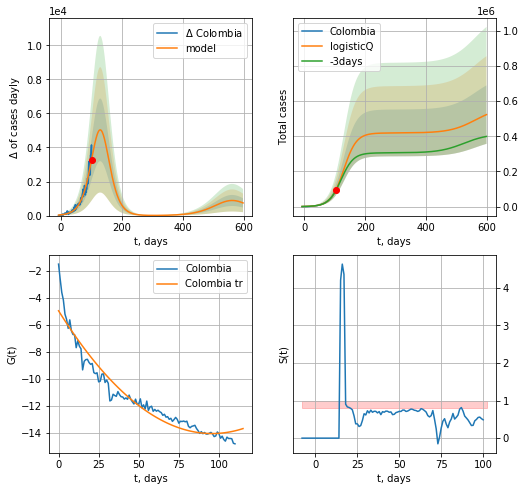

Colombia data at: 2020-06-29
+3 day model MAPE: 0.027060
model: logisticQ
coeffs: [ 4.19004550e+05  5.01707862e-06  1.28891618e+02 -9.44823735e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317689
forecast at the end of period: +495 days
	 deltaDaycases: 743
	 total cases: 523480 ± 166303
	 total death: 17751 ± 16917
trend coefficient of determination: 0.938632
 intercept_: -4.964470207496996
 coeffs_: [ 0.         -0.19021885  0.00099348]


In [281]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active  death
113 2020-06-25  12445.0  2647.0  878.0
114 2020-06-26  12685.0  2734.0  885.0
115 2020-06-27  12968.0  2874.0  892.0
116 2020-06-28  13273.0  3005.0  897.0
117 2020-06-29  13571.0  2992.0  905.0


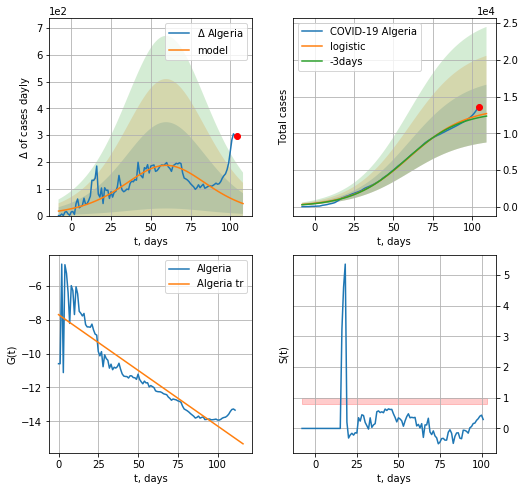

Algeria data at: 2020-06-29
+3 day model MAPE: 0.02527725992339749
model: logistic
coeffs:  [1.35286917e+04 5.54516871e-02 6.00995747e+01]
rational stdev:  0.31026891854254873
forecast at the end of period: +5 days
	 deltaDaycases:  44
	 total cases:  12685 ± 3936
	 total death:  845 ± 786
trend coefficient of determination: 0.811818
 intercept: -7.706674
 slope: -0.065629


In [282]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,14*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


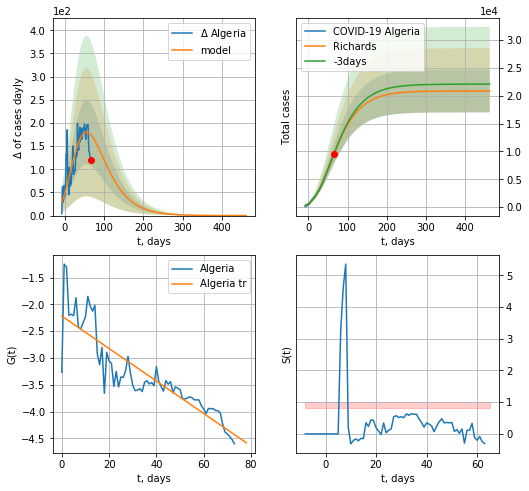

Algeria data at: 2020-06-29
+3 day model MAPE: 0.008186
model: Richards
coeffs: [ 2.08625851e+04  9.79673977e-01 -1.01161081e+02  2.42501114e-02]
rational stdev: 0.184006
forecast at the end of period: +397 days
	 deltaDaycases: 0
	 total cases: 20861 ± 3838
	 total death: 1391 ± 767
trend coefficient of determination: 0.777640
 intercept: -2.218091
 slope: -0.030315


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


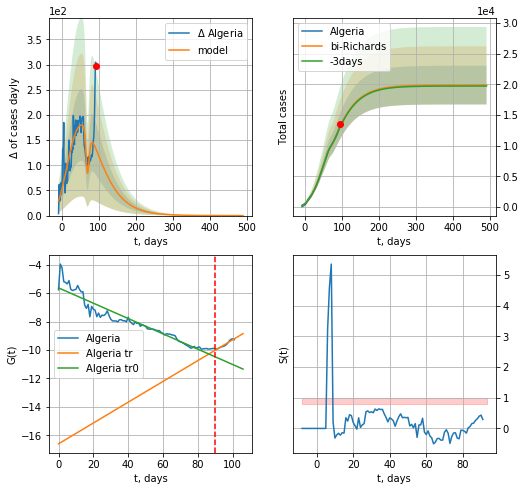

Algeria data at: 2020-06-29
+3 day model MAPE: 0.011207
model: bi-Richards
coeffs: [-9.71606697e+02  5.39373752e-01  6.88082038e+01  5.72596171e-01]
rational stdev: 0.158742
forecast at the end of period: +397 days
	 deltaDaycases: 0
	 total cases: 19890 ± 3157
	 total death: 1326 ± 631
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.910935
 intercept: -5.625506
 slope: -0.053875
trend coefficient of determination: 0.941519
 intercept: -16.595224
 slope: 0.073146


In [283]:
vL = 90
x = forecastRR("Algeria",dfAR[15:vL],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[15:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


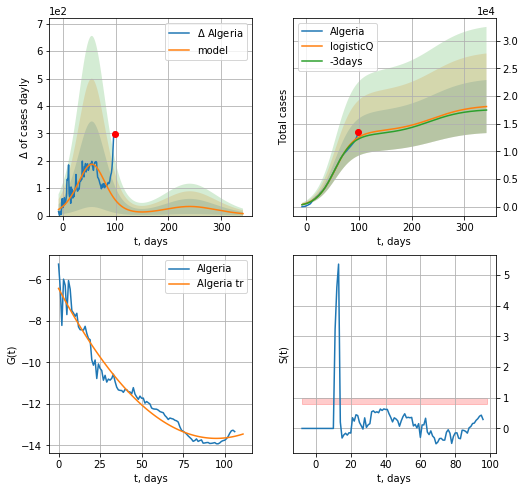

Algeria data at: 2020-06-29
+3 day model MAPE: 0.024918
model: logisticQ
coeffs: [ 1.35723281e+04  5.38462076e-07  5.52458218e+01 -1.02142668e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.264725
forecast at the end of period: +243 days
	 deltaDaycases: 7
	 total cases: 18103 ± 4792
	 total death: 1207 ± 958
trend coefficient of determination: 0.962838
 intercept_: -6.439334690479713
 coeffs_: [ 0.         -0.15225411  0.00080258]


In [284]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

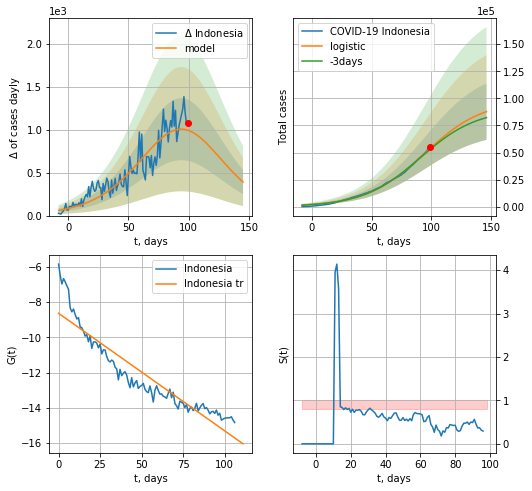

Indonesia data at: 2020-06-29
+3 day model MAPE: 0.018840817428274682
model: logistic
coeffs:  [9.82543614e+04 4.09840157e-02 9.42353769e+01]
rational stdev:  0.29710929668900343
forecast at the end of period: +47 days
	 deltaDaycases:  391
	 total cases:  87738 ± 26068
	 total death:  4467 ± 3981
trend coefficient of determination: 0.864744
 intercept: -8.630211
 slope: -0.066882


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


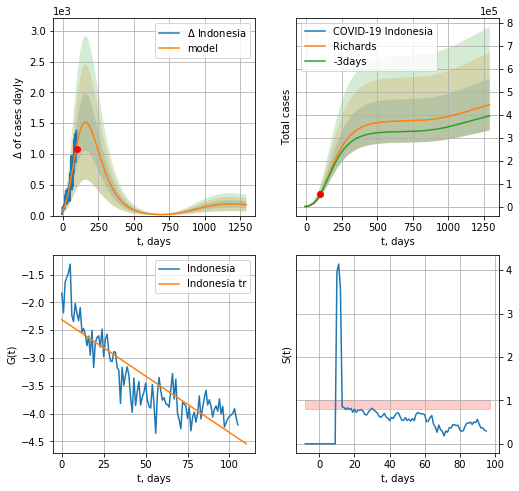

Indonesia data at: 2020-06-29
+3 day model MAPE: 0.009680
model: Richards
coeffs: [ 3.74411621e+05  4.49711664e-01 -1.72701225e+02  2.47794075e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.253662
forecast at the end of period: +1195 days
	 deltaDaycases: 175
	 total cases: 444859 ± 112843
	 total death: 22649 ± 17235
trend coefficient of determination: 0.755044
 intercept: -2.310242
 slope: -0.020287


In [285]:
x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,184*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


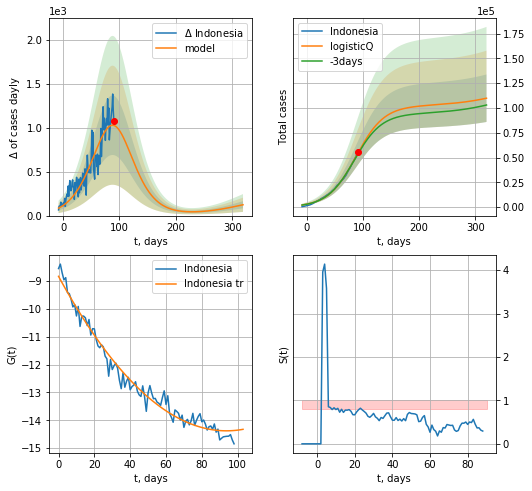

Indonesia data at: 2020-06-29
+3 day model MAPE: 0.016656
model: logisticQ
coeffs: [ 1.02045331e+05  2.39220089e-06  8.80314655e+01 -1.67551492e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.218184
forecast at the end of period: +229 days
	 deltaDaycases: 123
	 total cases: 109864 ± 23970
	 total death: 5593 ± 3660
trend coefficient of determination: 0.975537
 intercept_: -8.828260493942604
 coeffs_: [ 0.         -0.11841869  0.00063148]


In [286]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


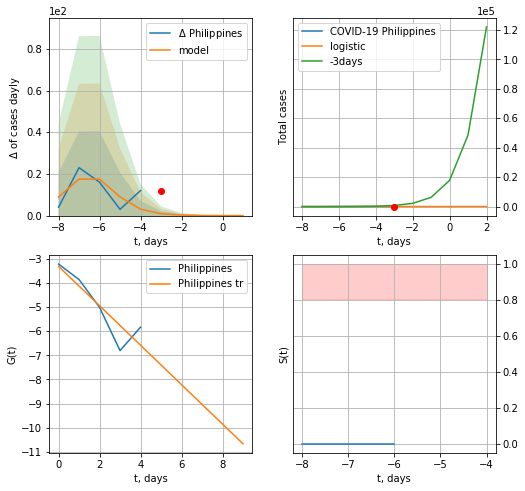

Philippines data at: 2020-06-29
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  2 ± 1
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


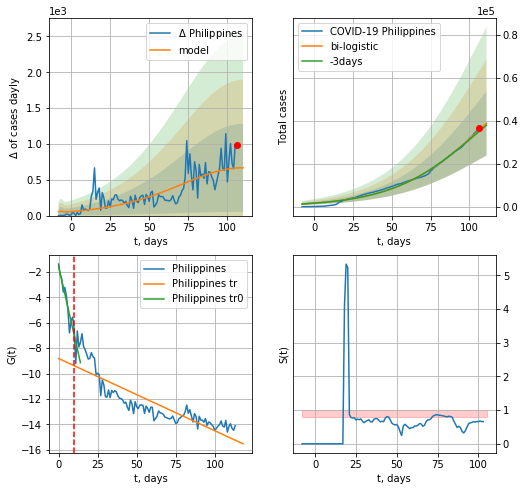

Philippines data at: 2020-06-29
+3 day model MAPE: 0.018094379292011922
model: bi-logistic
coeffs:  [7.61188578e+04 3.50195567e-02 1.09922228e+02] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.3858362353645359
forecast at the end of period: +5 days
	 deltaDaycases:  666
	 total cases:  38839 ± 14985
	 total death:  1337 ± 1547
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.750979
 intercept: -8.815564
 slope: -0.056948


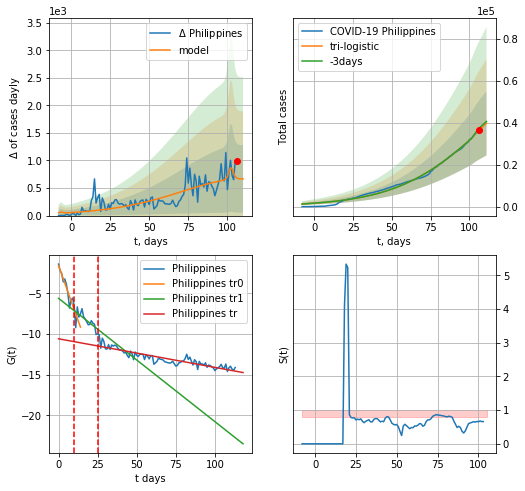

Philippines data at: 2020-06-29
+3 day model MAPE: 0.022673932847580038
model: tri-logistic
coeffs:  [826.69172331   1.0804745  102.82999752] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  7.61188578e+04
  3.50195567e-02  1.09922228e+02]
forecast rational stdev:  0.38552197568445923
forecast at the end of period: +5 days
	 deltaDaycases:  666
	 total cases:  39665 ± 15291
	 total death:  1366 ± 1579
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.797948
 intercept: -10.583918
 slope: -0.035231


In [287]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,14*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,14*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


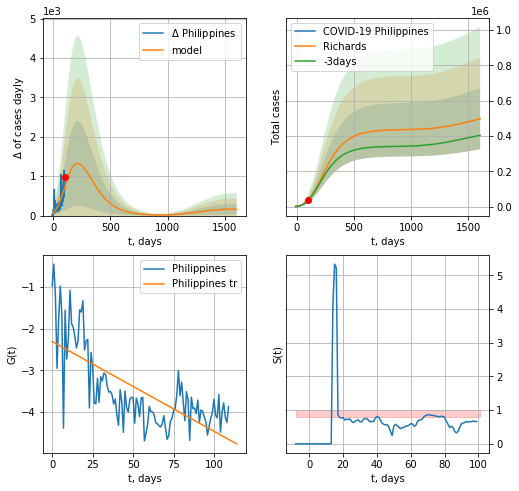

Philippines data at: 2020-06-29
+3 day model MAPE: 0.012110
model: Richards
coeffs: [ 4.36629293e+05  3.44089205e-01 -2.30140993e+02  2.42414152e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.348267
forecast at the end of period: +1503 days
	 deltaDaycases: 165
	 total cases: 497700 ± 173332
	 total death: 17141 ± 17908
trend coefficient of determination: 0.511111
 intercept: -2.305951
 slope: -0.021544


In [288]:
x = forecastRR("Philippines",dfPH[4:],d1,228*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


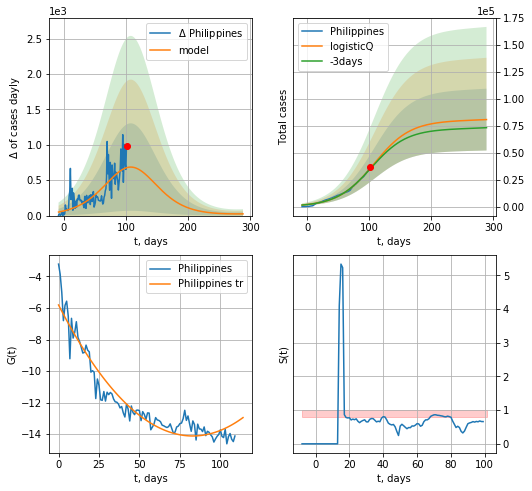

Philippines data at: 2020-06-29
+3 day model MAPE: 0.016542
model: logisticQ
coeffs: [ 7.95563459e+04  1.24471121e-06  1.08147217e+02 -2.75342692e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354954
forecast at the end of period: +187 days
	 deltaDaycases: 24
	 total cases: 80566 ± 28597
	 total death: 2774 ± 2953
trend coefficient of determination: 0.916007
 intercept_: -5.810394734149877
 coeffs_: [ 0.         -0.2002659   0.00120737]


In [289]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
117 2020-06-25  3321.0    1756  191.0
118 2020-06-26  3343.0    1778  191.0
119 2020-06-27  3366.0    1801  191.0
120 2020-06-28  3376.0    1811  191.0
121 2020-06-29  3390.0    1825  191.0


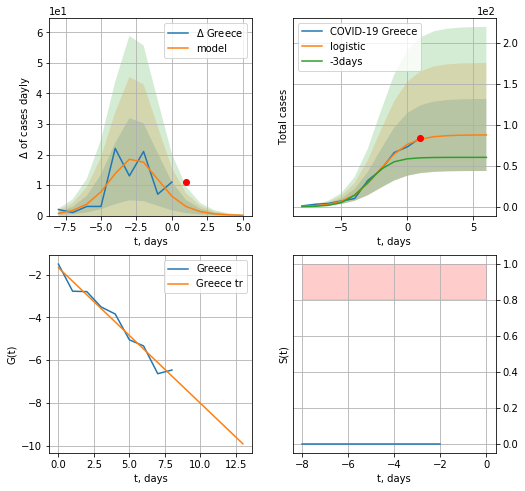

Greece data at: 2020-06-29
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


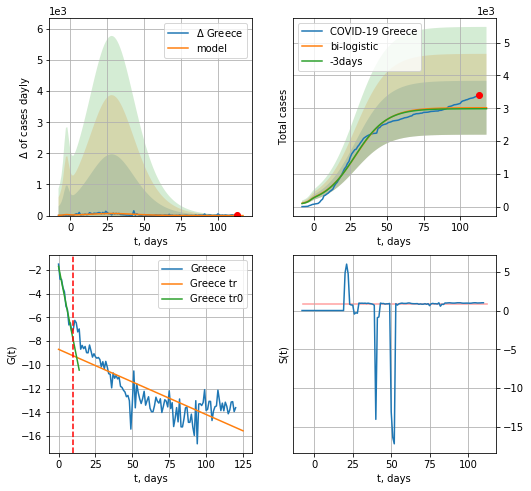

Greece data at: 2020-06-29
+3 day model MAPE: 0.009889825400124829
model: bi-logistic
coeffs:  [2.92961067e+03 9.10444921e-02 2.85139589e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.2724781901675347
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  3016 ± 821
	 total death:  169 ± 138
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.639072
 intercept: -8.692397
 slope: -0.054995


In [290]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,14*7-dT)
xx = forecast2("Greece",dfGC[:],d1,14*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


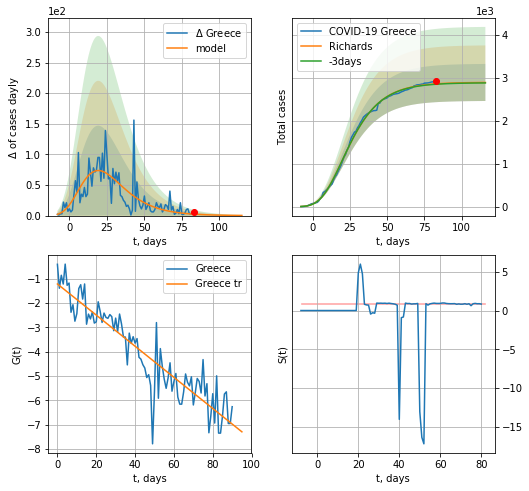

Greece data at: 2020-06-29
+3 day model MAPE: 0.003283
model: Richards
coeffs: [ 2.89327821e+03  7.32575617e+00 -4.72776749e+01  9.49188322e-03]
rational stdev: 0.149150
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 2889 ± 431
	 total death: 162 ± 72
trend coefficient of determination: 0.838381
 intercept: -1.223029
 slope: -0.063896


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


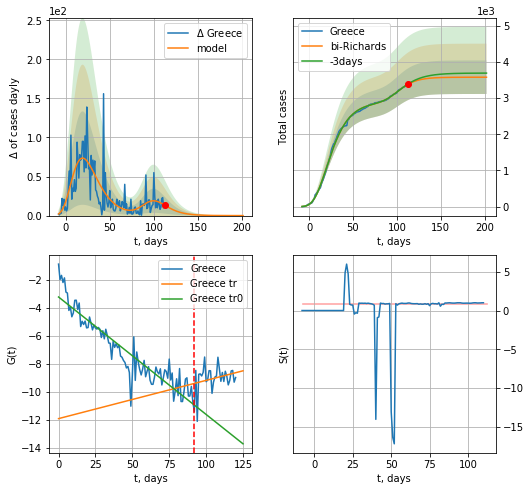

Greece data at: 2020-06-29
+3 day model MAPE: 0.002910
model: bi-Richards
coeffs: [6.86900299e+02 2.03580884e-01 9.08071122e+01 4.28167997e-01]
rational stdev: 0.129556
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 3580 ± 463
	 total death: 201 ± 78
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.861169
 intercept: -3.221863
 slope: -0.083823
trend coefficient of determination: 0.062587
 intercept: -11.901143
 slope: 0.027295


In [291]:
vL = 92
x = forecastRR("Greece",dfGC[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


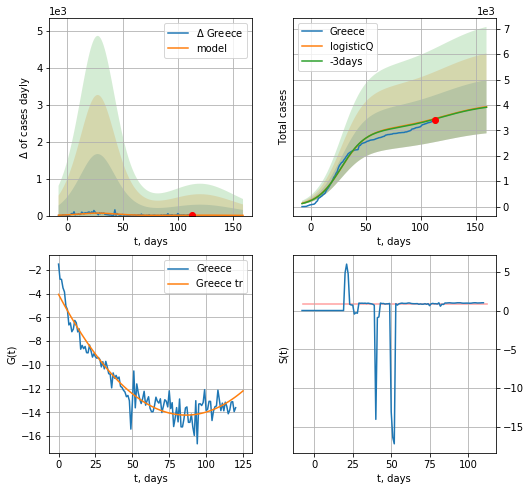

Greece data at: 2020-06-29
+3 day model MAPE: 0.004784
model: logisticQ
coeffs: [ 3.02274108e+03  1.66574882e-07  2.77819713e+01 -5.27341976e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266253
forecast at the end of period: +47 days
	 deltaDaycases: 6
	 total cases: 3930 ± 1046
	 total death: 221 ± 176
trend coefficient of determination: 0.919192
 intercept_: -4.057030613548103
 coeffs_: [ 0.         -0.23588891  0.00136604]


In [292]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date   cases  active  death
111 2020-06-25  4127.0     886  577.0
112 2020-06-26  4138.0     879  578.0
113 2020-06-27  4138.5     879  578.0
114 2020-06-28  4142.0     876  581.0
115 2020-06-29  4145.0     875  585.0


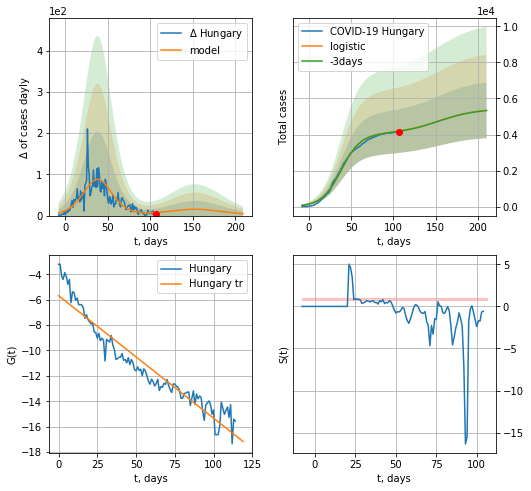

Hungary data at: 2020-06-29
+3 day model MAPE: 0.0030724442552368027
model: logistic
coeffs:  [4.03824307e+03 8.67943467e-02 3.82793923e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.2886265281771617
forecast at the end of period: +103 days
	 deltaDaycases:  4
	 total cases:  5341 ± 1541
	 total death:  753 ± 652
trend coefficient of determination: 0.915508
 intercept: -5.679889
 slope: -0.096494


In [293]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


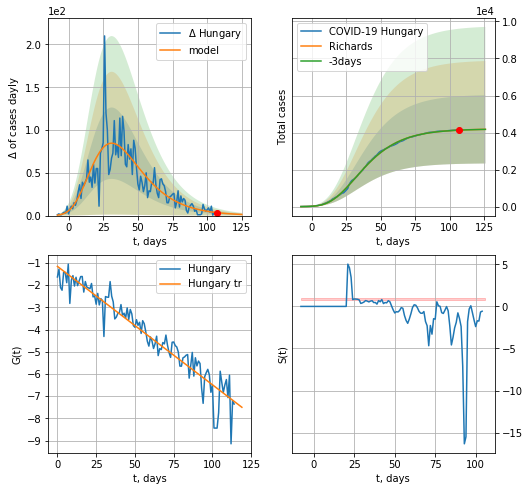

Hungary data at: 2020-06-29
+3 day model MAPE: 0.000512
model: Richards
coeffs: [ 4.19721717e+03  3.69720823e+00 -4.45475878e+01  1.49341576e-02]
rational stdev: 0.441711
forecast at the end of period: +19 days
	 deltaDaycases: 1
	 total cases: 4174 ± 1843
	 total death: 589 ± 780
trend coefficient of determination: 0.907194
 intercept: -1.155795
 slope: -0.053315


In [294]:
vL = 99
x = forecastRR("Hungary",dfHG[:],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR("Hungary",dfHG[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


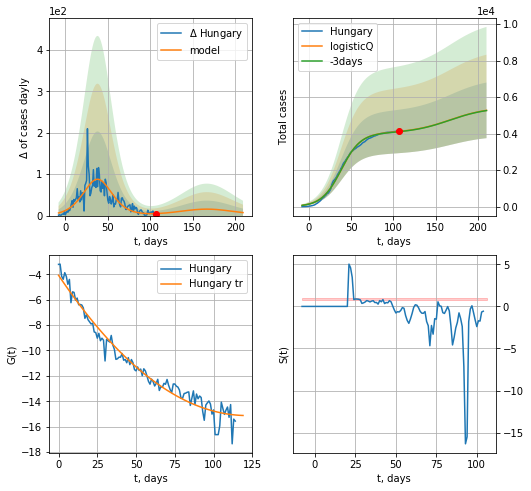

Hungary data at: 2020-06-29
+3 day model MAPE: 0.003222
model: logisticQ
coeffs: [ 4.03818437e+03  3.35044961e-07  3.82798797e+01 -2.58950200e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.288714
forecast at the end of period: +103 days
	 deltaDaycases: 7
	 total cases: 5279 ± 1524
	 total death: 745 ± 645
trend coefficient of determination: 0.963763
 intercept_: -4.078287731026108
 coeffs_: [ 0.         -0.18153757  0.00074601]


In [295]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


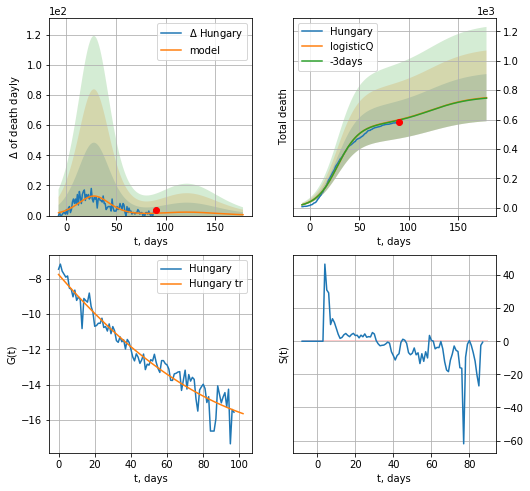

Hungary data at: 2020-06-29
+3 day model MAPE: 0.004071
model: logisticQ
coeffs: [ 5.63075775e+02  4.07220187e-07  2.80267583e+01 -2.23924433e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.214175
forecast at the end of period: +89 days
	 total death: 748 ± 160
trend coefficient of determination: 0.937460
 intercept_: -7.764472832130267
 coeffs_: [ 0.         -0.11825904  0.00040235]


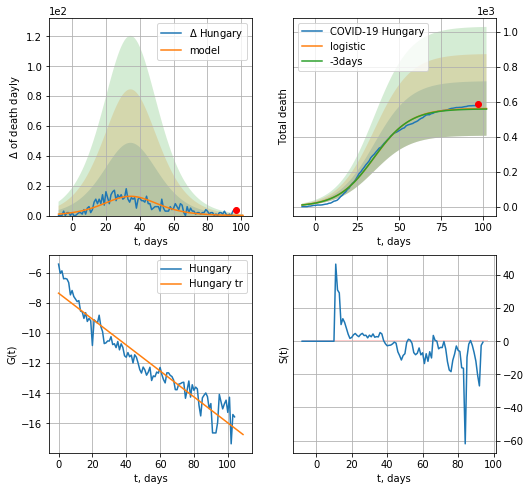

Hungary data at: 2020-06-29
+3 day model MAPE: 0.0051413722430697344
model: logistic
coeffs:  [5.62471022e+02 9.19604061e-02 3.50047114e+01]
rational stdev:  0.27701642427831036
forecast at the end of period: +5 days
	 total death:  561 ± 155
trend coefficient of determination: 0.921096
 intercept: -7.354308
 slope: -0.086023


In [296]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,14*7-dT,cases='death')

MT
           date  cases  active  death
109 2020-06-25  668.0      32    9.0
110 2020-06-26  670.0      29    9.0
111 2020-06-27  670.0      26    9.0
112 2020-06-28  670.0      25    9.0
113 2020-06-29  670.0      22    9.0


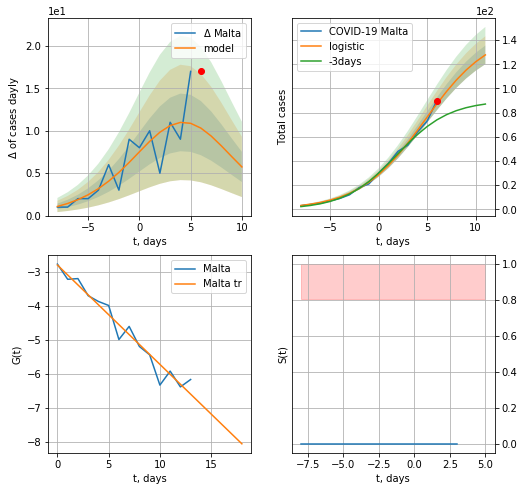

Malta data at: 2020-06-29
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  127 ± 7
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


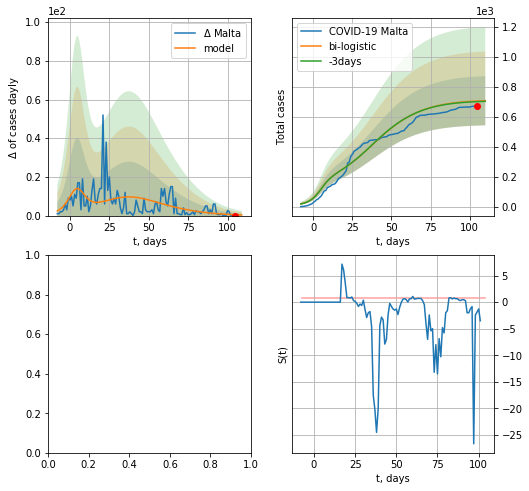

In [297]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*14-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*14-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


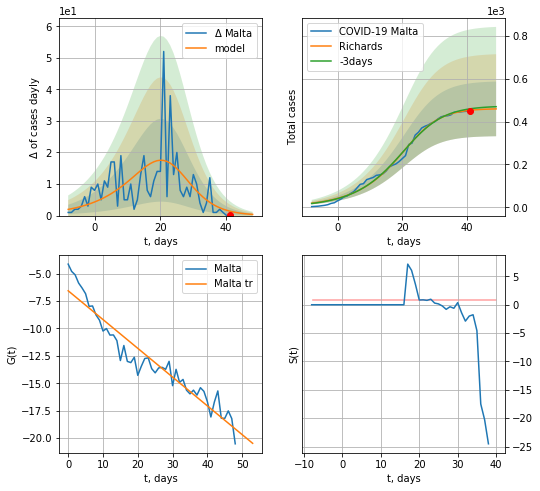

Malta data at: 2020-06-26
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +8 days
	 deltaDaycases: 0
	 total cases: 459 ± 127
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


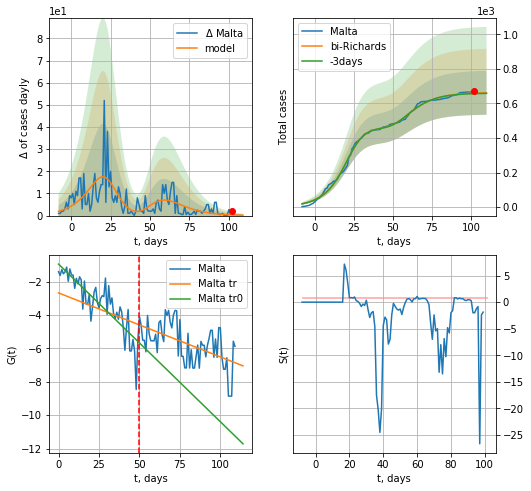

Malta data at: 2020-06-26
+3 day model MAPE: 0.004447
model: bi-Richards
coeffs: [2.02110341e+02 1.13056575e+01 8.82481948e+00 8.34048934e-03]
rational stdev: 0.192259
forecast at the end of period: +8 days
	 deltaDaycases: 0
	 total cases: 661 ± 127
	 total death: 8 ± 4
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.729300
 intercept: -0.942081
 slope: -0.094495
trend coefficient of determination: 0.278680
 intercept: -2.668657
 slope: -0.038360


In [303]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


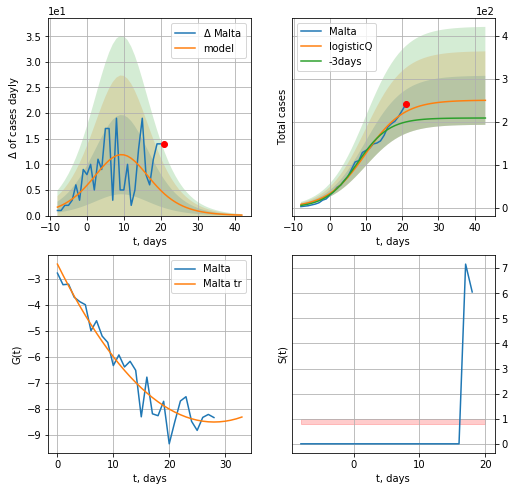

Malta data at: 2020-06-26
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +22 days
	 deltaDaycases: 0
	 total cases: 250 ± 57
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


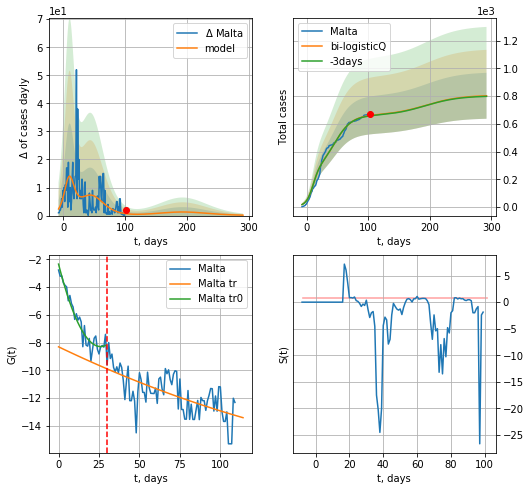

Malta data at: 2020-06-26
+3 day model MAPE: 0.004225
model: bi-logisticQ
coeffs: [ 4.10367092e+02  1.83190745e-07  4.44072228e+01 -3.84914174e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.206426
forecast at the end of period: +190 days
	 deltaDaycases: 0
	 total cases: 802 ± 165
	 total death: 10 ± 6
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.427221
 intercept_: -8.308174421575664
 coeffs_: [ 0.00000000e+00 -5.59939418e-02  9.79733987e-05]


In [304]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
107 2020-06-25  1630.0   150.0   28.0
108 2020-06-26  1643.0   160.0   28.0
109 2020-06-27  1657.0   174.0   28.0
110 2020-06-28  1664.0   175.0   28.0
111 2020-06-29  1665.0   173.0   28.0


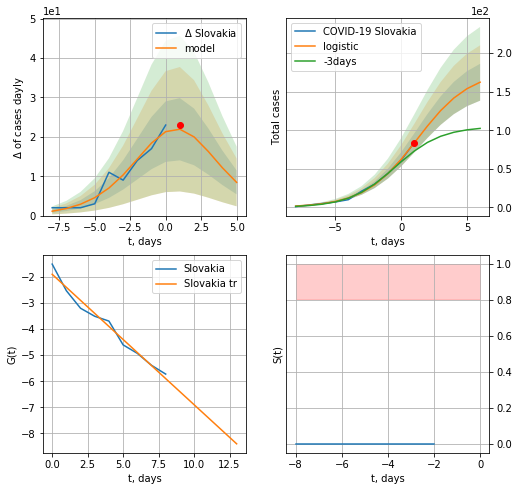

Slovakia data at: 2020-06-29
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +5 days
	 deltaDaycases:  8
	 total cases:  162 ± 23
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


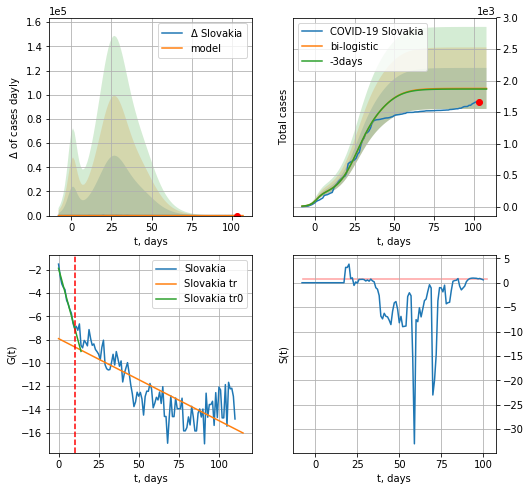

Slovakia data at: 2020-06-29
+3 day model MAPE: 0.0052099939021878604
model: bi-logistic
coeffs:  [1.35827043e+03 1.51542027e-01 2.66511239e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.17345573701852585
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1875 ± 325
	 total death:  31 ± 16
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.649864
 intercept: -7.918817
 slope: -0.070624


In [298]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,14*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


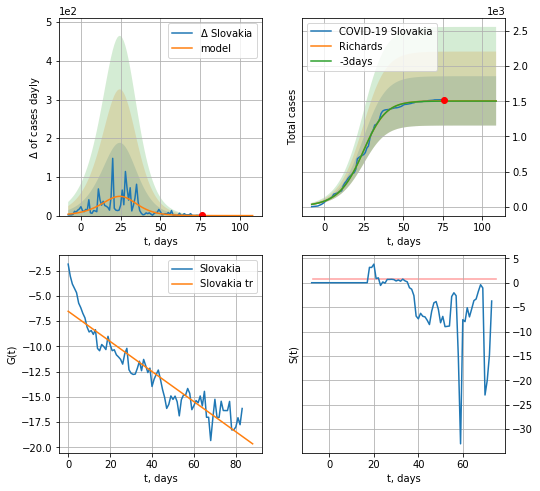

Slovakia data at: 2020-06-29
+3 day model MAPE: 0.002066
model: Richards
coeffs: [1.50610865e+03 1.09508318e-01 2.68945088e+01 1.32920214e+00]
rational stdev: 0.232989
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 1506 ± 350
	 total death: 25 ± 17
trend coefficient of determination: 0.871466
 intercept: -6.535200
 slope: -0.149062


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


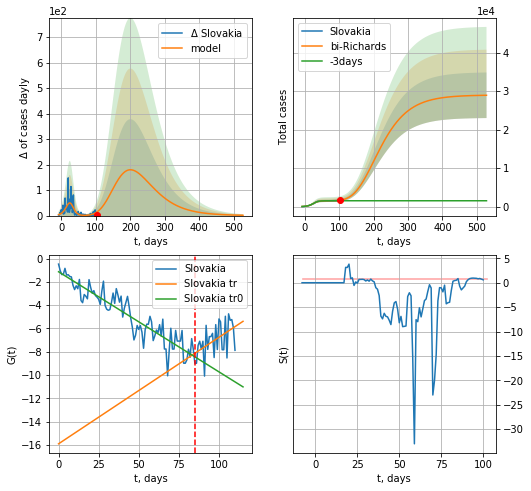

Slovakia data at: 2020-06-29
+3 day model MAPE: 0.107660
model: bi-Richards
coeffs: [2.74900825e+04 2.92567488e-01 4.98460670e+01 6.26632076e-02]
rational stdev: 0.204645
forecast at the end of period: +425 days
	 deltaDaycases: 1
	 total cases: 28927 ± 5919
	 total death: 486 ± 298
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.852712
 intercept: -1.131266
 slope: -0.086007
trend coefficient of determination: 0.233358
 intercept: -15.913919
 slope: 0.091515


In [299]:
vL = 85
x = forecastRR("Slovakia",dfSL[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d1,74*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


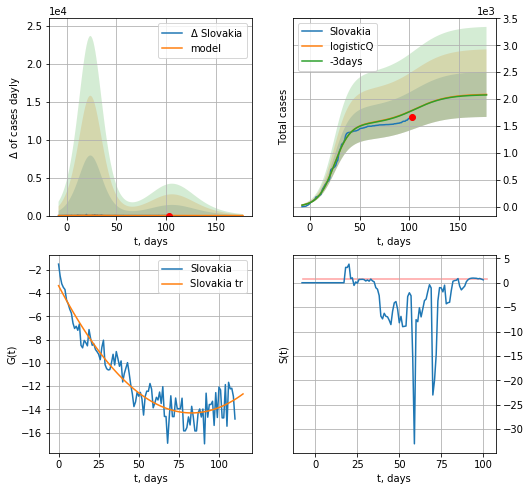

Slovakia data at: 2020-06-29
+3 day model MAPE: 0.002597
model: logisticQ
coeffs: [ 1.54581884e+03  1.73779011e-06  2.43829018e+01 -7.06323990e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.200559
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 2086 ± 418
	 total death: 35 ± 21
trend coefficient of determination: 0.903162
 intercept_: -3.3611173317236087
 coeffs_: [ 0.         -0.26410481  0.00159206]


In [300]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
112 2020-06-25  1547.0    62.0  109.0
113 2020-06-26  1558.0    73.0  109.0
114 2020-06-27  1572.0    87.0  109.0
115 2020-06-28  1581.0    86.0  111.0
116 2020-06-29  1585.0    90.0  111.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


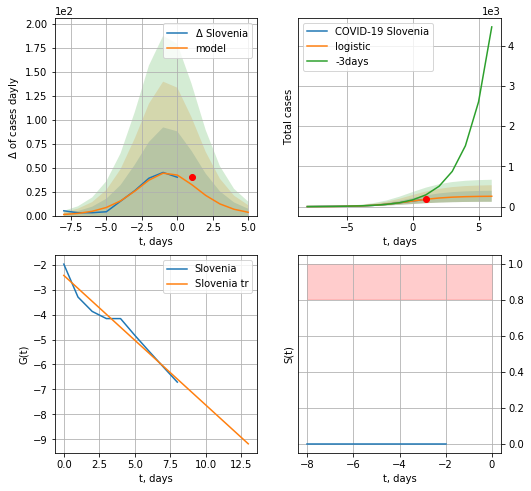

Slovenia data at: 2020-06-29
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +5 days
	 deltaDaycases:  3
	 total cases:  257 ± 136
	 total death:  18 ± 28
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


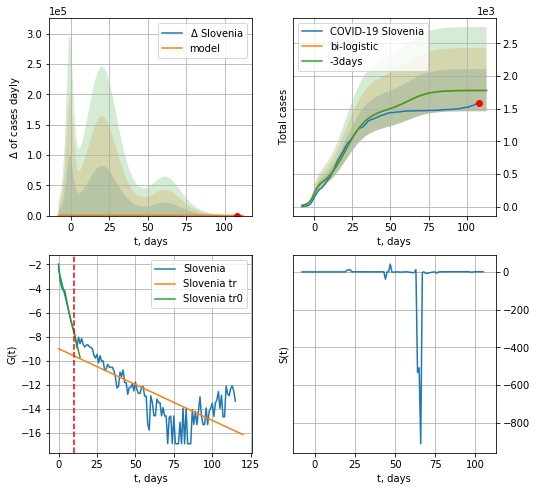

Slovenia data at: 2020-06-29
+3 day model MAPE: 0.003759773226231108
model: bi-logistic
coeffs:  [1.21747319e+03 1.41359440e-01 2.07872196e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.18089402568098403
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1782 ± 322
	 total death:  124 ± 67
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.556277
 intercept: -8.995965
 slope: -0.059468


In [301]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*14-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


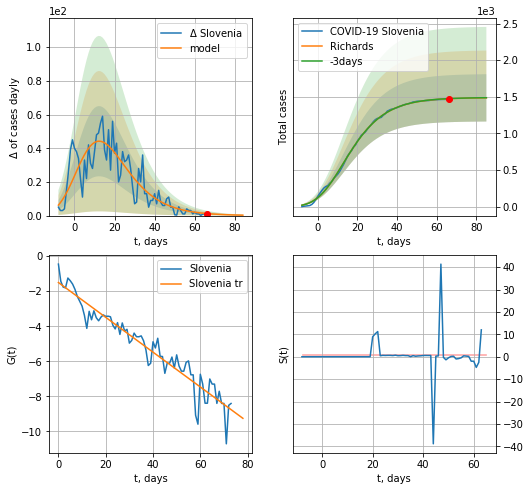

Slovenia data at: 2020-06-29
+3 day model MAPE: 0.001211
model: Richards
coeffs: [ 1.48860897e+03  5.69202399e-01 -8.90072420e+00  1.52510532e-01]
rational stdev: 0.217393
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 1485 ± 323
	 total death: 104 ± 67
trend coefficient of determination: 0.915958
 intercept: -1.505070
 slope: -0.099296


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


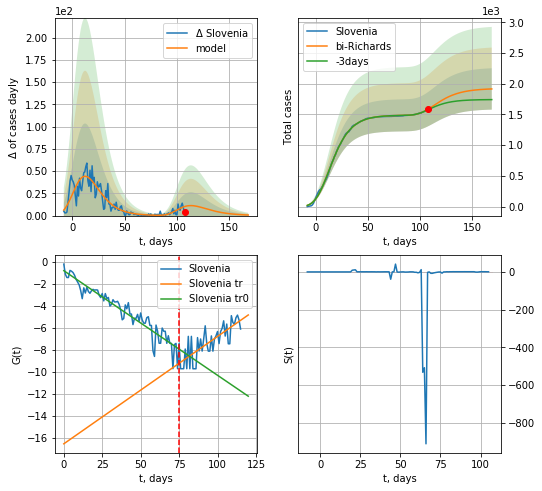

Slovenia data at: 2020-06-29
+3 day model MAPE: 0.007211
model: bi-Richards
coeffs: [4.36010039e+02 4.06349494e+00 5.62434421e+01 1.73572033e-02]
rational stdev: 0.175613
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 1915 ± 336
	 total death: 134 ± 70
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.904265
 intercept: -0.810222
 slope: -0.095060
trend coefficient of determination: 0.590406
 intercept: -16.545660
 slope: 0.097583


In [302]:
vL = 75
x = forecastRR("Slovenia",dfSV[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


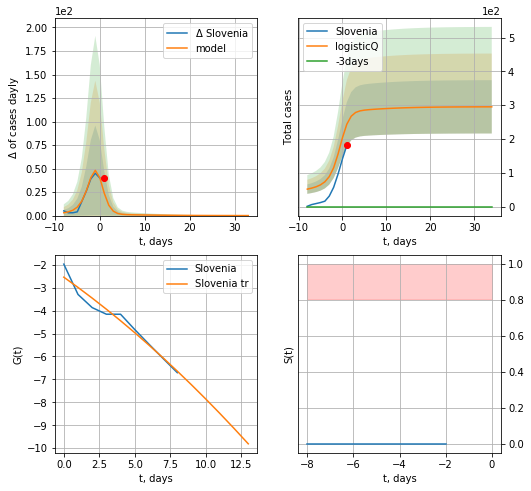

Slovenia data at: 2020-06-29
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 20 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


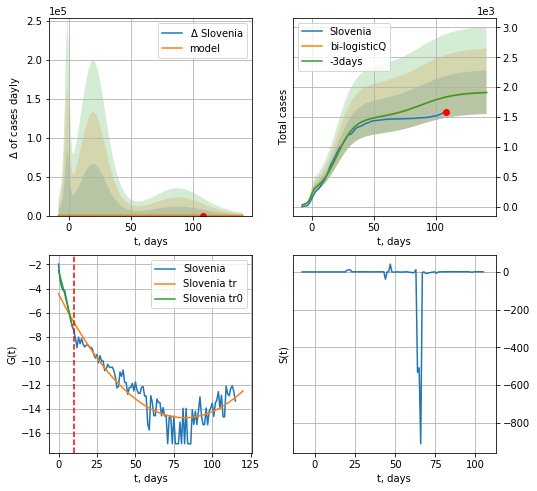

Slovenia data at: 2020-06-29
+3 day model MAPE: 0.001976
model: bi-logisticQ
coeffs: [ 1.26095200e+03  4.26603797e-07  2.01986347e+01 -3.23014406e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.190326
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 1914 ± 364
	 total death: 134 ± 76
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.832817
 intercept_: -4.446520081243619
 coeffs_: [ 0.         -0.25094748  0.00153185]


In [303]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
107 2020-06-25  13372   954.0  264.0
108 2020-06-26  13565  1068.0  265.0
109 2020-06-27  13792  1187.0  267.0
110 2020-06-28  14046  1312.0  270.0
111 2020-06-29  14288  1433.0  274.0


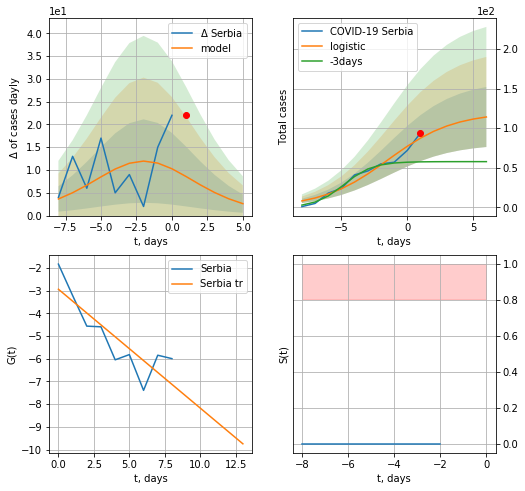

Serbia data at: 2020-06-29
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  114 ± 37
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


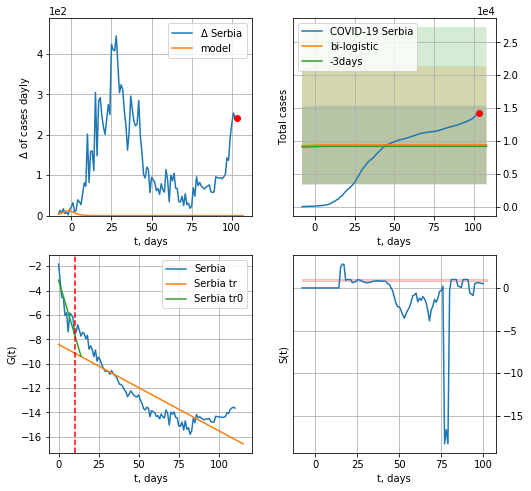

Serbia data at: 2020-06-29
+3 day model MAPE: 0.024444742211932602
model: bi-logistic
coeffs:  [ 7.41255766e+03 -2.34950799e+00  1.14380810e+02] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6373168821673422
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  9385 ± 5981
	 total death:  179 ± 342
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.749700
 intercept: -8.421184
 slope: -0.070873


In [304]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,14*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


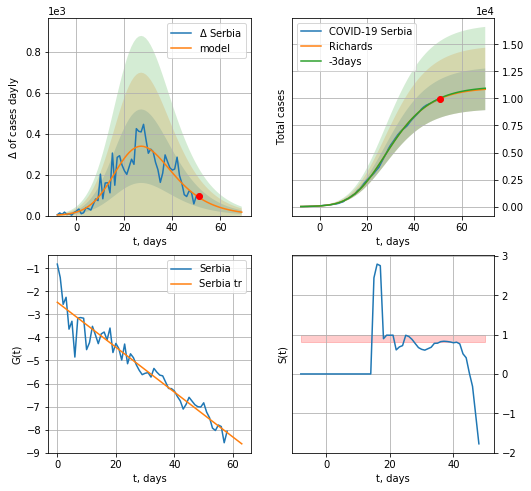

Serbia data at: 2020-06-29
+3 day model MAPE: 0.004687
model: Richards
coeffs: [1.10013418e+04 2.65942316e-01 1.74706718e+01 3.71455437e-01]
rational stdev: 0.177413
forecast at the end of period: +19 days
	 deltaDaycases: 16
	 total cases: 10837 ± 1922
	 total death: 207 ± 110
trend coefficient of determination: 0.925214
 intercept: -2.475756
 slope: -0.097437


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


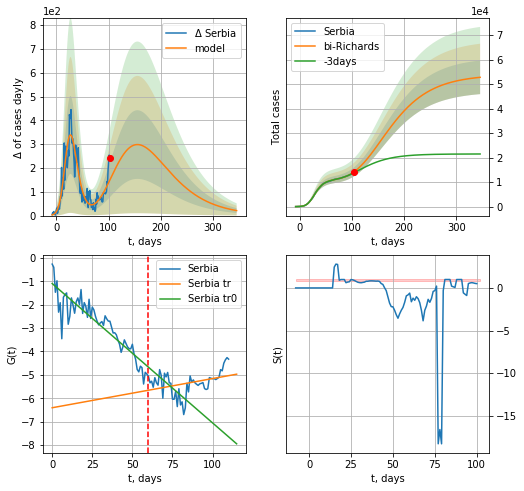

Serbia data at: 2020-06-29
+3 day model MAPE: 0.025263
model: bi-Richards
coeffs: [ 4.28803064e+04  7.30468608e-01 -3.44973965e+01  2.62231510e-02]
rational stdev: 0.129971
forecast at the end of period: +243 days
	 deltaDaycases: 21
	 total cases: 52779 ± 6859
	 total death: 1012 ± 394
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.815375
 intercept: -1.095540
 slope: -0.059600
trend coefficient of determination: 0.128364
 intercept: -6.407180
 slope: 0.012477


In [305]:
vL=60
x = forecastRR("Serbia",dfSB[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[:],d1,48*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


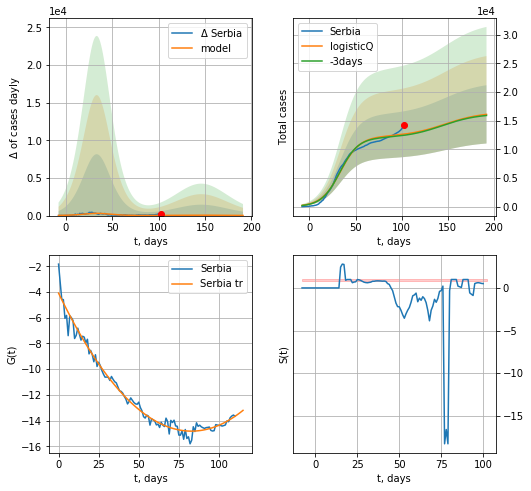

Serbia data at: 2020-06-29
+3 day model MAPE: 0.015720
model: logisticQ
coeffs: [ 1.22096160e+04  2.34289075e-07  3.35899808e+01 -4.12605996e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.315972
forecast at the end of period: +89 days
	 deltaDaycases: 18
	 total cases: 16109 ± 5090
	 total death: 308 ± 291
trend coefficient of determination: 0.980200
 intercept_: -4.086312372866546
 coeffs_: [ 0.         -0.25890272  0.00156235]


In [306]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
117 2020-06-25  2483.0   227.0  107.0
118 2020-06-26  2539.0   282.0  107.0
119 2020-06-27  2624.0   365.0  107.0
120 2020-06-28  2691.0   432.0  107.0
121 2020-06-29  2725.0   463.0  107.0


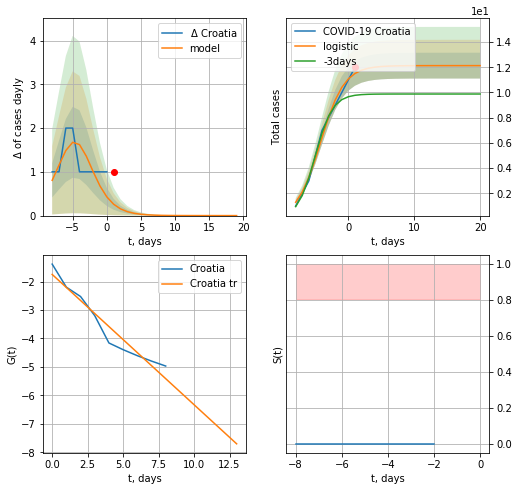

Croatia data at: 2020-06-29
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


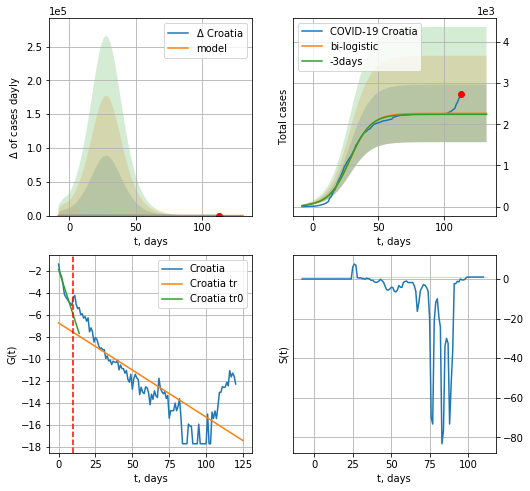

Croatia data at: 2020-06-29
+3 day model MAPE: 0.010994783427239366
model: bi-logistic
coeffs:  [2.25418972e+03 1.23870803e-01 2.83982718e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.3087937667486532
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  2266 ± 699
	 total death:  88 ± 81
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.622278
 intercept: -6.741129
 slope: -0.085664


In [307]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


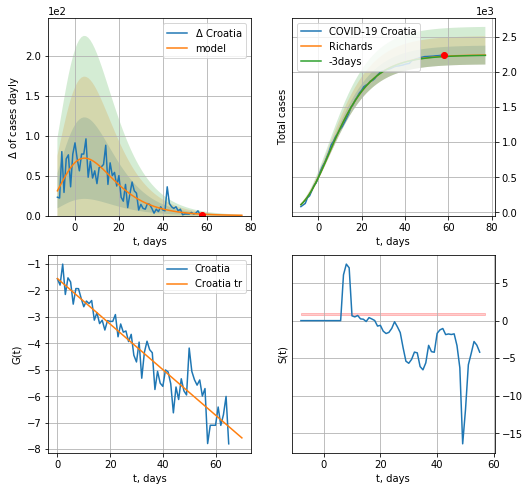

Croatia data at: 2020-06-29
+3 day model MAPE: 0.001655
model: Richards
coeffs: [ 2.24668978e+03  8.08087760e+00 -4.68913295e+01  1.08284561e-02]
rational stdev: 0.059802
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 2242 ± 134
	 total death: 88 ± 15
trend coefficient of determination: 0.905946
 intercept: -1.549686
 slope: -0.086084


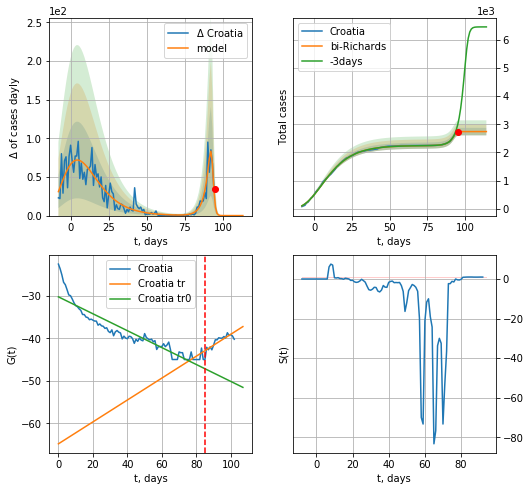

Croatia data at: 2020-06-29
+3 day model MAPE: 0.152589
model: bi-Richards
coeffs: [4.93588759e+02 3.04410975e-01 9.36141199e+01 4.53218399e+00]
rational stdev: 0.048528
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 2740 ± 132
	 total death: 107 ± 15
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.856566
 intercept: -30.256682
 slope: -0.198901
trend coefficient of determination: 0.713480
 intercept: -64.813829
 slope: 0.257604


In [308]:
iL = 18
vL = 85+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


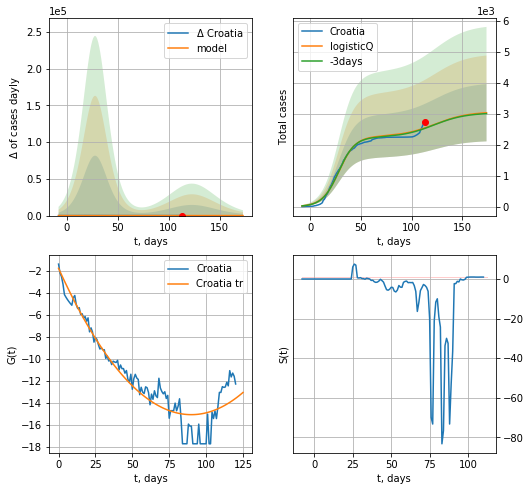

Croatia data at: 2020-06-29
+3 day model MAPE: 0.006252
model: logisticQ
coeffs: [ 2.26716523e+03  3.76275278e-07  2.82931242e+01 -3.25903514e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.304797
forecast at the end of period: +61 days
	 deltaDaycases: 2
	 total cases: 3036 ± 925
	 total death: 119 ± 108
trend coefficient of determination: 0.897454
 intercept_: -1.7689285534714916
 coeffs_: [ 0.         -0.29604875  0.00164545]


In [309]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
111 2020-06-25  61130   42259  2533.0
112 2020-06-26  62755   43398  2620.0
113 2020-06-27  63923   44075  2708.0
114 2020-06-28  65188   44860  2789.0
115 2020-06-29  66754   45931  2872.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


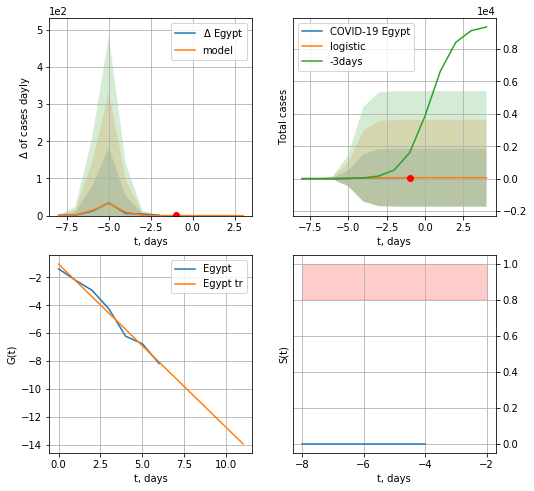

Egypt data at: 2020-06-29
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


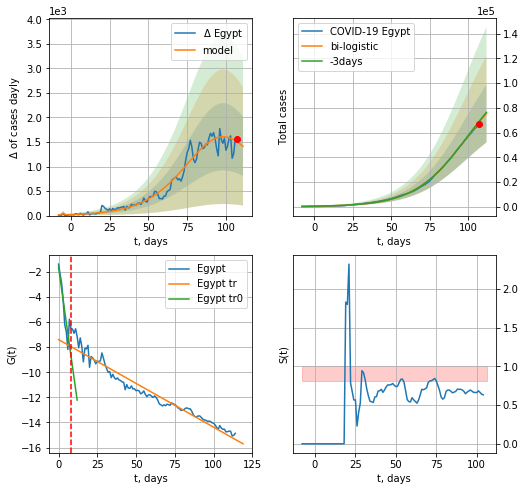

Egypt data at: 2020-06-29
+3 day model MAPE: 0.009756877201663716
model: bi-logistic
coeffs:  [1.07016641e+05 5.90660957e-02 9.80891819e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.31006264114298177
forecast at the end of period: +5 days
	 deltaDaycases:  1412
	 total cases:  75405 ± 23380
	 total death:  3244 ± 3017
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.948667
 intercept: -7.396557
 slope: -0.069762


In [310]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*14-dT)
xx = forecast2("Egypt",dfEG[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


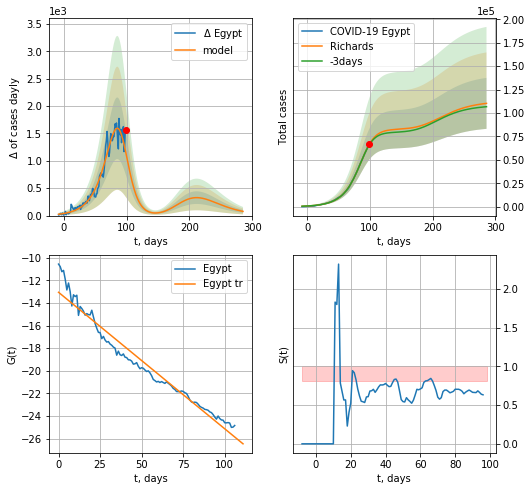

Egypt data at: 2020-06-29
+3 day model MAPE: 0.008962
model: Richards
coeffs: [8.26899870e+04 5.16137620e-02 9.22920069e+01 1.89734917e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.246706
forecast at the end of period: +187 days
	 deltaDaycases: 76
	 total cases: 110280 ± 27206
	 total death: 4744 ± 3511
trend coefficient of determination: 0.958837
 intercept: -13.058497
 slope: -0.120643


In [311]:
x = forecastRR("Egypt",dfEG[8:],d1,40*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


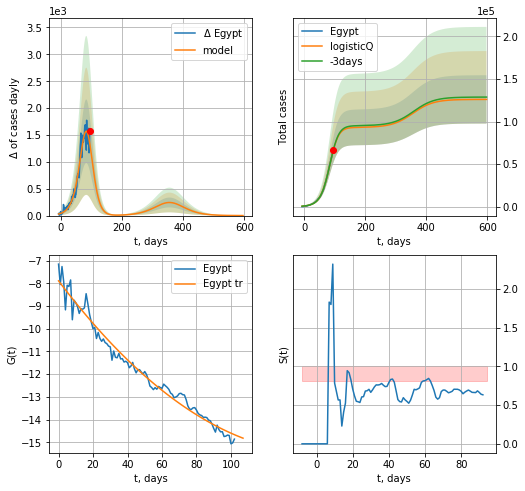

Egypt data at: 2020-06-29
+3 day model MAPE: 0.004798
model: logisticQ
coeffs: [ 9.30089254e+04  1.33110260e-04  8.14264230e+01 -4.23752473e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.225187
forecast at the end of period: +502 days
	 deltaDaycases: 0
	 total cases: 125929 ± 28357
	 total death: 5417 ± 3659
trend coefficient of determination: 0.975770
 intercept_: -7.892414321787301
 coeffs_: [ 0.         -0.10018178  0.00033126]


In [312]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date  cases   active   death
114 2020-06-25  39139  19651.0  1437.0
115 2020-06-26  41193  20775.0  1559.0
116 2020-06-27  43262  21664.0  1660.0
117 2020-06-28  45402  22524.0  1756.0
118 2020-06-29  47151  22338.0  1839.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


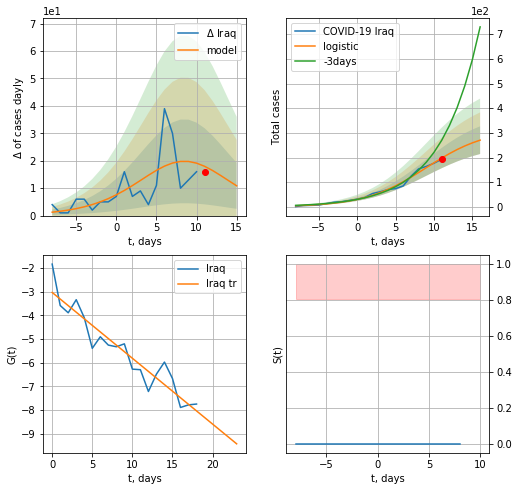

Iraq data at: 2020-06-29
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +5 days
	 deltaDaycases:  10
	 total cases:  270 ± 56
	 total death:  10 ± 6
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


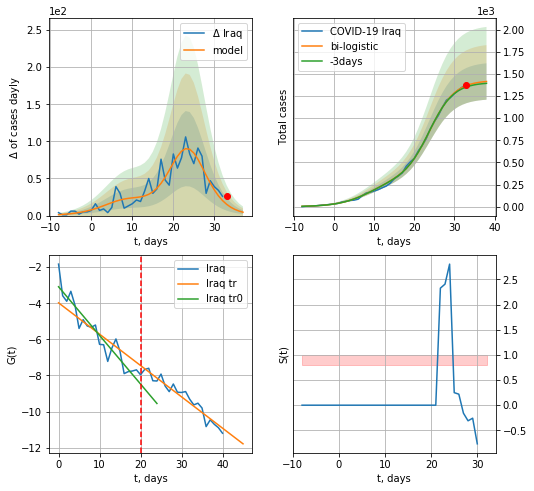

Iraq data at: 2020-06-29
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +5 days
	 deltaDaycases:  4
	 total cases:  1413 ± 205
	 total death:  55 ± 23
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


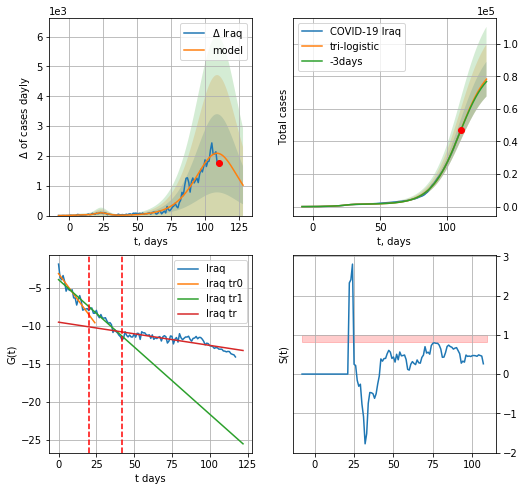

Iraq data at: 2020-06-29
+3 day model MAPE: 0.006005120796752133
model: tri-logistic
coeffs:  [8.90220501e+04 9.39387630e-02 1.09361293e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.13653413739969686
forecast at the end of period: +19 days
	 deltaDaycases:  1019
	 total cases:  78298 ± 10690
	 total death:  3053 ± 1250
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.673045
 intercept: -9.477706
 slope: -0.030558


In [313]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,14*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


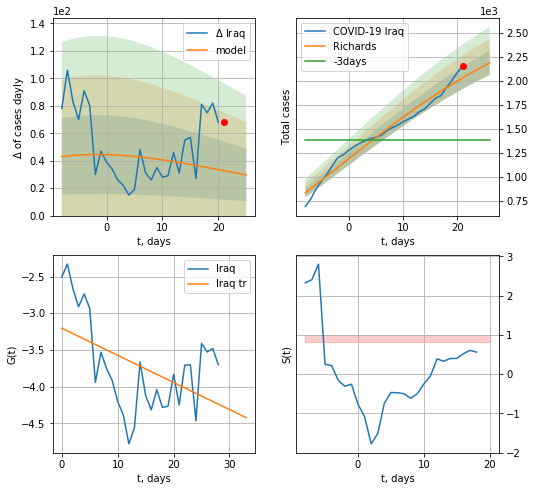

Iraq data at: 2020-06-29
+3 day model MAPE: 0.483696
model: Richards
coeffs: [ 3.05374051e+03  1.25736108e+00 -8.65808580e+01  3.20212773e-02]
rational stdev: 0.056950
forecast at the end of period: +5 days
	 deltaDaycases: 29
	 total cases: 2186 ± 124
	 total death: 85 ± 14
trend coefficient of determination: 0.238101
 intercept: -3.204366
 slope: -0.036947


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


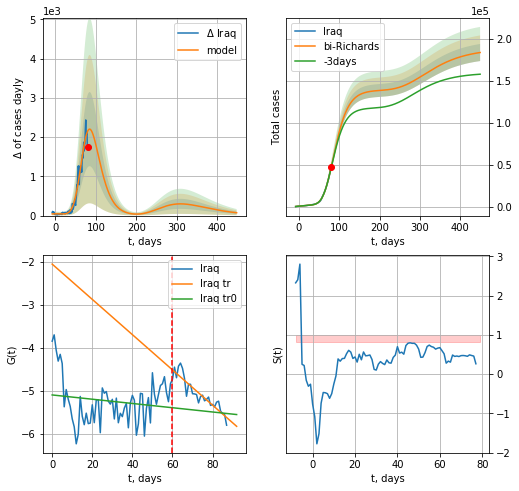

Iraq data at: 2020-06-29
+3 day model MAPE: 0.011975
model: bi-Richards
coeffs: [1.35842599e+05 2.10223580e-01 5.53659165e+01 2.33364605e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.055200
forecast at the end of period: +369 days
	 deltaDaycases: 72
	 total cases: 183594 ± 10134
	 total death: 7160 ± 1185
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.025791
 intercept: -5.099063
 slope: -0.004971
trend coefficient of determination: 0.835682
 intercept: -2.044427
 slope: -0.041161


In [314]:
vL=60+30#25+10
x = forecastRR("Iraq",dfIQ[30:vL-30],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[30:],d1,66*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-30)

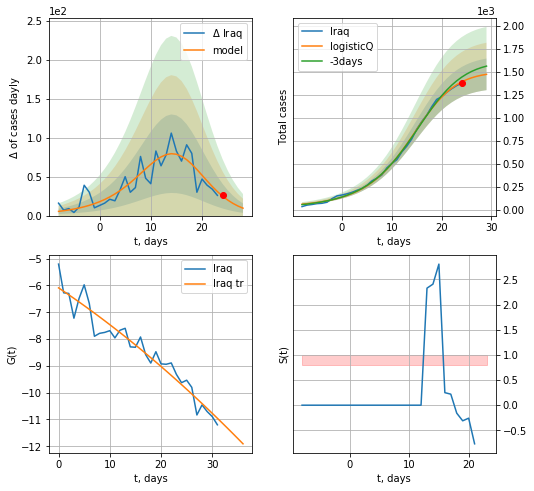

Iraq data at: 2020-06-29
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291916e+03  2.94853860e-03  1.34415511e+01 -5.72228334e+01]
rational stdev: 0.116469
forecast at the end of period: +5 days
	 deltaDaycases: 9
	 total cases: 1474 ± 171
	 total death: 57 ± 19
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


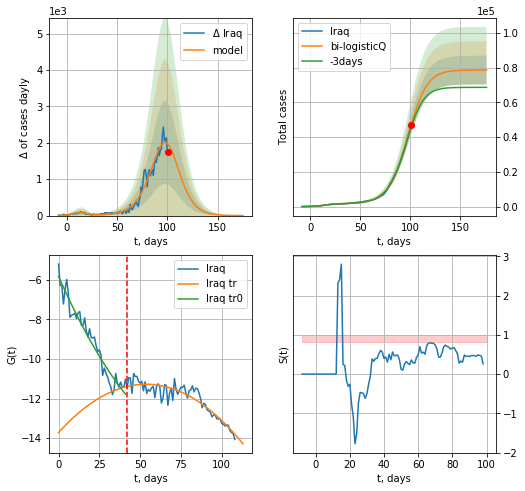

Iraq data at: 2020-06-29
+3 day model MAPE: 0.027568
model: bi-logisticQ
coeffs: [ 7.71095299e+04  1.92678177e-04  9.75016714e+01 -4.43406111e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.105351
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 78606 ± 8281
	 total death: 3065 ± 968
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.840930
 intercept_: -13.717596543116542
 coeffs_: [ 0.          0.09119448 -0.00085167]


In [315]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [316]:
#len(dfAR)

AR
           date    cases  active  death
113 2020-06-25  12445.0  2647.0  878.0
114 2020-06-26  12685.0  2734.0  885.0
115 2020-06-27  12968.0  2874.0  892.0
116 2020-06-28  13273.0  3005.0  897.0
117 2020-06-29  13571.0  2992.0  905.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


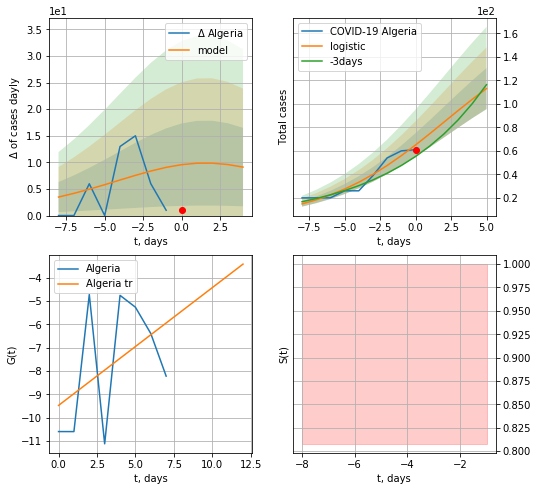

Algeria data at: 2020-06-29
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +5 days
	 deltaDaycases:  9
	 total cases:  112 ± 17
	 total death:  7 ± 3
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


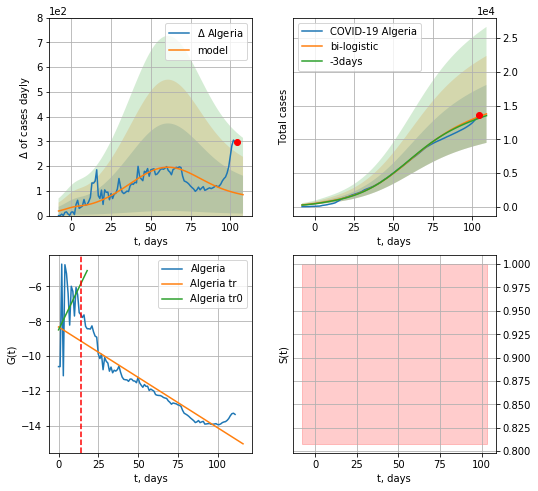

Algeria data at: 2020-06-29
+3 day model MAPE: 0.01809753186326102
model: bi-logistic
coeffs:  [1.32373868e+04 5.73077360e-02 6.02701827e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.31215810560175994
forecast at the end of period: +5 days
	 deltaDaycases:  84
	 total cases:  13769 ± 4298
	 total death:  918 ± 859
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.887734
 intercept: -8.325701
 slope: -0.057705


In [317]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*14-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*14-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


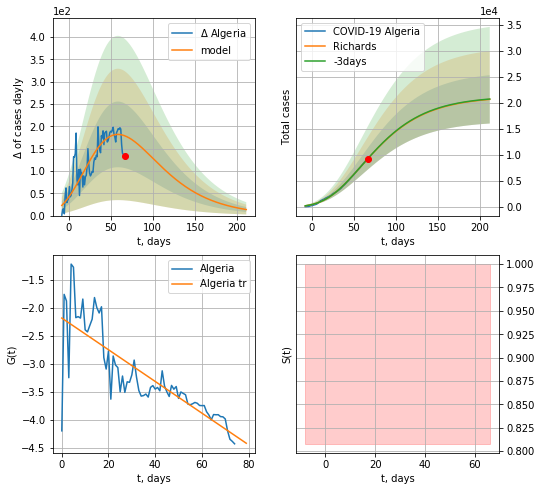

Algeria data at: 2020-06-29
+3 day model MAPE: 0.002676
model: Richards
coeffs: [ 2.12814905e+04  1.20319901e+00 -1.08693333e+02  1.95061272e-02]
rational stdev: 0.224506
forecast at the end of period: +145 days
	 deltaDaycases: 13
	 total cases: 20702 ± 4647
	 total death: 1380 ± 929
trend coefficient of determination: 0.678514
 intercept: -2.184065
 slope: -0.028199


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


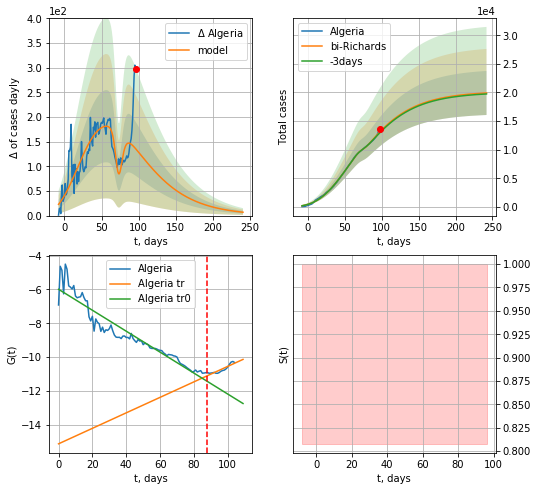

Algeria data at: 2020-06-29
+3 day model MAPE: 0.011837
model: bi-Richards
coeffs: [-1.07600956e+03  4.33687294e-01  7.24700571e+01  6.83545525e-01]
rational stdev: 0.193216
forecast at the end of period: +145 days
	 deltaDaycases: 6
	 total cases: 19916 ± 3848
	 total death: 1328 ± 769
bi-Richards approximation splitting point: 88
trend coefficient of determination: 0.903912
 intercept: -5.990941
 slope: -0.062029
trend coefficient of determination: 0.810525
 intercept: -15.138634
 slope: 0.045848


In [318]:
vL = 88+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


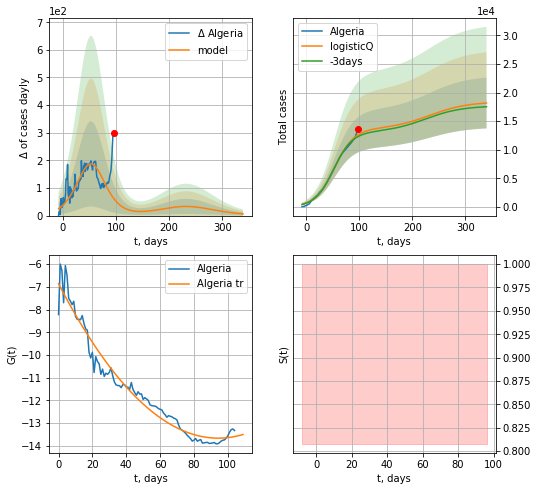

Algeria data at: 2020-06-29
+3 day model MAPE: 0.024722
model: logisticQ
coeffs: [ 1.35975664e+04  5.84403056e-07  5.33286184e+01 -9.37160550e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.244198
forecast at the end of period: +243 days
	 deltaDaycases: 6
	 total cases: 18177 ± 4438
	 total death: 1212 ± 887
trend coefficient of determination: 0.960975
 intercept_: -6.86122666007808
 coeffs_: [ 0.         -0.14431956  0.00076448]


In [319]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date  cases  active  death
105 2020-06-25  992.0   149.0   19.0
106 2020-06-26  992.1   149.0   19.0
107 2020-06-27  994.0   151.0   19.0
108 2020-06-28  994.5   142.0   19.0
109 2020-06-29  996.0   144.0   19.0


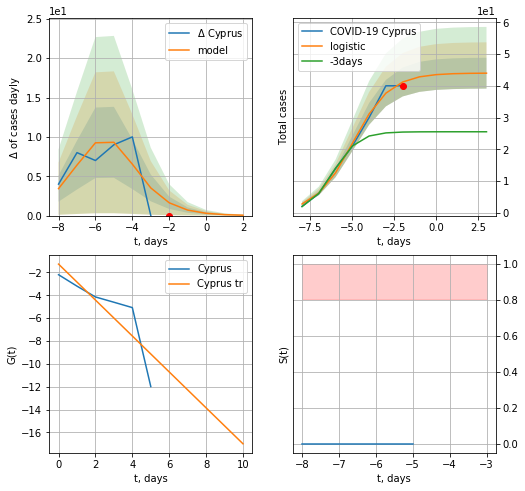

Cyprus data at: 2020-06-29
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


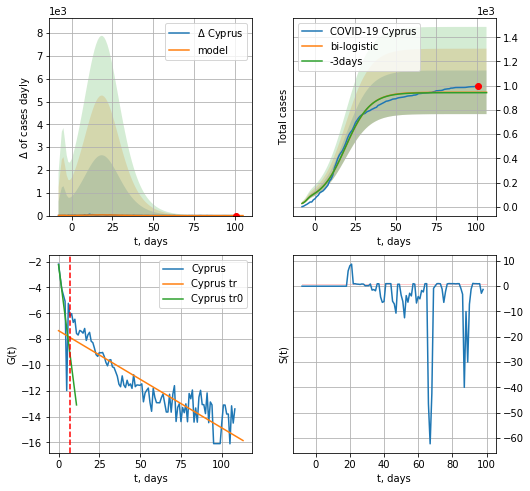

Cyprus data at: 2020-06-29
+3 day model MAPE: 0.0033204404784281196
model: bi-logistic
coeffs:  [9.01528656e+02 1.30637657e-01 1.89471687e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19030362052186134
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  945 ± 179
	 total death:  18 ± 10
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.815522
 intercept: -7.347847
 slope: -0.075225


In [321]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*14-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


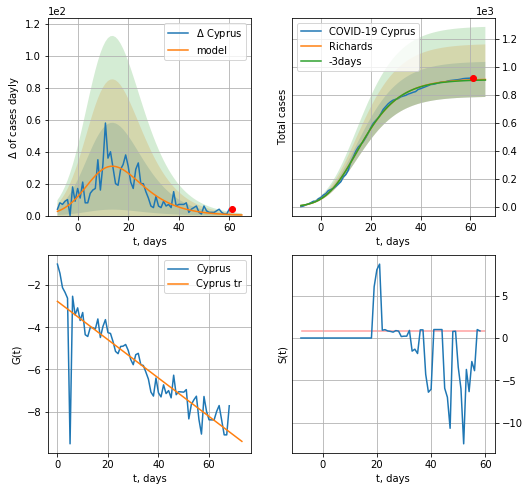

Cyprus data at: 2020-06-29
+3 day model MAPE: 0.004368
model: Richards
coeffs: [9.11933822e+02 3.20830854e-01 3.99756256e+00 3.34642778e-01]
rational stdev: 0.137523
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 908 ± 124
	 total death: 17 ± 7
trend coefficient of determination: 0.787995
 intercept: -2.772129
 slope: -0.090979


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


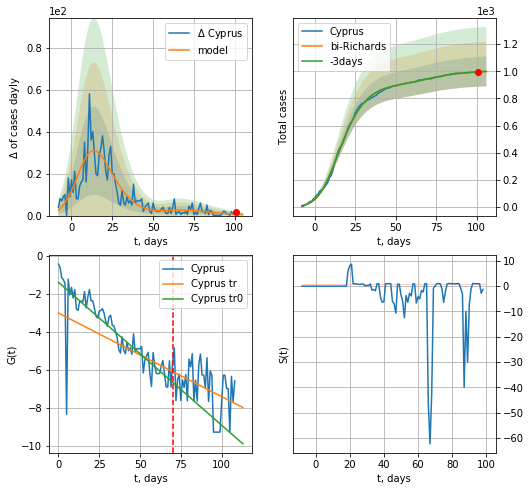

Cyprus data at: 2020-06-29
+3 day model MAPE: 0.000003
model: bi-Richards
coeffs: [9.41381856e+01 6.22471704e+00 4.26642913e+00 1.10400228e-02]
rational stdev: 0.109662
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 998 ± 109
	 total death: 19 ± 6
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.729447
 intercept: -1.381684
 slope: -0.075278
trend coefficient of determination: 0.154450
 intercept: -3.002783
 slope: -0.044020


In [322]:
vL=70
x = forecastRR("Cyprus",dfCP[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


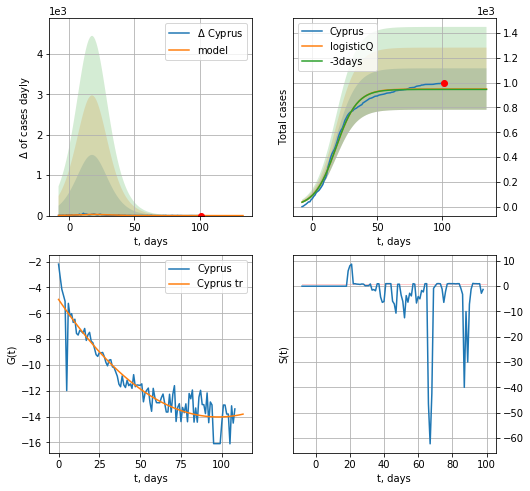

Cyprus data at: 2020-06-29
+3 day model MAPE: 0.003202
model: logisticQ
coeffs: [ 9.47939611e+02  3.68609788e-07  1.80686688e+01 -3.30508816e+05]
rational stdev: 0.175776
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 947 ± 166
	 total death: 18 ± 9
trend coefficient of determination: 0.871088
 intercept_: -4.929499388871094
 coeffs_: [ 0.         -0.18593541  0.00095036]


In [323]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases    active   death
110 2020-06-25  268602  103767.0  8761.0
111 2020-06-26  272364  103619.0  8939.0
112 2020-06-27  275989  102830.0  9135.0
113 2020-06-28  279419  102104.0  9317.0
114 2020-06-29  282365  101702.0  9504.0


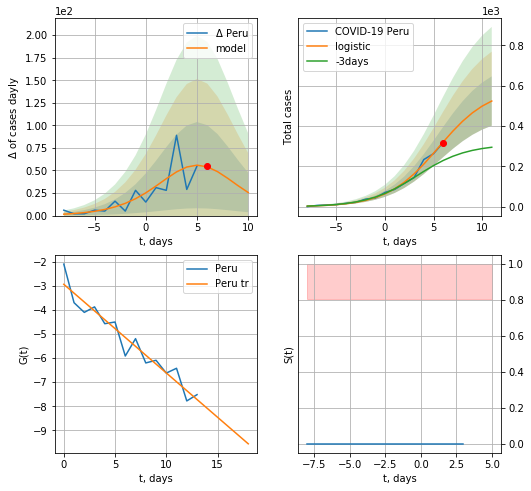

Peru data at: 2020-06-29
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +5 days
	 deltaDaycases:  25
	 total cases:  523 ± 122
	 total death:  17 ± 11
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


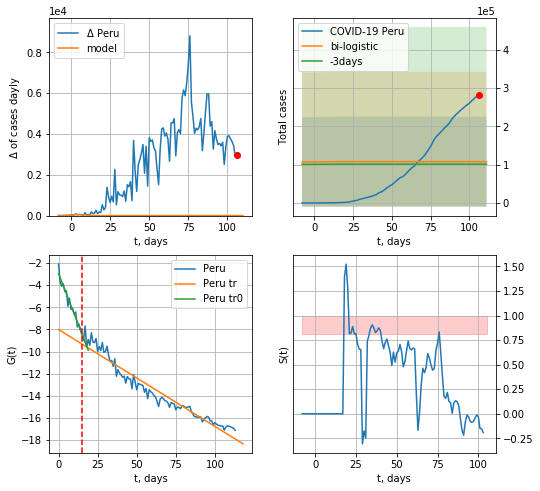

Peru data at: 2020-06-29
+3 day model MAPE: 0.0636809189178311
model: bi-logistic
coeffs:  [ 8.58139502e+04 -1.12664948e+01  2.80727897e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0869695179224064
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  107856 ± 117236
	 total death:  3630 ± 11837
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.940712
 intercept: -8.004822
 slope: -0.087504


In [324]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*14-dT)
xx = forecast2("Peru",dfPU[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


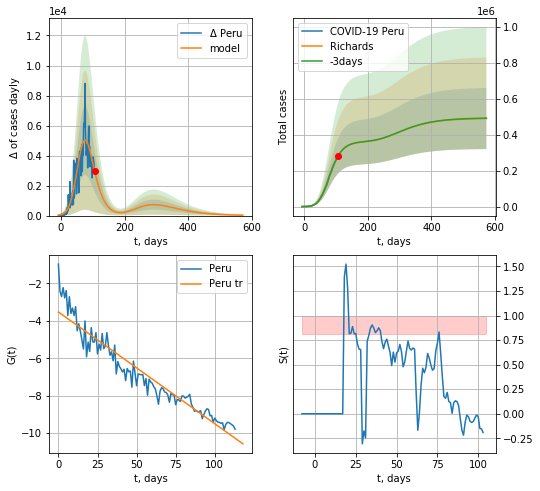

Peru data at: 2020-06-29
+3 day model MAPE: 0.000894
model: Richards
coeffs: [3.61519063e+05 1.08851386e-01 5.69910235e+01 4.16920804e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.346597
forecast at the end of period: +467 days
	 deltaDaycases: 25
	 total cases: 490871 ± 170134
	 total death: 16522 ± 17179
trend coefficient of determination: 0.914591
 intercept: -3.525815
 slope: -0.059752


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


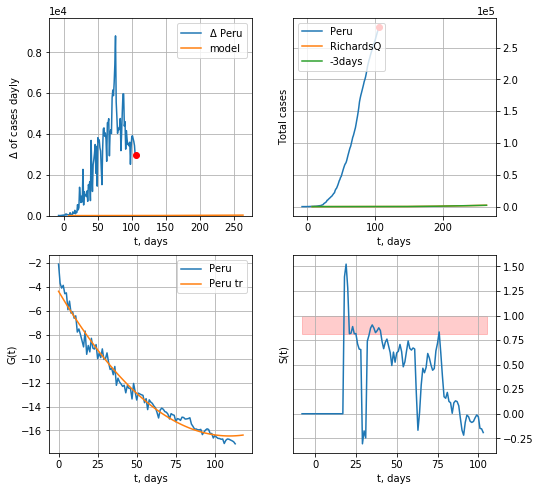

Peru data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.50045829e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +159 days
	 deltaDaycases: 22


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [325]:
x = forecastRR("Peru",dfPU[:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


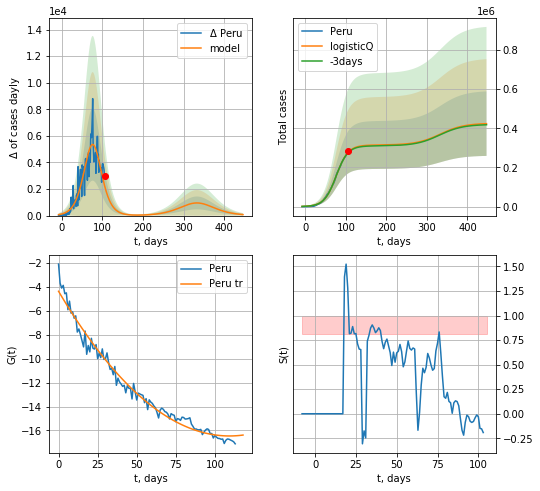

Peru data at: 2020-06-29
+3 day model MAPE: 0.007851
model: logisticQ
coeffs: [ 3.14716047e+05  1.12725682e-06  7.63795120e+01 -6.02880239e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.388760
forecast at the end of period: +341 days
	 deltaDaycases: 75
	 total cases: 423973 ± 164823
	 total death: 14270 ± 16642
trend coefficient of determination: 0.978232
 intercept_: -4.369737888497491
 coeffs_: [ 0.         -0.22108362  0.00101089]


In [326]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date   cases    active    death
117 2020-06-25  491170  190191.0  15308.0
118 2020-06-26  509446  197840.0  15689.0
119 2020-06-27  529860  203544.0  16111.0
120 2020-06-28  549197  210936.0  16487.0
121 2020-06-29  567536  215361.0  16904.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


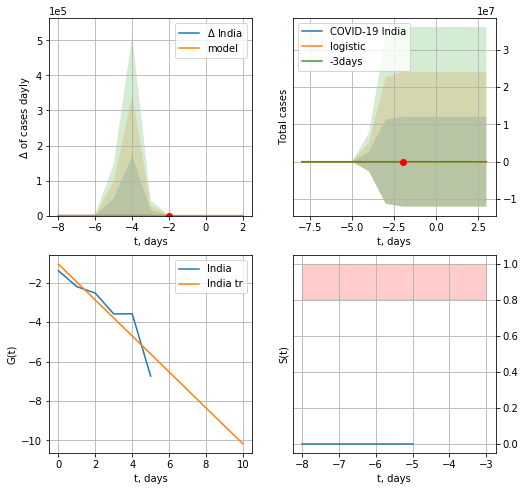

India data at: 2020-06-29
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


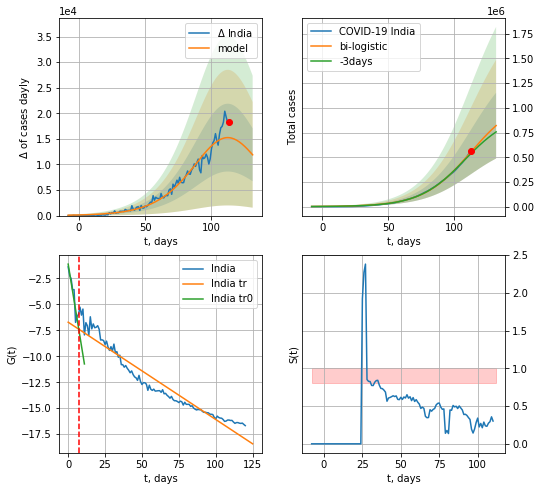

India data at: 2020-06-29
+3 day model MAPE: 0.0326083489974116
model: bi-logistic
coeffs:  [1.09033341e+06 5.55855279e-02 1.12494113e+02] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.4060980961940165
forecast at the end of period: +19 days
	 deltaDaycases:  11883
	 total cases:  820144 ± 333059
	 total death:  24427 ± 29759
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.929654
 intercept: -6.713899
 slope: -0.093759


In [327]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*14-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


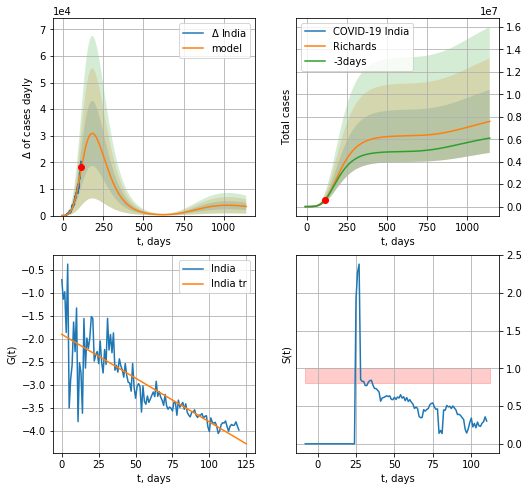

India data at: 2020-06-29
+3 day model MAPE: 0.014405
model: Richards
coeffs: [ 6.31670998e+06  3.21857227e-01 -5.12685878e+01  4.21607904e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.369227
forecast at the end of period: +1027 days
	 deltaDaycases: 3447
	 total cases: 7595592 ± 2804497
	 total death: 226233 ± 250594
trend coefficient of determination: 0.707204
 intercept: -1.909558
 slope: -0.019038


In [328]:
x = forecastRR("India",dfID[:],d1,160*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


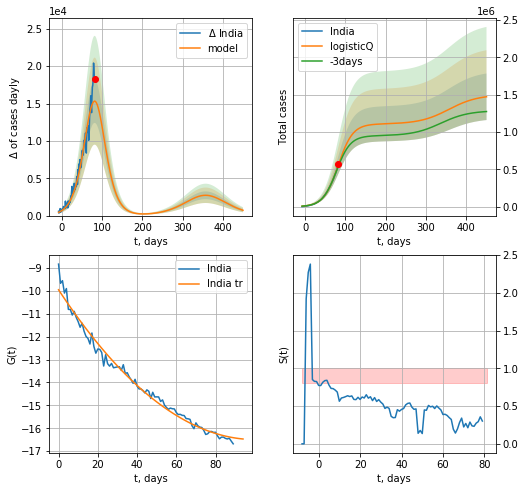

India data at: 2020-06-29
+3 day model MAPE: 0.032286
model: logisticQ
coeffs: [ 1.10728036e+06  3.21843988e-06  8.20045482e+01 -1.71052055e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.211770
forecast at the end of period: +369 days
	 deltaDaycases: 711
	 total cases: 1472215 ± 311770
	 total death: 43849 ± 27857
trend coefficient of determination: 0.983866
 intercept_: -9.945955701258335
 coeffs_: [ 0.        -0.1305474  0.0006504]


In [329]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date    cases   active   death
113 2020-06-25  52457.0  36519.0  1150.0
114 2020-06-26  55343.0  35743.0  1184.0
115 2020-06-27  57744.0  37394.0  1207.0
116 2020-06-28  59933.0  38567.0  1232.0
117 2020-06-29  62268.0  39850.0  1280.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


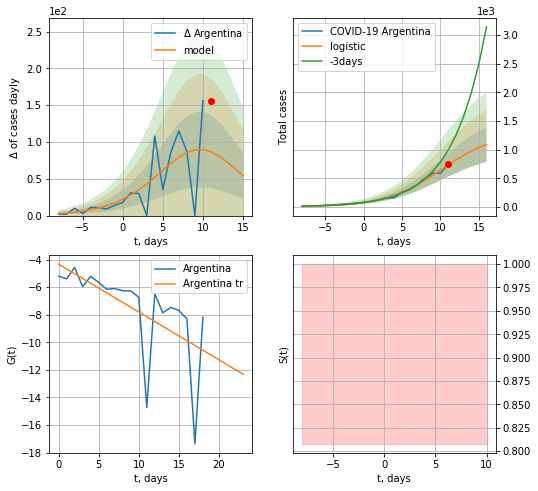

Argentina data at: 2020-06-29
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +5 days
	 deltaDaycases:  54
	 total cases:  1090 ± 302
	 total death:  22 ± 18
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


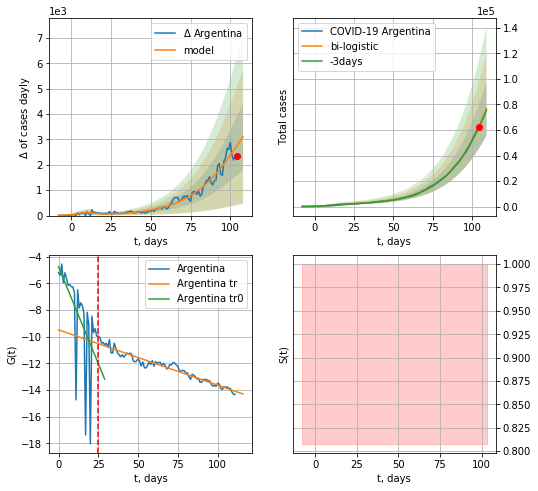

Argentina data at: 2020-06-29
+3 day model MAPE: 0.012842162874089017
model: bi-logistic
coeffs:  [3.40218047e+05 5.37678293e-02 1.32306751e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.27618057001978047
forecast at the end of period: +5 days
	 deltaDaycases:  3114
	 total cases:  76906 ± 21240
	 total death:  1580 ± 1309
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.942197
 intercept: -9.488741
 slope: -0.041416


In [330]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*14-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,14*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

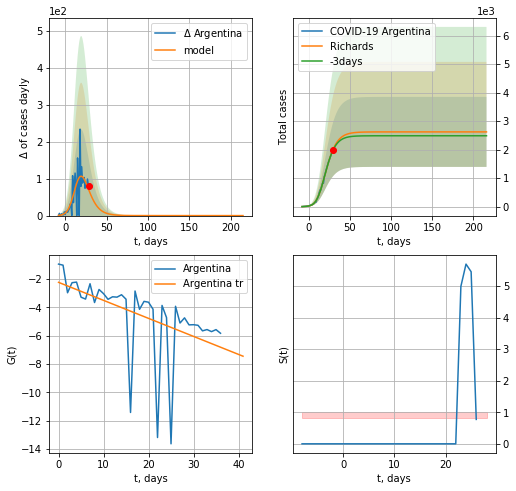

Argentina data at: 2020-06-29
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031748e+03 3.73236918e-01 1.15845148e+01 3.46306259e-01]
rational stdev: 0.468281
forecast at the end of period: +187 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 53 ± 74
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


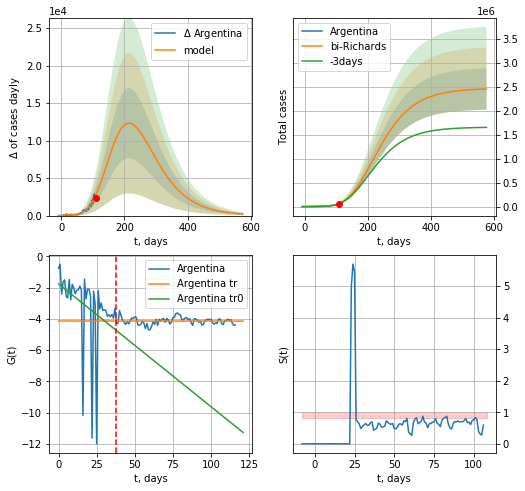

Argentina data at: 2020-06-29
+3 day model MAPE: 0.015819
model: bi-Richards
coeffs: [2.47021410e+06 1.42067558e-01 5.32681571e+01 1.00122872e-01]
rational stdev: 0.175857
forecast at the end of period: +467 days
	 deltaDaycases: 207
	 total cases: 2458325 ± 432312
	 total death: 50534 ± 26660
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.117807
 intercept: -1.762214
 slope: -0.078501
trend coefficient of determination: 0.000019
 intercept: -4.134104
 slope: -0.000044


In [331]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


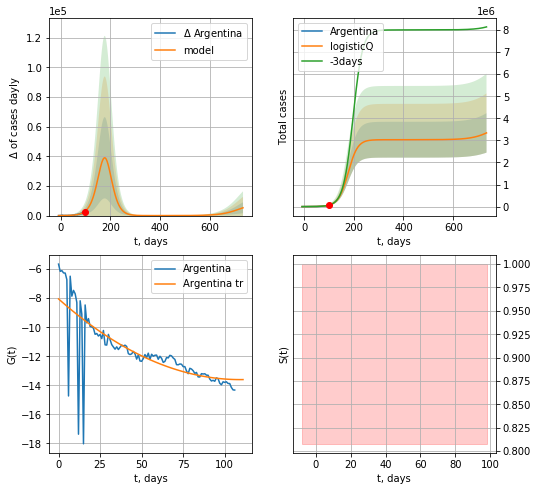

Argentina data at: 2020-06-29
+3 day model MAPE: 0.002323
model: logisticQ
coeffs: [ 3.03185706e+06  2.59183250e-05  1.77020372e+02 -1.80799332e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.267859
forecast at the end of period: +635 days
	 deltaDaycases: 5269
	 total cases: 3341319 ± 895001
	 total death: 68685 ± 55193
trend coefficient of determination: 0.564954
 intercept_: -8.04848273319062
 coeffs_: [ 0.         -0.10164205  0.00046497]


In [332]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


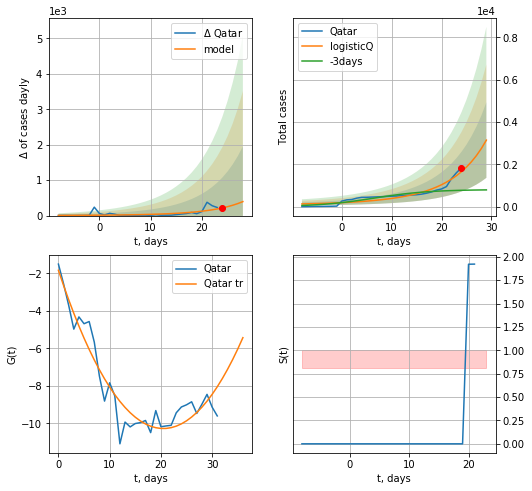

Qatar data at: 2020-06-29
+3 day model MAPE: 1.403655
model: logisticQ
coeffs: [ 4.67633524e+06  1.32940266e-03  6.79779167e+01 -1.11960120e+02]
rational stdev: 0.567221
forecast at the end of period: +5 days
	 deltaDaycases: 394
	 total cases: 3143 ± 1783
	 total death: 3 ± 5
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


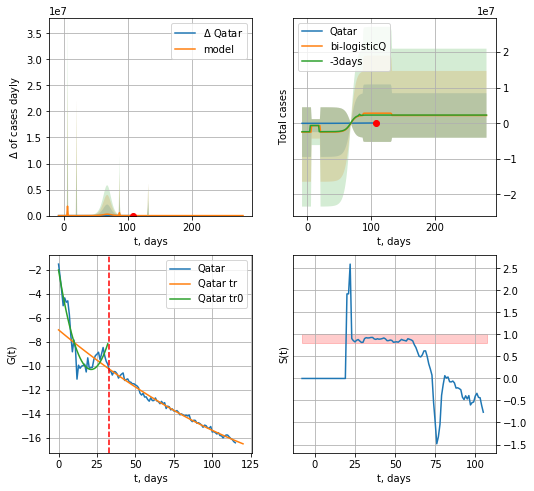

Qatar data at: 2020-06-29
+3 day model MAPE: 0.229474
model: bi-logisticQ
coeffs: [-1.82123294e+06  5.05678511e+00  2.01127880e+01  6.84980400e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 2.830073
forecast at the end of period: +173 days
	 deltaDaycases: 0
	 total cases: 2210076 ± 6254677
	 total death: 2625 ± 22286
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.990842
 intercept_: -6.980135164990013
 coeffs_: [ 0.         -0.10661372  0.00022935]


In [333]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*14-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


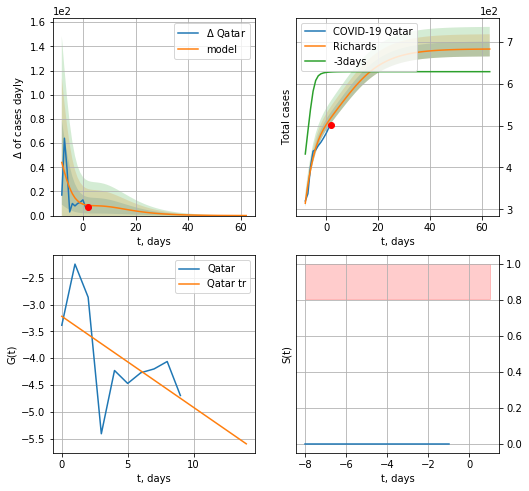

Qatar data at: 2020-06-29
+3 day model MAPE: 0.158936
model: Richards
coeffs: [ 5.01317281e+02  4.80174609e+00 -1.84019810e+01  6.85383715e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.025817
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 682 ± 17
	 total death: 0 ± 0
trend coefficient of determination: 0.312842
 intercept: -3.219590
 slope: -0.169880


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


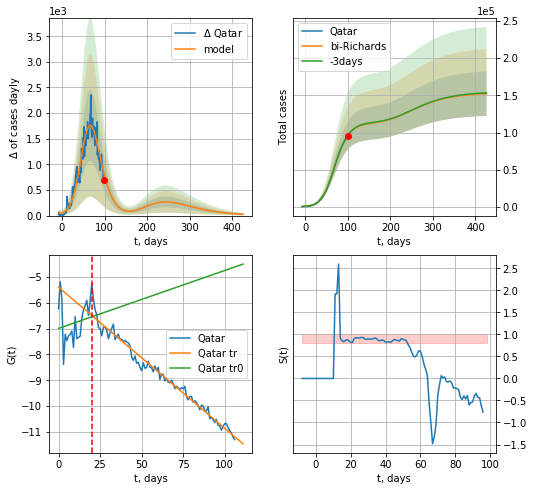

Qatar data at: 2020-06-29
+3 day model MAPE: 0.002548
model: bi-Richards
coeffs: [1.12383226e+05 9.71580442e-02 5.61040117e+01 5.56984569e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.196718
forecast at the end of period: +327 days
	 deltaDaycases: 25
	 total cases: 152217 ± 29943
	 total death: 180 ± 106
bi-Richards approximation splitting point: 20
trend coefficient of determination: 0.028446
 intercept: -6.986860
 slope: 0.022467
trend coefficient of determination: 0.972345
 intercept: -5.388808
 slope: -0.054753


In [334]:
vL = 29
x = forecastRR('Qatar',dfQR[9:vL-9].fillna(0),d1,22*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[9:].fillna(0),d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-9)

In [335]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
131 2020-06-25  46563.0   11090  308.0
132 2020-06-26  46973.0   11194  310.0
133 2020-06-27  47360.0   11215  311.0
134 2020-06-28  47797.0   11073  313.0
135 2020-06-29  48246.0   10856  314.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


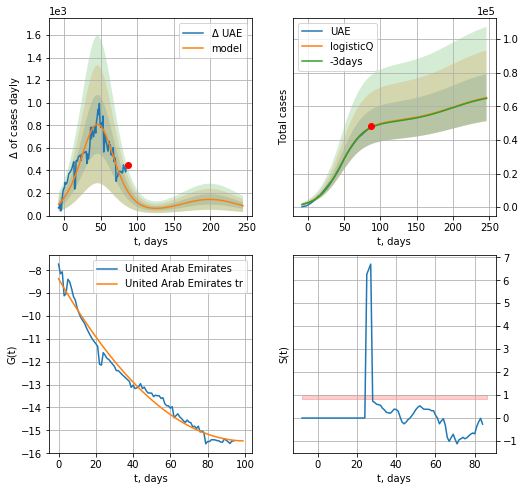

UAE data at: 2020-06-29
+3 day model MAPE: 0.006606
model: logisticQ
coeffs: [ 5.05794646e+04  1.06514118e-06  4.58878240e+01 -5.97349981e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.214973
forecast at the end of period: +159 days
	 deltaDaycases: 87
	 total cases: 65151 ± 14005
	 total death: 424 ± 273
trend coefficient of determination: 0.980684
 intercept_: -8.3697357939913
 coeffs_: [ 0.         -0.14104345  0.00070121]


In [336]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


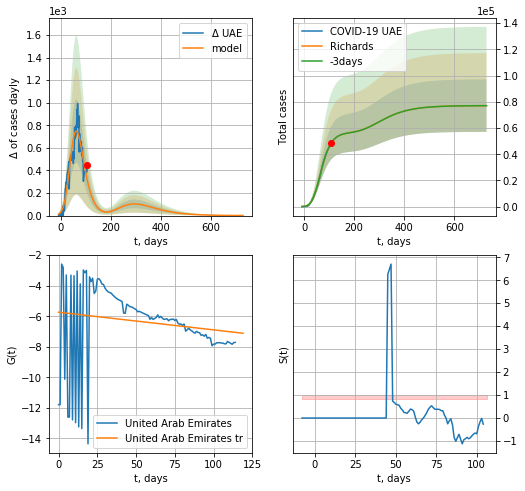

UAE data at: 2020-06-29
+3 day model MAPE: 0.000119
model: Richards
coeffs: [5.66182917e+04 1.45256338e-01 3.20417674e+01 2.81201086e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.259741
forecast at the end of period: +621 days
	 deltaDaycases: 0
	 total cases: 77089 ± 20023
	 total death: 501 ± 390
trend coefficient of determination: 0.025871
 intercept: -5.733241
 slope: -0.011572


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


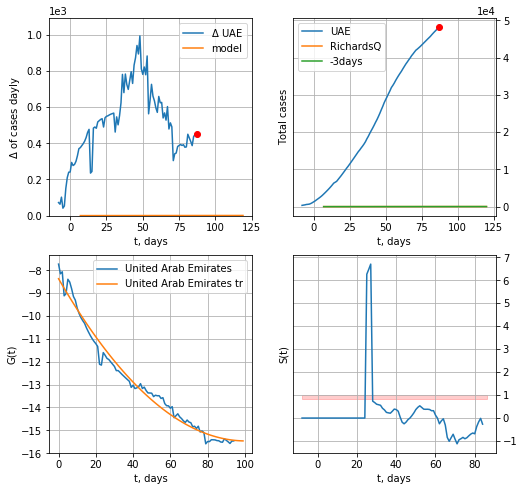

UAE data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.64994494e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +33 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [337]:
vL = 40
x = forecastRR('UAE',dfUAE[20:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('UAE',dfUAE[:],d1,102*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [338]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
114 2020-06-25  170639.0   51329  1428.0
115 2020-06-26  174577.0   52632  1474.0
116 2020-06-27  178504.0   54865  1511.0
117 2020-06-28  182493.0   56187  1551.0
118 2020-06-29  186436.0   57719  1599.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


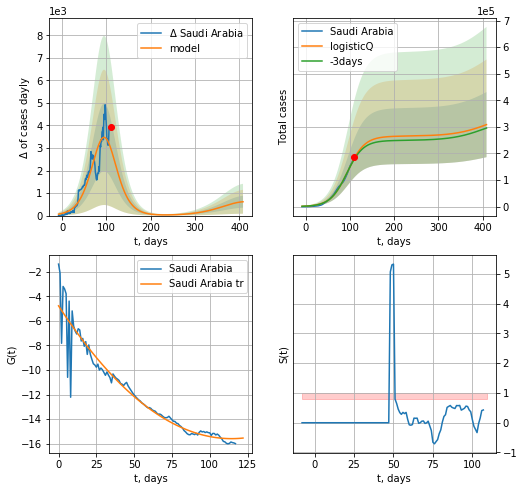

Saudi Arabia data at: 2020-06-29
+3 day model MAPE: 0.020607
model: logisticQ
coeffs: [ 2.65213076e+05  5.20593986e-07  9.51659002e+01 -1.00503642e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.397235
forecast at the end of period: +299 days
	 deltaDaycases: 614
	 total cases: 308605 ± 122589
	 total death: 2646 ± 3153
trend coefficient of determination: 0.918058
 intercept_: -4.781038489153166
 coeffs_: [ 0.         -0.18891382  0.00082561]


In [339]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,56*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


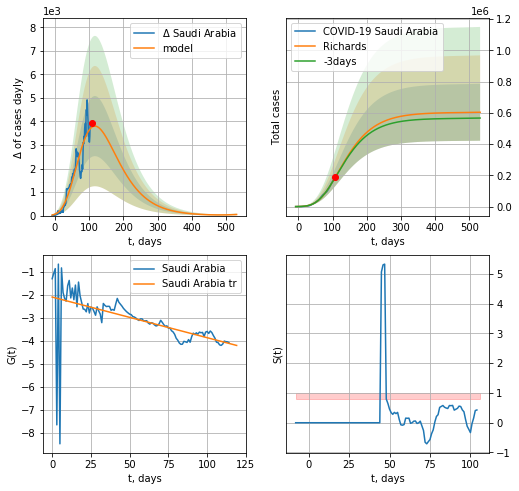

Saudi Arabia data at: 2020-06-29
+3 day model MAPE: 0.007688
model: Richards
coeffs: [ 6.02939732e+05  9.70892817e-01 -1.15336062e+02  1.78232975e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.301546
forecast at the end of period: +425 days
	 deltaDaycases: 46
	 total cases: 603781 ± 182067
	 total death: 5178 ± 4684
trend coefficient of determination: 0.314200
 intercept: -2.089876
 slope: -0.017701


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


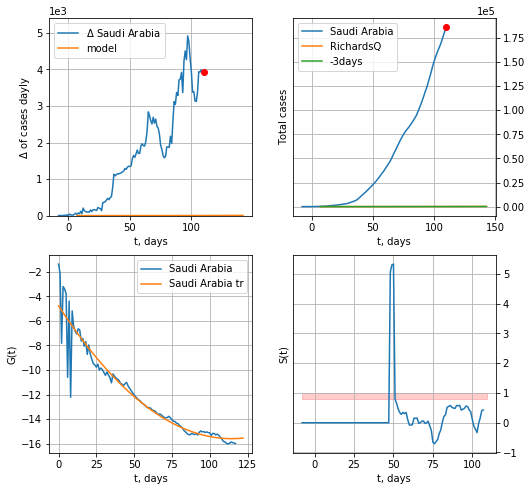

Saudi Arabia data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.80774879e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +33 days
	 deltaDaycases: 5


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [341]:
x = forecastRR('Saudi Arabia',dfSA[3:],d1,74*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
107 2020-06-25  2010.0     397   11.0
108 2020-06-26  2014.0     384   11.0
109 2020-06-27  2033.0     383   11.0
110 2020-06-28  2037.0     365   11.0
111 2020-06-29  2039.0     350   11.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


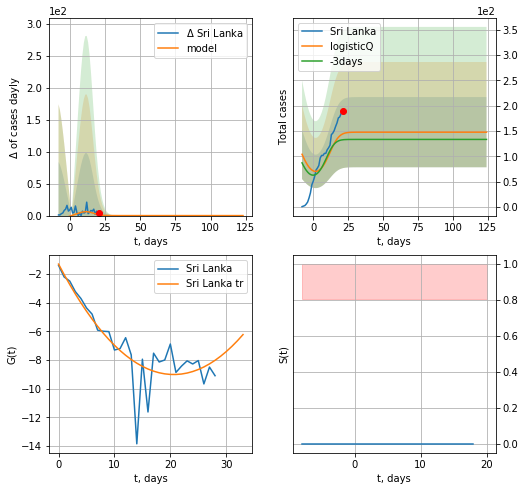

Sri Lanka data at: 2020-06-29
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +103 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


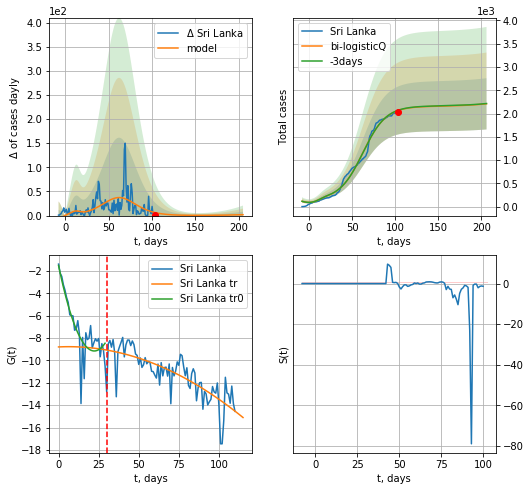

Sri Lanka data at: 2020-06-29
+3 day model MAPE: 0.002537
model: bi-logisticQ
coeffs: [ 2.00573382e+03  2.05595426e-06  6.23429112e+01 -3.61807536e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.249243
forecast at the end of period: +103 days
	 deltaDaycases: 1
	 total cases: 2209 ± 550
	 total death: 11 ± 8
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.615393
 intercept_: -8.791286663145176
 coeffs_: [ 0.          0.00678307 -0.00053619]


In [342]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

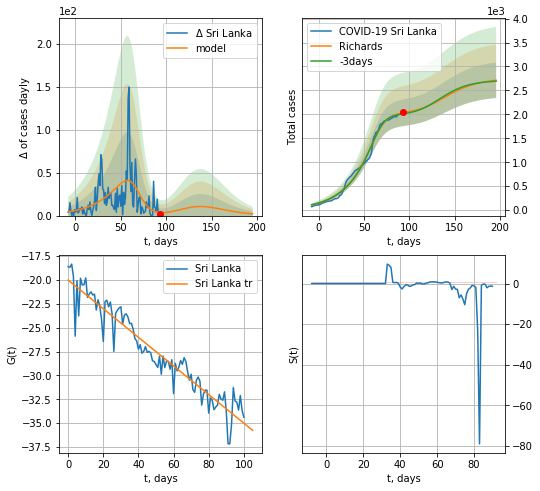

Sri Lanka data at: 2020-06-29
+3 day model MAPE: 0.011218
model: Richards
coeffs: [2.02223062e+03 3.95326233e-02 6.65240769e+01 3.60222761e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.136854
forecast at the end of period: +103 days
	 deltaDaycases: 1
	 total cases: 2713 ± 371
	 total death: 14 ± 5
trend coefficient of determination: 0.907573
 intercept: -20.019825
 slope: -0.149865


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


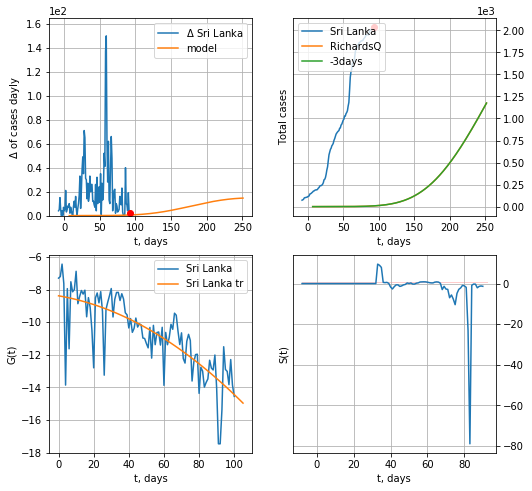

Sri Lanka data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.57221899e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +159 days
	 deltaDaycases: 14


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [343]:
vL=52
x = forecastRR('Sri Lanka',dfSri[10:],d1,28*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Sri Lanka',dfSri[10:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
119 2020-06-25  195745.0  107615  3962.0
120 2020-06-26  198883.0  107942  4035.0
121 2020-06-27  202955.0  106213  4118.0
122 2020-06-28  206512.0  106938  4167.0
123 2020-06-29  209337.0  106530  4304.0


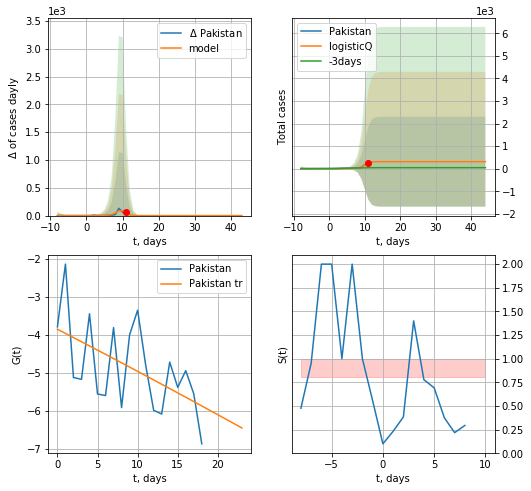

Pakistan data at: 2020-06-29
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


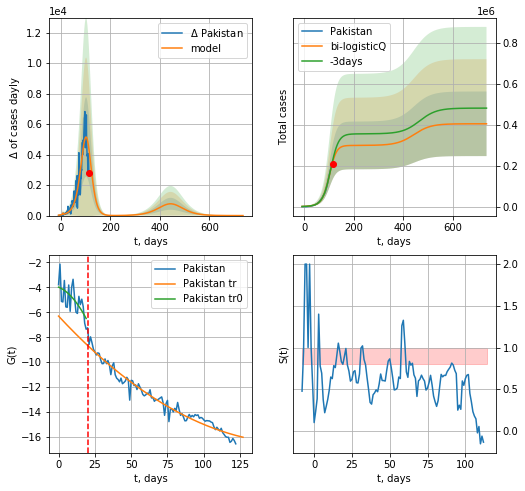

Pakistan data at: 2020-06-29
+3 day model MAPE: 0.034452
model: bi-logisticQ
coeffs: [ 2.97989626e+05  1.35512663e-04  1.01625988e+02 -4.07199373e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.389948
forecast at the end of period: +621 days
	 deltaDaycases: 0
	 total cases: 403824 ± 157470
	 total death: 8302 ± 9712
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.962516
 intercept_: -6.302806951667158
 coeffs_: [ 0.         -0.12546986  0.00038494]


In [344]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,102*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


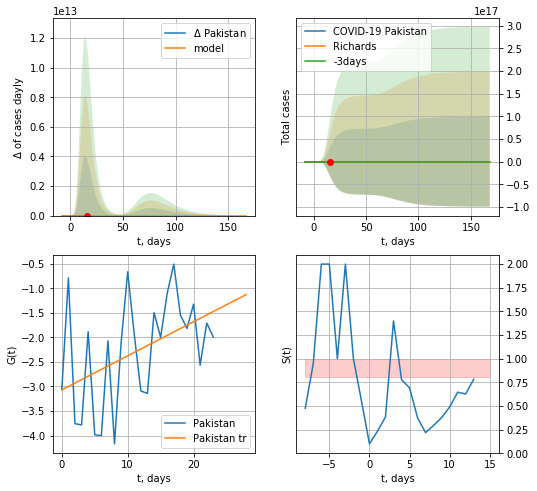

Pakistan data at: 2020-06-29
+3 day model MAPE: 0.118161
model: Richards
coeffs: [ 1.63793589e+03  6.01089634e+00 -3.06352612e+00  3.22292207e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 44401640452651.890625
forecast at the end of period: +152 days
	 deltaDaycases: 0
	 total cases: 2230 ± 99022041711592256
	 total death: 45 ± 5994221461108005
trend coefficient of determination: 0.194246
 intercept: -3.069579
 slope: 0.069356


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


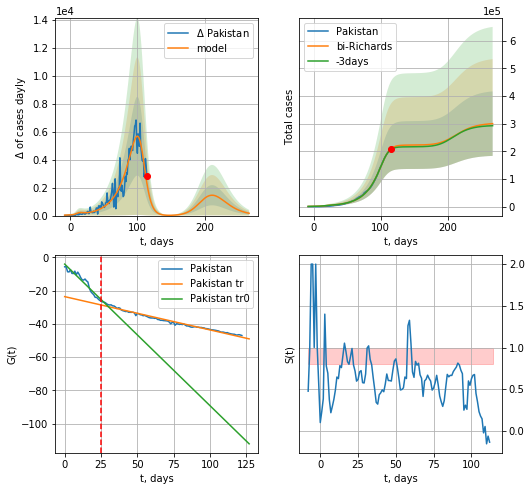

Pakistan data at: 2020-06-29
+3 day model MAPE: 0.012978
model: bi-Richards
coeffs: [2.21067191e+05 5.08400414e-02 1.07490307e+02 3.48199267e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.388661
forecast at the end of period: +152 days
	 deltaDaycases: 164
	 total cases: 300105 ± 116639
	 total death: 6170 ± 7194
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.923185
 intercept: -4.017396
 slope: -0.851344
trend coefficient of determination: 0.978707
 intercept: -23.578255
 slope: -0.200207


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


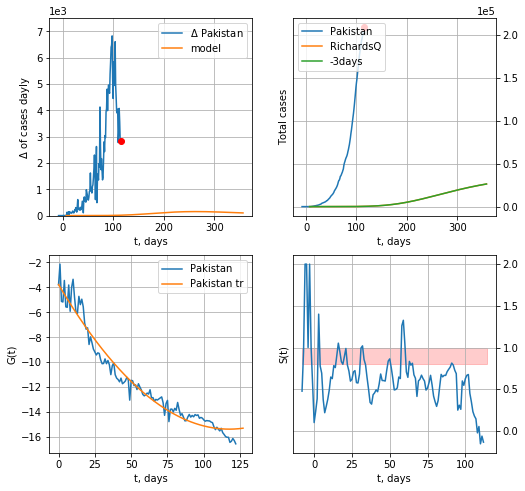

Pakistan data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.68498873e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +243 days
	 deltaDaycases: 101


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [345]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,35*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,35*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
109 2020-06-25  126606.0   73490  1621.0
110 2020-06-26  130474.0   75680  1661.0
111 2020-06-27  133978.0   77965  1695.0
112 2020-06-28  137787.0   80322  1738.0
113 2020-06-29  141801.0   82238  1783.0


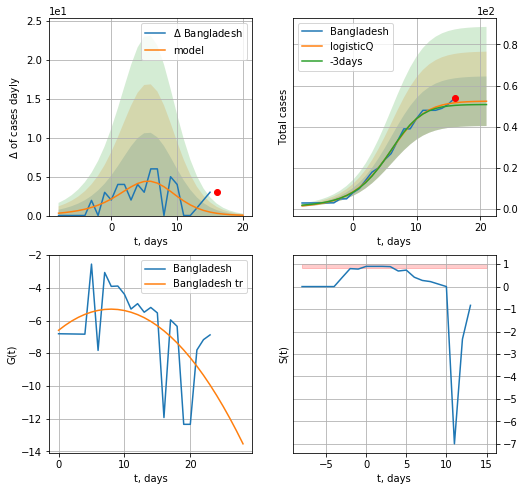

Bangladesh data at: 2020-06-29
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


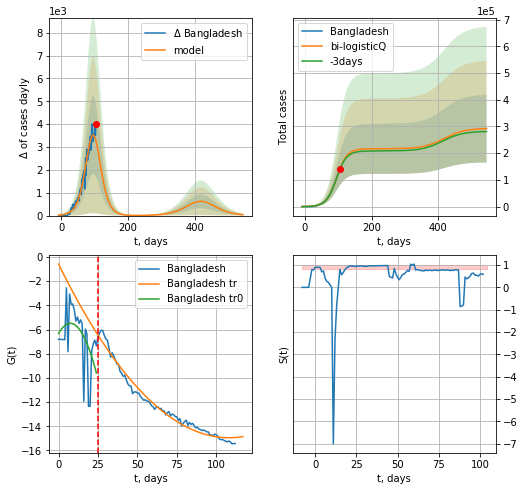

Bangladesh data at: 2020-06-29
+3 day model MAPE: 0.011551
model: bi-logisticQ
coeffs: [ 2.16435344e+05  2.15839583e-06  9.57100238e+01 -3.00499270e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.434592
forecast at the end of period: +439 days
	 deltaDaycases: 39
	 total cases: 291944 ± 126876
	 total death: 3670 ± 4784
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.978202
 intercept_: -0.5937292857549981
 coeffs_: [ 0.         -0.26532041  0.00122619]


In [346]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,14*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


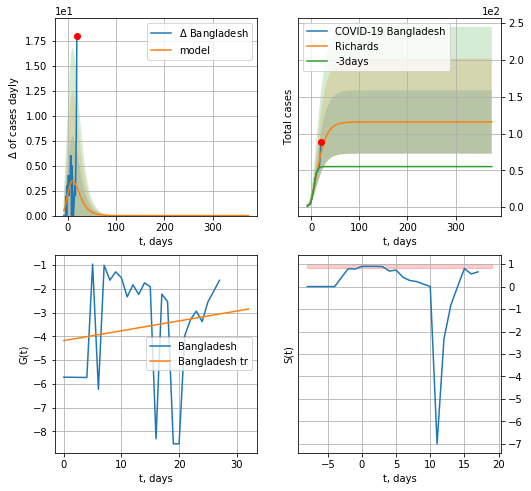

Bangladesh data at: 2020-06-29
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +355 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


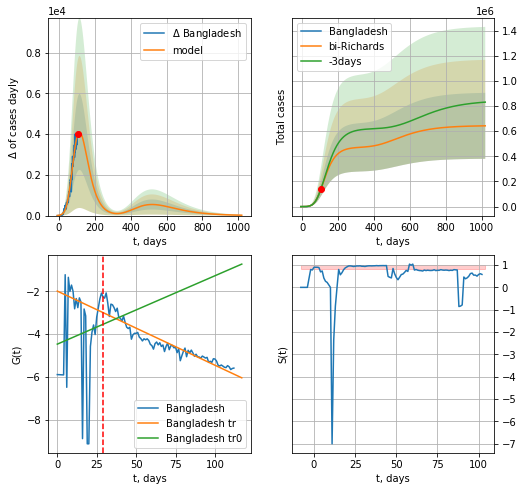

Bangladesh data at: 2020-06-29
+3 day model MAPE: 0.009204
model: bi-Richards
coeffs: [4.72850910e+05 1.49906248e-01 4.72285849e+01 1.70819375e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.408189
forecast at the end of period: +915 days
	 deltaDaycases: 18
	 total cases: 642188 ± 262134
	 total death: 8074 ± 9887
bi-Richards approximation splitting point: 29
trend coefficient of determination: 0.013782
 intercept: -4.469450
 slope: 0.032039
trend coefficient of determination: 0.880370
 intercept: -1.984431
 slope: -0.034726


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


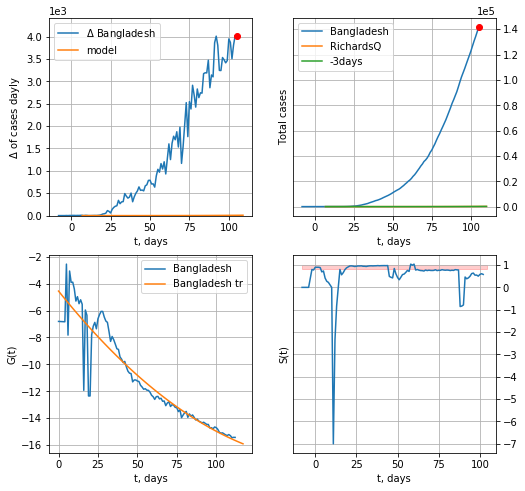

Bangladesh data at: 2020-06-29
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.74739504e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +5 days
	 deltaDaycases: 8


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [347]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:],d1,144*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Bangladesh',dfBN[:],d1,14*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
122 2020-06-25  42788.0    9082  339.0
123 2020-06-26  43703.0    9393  341.0
124 2020-06-27  44391.0    9461  344.0
125 2020-06-28  44942.0    9100  348.0
126 2020-06-29  45524.0    8861  350.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


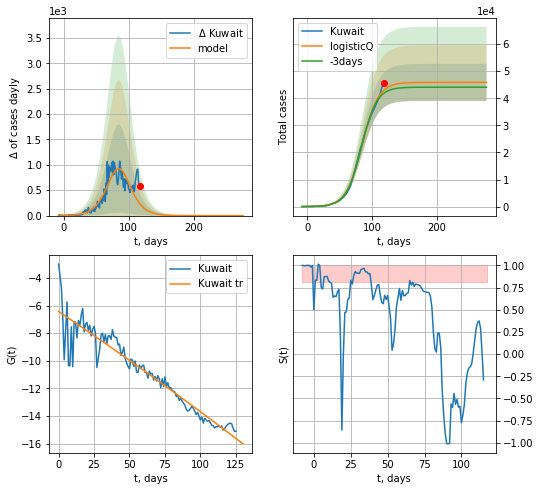

Kuwait data at: 2020-06-29
+3 day model MAPE: 0.027188
model: logisticQ
coeffs: [ 4.58861687e+04  8.87859600e-07  8.50833454e+01 -9.08805813e+04]
rational stdev: 0.148757
forecast at the end of period: +159 days
	 deltaDaycases: 0
	 total cases: 45886 ± 6825
	 total death: 352 ± 157
trend coefficient of determination: 0.900076
 intercept_: -6.432975475034862
 coeffs_: [ 0.00000000e+00 -6.88284552e-02 -3.70670280e-05]


In [348]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


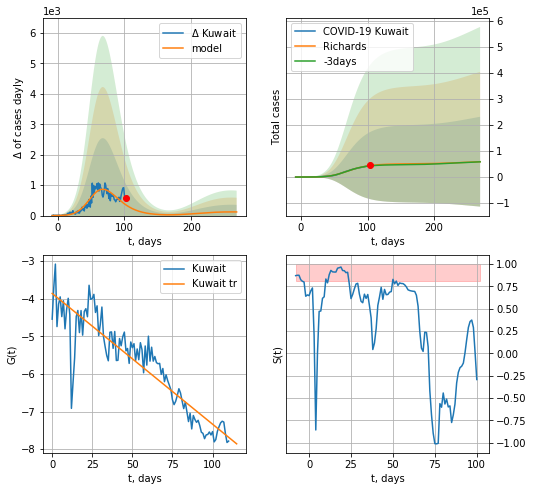

Kuwait data at: 2020-06-29
+3 day model MAPE: 0.027922
model: Richards
coeffs: [5.11175622e+04 1.66167250e-01 4.66781623e+01 3.19431214e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 2.920027
forecast at the end of period: +166 days
	 deltaDaycases: 119
	 total cases: 59099 ± 172573
	 total death: 454 ± 3977
trend coefficient of determination: 0.827728
 intercept: -3.860529
 slope: -0.034765


In [349]:
iL= 15
vL = 26 + iL
x = forecastRR('Kuwait',dfKW[iL:],d1,37*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Kuwait',dfKW[iL:],d1,37*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active  death
116 2020-06-25  29141.0   12220  698.0
117 2020-06-26  29764.0   12695  712.0
118 2020-06-27  30619.0   13235  718.0
119 2020-06-28  31373.0   13505  726.0
120 2020-06-29  31816.0   13803  733.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


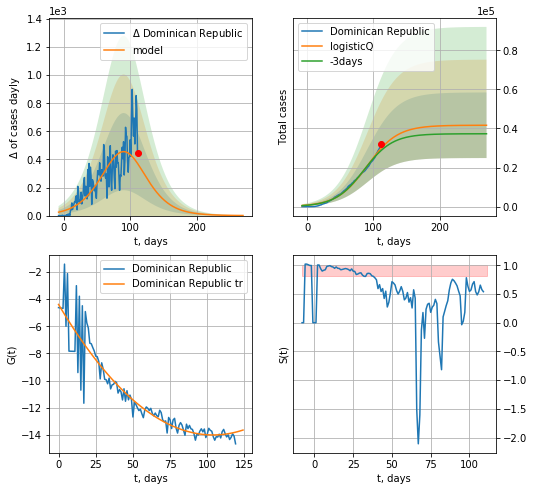

Dominican Republic data at: 2020-06-29
+3 day model MAPE: 0.040218
model: logisticQ
coeffs: [ 4.16444450e+04  3.65594897e-07  9.05412895e+01 -1.19607073e+05]
rational stdev: 0.402972
forecast at the end of period: +159 days
	 deltaDaycases: 0
	 total cases: 41629 ± 16775
	 total death: 959 ± 1159
trend coefficient of determination: 0.877861
 intercept_: -4.393186063147887
 coeffs_: [ 0.         -0.18482436  0.00088983]


In [350]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


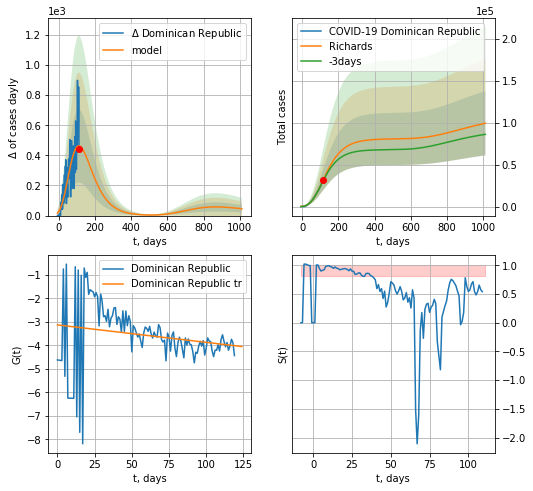

Dominican Republic data at: 2020-06-29
+3 day model MAPE: 0.026246
model: Richards
coeffs: [ 8.06772391e+04  1.03619068e+00 -1.55061195e+02  1.51905919e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.385426
forecast at the end of period: +901 days
	 deltaDaycases: 45
	 total cases: 99188 ± 38229
	 total death: 2285 ± 2642
trend coefficient of determination: 0.037581
 intercept: -3.126010
 slope: -0.007419


In [351]:
x = forecastRR('Dominican Republic',dfDM[:],d1,142*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

MD
           date    cases  active  death
110 2020-06-25  15453.0    6352  502.0
111 2020-06-26  15776.0    6496  515.0
112 2020-06-27  16080.0    6596  521.0
113 2020-06-28  16250.0    6639  530.0
114 2020-06-29  16357.0    6592  536.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


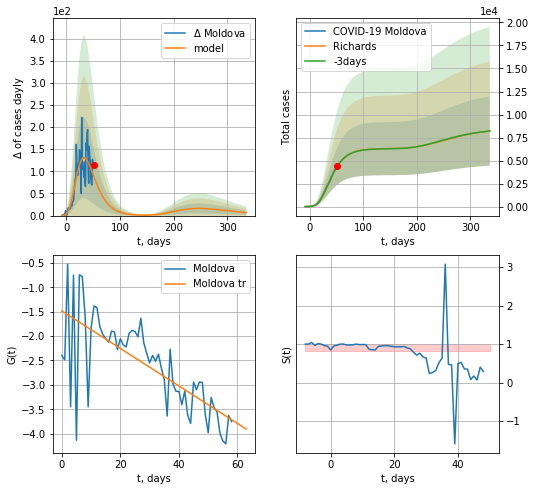

Moldova data at: 2020-06-29
+3 day model MAPE: 0.000788
model: Richards
coeffs: [ 6.30547574e+03  3.98849226e+00 -4.11476415e+01  1.42380272e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.458349
forecast at the end of period: +285 days
	 deltaDaycases: 6
	 total cases: 8217 ± 3766
	 total death: 269 ± 369
trend coefficient of determination: 0.512179
 intercept: -1.485671
 slope: -0.038427


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


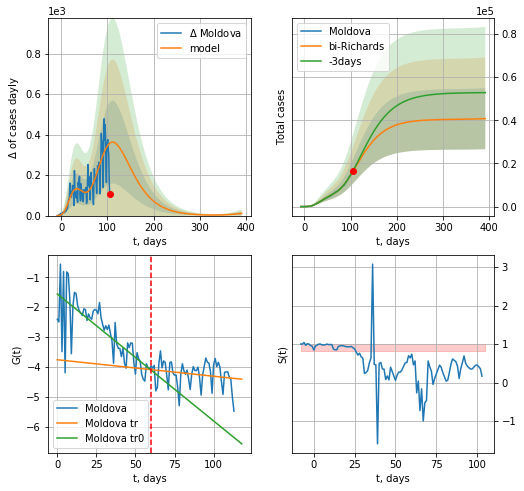

Moldova data at: 2020-06-29
+3 day model MAPE: 0.018815
model: bi-Richards
coeffs: [3.42199279e+04 6.36702085e-01 6.68177244e+00 4.57676334e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.347290
forecast at the end of period: +285 days
	 deltaDaycases: 10
	 total cases: 40807 ± 14172
	 total death: 1337 ± 1392
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.581767
 intercept: -1.557771
 slope: -0.042444
trend coefficient of determination: 0.042859
 intercept: -3.757293
 slope: -0.005504


In [352]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,54*7-dT,addpred=True,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,54*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [353]:
#np.diff(dfAF["cases"])

AF
           date     cases  active   death
112 2020-06-25  118375.0   56109  2292.0
113 2020-06-26  124590.0   58139  2340.0
114 2020-06-27  131800.0   62293  2413.0
115 2020-06-28  138134.0   66753  2456.0
116 2020-06-29  144264.0   71121  2529.0


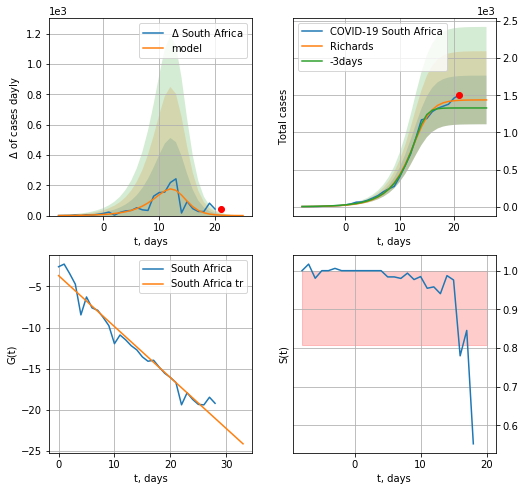

South Africa data at: 2020-06-29
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832007e+03 3.09188728e-01 1.37785508e+01 2.13840807e+00]
rational stdev: 0.227967
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 25 ± 17
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


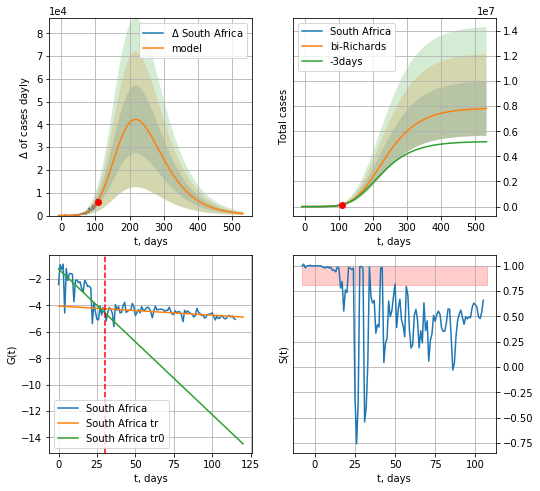

South Africa data at: 2020-06-29
+3 day model MAPE: 0.015922
model: bi-Richards
coeffs: [7.86437327e+06 9.84831713e-02 1.01270972e+02 1.59768518e-01]
rational stdev: 0.277461
forecast at the end of period: +425 days
	 deltaDaycases: 868
	 total cases: 7810829 ± 2167199
	 total death: 136926 ± 113974
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.531045
 intercept: -1.240951
 slope: -0.110361
trend coefficient of determination: 0.278004
 intercept: -4.042662
 slope: -0.006979


In [354]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,74*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [350]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [5]:
df.head(10)
#df.columns[18]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,NewRecovered,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,\n,,,"1,597,033",North America,\nNorth America\n,,"+5,108",499,"+4,578",,"18,919",,"3,129,426","167,602","1,364,791",,
1,,\n,,,"835,986",South America,\nSouth America\n,,601,57,411,,"12,789",,"2,187,129","83,671","1,267,472",,
2,,\n,,,"880,263",Europe,\nEurope\n,,,,"+1,000",,"5,753",,"2,429,234","191,026","1,357,945",,
3,,\n,,,"724,759",Asia,\nAsia\n,,"+3,737",144,"+3,292",,"19,392",,"2,260,121","55,874","1,479,488",,
4,,\n,,,"196,678",Africa,\nAfrica\n,,,,,,924,,"396,314","9,914","189,722",,
5,,\n,,,751,Australia/Oceania,\nOceania\n,,69,,,,1,,"9,476",126,"8,599",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,235,525",All,World,65.2,"+9,515",700,"+9,281",,"57,782",,"10,412,421","508,228","5,668,668",,"1,336"
8,1,123,"2,570",10,"1,435,851",North America,USA,389,,,,"330,996,984","15,864","100,271","2,681,811","128,783","1,117,177","33,189,513","8,102"
9,2,155,"3,641",69,"554,641",South America,Brazil,275,,,,"212,554,056","8,318","14,445","1,370,488","58,385","757,462","3,070,447","6,448"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,597,033",North America,\nNorth America\n,,"+5,108",499,"+4,578",,"18,919",,"3,129,426","167,602","1,364,791",,
1,,\n,,,"835,986",South America,\nSouth America\n,,601,57,411,,"12,789",,"2,187,129","83,671","1,267,472",,
2,,\n,,,"880,263",Europe,\nEurope\n,,,,"+1,000",,"5,753",,"2,429,234","191,026","1,357,945",,
3,,\n,,,"724,759",Asia,\nAsia\n,,"+3,737",144,"+3,292",,"19,392",,"2,260,121","55,874","1,479,488",,
4,,\n,,,"196,678",Africa,\nAfrica\n,,,,,,924,,"396,314","9,914","189,722",,


In [7]:
df[df["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
119,112,"1,499","34,898",7,226,Europe,Lithuania,29,,,,"2,722,035",16,"153,697","1,816",78,"1,512","418,368",667
352,113,"1,499","34,898",7,226,Europe,Lithuania,29,1,,9,"2,722,035",16,"153,697","1,816",78,"1,512","418,368",667
584,113,"1,500","34,898",7,234,Europe,Lithuania,29,2,,,"2,722,035",16,"153,098","1,815",78,"1,503","416,739",667


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [9]:
df.head(45)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,597,033",North America,\nNorth America\n,,"+5,108",499,"+4,578",,"18,919",,"3,129,426","167,602","1,364,791",,
1,,\n,,,"835,986",South America,\nSouth America\n,,601,57,411,,"12,789",,"2,187,129","83,671","1,267,472",,
2,,\n,,,"880,263",Europe,\nEurope\n,,,,"+1,000",,"5,753",,"2,429,234","191,026","1,357,945",,
3,,\n,,,"724,759",Asia,\nAsia\n,,"+3,737",144,"+3,292",,"19,392",,"2,260,121","55,874","1,479,488",,
4,,\n,,,"196,678",Africa,\nAfrica\n,,,,,,924,,"396,314","9,914","189,722",,
5,,\n,,,751,Australia/Oceania,\nOceania\n,,69,,,,1,,"9,476",126,"8,599",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,235,525",All,World,65.2,"+9,515",700,"+9,281",,"57,782",,"10,412,421","508,228","5,668,668",,"1,336"
8,1,123,"2,570",10,"1,435,851",North America,USA,389,,,,"330,996,984","15,864","100,271","2,681,811","128,783","1,117,177","33,189,513","8,102"
9,2,155,"3,641",69,"554,641",South America,Brazil,275,,,,"212,554,056","8,318","14,445","1,370,488","58,385","757,462","3,070,447","6,448"


In [10]:
df.at[13, 'TotalRecovered'] = 0
df.at[12, 'TotalRecovered'] = 0
df.at[29, 'TotalRecovered'] = 0
df.at[36, 'TotalRecovered'] = 0
df.at[13,"ActiveCases"] = 0
df.at[12,"ActiveCases"] = 0
df.at[29,"ActiveCases"] = 0
df.at[36,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1597033,North America,\nNorth America\n,NaN,5108.0,499.0,"+4,578",,18919.0,NaN,3129426,167602.0,1364791.0,NaN,NaN
1,,\n,,,835986,South America,\nSouth America\n,NaN,601.0,57.0,411,,12789.0,NaN,2187129,83671.0,1267472.0,NaN,NaN
2,,\n,,,880263,Europe,\nEurope\n,NaN,NaN,NaN,"+1,000",,5753.0,NaN,2429234,191026.0,1357945.0,NaN,NaN
3,,\n,,,724759,Asia,\nAsia\n,NaN,3737.0,144.0,"+3,292",,19392.0,NaN,2260121,55874.0,1479488.0,NaN,NaN
4,,\n,,,196678,Africa,\nAfrica\n,NaN,NaN,NaN,,,924.0,NaN,396314,9914.0,189722.0,NaN,NaN
5,,\n,,,751,Australia/Oceania,\nOceania\n,NaN,69.0,NaN,,,1.0,NaN,9476,126.0,8599.0,NaN,NaN
6,,\n,,,55,,\n\n,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,\n,,,4235525,All,World,65.2,9515.0,700.0,"+9,281",,57782.0,NaN,10412421,508228.0,5668668.0,NaN,1336.0
8,1,123,"2,570",10,1435851,North America,USA,389.0,NaN,NaN,,"330,996,984",15864.0,100271.0,2681811,128783.0,1117177.0,33189513.0,8102.0
9,2,155,"3,641",69,554641,South America,Brazil,275.0,NaN,NaN,,"212,554,056",8318.0,14445.0,1370488,58385.0,757462.0,3070447.0,6448.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,,,,724759,Asia,Total:,NaN,3737.0,144.0,"+3,292",,19392.0,NaN,2260121,55874.0,1479488.0,NaN,NaN
227,,,,,196678,Africa,Total:,NaN,NaN,NaN,,,924.0,NaN,396314,9914.0,189722.0,NaN,NaN
228,,,,,751,Australia/Oceania,Total:,NaN,69.0,NaN,,,1.0,NaN,9476,126.0,8599.0,NaN,NaN
229,,,,,55,,Total:,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,NaN,NaN,NaN,159958,Europe,European Union,298.748673,0.0,0.0,NaN,NaN,2411.0,62671.357186,1282170,133018.0,615017.0,27904454.0,2879.659786


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1597033,North America,North America,NaN,5108.0,499.0,"+4,578",,18919.0,NaN,3129426,167602.0,1364791.0,NaN,NaN
1,,\n,,,835986,South America,South America,NaN,601.0,57.0,411,,12789.0,NaN,2187129,83671.0,1267472.0,NaN,NaN
2,,\n,,,880263,Europe,Europe,NaN,NaN,NaN,"+1,000",,5753.0,NaN,2429234,191026.0,1357945.0,NaN,NaN
3,,\n,,,724759,Asia,Asia,NaN,3737.0,144.0,"+3,292",,19392.0,NaN,2260121,55874.0,1479488.0,NaN,NaN
4,,\n,,,196678,Africa,Africa,NaN,NaN,NaN,,,924.0,NaN,396314,9914.0,189722.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [16]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1597033,North America,North America,NaN,5108.0,499.0,"+4,578",,18919.0,NaN,3129426,167602.0,1364791.0,NaN,NaN
1,,\n,,,835986,South America,South America,NaN,601.0,57.0,411,,12789.0,NaN,2187129,83671.0,1267472.0,NaN,NaN
2,,\n,,,880263,Europe,Europe,NaN,NaN,NaN,"+1,000",,5753.0,NaN,2429234,191026.0,1357945.0,NaN,NaN
3,,\n,,,724759,Asia,Asia,NaN,3737.0,144.0,"+3,292",,19392.0,NaN,2260121,55874.0,1479488.0,NaN,NaN
4,,\n,,,196678,Africa,Africa,NaN,NaN,NaN,,,924.0,NaN,396314,9914.0,189722.0,NaN,NaN
5,,\n,,,751,Australia/Oceania,Oceania,NaN,69.0,NaN,,,1.0,NaN,9476,126.0,8599.0,NaN,NaN
7,,\n,,,4235525,All,World,65.2,9515.0,700.0,"+9,281",,57782.0,NaN,10412421,508228.0,5668668.0,NaN,1336.0
8,1,123,"2,570",10,1435851,North America,USA,389.0,NaN,NaN,,"330,996,984",15864.0,100271.0,2681811,128783.0,1117177.0,33189513.0,8102.0
9,2,155,"3,641",69,554641,South America,Brazil,275.0,NaN,NaN,,"212,554,056",8318.0,14445.0,1370488,58385.0,757462.0,3070447.0,6448.0
10,3,228,"15,921",8,228560,Europe,Russia,63.0,NaN,NaN,,"145,934,449",2300.0,132487.0,641156,9166.0,403430.0,19334442.0,4393.0


In [17]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [18]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Hungary HG
UK GB
Norway NG
Turkey TR
Luxembourg LX
New Zealand ZL
Cyprus CP
France FR
Ecuador ED
Greece GC
Philippines PH
S. Korea KR
Italy IT
Argentina AG
Netherlands NL
Colombia CB
Sweden SW
Bangladesh BN
Algeria AR
Switzerland SZ
Kuwait KW
Indonesia IE
Belgium BG
Moldova MD
Peru PU
Morocco MR
Qatar QR
Romania RM
Singapore SG
Estonia ES
Saudi Arabia SA
Canada CA
Brazil BZ
Iran IN
UAE UAE
Poland PL
Portugal PT
Slovakia SL
Iraq IQ
Slovenia SV
Panama PM
Spain SP
Croatia CT
Russia RS
Denmark DK
Pakistan PS
Serbia SB
Thailand TH
Belarus BR
Australia AS
Czechia CH
Egypt EG
Austria AT
USA US
Malaysia ML
World World
Dominican Republic DM
India ID
Malta MT
European Union EU
Finland FI
Iceland IC
Bulgaria BL
Japan JP
Latvia LV
Chile CL
Israel IS
Mexico MX
Sri Lanka Sri
Ireland IR
South Africa AF
Germany GR
China CN
Ukraine Ukr
Lithuania LT


In [19]:
len(countryDic)

75

In [20]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-06-29,3129426,1597033,167602.0
South America
South America 2020-06-29,2187129,835986,83671.0
Europe
Europe 2020-06-29,2429234,880263,191026.0
Asia
Asia 2020-06-29,2260121,724759,55874.0
Africa
Africa 2020-06-29,396314,196678,9914.0
Oceania
Oceania 2020-06-29,9476,751,126.0
World
World 2020-06-29,10412421,4235525,508228.0
USA
USA 2020-06-29,2681811,1435851,128783.0
Brazil
Brazil 2020-06-29,1370488,554641,58385.0
Russia
Russia 2020-06-29,641156,228560,9166.0
India
India 2020-06-29,567536,215361,16904.0
UK
UK 2020-06-29,311965,0,43575.0
Spain
Spain 2020-06-29,296050,0,28346.0
Peru
Peru 2020-06-29,282365,101702,9504.0
Chile
Chile 2020-06-29,275999,34270,5575.0
Italy
Italy 2020-06-29,240436,16496,34744.0
Iran
Iran 2020-06-29,225205,28355,10670.0
Mexico
Mexico 2020-06-29,220657,62272,27121.0
Pakistan
Pakistan 2020-06-29,209337,106530,4304.0
Turkey
Turkey 2020-06-29,198613,21689,5115.0
Germany
Germany 2020-06-29,195392,7251,9041.0
Saudi Arabia
Saudi Arabia 202

Papua New Guinea
Papua New Guinea 2020-06-29,11,3,nan
Western Sahara
Western Sahara 2020-06-29,10,1,1.0
MS Zaandam
MS Zaandam 2020-06-29,9,7,2.0
British Virgin Islands
British Virgin Islands 2020-06-29,8,0,1.0
Caribbean Netherlands
Caribbean Netherlands 2020-06-29,7,0,nan
St. Barth
St. Barth 2020-06-29,6,0,nan
Anguilla
Anguilla 2020-06-29,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-06-29,1,0,nan
China
China 2020-06-29,83531,428,4634.0
Total:
Total: 2020-06-29,3129426,1597033,167602.0
Total:
Total: 2020-06-29,3129426,1597033,167602.0
Total:
Total: 2020-06-29,3129426,1597033,167602.0
Total:
Total: 2020-06-29,3129426,1597033,167602.0
Total:
Total: 2020-06-29,3129426,1597033,167602.0
Total:
Total: 2020-06-29,3129426,1597033,167602.0
Total:
Total: 2020-06-29,3129426,1597033,167602.0
European Union
European Union 2020-06-29,1282170,159958,133018.0


In [21]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [22]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaHG.csv 2020-06-29,4145,875,585.0

append data/coronaGB.csv 2020-06-29,311965,0,43575.0

append data/coronaNG.csv 2020-06-29,8862,475,249.0

append data/coronaTR.csv 2020-06-29,198613,21689,5115.0

append data/coronaLX.csv 2020-06-29,4256,149,110.0

append data/coronaZL.csv 2020-06-29,1528,22,22.0

append data/coronaCP.csv 2020-06-29,996,144,19.0

append data/coronaFR.csv 2020-06-29,164260,58798,29813.0

append data/coronaED.csv 2020-06-29,55665,23733,4502.0

append data/coronaGC.csv 2020-06-29,3390,1825,191.0

append data/coronaPH.csv 2020-06-29,36438,25227,1255.0

append data/coronaKR.csv 2020-06-29,12800,981,282.0

append data/coronaIT.csv 2020-06-29,240436,16496,34744.0

append data/coronaAG.csv 2020-06-29,62268,39850,1280.0

append data/coronaNL.csv 2020-06-29,50223,0,6107.0

append data/coronaCB.csv 2020-06-29,95043,51866,3223.0

append data/coronaSW.csv 2020-06-29,67667,0,5310.0

append data/coronaBN.csv 2020-06-29,141801,82238,1783.0

append data/coronaAR.csv 2

In [32]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [ ]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [122]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

87759686.0 11283.646111911128


In [123]:
TT/7.7776e3

11283.646111911128

In [124]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

46659.02305954441

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [397]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

53138.63826331259

In [398]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [399]:
#dfAll

In [400]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

14872.243140359802

In [467]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China"         
]

In [468]:
len(CList)

72

In [469]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5577035987

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400